In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
from random import seed

from scipy.stats import zscore
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import  MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import Imputer
from sklearn.metrics import mean_absolute_error

from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, LSTM, BatchNormalization
from keras import layers
from keras import optimizers
from keras import callbacks
from keras import models
from keras.utils import to_categorical

Using TensorFlow backend.


In [2]:
#Generate Dataset
#Airfoil Self-Noise
df_airfoil=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Airfoil_self_noise.csv')

#Automobile
df_automobile=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Automobile_data.txt')

#Autompg
df_autompg=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Auto-mpg.csv')

#ChallengerUSA
df_challenger=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Challenger USA Space Shuttle O-Ring.csv')

#Combine Cycle Power
df_combine=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Combine Cycle Power Plant.csv')

#Computer Hardware
df_computer=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Computer Hardware.csv')

#Concrete Compressive Strength
df_concrete_compressive_strength=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Compressive Strength.csv')

#Concrete Slump Test
df_concrete1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete3=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')

#Energy Efficiency
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')

#Fertility Diagnosis
df_fertility=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\fertility_Diagnosis.csv')

#Forest Fires
df_forest=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\forestfires.csv')

#Housing
df_housing=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Housing.csv')

#Istanbul Stock Exchange
df_istanbul=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Istanbul Stock Exchange.csv')

#WDBC
df_wdbc=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\wdbc.csv')

In [3]:
#remove Nan columns of df_energy1
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy1.drop(df_energy1.columns[11],inplace=True, axis = 1)
df_energy1.drop(df_energy1.columns[10],inplace=True, axis = 1)

#remove Nan columns of df_energy2
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2.drop(df_energy2.columns[11],inplace=True, axis = 1)
df_energy2.drop(df_energy2.columns[10],inplace=True, axis = 1)

#remove question marks
#df_automobile
imp= Imputer(missing_values="NaN", strategy="mean")
df_automobile=df_automobile.replace("?", np.NaN)
df_automobile['num-of-doors'] = df_automobile['num-of-doors'].fillna("four")
for i in df_automobile.columns:
    if df_automobile[i].isnull().sum()>0:
        df_automobile[i]=imp.fit_transform(df_automobile[[i]])
#df_automobile = df_automobile[(df_automobile.astype(str) != '?').all(axis=1)]
#df_automobile.reset_index(drop=True, inplace=True)
df_automobile = df_automobile.drop(['engine-location'], axis=1)
#df_autompg
df_autompg = df_autompg[(df_autompg.astype(str) != '?').all(axis=1)]
df_autompg.reset_index(drop=True, inplace=True)

#convert string to number
le=LabelEncoder()
#df_automobile
string_automobile=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=string_automobile.apply(le.fit_transform)
encoder=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']].astype(np.int64)
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=encoder
a=df_automobile[['normalized-losses','horsepower','price']].astype(np.int64)
b=df_automobile[['bore','stroke','peak-rpm']].astype(float)
df_automobile[['normalized-losses','horsepower','price']]=a
df_automobile[['bore','stroke','peak-rpm']]=b

#df_challenger
#category1=[]
#for i in range(len(df_challenger)):
    #if df_challenger['Leak-Check Pressure'].iloc[i]==50:
        #category1.append(0)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==100:
        #category1.append(1)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==200:
        #category1.append(2)
#df_challenger['category']=category1

#df_computer
string_computer=df_computer[['Vendor','Model']]
df_computer[['Vendor','Model']]=string_computer.apply(le.fit_transform)
df_computer[['Vendor','Model']]=df_computer[['Vendor','Model']].astype(np.int64)

#dropna spesific column & special preprocessing
#df_forest
df_forest=df_forest[(df_forest['area'].astype(int) != 0)] 
df_forest.reset_index(drop=True, inplace=True)
num_features=10
dimension=(num_features+1)*9+10
population_size=(2*dimension+1)*2
df_forest=df_forest[:population_size]

C:\Users\user\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:66: DeprecationWarning: Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.
  warnings.warn(msg, category=DeprecationWarning)


In [4]:
def preprocessing_data1(df,num_features):
    dimension=(num_features+1)*9+10
    population_size=(2*dimension+1)*2
    df=df.dropna()
    df=df[:population_size]
    df
    return df

In [5]:
def feature_selection(df):
    cor=df.corr()
    plt.figure(figsize=(100,50))
    sns.set(font_scale=3)
    sns.heatmap(cor, annot=True, cmap=plt.cm.Blues)
    plt.show()
    return cor

In [6]:
def train_test_split1(x, y):
    x_train, x_test, y_train, y_test= train_test_split(x, y, test_size=0.15, random_state=42)
    return x_train, x_test, y_train, y_test

In [7]:
#df_airfoil=preprocessing_data1(df_airfoil,5)
#df_automobile=preprocessing_data1(df_automobile,22)
#df_autompg=preprocessing_data1(df_autompg,7)
#df_challenger=preprocessing_data1(df_challenger,3)
#df_combine=preprocessing_data1(df_combine,4)
#df_computer=preprocessing_data1(df_computer,9)
#df_concrete_compressive_strength=preprocessing_data1(df_concrete_compressive_strength,8)
#df_concrete1=preprocessing_data1(df_concrete1,7)
#df_concrete2=preprocessing_data1(df_concrete2,7)
#df_concrete3=preprocessing_data1(df_concrete3,7)
#df_energy1=preprocessing_data1(df_energy1,8)
#df_energy2=preprocessing_data1(df_energy2,8)

#df_fertility=preprocessing_data1(df_fertility,9)
for i in df_fertility:
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'N'] = 1
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'O'] = 2
df_fertility['Diagnosis']=df_fertility['Diagnosis'].astype(np.int64)

#df_forest=preprocessing_data1(df_forest,10)
#df_housing=preprocessing_data1(df_housing,13)

#df_istanbul=preprocessing_data1(df_istanbul,7)
new_header = df_istanbul.iloc[0]
df_istanbul = df_istanbul[1:]
df_istanbul.columns = new_header
df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']]=df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']].astype(np.float64)


#df_wdbc=preprocessing_data1(df_wdbc,10)
df_wdbc.drop(df_wdbc.columns[0], axis=1, inplace = True)
df_wdbc.columns=['id','diagnosis','radius_mean','texture_mean','perimeter_mean','area_mean','smoothness_mean','compactness_mean','concavity_mean','concave points_mean','symmetry_mean','fractal_dimension_mean','radius_se','texture_se','perimeter_se','area_se','smoothness_se','compactness_se','concavity_se','concave points_se','symmetry_se','fractal_dimension_se','radius_worst','texture_worst','perimeter_worst','area_worst','smoothness_worst','compactness_worst','concavity_worst','concave points_worst','symmetry_worst','fractal_dimension_worst']
for i in df_wdbc:
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'M'] = 1
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'B'] = 2
df_wdbc['diagnosis']=df_wdbc['diagnosis'].astype(np.object)

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a 

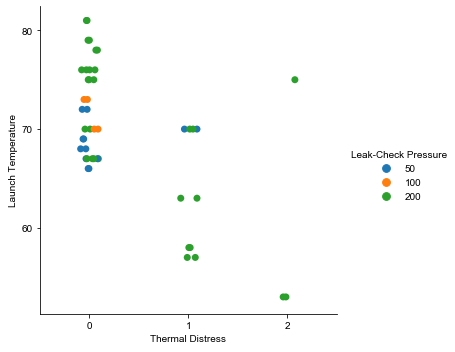

In [8]:
ax = sns.catplot(x='Thermal Distress', y='Launch Temperature', hue='Leak-Check Pressure', data=df_challenger, s=7)
sns.set(font_scale=2)

In [9]:
#Train and Test 17 datasets
#Airfoil
x_airfoil1 = df_airfoil.drop(['Frequency'], axis = 1)
y_airfoil1 = df_airfoil['Frequency']
y_airfoil1 = np.reshape(y_airfoil1.values, (-1,1))
x_airfoil2 = df_airfoil.drop(['Angle of Attack'], axis = 1)
y_airfoil2 = df_airfoil['Angle of Attack']
#x_airfoil2 = df_airfoil.drop(['Free-stream velocity','category'], axis = 1)
#y_airfoil2 = df_airfoil['category']
#y_airfoil2=to_categorical(y_airfoil2)
#Wdbc
#x_wdbc = df_wdbc[['radius_mean','perimeter_mean','area_mean','concavity_mean','concave points_mean','radius_worst','perimeter_worst','area_worst','concave points_worst']]
#y_wdbc = df_wdbc['diagnosis']
#labelencoder_Y = LabelEncoder()
#y_wdbc = labelencoder_Y.fit_transform(y_wdbc)
#Automobile
x_automobile1 = df_automobile.drop(['bore','make','body-style'], axis = 1)
y_automobile1 = df_automobile['bore']
x_automobile2 = df_automobile.drop(['horsepower','make','body-style'], axis = 1)
y_automobile2 = df_automobile['horsepower']
y_automobile2 = np.reshape(y_automobile2.values, (-1,1))
#Autompg
x_autompg1 = df_autompg.drop(['Displacement','Car Name'], axis = 1)
y_autompg1 = df_autompg['Displacement']
y_autompg1 = np.reshape(y_autompg1.values, (-1,1))
x_autompg2 = df_autompg.drop(['Acceleration','Car Name'], axis = 1)
y_autompg2 = df_autompg['Acceleration']
#Challenger
x_challenger1 = df_challenger.drop(['Number of O-rings','Launch Temperature'], axis = 1)
y_challenger1 = df_challenger['Launch Temperature']
x_challenger2 = df_challenger.drop(['Number of O-rings','Leak-Check Pressure'], axis = 1)
y_challenger2 = df_challenger['Leak-Check Pressure']
#y_challenger2=to_categorical(y_challenger2)
#Combine
#x_combine = df_combine.drop(['PE'], axis = 1)
#y_combine = df_combine['PE']
#y_combine = np.reshape(y_combine.values, (-1,1))
#Computer
#x_computer = df_computer.drop(['ERP'], axis = 1)
#y_computer = df_computer['ERP']
#y_computer = np.reshape(y_computer.values, (-1,1))
#Concrete_compressive_strength
#x_concrete_compressive_strength = df_concrete_compressive_strength.drop(['CCS'], axis = 1)
#y_concrete_compressive_strength = df_concrete_compressive_strength['CCS']
#y_concrete_compressive_strength = np.reshape(y_concrete_compressive_strength.values, (-1,1))
#Concrete1
#x_concrete1 = df_concrete1.drop(['No','Compressive Strength (28-day)(Mpa)'], axis = 1)
#y_concrete1 = df_concrete1['Compressive Strength (28-day)(Mpa)']
#Concrete2
#x_concrete2 = df_concrete2.drop(['No','SLUMP(cm)'], axis = 1)
#y_concrete2 = df_concrete2['SLUMP(cm)']
#y_concrete2 = np.reshape(y_concrete2.values, (-1,1))
#Concrete3
#x_concrete3 = df_concrete3.drop(['No','FLOW(cm)'], axis = 1)
#y_concrete3 = df_concrete3['FLOW(cm)']
#y_concrete3 = np.reshape(y_concrete3.values, (-1,1))
#Energy1
#x_energy1 = df_energy1.drop(['Y1'], axis = 1)
#y_energy1 = df_energy1['Y1']
#Energy2
#x_energy2 = df_energy2.drop(['Y2'], axis = 1)
#y_energy2 = df_energy2['Y2']
#Fertility
#x_fertility = df_fertility.drop(['Diagnosis'], axis = 1)
#y_fertility = df_fertility['Diagnosis']
#Forest
#x_forest = df_forest.drop(['month','day','area'], axis = 1)
#y_forest = df_forest['area']
#y_forest = np.reshape(y_forest.values, (-1,1))
#Housing
#x_housing = df_housing.drop(['MEDV'], axis = 1)
#y_housing = df_housing['MEDV']
#Istanbul
#x_istanbul = df_istanbul.drop(['date','ISE1','ISE2'], axis = 1)
#y_istanbul = df_istanbul[['ISE1','ISE2']]
#y_istanbul['mean'] = y_istanbul.mean(axis=1)
#y_istanbul = y_istanbul['mean']

In [10]:
x_train_airfoil1, x_test_airfoil1, y_train_airfoil1, y_test_airfoil1 = train_test_split1(x_airfoil1, y_airfoil1)
x_train_airfoil2, x_test_airfoil2, y_train_airfoil2, y_test_airfoil2 = train_test_split1(x_airfoil2, y_airfoil2)
x_train_automobile1, x_test_automobile1, y_train_automobile1, y_test_automobile1 = train_test_split1(x_automobile1, y_automobile1)
x_train_automobile2, x_test_automobile2, y_train_automobile2, y_test_automobile2 = train_test_split1(x_automobile2, y_automobile2)
x_train_autompg1, x_test_autompg1, y_train_autompg1, y_test_autompg1 = train_test_split1(x_autompg1, y_autompg1)
x_train_autompg2, x_test_autompg2, y_train_autompg2, y_test_autompg2 = train_test_split1(x_autompg2, y_autompg2)
x_train_challenger1, x_test_challenger1, y_train_challenger1, y_test_challenger1 = train_test_split1(x_challenger1, y_challenger1)
x_train_challenger2, x_test_challenger2, y_train_challenger2, y_test_challenger2 = train_test_split1(x_challenger2, y_challenger2)
#x_train_combine, x_test_combine, y_train_combine, y_test_combine = train_test_split1(x_combine, y_combine)
#x_train_computer, x_test_computer, y_train_computer, y_test_computer = train_test_split1(x_computer, y_computer)
#x_train_concrete_compressive_strength, x_test_concrete_compressive_strength, y_train_concrete_compressive_strength, y_test_concrete_compressive_strength = train_test_split1(x_concrete_compressive_strength, y_concrete_compressive_strength)
#x_train_concrete1, x_test_concrete1, y_train_concrete1, y_test_concrete1 = train_test_split1(x_concrete1, y_concrete1)
#x_train_concrete2, x_test_concrete2, y_train_concrete2, y_test_concrete2 = train_test_split1(x_concrete2, y_concrete2)
#x_train_concrete3, x_test_concrete3, y_train_concrete3, y_test_concrete3 = train_test_split1(x_concrete3, y_concrete3)
#x_train_energy1, x_test_energy1, y_train_energy1, y_test_energy1 = train_test_split1(x_energy1, y_energy1)
#x_train_energy2, x_test_energy2, y_train_energy2, y_test_energy2 = train_test_split1(x_energy2, y_energy2)
#x_train_fertility, x_test_fertility, y_train_fertility, y_test_fertility = train_test_split1(x_fertility, y_fertility)
#x_train_forest, x_test_forest, y_train_forest, y_test_forest = train_test_split1(x_forest, y_forest)
#x_train_housing, x_test_housing, y_train_housing, y_test_housing = train_test_split1(x_housing, y_housing)
#x_train_istanbul, x_test_istanbul, y_train_istanbul, y_test_istanbul = train_test_split1(x_istanbul, y_istanbul)
#x_train_wdbc, x_test_wdbc, y_train_wdbc, y_test_wdbc = train_test_split1(x_wdbc, y_wdbc)

In [11]:
def train_val_split(x_train, y_train):
    X_train, X_val, Y_train, Y_val= train_test_split(x_train, y_train, test_size=0.176, random_state=42)
    return X_train, X_val, Y_train, Y_val

In [12]:
def standard_scaler(X_train, X_val, x_test):
    sc=StandardScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=sc.fit(X_train)
    #X_scale_val=sc.fit(X_val)
    #x_scale_test=sc.fit(x_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    return X_train, X_val, x_test, X_scale_train

In [13]:
def min_max_scaler(X_train, X_val, x_test, Y_train, Y_val, y_test):
    min_max_x=MinMaxScaler()
    min_max_y=MinMaxScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=min_max_x.fit(X_train)
    #X_scale_val=min_max_x.fit(X_val)
    #x_scale_test=min_max_x.fit(x_test)
    Y_scale_train=min_max_y.fit(Y_train)
    #Y_scale_val=min_max_y.fit(Y_val)
    #y_scale_test=min_max_y.fit(y_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    Y_train=Y_scale_train.transform(Y_train)
    Y_val=Y_scale_train.transform(Y_val)
    y_test=Y_scale_train.transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test, X_scale_train, Y_scale_train

In [14]:
def normalization(X_train, X_val, x_test, Y_train, Y_val, y_test):
    normalizer=Normalizer()
    X_train=normalizer.fit_transform(X_train)
    X_val=normalizer.fit_transform(X_val)
    x_test=normalizer.fit_transform(x_test)
    Y_train=normalizer.fit_transform(Y_train)
    Y_val=normalizer.fit_transform(Y_val)
    y_test=normalizer.fit_transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test

In [15]:
#Optimizer list
adam0 = 'adam'
adam1 = optimizers.Adam(lr=0.001)
adam2 = optimizers.Adam(lr=0.01)
adam3 = optimizers.Adam(lr=0.0001)
adam4 = optimizers.Adam(lr=0.00001)
sgd = optimizers.SGD(lr=0.005, decay=1e-4, momentum=0.9, nesterov=True)
RMSprop= optimizers.RMSprop(lr=0.001,rho=0.9)
adagrad = optimizers.Adagrad(lr=0.01)
adadelta = optimizers.Adadelta(lr=1.0)

In [16]:
def NN_model_structure_classification(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test, classes):
    model = Sequential()
    model.add(Dense(units = 5, kernel_initializer='uniform', input_dim = (X_train.shape[1])))
    model.add(Activation('relu'))
    model.add(Dense(units = 10, kernel_initializer='uniform'))
    model.add(Activation('relu'))
    model.add(Dense(units = 20, kernel_initializer='uniform'))
    model.add(Dense(units = classes, activation='softmax'))
    model.compile(optimizer = adam , loss = 'categorical_crossentropy', metrics=['acc'])
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [17]:
def NN_model_structure_regression(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test):
    model = Sequential()
    model.add(Dense(units = 5, input_dim = (X_train.shape[1])))
    model.add(Activation('tanh'))
    model.add(Dense(units = 10))
    model.add(Activation('linear'))
    model.add(Dense(units = 1))
    model.compile(optimizer = adam , loss = 'mse')
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [18]:
X_train_airfoil1, X_val_airfoil1, Y_train_airfoil1, Y_val_airfoil1 = train_val_split(x_train_airfoil1, y_train_airfoil1)
X_train_airfoil2, X_val_airfoil2, Y_train_airfoil2, Y_val_airfoil2 = train_val_split(x_train_airfoil2, y_train_airfoil2)
X_train_automobile1, X_val_automobile1, Y_train_automobile1, Y_val_automobile1 = train_val_split(x_train_automobile1, y_train_automobile1)
X_train_automobile2, X_val_automobile2, Y_train_automobile2, Y_val_automobile2 = train_val_split(x_train_automobile2, y_train_automobile2)
X_train_autompg1, X_val_autompg1, Y_train_autompg1, Y_val_autompg1 = train_val_split(x_train_autompg1, y_train_autompg1)
X_train_autompg2, X_val_autompg2, Y_train_autompg2, Y_val_autompg2 = train_val_split(x_train_autompg2, y_train_autompg2)
X_train_challenger1, X_val_challenger1, Y_train_challenger1, Y_val_challenger1 = train_val_split(x_train_challenger1, y_train_challenger1)
X_train_challenger2, X_val_challenger2, Y_train_challenger2, Y_val_challenger2 = train_val_split(x_train_challenger2, y_train_challenger2)
#X_train_combine, X_val_combine, Y_train_combine, Y_val_combine = train_val_split(x_train_combine, y_train_combine)
#X_train_computer, X_val_computer, Y_train_computer, Y_val_computer = train_val_split(x_train_computer, y_train_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength = train_val_split(x_train_concrete_compressive_strength, y_train_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, Y_train_concrete1, Y_val_concrete1 = train_val_split(x_train_concrete1, y_train_concrete1)
#X_train_concrete2, X_val_concrete2, Y_train_concrete2, Y_val_concrete2 = train_val_split(x_train_concrete2, y_train_concrete2)
#X_train_concrete3, X_val_concrete3, Y_train_concrete3, Y_val_concrete3 = train_val_split(x_train_concrete3, y_train_concrete3)
#X_train_energy1, X_val_energy1, Y_train_energy1, Y_val_energy1 = train_val_split(x_train_energy1, y_train_energy1)
#X_train_energy2, X_val_energy2, Y_train_energy2, Y_val_energy2 = train_val_split(x_train_energy2, y_train_energy2)
#X_train_fertility, X_val_fertility, Y_train_fertility, Y_val_fertility = train_val_split(x_train_fertility, y_train_fertility)
#X_train_forest, X_val_forest, Y_train_forest, Y_val_forest = train_val_split(x_train_forest, y_train_forest)
#X_train_housing, X_val_housing, Y_train_housing, Y_val_housing = train_val_split(x_train_housing, y_train_housing)
#X_train_istanbul, X_val_istanbul, Y_train_istanbul, Y_val_istanbul = train_val_split(x_train_istanbul, y_train_istanbul)
#X_train_wdbc, X_val_wdbc, Y_train_wdbc, Y_val_wdbc = train_val_split(x_train_wdbc, y_train_wdbc)

In [19]:
X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1, X_scale_train_airfoil1, Y_scale_train_airfoil1 =min_max_scaler(X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1)
X_train_airfoil2, X_val_airfoil2, x_test_airfoil2, X_scale_train_airfoil2=standard_scaler(X_train_airfoil2, X_val_airfoil2, x_test_airfoil2)
X_train_automobile1, X_val_automobile1, x_test_automobile1, X_scale_train_automobile1=standard_scaler(X_train_automobile1, X_val_automobile1, x_test_automobile1)
X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2, X_scale_train_automobile2, Y_scale_train_automobile2=min_max_scaler(X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2)
X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1, X_scale_train_autompg1, Y_scale_train_autompg1=min_max_scaler(X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1)
X_train_autompg2, X_val_autompg2, x_test_autompg2, X_scale_train_autompg2=standard_scaler(X_train_autompg2, X_val_autompg2, x_test_autompg2)
X_train_challenger1, X_val_challenger1, x_test_challenger1, X_scale_train_challenger1=standard_scaler(X_train_challenger1, X_val_challenger1, x_test_challenger1)
X_train_challenger2, X_val_challenger2, x_test_challenger2, X_scale_train_challenger2=standard_scaler(X_train_challenger2, X_val_challenger2, x_test_challenger2)
#X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine, min_max_combine=min_max_scaler(X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine)
#X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer, min_max_computer=min_max_scaler(X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength, min_max_concrete_compressive_strength=min_max_scaler(X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, x_test_concrete1, X_scale_train_concrete1=standard_scaler(X_train_concrete1, X_val_concrete1, x_test_concrete1)
#X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2, min_max_concrete2=min_max_scaler(X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2)
#X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3, min_max_concrete3=min_max_scaler(X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3)
#X_train_energy1, X_val_energy1, x_test_energy1, X_scale_train_energy1=standard_scaler(X_train_energy1, X_val_energy1, x_test_energy1)
#X_train_energy2, X_val_energy2, x_test_energy2, X_scale_train_energy2=standard_scaler(X_train_energy2, X_val_energy2, x_test_energy2)
#X_train_fertility, X_val_fertility, x_test_fertility, X_scale_train_fertility=standard_scaler(X_train_fertility, X_val_fertility, x_test_fertility)
#X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest, min_max_forest=min_max_scaler(X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest)
#X_train_housing, X_val_housing, x_test_housing, X_scale_train_housing=standard_scaler(X_train_housing, X_val_housing, x_test_housing)
#X_train_istanbul, X_val_istanbul, x_test_istanbul, X_scale_train_istanbul=standard_scaler(X_train_istanbul, X_val_istanbul, x_test_istanbul)

In [21]:
model_airfoil1, history_airfoil1, evaluate_airfoil1=NN_model_structure_regression(X_train_airfoil1, X_val_airfoil1, Y_train_airfoil1, Y_val_airfoil1, adam2, 64, 100, x_test_airfoil1, y_test_airfoil1)
model_airfoil1.get_weights()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 5)                 30        
_________________________________________________________________
activation_1 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_2 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 11        
Total params: 101
Trainable params: 101
Non-trainable params: 0
_________________________________________________________________

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 376us/step - l

1052/1052 [==============================] - 0s 43us/step - loss: 0.0097 - val_loss: 0.0150
Epoch 68/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 69/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 70/100
1052/1052 [==============================] - 0s 45us/step - loss: 0.0097 - val_loss: 0.0141
Epoch 71/100
1052/1052 [==============================] - 0s 44us/step - loss: 0.0096 - val_loss: 0.0143
Epoch 72/100
1052/1052 [==============================] - 0s 49us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 73/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 74/100
1052/1052 [==============================] - 0s 47us/step - loss: 0.0097 - val_loss: 0.0150
Epoch 75/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 76/100
1052/1052 [==============================] - 0s 41us/st

[array([[ 1.50759774e-03, -2.66523480e-01,  3.52690876e-01,
         -1.49186063e+00, -2.26682112e-01],
        [ 3.77392396e-02,  2.56166279e-01, -7.66300261e-01,
         -5.04821837e-01, -4.31699455e-02],
        [ 1.81286484e-01,  1.14066154e-02,  3.39563489e-01,
          3.72537881e-01,  1.36100650e-02],
        [ 6.86735846e-03,  2.78147962e-02, -1.09124273e-01,
         -1.26285285e-01,  5.85588396e-01],
        [-1.08024344e-01, -2.66391903e-01,  7.40145802e-01,
         -1.94989121e+00, -2.53560454e-01]], dtype=float32),
 array([-0.03703028, -0.09728345,  0.06855839,  0.25453943,  0.13824484],
       dtype=float32),
 array([[-3.56915355e-01, -5.56515381e-02,  1.92685157e-01,
         -5.04042327e-01,  3.78369451e-01, -4.05993581e-01,
          3.59354645e-01,  4.21862483e-01,  5.37804842e-01,
          5.44518411e-01],
        [-2.28406146e-01,  2.64653057e-01,  3.68087202e-01,
          7.24924445e-01,  3.96474391e-01, -2.15847611e-01,
         -1.50595112e-02, -4.19215232e-

In [22]:
model_airfoil2, history_airfoil2, evaluate_airfoil2=NN_model_structure_regression(X_train_airfoil2, X_val_airfoil2, Y_train_airfoil2, Y_val_airfoil2, adam2, 64, 100, x_test_airfoil2, y_test_airfoil2)
model_airfoil2.get_weights()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 5)                 30        
_________________________________________________________________
activation_3 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_5 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_4 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 11        
Total params: 101
Trainable params: 101
Non-trainable params: 0
_________________________________________________________________
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 165us/step - lo

1052/1052 [==============================] - 0s 46us/step - loss: 0.7887 - val_loss: 0.9823
Epoch 70/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.7569 - val_loss: 0.9224
Epoch 71/100
1052/1052 [==============================] - 0s 45us/step - loss: 0.7759 - val_loss: 0.9419
Epoch 72/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.8354 - val_loss: 0.9862
Epoch 73/100
1052/1052 [==============================] - 0s 44us/step - loss: 0.7479 - val_loss: 0.9192
Epoch 74/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.7254 - val_loss: 1.0014
Epoch 75/100
1052/1052 [==============================] - 0s 44us/step - loss: 0.7321 - val_loss: 0.9847
Epoch 76/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.7121 - val_loss: 0.9276
Epoch 77/100
1052/1052 [==============================] - 0s 46us/step - loss: 0.6991 - val_loss: 0.9293
Epoch 78/100
1052/1052 [==============================] - 0s 47us/st

[array([[ 2.7421697e-03, -3.3945370e-01,  2.1127708e-01, -3.9729044e-02,
          9.9635601e-02],
        [ 1.3602097e-01, -4.0642258e-02,  6.6508174e-01, -1.9071889e+00,
         -2.7241084e-01],
        [-1.3398970e-02, -6.8247430e-02, -5.6481433e-01,  5.6473445e-02,
         -7.6353714e-02],
        [-2.9115484e+00,  1.6870711e+00, -5.6507021e-01,  4.6826631e-01,
          1.1018184e+00],
        [ 6.0359400e-02,  1.0728004e+00, -9.3161548e-03, -4.0277876e-02,
         -1.0093494e-01]], dtype=float32),
 array([-2.737564  ,  0.28172633, -1.2780974 , -3.034028  , -0.5913799 ],
       dtype=float32),
 array([[ 0.8146088 , -1.2617334 , -1.5740702 , -0.91127896, -1.6754055 ,
         -2.155965  ,  1.7904993 , -1.5395502 ,  1.2273823 ,  1.6127986 ],
        [ 0.22440542,  0.23423737,  0.2485055 , -0.09963165,  0.24698229,
         -0.16507919,  0.374322  ,  0.29763055, -0.53402776,  0.21583578],
        [ 0.11362813,  0.5837862 ,  0.18215092, -0.5172409 ,  0.02431745,
         -0.4419347

In [20]:
model_automobile1, history_automobile1, evaluate_automobile1=NN_model_structure_regression(X_train_automobile1, X_val_automobile1, Y_train_automobile1, Y_val_automobile1, adam2, 64, 100, x_test_automobile1, y_test_automobile1)
model_automobile1.get_weights()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 5)                 115       
_________________________________________________________________
activation_1 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_2 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 11        
Total params: 186
Trainable params: 186
Non-trainable params: 0
_________________________________________________________________

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 3ms/step - loss: 1

[array([[ 0.19620864,  0.35199222, -0.05825145, -0.33713356,  0.15844752],
        [-0.2691107 ,  0.41924644,  0.01143616,  0.18797712,  0.25584474],
        [-0.4724929 , -0.3493459 ,  0.04212838,  0.6695438 , -0.64557385],
        [ 0.01597609,  0.2074427 , -0.11120809, -0.2038236 ,  0.3636374 ],
        [-0.56259555,  0.24704945, -0.32298332,  0.23566802, -0.33818042],
        [ 0.0428225 , -0.03941064, -0.48371404, -0.44467148, -0.14888102],
        [ 0.3284111 ,  0.26938695, -0.28597543, -0.3366009 ,  0.5402353 ],
        [-0.01757254, -0.14608003,  0.09829435,  0.47954947,  0.28657806],
        [-0.04782809, -0.5248311 , -0.11039886,  0.09784522, -0.16225585],
        [ 0.09406651,  0.10123865,  0.25402766, -0.09894613, -0.31403875],
        [-0.13266915, -0.10165365,  0.0944799 ,  0.01137428,  0.35508776],
        [ 0.14956868,  0.20896944,  0.40337905,  0.12309158,  0.05614265],
        [-0.56707925, -0.09094713, -0.2216353 ,  0.0112304 , -0.35459808],
        [ 0.18710382,  0.

In [21]:
#PSO
from random import seed
def initial_sol(particles, model, limit):
    np.random.seed(7)
    weights_list=[]
    for j in range(particles):
        print('particle',j)
        #np.random.seed(j+12)
        weight = [np.random.uniform(low = -limit, high = limit, size=(w.shape)) for w in model.get_weights()]
        weights_list.append(weight)
    return weights_list 

In [22]:
def particle_list_generate(particles, model, weights, X_train, Y_train, X_val, Y_val, x_test, y_test, epoch):
    particle_list=[]
    evaluate_list=[]
    train_val_test=[]
    for j in range(particles):
        model.set_weights(weights[j])
        model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
        model_history= model_training.history
        train_list=list(model_history['loss'])
        train_val_test.append(train_list[epoch-1])
        val_list=list(model_history['val_loss'])
        train_val_test.append(val_list[epoch-1])
        model_evaluation=model.evaluate(x_test, y_test, verbose=0)
        train_val_test.append(model_evaluation)
        weight = model.get_weights()
        particle_list.append(weight)
        evaluate_list.append(train_val_test)
        train_val_test=[]
    return particle_list, evaluate_list

In [23]:
def global_best(evaluate_list, pbest_list):
    #list_score=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\particle_best_list.csv')
    result_global_best=[]
    compare_val=math.inf
    compare_test=math.inf
    for i in range(len(evaluate_list)):
        if evaluate_list[i][1]<compare_val:
            if evaluate_list[i][2]<compare_test:
                compare_val=evaluate_list[i][1]
                compare_test=evaluate_list[i][2]
                global_best_train=evaluate_list[i][0]
                global_best_val=compare_val
                global_best_test=compare_test
                weight_global_best=pbest_list[i]
    result_global_best.append(global_best_train)
    result_global_best.append(global_best_val)
    result_global_best.append(global_best_test)
    return result_global_best, weight_global_best

In [24]:
def initial_velocity(particles, model, limit):
    initial_velocity=[]
    for i in range(particles):
        velocity_weights=[np.random.uniform(low = -(limit*0.1), high = (limit*0.1), size=(w.shape)) for w in model.get_weights()]
        initial_velocity.append(velocity_weights)
    return initial_velocity

In [25]:
def update_velocity(particles, velocity, weight_global_best, particle_list, pbest_list, w, c1, c2, limit):
    update_velocity_list=[]
    for i in range(particles):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        eq1=c1*r1*(np.array(weight_global_best)-np.array(particle_list[i]))
        eq2=c2*r2*(np.array(pbest_list[i])-np.array(particle_list[i]))
        update_velocity=(w*np.array(velocity[i]))+eq1+eq2
        for array in range(len(update_velocity)):
            update_velocity[array][update_velocity[array]<-(limit*0.1)]=-(limit*0.1)
            update_velocity[array][update_velocity[array]>(limit*0.1)]=(limit*0.1)
        update_velocity_list.append(update_velocity)
    return update_velocity_list

In [26]:
def update_solution(particles, particle_list, velocity, limit):
    solution_list=[]
    for i in range(particles):
        update_solution=np.array(particle_list[i])+np.array(velocity[i])
        for array in range(len(update_solution)):
            update_solution[array][update_solution[array]<-limit]=-limit
            update_solution[array][update_solution[array]>limit]=limit
        solution_list.append(update_solution)
    return solution_list

In [27]:
def generate_PSO(iteration, velocity, weight_global_best, particle_list, pbest_list, 
                 model, X_train, Y_train, X_val, Y_val, x_test, y_test, pbest_list_result, 
                 result_global_best, limit):
    wmax=1.0
    wmin=0.1
    cmax=2.5
    cmin=0.5
    
    w_list=[]
    c1_list=[]
    c2_list=[]
    result_global_best_list=[]
    
    for i in range(iteration):
        iteration1=i+1
        w=wmax-(((wmax-wmin)/iteration)*iteration1)
        c1=(cmin-cmax)*(iteration1/iteration)+cmax
        c2=(cmax-cmin)*(iteration1/iteration)+cmin
        velocity=update_velocity(10, velocity, weight_global_best, particle_list, pbest_list, w, c1, c2, limit)
        weights=update_solution(10, particle_list, velocity, limit)
        particle_list, particle_list_result=particle_list_generate(10, model, weights, X_train, Y_train, X_val, Y_val, 
                                                          x_test, y_test, 100)
        for j in range(len(particle_list)):
            if particle_list_result[j][1]<pbest_list_result[j][1]:
                if particle_list_result[j][2]<pbest_list_result[j][2]:
                    pbest_list_result[j]=particle_list_result[j]
                    pbest_list[j]=particle_list[j]
            if pbest_list_result[j][1]<result_global_best[1]:
                if pbest_list_result[j][2]<result_global_best[2]:
                    result_global_best=pbest_list_result[j]
                    weight_global_best=pbest_list[j]
            
        w_list.append(w)
        c1_list.append(c1)
        c2_list.append(c2)
        result_global_best_list.append(result_global_best)
            
    return weight_global_best, result_global_best, result_global_best_list, w_list, c1_list, c2_list

In [37]:
#Airfoil1
weights_airfoil1=initial_sol(10, model_airfoil1, 1)
particle_list_airfoil1, particle_list_result_airfoil1=particle_list_generate(10, model_airfoil1, weights_airfoil1, X_train_airfoil1, Y_train_airfoil1, X_val_airfoil1, Y_val_airfoil1, x_test_airfoil1, y_test_airfoil1, 100)
pbest_list_airfoil1=list(particle_list_airfoil1)
pbest_list_result_airfoil1=list(particle_list_result_airfoil1)
result_global_best_airfoil1, weight_global_best_airfoil1=global_best(pbest_list_result_airfoil1, pbest_list_airfoil1)
velocity_airfoil1=initial_velocity(10, model_airfoil1, 1)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.2102 - val_loss: 0.0395
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0171 - val_loss: 0.0167
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0141 - val_loss: 0.0165
Epoch 4/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0142 - val_loss: 0.0165
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0141 - val_loss: 0.0188
Epoch 6/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0144 - val_loss: 0.0177
Epoch 7/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0134 - val_loss: 0.0161
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0133 - val_loss: 0.0173
Epoch 9/1

1052/1052 [==============================] - 0s 91us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0114 - val_loss: 0.0155
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0112 - val_loss: 0.0154
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0113 - val_loss: 0.0154
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0111 - val_loss: 0.0150
Epoch 59/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0113 - val_loss: 0.0154
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0154
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0111 - val_loss: 0.0162
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0155
Epoch 63/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0153 - val_loss: 0.0171
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0147 - val_loss: 0.0165
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0143 - val_loss: 0.0162
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0138 - val_loss: 0.0164
Epoch 12/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0134 - val_loss: 0.0159
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0129 - val_loss: 0.0156
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0127 - val_loss: 0.0152
Epoch 15/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0124 - val_loss: 0.0152
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0121 - val_loss: 0.0151
Epoch 17/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 103us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 64/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 65/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 66/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0146
Epoch 70/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0093 - val_loss: 0.0145
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 72/100
1052/1052 [==============================] - 0s 87u

1052/1052 [==============================] - 0s 90us/step - loss: 0.0130 - val_loss: 0.0163
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0128 - val_loss: 0.0166
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0125 - val_loss: 0.0166
Epoch 20/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0122 - val_loss: 0.0158
Epoch 21/100
1052/1052 [==============================] - 0s 131us/step - loss: 0.0124 - val_loss: 0.0163
Epoch 22/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0120 - val_loss: 0.0154
Epoch 23/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0116 - val_loss: 0.0162
Epoch 24/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0130 - val_loss: 0.0164
Epoch 25/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0116 - val_loss: 0.0156
Epoch 26/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0102 - val_loss: 0.0175
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0157
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0099 - val_loss: 0.0138
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3481 - val_loss: 0.0690
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0298 - val_loss: 0.0227
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0192 - val_loss: 0.0192
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 87us/step - loss: 0.0117 - val_loss: 0.0144
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0150
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0115 - val_loss: 0.0142
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_loss: 0.0138
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0114 - val_loss: 0.0144
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0140
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0108 - val_loss: 0.0144
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0146
Epoch 58/100
1052/1052 [==============================] - 0s 87us/st

In [38]:
#PSO-MLP with Airfoil
weight_global_best_airfoil1_PSO, result_global_best_airfoil1_PSO, list_global_best_airfoil1_PSO, w_list_airfoil1, c1_list_airfoil1, c2_list_airfoil1=generate_PSO(100, velocity_airfoil1, weight_global_best_airfoil1, particle_list_airfoil1, pbest_list_airfoil1, 
                                                      model_airfoil1, X_train_airfoil1, Y_train_airfoil1, X_val_airfoil1, Y_val_airfoil1, 
                                                    x_test_airfoil1, y_test_airfoil1, pbest_list_result_airfoil1, result_global_best_airfoil1, 1)

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0197 - val_loss: 0.0158
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0117 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0116 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_loss: 0.0144
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0106 - val_loss: 0.0153
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0108 - val_loss: 0.0166
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0112 - val_loss: 0.0145
Epoch 10/100
1052

1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0098 - val_loss: 0.0126
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 14/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0095 - val_loss: 0.0127
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 18/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0150
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 92us/s

Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0135
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0097 - val_loss: 0.0145
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0282 - val_loss: 0.0161
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0133 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0123 - val_loss: 0.0164
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0117 - val_loss: 0.0161
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0115 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 110us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 55/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 109us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.0090 - val_loss: 0.0147
Epoch 60/100
1052/1052 [===========

1052/1052 [==============================] - 0s 89us/step - loss: 0.0122 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0112 - val_loss: 0.0144
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0145
Epoch 12/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0103 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step -

1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0144
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.0095 - val_loss: 0.0139
Epoch 38/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0094 - val_loss: 0.0164
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 46/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0086 - val_loss: 0.0115
Epoch 48/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0146
Epoch 51/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0138
Epoch 54/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 94

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0278 - val_loss: 0.0166
Epoch 2/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0120 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0110 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0108 - val_loss: 0.0140
Epoch 5/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0106 - val_loss: 0.0134
Epoch 6/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0103 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.0103 - val_loss: 0.0142
Epoch 10/1

1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 62/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 106us

1052/1052 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0152
Epoch 18/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0146 - val_loss: 0.0149
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0121 - val_loss: 0.0145
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0107 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0133
Epoch 5/100
1052/1052 [=

Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0153
Epoch 78/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0161
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 92/100
1052/1052 [==============================] - 0s 95us/s

Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0146
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0154
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0146
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 47/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0165 - val_loss: 0.0155
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 56/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0159 - val_loss: 0.0155
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0118 - val_loss: 0.0143
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0113 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0143
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0138
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0131
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 9/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 57/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0116
Epoch 60/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0117
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 65/100
1052/1052 [==============================] - 0s 90us/st

Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 44/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 47/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0096 - val_loss: 0.0145
Epoch 48/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 49/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 50/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 51/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 52/100
1052/1052 [==============================] - 0s 97

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0193 - val_loss: 0.0152
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0108 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0103 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0107 - val_loss: 0.0136
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0152
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step 

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 92us/s

Epoch 39/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0089 - val_loss: 0.0147
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0142
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 48/100
1052/1052 [========================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0161 - val_loss: 0.0256
Epoch 2/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0144 - val_loss: 0.0164
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0144
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0144 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0123 - val_loss: 0.0159
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 67/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 96us/step - loss: 0.0098 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0122
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0135
Epoch 99/100
1052/1052 [==============================] - 0s 91us/st

Epoch 68/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================]

Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 24/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0148
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================]

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0175 - val_loss: 0.0152
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0124 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0156
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0166
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0129
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 10/100
1052

1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 87us/st

Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 35/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 38/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 89us/s

Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0142
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0271 - val_loss: 0.0153
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0124 - val_loss: 0.0169
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0121 - val_loss: 0.0143
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0110 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0107 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0159
Epoch 7/100
1

1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0145
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 102us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0154
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0132
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0148
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0123
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 106us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 40/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 41/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 47/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0314 - val_loss: 0.0174
Epoch 2/100
1052/1052

Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 54/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0127 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0123 - val_loss: 0.0162
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0120 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0110 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0107 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0152
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - lo

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 60/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 106us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0142
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 72/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 75/100
1052/1052 [==============================] - 0s 91us/st

Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0143
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0246 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0129 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0114 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 8/100
1052/1052 [====

Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0094 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0143
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 97us/step - loss: 0.0099 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0108 - val_loss: 0.0162
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0150
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 90us/ste

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 95/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 107us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0211 - val_loss: 0.0205
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0127 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0137
Epoch 4/100
1052/1052 

Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 74/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 75/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 36/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 87us/st

Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0156
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0142
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================]

Epoch 92/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 91us/st

Epoch 24/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0143
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 41/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 97/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0092 - val_loss: 0.0120
Epoch 25/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 26/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 29/100
1052/1052 [===========================

Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0235 - val_loss: 0.0179
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0132 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0119 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0103 - val_loss: 0.0133
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0149
Epoch 7/100
1

1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0166
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0093 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0139
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0155
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 70/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0142
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 24/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 77/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 90us/st

Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0130 - val_loss: 0.0175
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0124 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0117 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - lo

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 66/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 12/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 20/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 75/100
1052/1052 [==============================] - 0s 89us/st

Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0181 - val_loss: 0.0184
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0111 - val_loss: 0.0175
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0108 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0107 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0102 - val_loss: 0.0142
Epoch 8/100
1052/1052 [===

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0133
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0127
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0112 - val_loss: 0.0151
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0159
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step

1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 91us/st

Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 26/100
1052/1052 [==============================]

Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0234 - val_loss: 0.0179
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0134 - val_loss: 0.0158
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0127 - val_loss: 0.0160
Epoch 4/1

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 53/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 120us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 9

1052/1052 [==============================] - 0s 103us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0110 - val_loss: 0.0166
Epoch 5/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0116 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0104 - val_loss: 0.0148
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0103 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0104 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0104 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 11/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 113us

Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0115
Epoch 40/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0120
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 44/100
1052/1052 [==============================] - 0s 90us/st

Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 16/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================

Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 50/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0148
Epoch 54/100
1052/1052 [==============================] - 0s 87

Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0197 - val_loss: 0.0173
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0128 - val_loss: 0.0162
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0123 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0117 - val_loss: 0.0163
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0112 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 9/100
105

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 61/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 93us/st

Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 88/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0115
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0115
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0214 - val_loss: 0.0181
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0127 - val_loss: 0.0172
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0113 - val_loss: 0.0143
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 59/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0112 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0099 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - 

Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================]

Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 82us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 51/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0282 - val_loss: 0.0176
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0140 - val_loss: 0.0160
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0131 - val_loss: 0.0166
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0124 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0116 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 100us/step - lo

Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 66/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0160
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0096 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0098 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 96/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 98/100
1052/1052 [==============================] - 0s 101u

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0156 - val_loss: 0.0179
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0118 - val_loss: 0.0145
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0108 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0132
Epoch 10/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0134
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0141
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0143
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 90us/s

Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 20/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0097 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 25/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0190 - val_loss: 0.0173
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0146
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - ETA: 0s - loss: 0.007 - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 57/100
1052/1052 [====================

1052/1052 [==============================] - 0s 96us/step - loss: 0.0122 - val_loss: 0.0164
Epoch 3/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0119 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0111 - val_loss: 0.0158
Epoch 5/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0105 - val_loss: 0.0156
Epoch 6/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0104 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 10/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0094 - val_loss: 0.0145
Epoch 11/100
1052/1052 [==============================] - 0s 89us/ste

Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0137
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 67/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 89us/st

Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0148
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 77/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0151
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0173 - val_loss: 0.0161
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0127 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0128 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0106 - val_loss: 0.0155
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 40/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 93us/st

Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0231 - val_loss: 0.0152
Epoch 2/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0122 - val_loss: 0.0145
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0141
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0152
Epoch 6/100
1052/1052 [=

Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 76/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 77/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 84/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 34/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 95us/st

Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 97us/st

Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 98/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0136
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0261 - val_loss: 0.0154
Epoch 2/

1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 54/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 79us/s

1052/1052 [==============================] - 0s 87us/step - loss: 0.0212 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0123 - val_loss: 0.0148
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0143
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0101 - val_loss: 0.0183
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0104 - val_loss: 0.0138
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0109 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0130
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - los

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 64/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0097 - val_loss: 0.0129
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0153
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 18/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 122us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 89

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0143
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 50/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 108us/

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0270 - val_loss: 0.0160
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0120 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0117 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0108 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0143
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0107 - val_loss: 0.0157
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0101 - val_loss: 0.0145
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0098 - val_loss: 0.0133
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 13/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step -

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0148
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 76/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================]

Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0220 - val_loss: 0.0182
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0126 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0112 - val_loss: 0.0165
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0102 - val_loss: 0.0152
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0136
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 80/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0143
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0136
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0214 - val_loss: 0.0175
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0124 - val_loss: 0.0168
Epoch 3/100
1052/1052 

Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0113 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0109 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0108 - val_loss: 0.0138
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0099 - val_loss: 0.0154
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - l

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 60/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 67/100
1052/1052 [==============================] - 0s 89us/st

Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0114
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0078 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0078 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 100/100
1052/1052 [==============================] - 0s 93us/s

Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0146
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0225 - val_loss: 0.0183
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0134 - val_loss: 0.0171
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0117 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0122 - val_loss: 0.0151
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0113 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0131
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 66/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0096 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0135
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 20/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 44/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 92us

1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0259 - val_loss: 0.0164
Epoch 2/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0136 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0114 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0106 - val_loss: 0.0137
Epoch 5/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 6/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 7/100
1052/1052

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0100 - val_loss: 0.0128
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step 

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0143
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0141
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0141
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0176 - val_loss: 0.0185
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 91us/st

Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 34/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 87/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0141
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0129
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0172 - val_loss: 0.0170
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0124 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0115 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0106 - val_loss: 0.0140
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 92us/st

Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0152
Epoch 37/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0092 - val_loss: 0.0119
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 39/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 43/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0140
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0212 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0136 - val_loss: 0.0156
Epoch 3/100
1052/1052 

Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0117 - val_loss: 0.0154
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0110 - val_loss: 0.0177
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0105 - val_loss: 0.0166
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0156
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0148
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0105 - val_loss: 0.0144
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 66/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0143
Epoch 18/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0096 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 21/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 90us/st

Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0239 - val_loss: 0.0189
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0131 - val_loss: 0.0166
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0126 - val_loss: 0.0169
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0119 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0106 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 9/100
1052/1052 [======

Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0145
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0154
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0145
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 91us/st

Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================]

Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0173 - val_loss: 0.0169
Epoch 2/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0126 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0120 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0114 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0135
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0146
Epoch 7/100
1

1052/1052 [==============================] - 0s 106us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 

1052/1052 [==============================] - 0s 95us/step - loss: 0.0106 - val_loss: 0.0145
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0136
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0097 - val_loss: 0.0154
Epoch 10/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0099 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 12/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0097 - val_loss: 0.0145
Epoch 15/100
1052/1052 [==============================] - 0s 100us

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 87us/st

Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 71/100
1052/1052 [==============================]

Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================]

Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0145
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0134
Epoch 99/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0208 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0115 - val_loss: 0.0146
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 4/10

1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 58/100
1052/1052 [==============================] - 0s 93us/st

Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 45/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 90us/s

Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 55/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0204 - val_loss: 0.0174
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0120 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0149
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0108 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0104 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - los

Epoch 79/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 81/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 82/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 83/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 85/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 88/100
1052/1052 [=========================

Epoch 34/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 41/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 43/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0141
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0174 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0121 - val_loss: 0.0148
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0110 - val_loss: 0.0144
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0111 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0152
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0100 - val_loss: 0.0160
Epoch 7/100
1052/1052 [===

Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0106 - val_loss: 0.0138
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0144
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step

1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 87/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0151
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0218 - val_loss: 0.0160
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0117 - val_loss: 0.0148
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 110us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 92us/

1052/1052 [==============================] - 0s 103us/step - loss: 0.0116 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0111 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0108 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0100 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0151
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0138
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step

Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 64/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 65/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 67/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0138
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 91us/st

Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 31/100
1052/1052 [==============================]

Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0221 - val_loss: 0.0159
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0114 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0121 - val_loss: 0.0159
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0099 - val_loss: 0.0155
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0130
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 9/100
105

1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 92us/st

Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0141
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 50/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0279 - val_loss: 0.0172
Epoch 2/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0122 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0111 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0108 - val_loss: 0.0161
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0149
Epoch 59/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0104 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0104 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0148
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step -

1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 60/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0145
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 20/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0162
Epoch 22/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 100/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0144
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 54/100
1052/1052 [==============================] - 0s 90us

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0241 - val_loss: 0.0160
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0123 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0122 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0108 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0143
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0144
Epoch 9/100
1052/1052 [======

Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0156
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0116
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0101 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 18/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 96/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 92us/st

Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0173 - val_loss: 0.0177
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0122 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0115 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0106 - val_loss: 0.0152
Epoch 5/100

1052/1052 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 91us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0110 - val_loss: 0.0143
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 9/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 10/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 11/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 12/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 13/100
1052/1052 [==============================] - 0s 98us/ste

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0147
Epoch 91/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 45/100
1052/1052 [==============================] - 0s 89us/st

Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0148
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 18/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 23/100
1052/1052 [==============================]

Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 90us/st

Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 88/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0079 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0144
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0216 - val_loss: 0.0161
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0127 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0157
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0112 - val_loss: 0.0141
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0102 - val_loss: 0.0135
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 60/100
1052/1052 [==============================] - 0s 92us/st

Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================]

Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0142
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0146
Epoch 93/100
1052/1052 [==============================]

Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0144
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0117
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0344 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0124 - val_loss: 0.0154
Epoch 3/100
1052/1052

Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0124 - val_loss: 0.0198
Epoch 4/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0125 - val_loss: 0.0164
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0162
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0113 - val_loss: 0.0162
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0152
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0106 - val_loss: 0.0144
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - 

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 67/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0092 - val_loss: 0.0144
Epoch 17/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 19/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0092 - val_loss: 0.0145
Epoch 20/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s

Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 91/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0080 - val_loss: 0.0117
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0281 - val_loss: 0.0166
Epoch 2/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0124 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0118 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0114 - val_loss: 0.0130
Epoch 6/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 7/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 8/100
1052/105

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0143
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0098 - val_loss: 0.0129
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0093 - val_loss: 0.0158
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0146
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0146
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 95us/st

Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0137
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0214 - val_loss: 0.0210
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0120 - val_loss: 0.0162
Epoch 3/1

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 57/100
1052/1052 [==============================] - 0s 94us/st

Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0151
Epoch 28/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0147
Epoch 32/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 35/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0115
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0113
Epoch 84/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0113
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 91us/st

Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 41/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0142
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0172 - val_loss: 0.0154
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0125 - val_loss: 0.0171
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0119 - val_loss: 0.0168
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0117 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0108 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0103 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0106 - val_loss: 0.0160
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0101 - val_loss: 0.0137
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 84/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0142
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 41/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0115
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 96/100
1052/1052 [==============================] - 0s 91us/st

Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0143
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0139
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0244 - val_loss: 0.0185
Epoch 2/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0122 - val_loss: 0.0147
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0107 - val_loss: 0.0208
Epoch 6/100
1052/1052 [==

Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0157
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0104 - val_loss: 0.0156
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0106 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0103 - val_loss: 0.0158
Epoch 10/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0103 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 12/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0099 - val_loss: 0.0146
Epoch 14/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0098 - val_loss: 0.0145
Epoch 15/100
1052/1052 [==============================] - 0s 103u

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0147
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0121
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 23/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 119us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0115
Epoch 95/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0080 - val_loss: 0.0113
Epoch 96/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 98/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0113
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
10

Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0140
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 53/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 56/100
1052/1052 [============================

1052/1052 [==============================] - 0s 101us/step - loss: 0.0251 - val_loss: 0.0169
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0133 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0108 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 5/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0099 - val_loss: 0.0138
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0155
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0137
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step 

1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 80/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 81/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 82/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 85/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 86/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 87/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 88/100
1052/1052 [==============================] - 0s 10

1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 36/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 23/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 24/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0123
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 28/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 29/100
1052/1052 [==============================]

Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0117
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0208 - val_loss: 0.0175
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0124 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0121 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0112 - val_loss: 0.0173
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0107 - val_loss: 0.0138
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0137
Epoch 7/100
1

1052/1052 [==============================] - 0s 106us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 93u

1052/1052 [==============================] - 0s 93us/step - loss: 0.0114 - val_loss: 0.0158
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0114 - val_loss: 0.0160
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0111 - val_loss: 0.0154
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0150
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0156
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0155
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step 

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 69/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 90us/st

Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0228 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0122 - val_loss: 0.0152
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0143
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 57/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 100us/step - loss: 0.0134 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0121 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0113 - val_loss: 0.0154
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0110 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0112 - val_loss: 0.0138
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - l

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0128
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 17/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0094 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 20/100
1052/1052 [==============================] - 0s 99us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0137
Epoch 93/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 98/100
1052/1052 [==============================] - 0s 95us/st

Epoch 44/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 53/100
1052/1052 [=============================

Epoch 99/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0213 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0120 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0120 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0109 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 7/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0098 - val_loss: 0.0147
Epoch

Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0115
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 63/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0111 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0138
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0134
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 93us/ste

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 91us/st

Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 71/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================]

Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0151
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 21/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0123
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0121
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 28/100
1052/1052 [==============================]

Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0186 - val_loss: 0.0161
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0122 - val_loss: 0.0159
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0145
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0111 - val_loss: 0.0141
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0143
Epoch 6/100


1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 55/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 85us/step - loss: 0.0104 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0104 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0152
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0108 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step -

1052/1052 [==============================] - 0s 111us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 63/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 65/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 66/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 68/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 69/100
1052/1052 [==============================] - 0s 92

1052/1052 [==============================] - 0s 87us/step - loss: 0.0098 - val_loss: 0.0130
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 22/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 104us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 48/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0144
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0148
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0187 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0124 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0117 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0114 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0143
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - los

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 65/100
1052/1052 [==============================] - 0s 91us/st

Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 35/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 123us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 107us/

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 52/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0201 - val_loss: 0.0170
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0120 - val_loss: 0.0174
Epoch 3/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0112 - val_loss: 0.0140
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0162
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0110 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0139
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step 

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 70/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 18/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 24/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 96/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 97/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 98/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0132
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0252 - val_loss: 0.0164
Epoch 2/100
1

Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0114
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 57/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0125 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0100 - val_loss: 0.0177
Epoch 7/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0101 - val_loss: 0.0157
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - 

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 66/100
1052/1052 [==============================] - 0s 94us/st

Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0139
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 97/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 90us/st

Epoch 22/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 23/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0145
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0141
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0144
Epoch 31/100
1052/1052 [==============================]

Epoch 100/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0242 - val_loss: 0.0166
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0124 - val_loss: 0.0168
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0116 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0137
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0145
Epoch 9/100
10

1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 55/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 59/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 63/100
1052/1052 [==============================] - 0s 91

1052/1052 [==============================] - 0s 95us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 16/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 109us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 49/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0138
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0135
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0166 - val_loss: 0.0165
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0121 - val_loss: 0.0158
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0149
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 58/100
1052/1052 [==============================] - 0s 94us/st

Epoch 27/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0116
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0116
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0114
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0115
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 90/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0096 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 54/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0173 - val_loss: 0.0152
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0126 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0114 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0107 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0108 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0103 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 9/100
1052/1052 [=====

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 63/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 17/100
1052/1052 [==============================] - 0s 86us/ste

1052/1052 [==============================] - 0s 102us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 87/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 92/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 93/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 96/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0079 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0222 - val_loss: 0.0156
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0130 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0114 - val_loss: 0.0160
Epoch 4/100
1052/1052 

Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 59/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0112 - val_loss: 0.0142
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0109 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0109 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0099 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0143
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 11/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step -

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 91/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 101us/s

Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0091 - val_loss: 0.0150
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 93us/st

Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 32/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 86/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 92/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 44/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 49/100
1052/1052 [==============================] - 0s 91us/st

Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 26/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================]

Epoch 96/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0084 - val_loss: 0.0117
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0116
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0117
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0202 - val_loss: 0.0156
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0122 - val_loss: 0.0148
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0108 - val_loss: 0.0136
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0132
Epoch 5/10

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0144
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0094 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 93us/st

Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0123
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 35/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 99/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/10

Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 52/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0197 - val_loss: 0.0168
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0124 - val_loss: 0.0158
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0120 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0106 - val_loss: 0.0131
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 6/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0144
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0144
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0102 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0127
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0099 - val_loss: 0.0127
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0151
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 66/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 71/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 74/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0139
Epoch 24/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 76/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 83/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0117
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 34/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 37/100
1052/1052 [==============================] - 0s 89us/s

Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0114
Epoch 92/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0139
Epoch 93/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0141
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 124us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 51/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 95us/step - loss: 0.0176 - val_loss: 0.0158
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0124 - val_loss: 0.0177
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0124 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0113 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0111 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0152
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0111 - val_loss: 0.0159
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - los

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 102us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0117
Epoch 18/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0118
Epoch 19/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0078 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0114
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0114
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0183 - val_loss: 0.0167
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0130 - val_loss: 0.0155
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0121 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0133 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0115 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 89us/st

Epoch 29/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 32/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 86/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 91us/st

Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 46/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0079 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0116
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0233 - val_loss: 0.0204
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0132 - val_loss: 0.0156
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 76/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 77/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 78/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 79/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 80/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 81/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0143
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0158
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 35/100
1052/1052 [==============================] - 0s 111us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 90/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 39/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 44/100
1052/1052 [==============================] - 0s 92us/

1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 52/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 98us/

1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0117
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0186 - val_loss: 0.0184
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0122 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0104 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0100 - val_loss: 0.0134
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 62/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0133
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0123
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0126
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0125
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0121
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 41/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0144
Epoch 43/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 48/100
1052/1052 [==============================] - 0s 90

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0210 - val_loss: 0.0158
Epoch 2/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0120 - val_loss: 0.0178
Epoch 3/100
1052/105

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0124 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0115 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0109 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0102 - val_loss: 0.0144
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0134
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0115 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - lo

Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 84/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0150
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0148
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0138
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 93us/st

Epoch 67/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 74/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 22/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 90us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0127
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 30/100
1052/1052 [====================

Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0162 - val_loss: 0.0159
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0165
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0112 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0104 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0103 - val_loss: 0.0161
Epoch 8/100
10

1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 59/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 62/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0100 - val_loss: 0.0138
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0092 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0098 - val_loss: 0.0146
Epoch 12/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 14/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 96us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0154
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 94/100
1052/1052 [==============================] - 0s 87us/st

Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 68/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 69/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 70/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 71/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 72/100
1052/1052 [============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0142
Epoch 18/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0092 - val_loss: 0.0124
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0122
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0120
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0147
Epoch 24/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 25/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 100us

1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0181 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0122 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0113 - val_loss: 0.0154
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 58/100
1052/1052 [==============================] - 0s 93us/st

Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0147
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 93us/st

Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0118
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 46/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0185 - val_loss: 0.0174
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0122 - val_loss: 0.0161
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0112 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0142
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - los

1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 87/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0143
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0126
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 42/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 89us

Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 50/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0216 - val_loss: 0.0164
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0134 - val_loss: 0.0175
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0124 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0114 - val_loss: 0.0159
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0114 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0155
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 56/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0107 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0103 - val_loss: 0.0137
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0130
Epoch 12/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0139
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step 

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 90us/s

Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0145
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0150
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 68/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 25/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0358 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0126 - val_loss: 0.0148
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 75/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 76/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 81/100
1052/1052 [==============================

Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 29/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0147
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 97us/st

Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0154
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0346 - val_loss: 0.0171
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0132 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0152
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0201
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0129 - val_loss: 0.0154
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0158
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0148
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 83us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0118
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0141
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 63/100
1052/1052 [==============================] - 0s 87us/st

Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 37/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0138
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 90us/st

Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0179 - val_loss: 0.0150
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0147
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0113 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0104 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 58/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.0107 - val_loss: 0.0137
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0143
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0097 - val_loss: 0.0133
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0154
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0128
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0150
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step -

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0116
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0136
Epoch 92/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 39/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 41/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 

1052/1052 [==============================] - 0s 97us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0116
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0174 - val_loss: 0.0155
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0119 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0145
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0114 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0148
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 93us/st

Epoch 11/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0152
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0125
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================

Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 52/100
1052/1052 [==============================] - 0s 87us/st

Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0175
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 26/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0140
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 30/100
1052/1052 [==============================

Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0197 - val_loss: 0.0156
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0122 - val_loss: 0.0174
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0115 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0168
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0103 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 8/100
10

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0104 - val_loss: 0.0164
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0136
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0153
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0099 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0155
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 106us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 67/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 70/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 18/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 19/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 21/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0091 - val_loss: 0.0120
Epoch 22/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 24/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0115
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0272 - val_loss: 0.0236
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0153 - val_loss: 0.0165
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.0125 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0144
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0101 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0136
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0099 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0094 - val_loss: 0.0148
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - l

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 78us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0113 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 16/100
1052/1052 [==============================] - 0s 80us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 18/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0095 - val_loss: 0.0132
Epoch 19/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0145
Epoch 20/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 98/100
1052/1052 [==============================] - 0s 88us/s

Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0140
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0167 - val_loss: 0.0151
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0118 - val_loss: 0.0141
Epoch 3/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 4/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0097 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0119
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0093 - val_loss: 0.0126
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 62/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0133
Epoch 8/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0098 - val_loss: 0.0131
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0128
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0136
Epoch 14/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 15/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 16/100
1052/1052 [==============================] - 0s 100us/ste

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 94/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 48/100
1052/1052 [==============================] - 0s 9

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 98/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0137
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0186 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0117 - val_loss: 0.0156
Epoch 3/100
1052/1

1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 57/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0161 - val_loss: 0.0230
Epoch 3/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0140 - val_loss: 0.0179
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0127 - val_loss: 0.0158
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0118 - val_loss: 0.0155
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0113 - val_loss: 0.0159
Epoch 7/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0111 - val_loss: 0.0185
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0160
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0109 - val_loss: 0.0155
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 62/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 66/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 67/100
1052/1052 [=============================

Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0143
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0143
Epoch 15/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 22/100
1052/1052 [==============================]

Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0141
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0140
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0199 - val_loss: 0.0200
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0125 - val_loss: 0.0169
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0115 - val_loss: 0.0161
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0110 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0152
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0104 - val_loss: 0.0154
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0106 - val_loss: 0.0148
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0160
Epoch 9/100
1052/1052 [======

Epoch 78/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0149
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0123
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 41/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0079 - val_loss: 0.0114
Epoch 93/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0079 - val_loss: 0.0117
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0116
Epoch 96/100
1052/1052 [==============================] - 0s 99u

1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 44/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0140
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0140
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0223 - val_loss: 0.0173
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0120 - val_loss: 0.0154
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0109 - val_loss: 0.0143
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0104 - val_loss: 0.0160
Epoch 5/100
1052/1052 [=

Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 58/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0107 - val_loss: 0.0138
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0100 - val_loss: 0.0141
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0102 - val_loss: 0.0145
Epoch 11/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0103 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0108 - val_loss: 0.0143
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0144
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step 

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 69/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0157
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 16/100
1052/1052 [==============================] - ETA: 0s - loss: 0.010 - 0s 93us/step - loss: 0.0102 - val_loss: 0.0141
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0142
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0140
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0141
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0138
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0149
Epoch 23/100
1052/1052 [====================

Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0115
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1

1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 49/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0247 - val_loss: 0.0173
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0126 - val_loss: 0.0147
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0108 - val_loss: 0.0158
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0149
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0102 - val_loss: 0.0142
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0141
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - los

1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 80/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0134
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 42/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0155
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0148
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0079 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0113
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0116
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0227 - val_loss: 0.0179
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0132 - val_loss: 0.0166
Epoch 3/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0124 - val_loss: 0.0156
Epoch 4/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0117 - val_loss: 0.0164
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0115 - val_loss: 0.0151
Epoch 6/100
1052/1052 [=

1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 122us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0146
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 91us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0105 - val_loss: 0.0134
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0101 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0106 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 12/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 13/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0092 - val_loss: 0.0142
Epoch 14/100
1052/1052 [==============================] - 0s 101us

1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 99us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0131
Epoch 42/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0087 - val_loss: 0.0141
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 45/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 104us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0266 - val_loss: 0.0156
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0133 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0116 - val_loss: 0.0164
Epoch 4/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0114 - val_loss: 0.0153
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 6/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0106 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0106 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0144
Epoch 9/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0099 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - lo

1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 87us/st

Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0140
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0151
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0117
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 49/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0134
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0178 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0113 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0109 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0104 - val_loss: 0.0138
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0098 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0099 - val_loss: 0.0127
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step 

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0095 - val_loss: 0.0128
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0149
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0129
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 73/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 75/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 76/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 77/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 79/100
1052/1052 [==============================] - 0s 94us/st

Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.0120 - val_loss: 0.0145
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0109 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0105 - val_loss: 0.0138
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0100 - val_loss: 0.0135
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - lo

1052/1052 [==============================] - 0s 129us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 82/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 84/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 87/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 88/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0097 - val_loss: 0.0118
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0142
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0137
Epoch 52/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0186 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0122 - val_loss: 0.0171
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0114 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0113 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0109 - val_loss: 0.0162
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0143
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 53/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 54/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 55/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 57/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 61/100
1052/1052 [==============================] - 0s 8

1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0103 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 10/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0096 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0141
Epoch 13/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 15/100
1052/1052 [==============================] - 0s 89us

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 40/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0139
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0242 - val_loss: 0.0168
Epoch 2/100
1052/1052

Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0119
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 80/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 29/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 30/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 33/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 100us/

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 38/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 43/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 94/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0142
Epoch 98/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 52/100
1052/1052 [==============================] - 0s 97us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0139
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0280 - val_loss: 0.0201
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0128 - val_loss: 0.0151
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0119 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0114 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0108 - val_loss: 0.0157
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0139
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 61/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0098 - val_loss: 0.0132
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0098 - val_loss: 0.0148
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0088 - val_loss: 0.0144
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 69/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 70/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 22/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0130
Epoch 24/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0129
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0285 - val_loss: 0.0178
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0129
Epoch 50/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0292 - val_loss: 0.0183
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0130 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0115 - val_loss: 0.0150
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0113 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0108 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0105 - val_loss: 0.0144
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0103 - val_loss: 0.0149
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0145
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0098 - val_loss: 0.0139
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0154
Epoch 65/100
1052/1052 [==============================] - 0s 89us/st

Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0144
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0095 - val_loss: 0.0148
Epoch 15/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 19/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0096 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================

Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 92/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0136
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 46/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 52/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0236 - val_loss: 0.0178
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0134 - val_loss: 0.0146
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0115 - val_loss: 0.0146
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0108 - val_loss: 0.0187
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0114 - val_loss: 0.0147
Epoch 6/100
1052/1052 [=

Epoch 75/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 77/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0117
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 84/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 31/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 32/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 38/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 93/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 40/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0147
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0120
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0221 - val_loss: 0.0206
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 54/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 56/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0222 - val_loss: 0.0180
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0125 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0117 - val_loss: 0.0140
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0111 - val_loss: 0.0141
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0105 - val_loss: 0.0138
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0101 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0147
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0095 - val_loss: 0.0131
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0132
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 65/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 110us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0094 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 16/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0124
Epoch 18/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 88us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0134
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0118
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 92us/st

Epoch 43/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0082 - val_loss: 0.0117
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0243 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0156
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0113 - val_loss: 0.0171
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0110 - val_loss: 0.0152
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0142
Epoch 7/100
1052/1052 [===

Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 62/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 87us/step - loss: 0.0102 - val_loss: 0.0153
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0099 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 10/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0139
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0093 - val_loss: 0.0137
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step

1052/1052 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 89/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0080 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 92/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s

Epoch 40/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0123
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 48/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 49/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0186 - val_loss: 0.0146
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0110 - val_loss: 0.0145
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0111 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0108 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0104 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0105 - val_loss: 0.0150
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0144
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0162
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0151
Epoch 11/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - l

1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 65/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 67/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 100us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 13/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0154
Epoch 14/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 15/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 16/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 17/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0092 - val_loss: 0.0143
Epoch 18/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0091 - val_loss: 0.0124
Epoch 19/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 20/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 21/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0116
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 69/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 70/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0115
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 75/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0147
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0137
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0137
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0123
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0200 - val_loss: 0.0171
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0118 - val_loss: 0.0147
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0133
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0137
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0097 - val_loss: 0.0130
Epoch 6/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0097 - val_loss: 0.0126
Epoch 7/100
1052/1052 [==

1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0108 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0107 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0154
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0105 - val_loss: 0.0167
Epoch 10/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0101 - val_loss: 0.0138
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0142
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0102 - val_loss: 0.0140
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0146
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step 

1052/1052 [==============================] - 0s 106us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 62/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 63/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 64/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 65/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 66/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 67/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 70/100
1052/1052 [==============================] - 0s 90

Epoch 16/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0143
Epoch 22/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 23/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 24/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 25/100
1052/1052 [============================

Epoch 94/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0322 - val_loss: 0.0283
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0159 - val_loss: 0.0168
Epoch 3/

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 57/100
1052/1052 [==============================] - 0s 92us/st

Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 85/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 94us/

1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 44/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 94/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 99/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0080 - val_loss: 0.0129
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0158 - val_loss: 0.0146
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0117 - val_loss: 0.0136
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0107 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0097 - val_loss: 0.0132
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0107 - val_loss: 0.0126
Epoch 8/100
1052/1052 [===

Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 63/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0130
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0138
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0128
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0149
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 17/100
1052/1052 [==============================] - 0s 88us/ste

1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 87/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 88/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 88us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 44/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 45/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 49/100
1052/1052 [==============================] - 0s 10

1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 97/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 98/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0127
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0176 - val_loss: 0.0151
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0117 - val_loss: 0.0175
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0113 - val_loss: 0.0157
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0138
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.0136 - val_loss: 0.0174
Epoch 4/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0122 - val_loss: 0.0157
Epoch 5/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0128 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0118 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0112 - val_loss: 0.0155
Epoch 8/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0109 - val_loss: 0.0150
Epoch 9/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0105 - val_loss: 0.0152
Epoch 10/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0109 - val_loss: 0.0143
Epoch 12/100
1052/1052 [==============================] - 0s 101u

Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0119
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0118
Epoch 88/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0079 - val_loss: 0.0125
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 41/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 98/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 99/100
1052/1052 [==============================] - 0s 96us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 53/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0246 - val_loss: 0.0186
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0140 - val_loss: 0.0153
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0116 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0114 - val_loss: 0.0155
Epoch 5/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0113 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0103 - val_loss: 0.0140
Epoch 7/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0103 - val_loss: 0.0150
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 78/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 33/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 40/100
1052/1052 [==============================] - 0s 84us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0117
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0116
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0116
Epoch 95/100
1052/1052 [==============================] - 0s 90us/st

Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0086 - val_loss: 0.0140
Epoch 43/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 86us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 50/100
1052/1052 [=======

1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 99/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0155 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0113 - val_loss: 0.0148
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0104 - val_loss: 0.0161
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 59/100
1052/1052 [==============================] - 0s 87us/st

Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0137
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 36/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 37/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 91/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 92/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0121
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0120
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0079 - val_loss: 0.0120
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0116
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0135
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 53/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 56/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0202 - val_loss: 0.0160
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0121 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0115 - val_loss: 0.0148
Epoch 4/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0107 - val_loss: 0.0140
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0103 - val_loss: 0.0138
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0135
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0145
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0099 - val_loss: 0.0146
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0093 - val_loss: 0.0132
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - los

1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 80/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0148
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0116
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0155
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 40/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 42/100
1052/1052 [==============================] - 0s 93us/st

Epoch 11/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.0096 - val_loss: 0.0140
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0132
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0138
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0095 - val_loss: 0.0148
Epoch 17/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0132
Epoch 20/100
1052/1052 [==============================

Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 44/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 45/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0120
Epoch 48/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0138
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 52/100
1052/1052 [==============================] - 0s 91us/s

Epoch 98/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0116
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0375 - val_loss: 0.0201
Epoch 2/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0141 - val_loss: 0.0176
Epoch 3/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0121 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0113 - val_loss: 0.0156
Epoch 5/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0110 - val_loss: 0.0145
Epoch 6/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0108 - val_loss: 0.0142
Epoc

1052/1052 [==============================] - 0s 108us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 54/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 56/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 58/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 61/100
1052/1052 [==============================] - 0s 90

1052/1052 [==============================] - 0s 95us/step - loss: 0.0097 - val_loss: 0.0149
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0104 - val_loss: 0.0144
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0137
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 15/100
1052/1052 [==============================] - 0s 106us/s

1052/1052 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 85/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 87/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 88/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 89/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0118
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 93/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0136
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0139
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 47/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0216 - val_loss: 0.0162
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 56/100
1052/1052 [==============================] - 0s 94us/

1052/1052 [==============================] - 0s 100us/step - loss: 0.0192 - val_loss: 0.0163
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0125 - val_loss: 0.0152
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0112 - val_loss: 0.0141
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0106 - val_loss: 0.0150
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0104 - val_loss: 0.0139
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0133
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0139
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0096 - val_loss: 0.0141
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - lo

1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0121
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0144
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - ETA: 0s - loss: 0.009 - 0s 90us/step - loss: 0.0083 - val_loss: 0.0143
Epoch 65/100
1052/1052 [====================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0134
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0094 - val_loss: 0.0141
Epoch 14/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0096 - val_loss: 0.0171
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0097 - val_loss: 0.0131
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0138
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0131
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0135
Epoch 19/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0080 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0138
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0193 - val_loss: 0.0159
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0129 - val_loss: 0.0171
Epoch 3/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0122 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0110 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0101 - val_loss: 0.0136
Epoch 6/100
1052/1052 [=

1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0125
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 60/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.0112 - val_loss: 0.0147
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0107 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0100 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0098 - val_loss: 0.0135
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0097 - val_loss: 0.0137
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0097 - val_loss: 0.0139
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0092 - val_loss: 0.0132
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0097 - val_loss: 0.0127
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step -

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 66/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 69/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0097 - val_loss: 0.0124
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0127
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0131
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0137
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0144
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0131
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 23/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 70/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0126
Epoch 75/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 77/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 78/100
1052/1052 [==============================] - 0s 87us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0138
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 26/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0132
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 28/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0134
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 32/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.0222 - val_loss: 0.0157
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0127 - val_loss: 0.0149
Epoch 3/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0119 - val_loss: 0.0142
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0145
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0101 - val_loss: 0.0135
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0106 - val_loss: 0.0139
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0096 - val_loss: 0.0158
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0096 - val_loss: 0.0130
Epoch 9/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 10/100
1052/1052 [==============================] - 0s 102us/step - lo

1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 83/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0130
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 86/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 88/100
1052/1052 [==============================] - 0s 89us/st

Epoch 57/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 61/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0120
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0123
Epoch 65/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0143
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0130
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0095 - val_loss: 0.0129
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0140
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0091 - val_loss: 0.0122
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0130
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 87us/st

Epoch 89/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 91/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 93/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 94/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 95/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 96/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 98/100
1052/1052 [========================

1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 45/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0139
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 50/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 52/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0079 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0079 - val_loss: 0.0119
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0153 - val_loss: 0.0170
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0163
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0113 - val_loss: 0.0151
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0111 - val_loss: 0.0147
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0104 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0098 - val_loss: 0.0138
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0151
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 57/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 61/100
1052/1052 [==============================] - 0s 91us/st

Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 31/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0136
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0149
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0154
Epoch 36/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0092 - val_loss: 0.0133
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0130
Epoch 91/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 102us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0120
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0117
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 97us/s

Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0138
Epoch 19/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0091 - val_loss: 0.0126
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0144
Epoch 22/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 23/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 25/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 26/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 75/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0125
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0132
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 78/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 80/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0124
Epoch 26/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 27/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0089 - val_loss: 0.0122
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0094 - val_loss: 0.0134
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 34/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 81/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0133
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0137
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 89/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 35/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 36/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 37/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 38/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0092 - val_loss: 0.0130
Epoch 39/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 40/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 43/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0080 - val_loss: 0.0127
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0121
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 95/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 93us/st

Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0147
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 49/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 50/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0118
Epoch 51/100
1052/1052 [==============================] - 0s 136us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 53/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0081 - val_loss: 0.0124
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0199 - val_loss: 0.0196
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0119 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0110 - val_loss: 0.0147
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0107 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0105 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0104 - val_loss: 0.0165
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0107 - val_loss: 0.0141
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0139
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0123
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0119
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 57/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0132
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 62/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0106 - val_loss: 0.0150
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0098 - val_loss: 0.0136
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0096 - val_loss: 0.0138
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0141
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0133
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0135
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 15/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step

1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0137
Epoch 86/100
1052/1052 [==============================] - ETA: 0s - loss: 0.008 - 0s 85us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0129
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0138
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0146
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 94/100
1052/1052 [====================

Epoch 40/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 42/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 43/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 45/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 46/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 49/100
1052/1052 [=========================

1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0128
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0276 - val_loss: 0.0161
Epoch 2/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0136 - val_loss: 0.0157
Epoch 3/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0112 - val_loss: 0.0147
Epoch 4/100
1052/105

1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0131
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0118
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0117
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 58/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.0113 - val_loss: 0.0143
Epoch 4/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0113 - val_loss: 0.0144
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0106 - val_loss: 0.0141
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0101 - val_loss: 0.0157
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0160
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0108 - val_loss: 0.0149
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0096 - val_loss: 0.0147
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0137
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0097 - val_loss: 0.0138
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - l

Epoch 81/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 82/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 83/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0081 - val_loss: 0.0128
Epoch 87/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 90/100
1052/1052 [============================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 41/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0122
Epoch 42/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 44/100
1052/1052 [==============================] - 0s 90us/

1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 95/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0082 - val_loss: 0.0128
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 99/100
1052/1052 [==============================] - 0s 91us/s

Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 69/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 70/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0134
Epoch 74/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0146
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 77/100
1052/1052 [==============================]

Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0092 - val_loss: 0.0129
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0124
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0125
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 28/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 29/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0087 - val_loss: 0.0135
Epoch 30/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================]

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0231 - val_loss: 0.0169
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0119 - val_loss: 0.0150
Epoch 3/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0113 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0112 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0106 - val_loss: 0.0151
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 8/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0095 - val_loss: 0.0150
Epoch 9/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0099 - val_loss: 0.0137
Epoch 10/100
105

1052/1052 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0160
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 59/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 60/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0120
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 64/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0152
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0099 - val_loss: 0.0149
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0099 - val_loss: 0.0136
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0146
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0139
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0094 - val_loss: 0.0141
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0093 - val_loss: 0.0135
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0092 - val_loss: 0.0145
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0096 - val_loss: 0.0136
Epoch 18/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0127
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 69/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0120
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 73/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 104us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0132
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 22/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0087 - val_loss: 0.0127
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 24/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 25/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 26/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0089 - val_loss: 0.0145
Epoch 27/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 74/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 75/100
1052/1052 [==============================] - 0s 159us/step - loss: 0.0083 - val_loss: 0.0133
Epoch 76/100
1052/1052 [==============================] - 0s 133us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 77/100
1052/1052 [==============================] - 0s 130us/step - loss: 0.0083 - val_loss: 0.0136
Epoch 78/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 79/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 80/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0130
Epoch 81/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 82/100
1052/1052 [==============================] - 0

1052/1052 [==============================] - 0s 91us/step - loss: 0.0095 - val_loss: 0.0135
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0091 - val_loss: 0.0123
Epoch 29/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 31/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0087 - val_loss: 0.0125
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 33/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 34/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 35/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 36/100
1052/1052 [==============================] - 0s 103u

1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 83/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0081 - val_loss: 0.0117
Epoch 86/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0127
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 91/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 37/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0088 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0172
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0091 - val_loss: 0.0127
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0143
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 45/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0126
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0129
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0129
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0135
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 98/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0081 - val_loss: 0.0123
Epoch 100/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0124
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0083 - val_loss: 0.0127
Epoch 52/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0083 - val_loss: 0.0118
Epoch 53/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 54/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0082 - val_loss: 0.0124
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0232 - val_loss: 0.0162
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0118 - val_loss: 0.0167
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0111 - val_loss: 0.0155
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0108 - val_loss: 0.0148
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0110 - val_loss: 0.0153
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0103 - val_loss: 0.0156
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0113 - val_loss: 0.0146
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0101 - val_loss: 0.0145
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 58/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0132
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 63/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.0097 - val_loss: 0.0134
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0094 - val_loss: 0.0149
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0092 - val_loss: 0.0134
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0127
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0091 - val_loss: 0.0135
Epoch 13/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 14/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 17/100
1052/1052 [==============================] - 0s 90us/ste

1052/1052 [==============================] - 0s 99us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0080 - val_loss: 0.0124
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0140
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0089 - val_loss: 0.0120
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0128
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0080 - val_loss: 0.0119
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0121
Epoch 95/100
1052/1052 [==============================] - 0s 104us/s

1052/1052 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0121
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0088 - val_loss: 0.0119
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0135
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 48/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 49/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0137
Epoch 96/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0081 - val_loss: 0.0121
Epoch 97/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.0081 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0122
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0082 - val_loss: 0.0121
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0222 - val_loss: 0.0151
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0122 - val_loss: 0.0144
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0109 - val_loss: 0.0150
Epoch 4/100
1052/1052

1052/1052 [==============================] - 0s 101us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 50/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0088 - val_loss: 0.0132
Epoch 51/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 52/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 53/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0124
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0119
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 58/100
1052/1052 [==============================] - 0s 9

1052/1052 [==============================] - 0s 90us/step - loss: 0.0111 - val_loss: 0.0145
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0109 - val_loss: 0.0144
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0105 - val_loss: 0.0160
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0106 - val_loss: 0.0152
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0105 - val_loss: 0.0154
Epoch 8/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0100 - val_loss: 0.0143
Epoch 9/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0098 - val_loss: 0.0147
Epoch 10/100
1052/1052 [==============================] - 0s 122us/step - loss: 0.0101 - val_loss: 0.0147
Epoch 11/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0100 - val_loss: 0.0162
Epoch 12/100
1052/1052 [==============================] - 0s 104us/step

1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0137
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0146
Epoch 90/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0131
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 37/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0130
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0122
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0130
Epoch 44/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0125
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0083 - val_loss: 0.0119
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0141
Epoch 94/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0082 - val_loss: 0.0119
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0131
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.0081 - val_loss: 0.0119
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0078 - val_loss: 0.0136
Epoch 99/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 45/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0126
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0128
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0089 - val_loss: 0.0133
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 49/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0084 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0122
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 53/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 85us/step - loss: 0.0083 - val_loss: 0.0128
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0081 - val_loss: 0.0122
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0264 - val_loss: 0.0219
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0129 - val_loss: 0.0158
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0113 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.0106 - val_loss: 0.0146
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0102 - val_loss: 0.0152
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0098 - val_loss: 0.0147
Epoch 7/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0095 - val_loss: 0.0137
Epoch 8/100
1052/1052 [====

Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0136
Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0085 - val_loss: 0.0134
Epoch 79/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 80/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0084 - val_loss: 0.0129
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 83/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0133
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 85/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0124
Epoch 86/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0135
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0131
Epoch 33/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0089 - val_loss: 0.0126
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0088 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0134
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0131
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0130
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0131
Epoch 95/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 42/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0087 - val_loss: 0.0144
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 45/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.0093 - val_loss: 0.0140
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 49/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0080 - val_loss: 0.0123
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0080 - val_loss: 0.0122
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0079 - val_loss: 0.0121
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0079 - val_loss: 0.0127
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0080 - val_loss: 0.0118
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0216 - val_loss: 0.0170
Epoch 2/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0137 - val_loss: 0.0164
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0121 - val_loss: 0.0151
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0121
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0123
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 58/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.0111 - val_loss: 0.0153
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0105 - val_loss: 0.0143
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0102 - val_loss: 0.0150
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0141
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0094 - val_loss: 0.0140
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0100 - val_loss: 0.0163
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0096 - val_loss: 0.0134
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0094 - val_loss: 0.0131
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0091 - val_loss: 0.0149
Epoch 12/100
1052/1052 [==============================] - 0s 96us/step - l

1052/1052 [==============================] - 0s 95us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0086 - val_loss: 0.0141
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0131
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0121
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0082 - val_loss: 0.0126
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0132
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0082 - val_loss: 0.0120
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0084 - val_loss: 0.0123
Epoch 67/100
1052/1052 [==============================] - 0s 92us/st

Epoch 36/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0086 - val_loss: 0.0124
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 39/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0087 - val_loss: 0.0129
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0129
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0127
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0085 - val_loss: 0.0122
Epoch 45/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.0082 - val_loss: 0.0127
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0084 - val_loss: 0.0126
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0126
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0087 - val_loss: 0.0131
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0132
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0084 - val_loss: 0.0127
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0123
Epoch 99/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 100/100
1052/1052 [==============================] - 0s 90us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.0086 - val_loss: 0.0128
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.0083 - val_loss: 0.0134
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0126
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0133
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0090 - val_loss: 0.0125
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0095 - val_loss: 0.0127
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0084 - val_loss: 0.0128
Epoch 52/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.0085 - val_loss: 0.0128
Epoch 53/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.0085 - val_loss: 0.0125
Epoch 54/100
1052/1052 [==============================] - 0s 96us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.0081 - val_loss: 0.0117
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.0197 - val_loss: 0.0193
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0124 - val_loss: 0.0147
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0115 - val_loss: 0.0149
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0111 - val_loss: 0.0155
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0114 - val_loss: 0.0143
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0108 - val_loss: 0.0134
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0103 - val_loss: 0.0132
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0101 - val_loss: 0.0134
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 90us/step - loss: 0.0084 - val_loss: 0.0144
Epoch 55/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.0089 - val_loss: 0.0130
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 57/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0124
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.0086 - val_loss: 0.0122
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.0086 - val_loss: 0.0127
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0085 - val_loss: 0.0120
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0082 - val_loss: 0.0130
Epoch 63/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0098 - val_loss: 0.0142
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0092 - val_loss: 0.0135
Epoch 10/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.0090 - val_loss: 0.0149
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0142
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0146
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0093 - val_loss: 0.0133
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.0090 - val_loss: 0.0133
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.0090 - val_loss: 0.0129
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0085 - val_loss: 0.0133
Epoch 17/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.0087 - val_loss: 0.0136
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0126
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0085 - val_loss: 0.0119
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0121
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.0083 - val_loss: 0.0122
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.0083 - val_loss: 0.0124
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.0089 - val_loss: 0.0134
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.0088 - val_loss: 0.0127
Epoch 95/100
1052/1052 [==============================] - 0s 91us/st

In [39]:
print(weight_global_best_airfoil1_PSO)
print(result_global_best_airfoil1_PSO)

[array([[-1.1684588 ,  1.1997768 , -1.6265824 ,  1.023327  ,  0.8613242 ],
       [ 0.05017874, -2.3313336 , -0.62530243,  0.41193354,  4.0722675 ],
       [-0.16131009, -0.42392018,  0.37347427, -0.5200189 , -0.02441685],
       [ 1.2123679 , -3.6796794 , -0.29063562,  0.5645042 ,  1.2776599 ],
       [ 0.690885  , -1.7987779 , -2.4762976 ,  1.1154915 ,  0.28869158]],
      dtype=float32), array([-0.2027552 , -0.3034651 ,  0.5670886 , -0.65893656,  0.24095273],
      dtype=float32), array([[ 0.06504643,  0.05778496,  0.02953673,  0.04547582, -0.10796896,
        -0.20351823,  0.0153642 , -0.00508939, -0.10837632,  0.0282666 ],
       [ 0.6622658 ,  0.8872041 , -0.01915431,  0.5140463 ,  0.79124886,
        -1.0899899 ,  0.6306276 , -0.0907106 ,  0.13139333,  0.8074381 ],
       [-0.11441364, -1.3278303 ,  0.13409926, -0.09679067, -1.1840044 ,
         1.2067019 , -0.6274796 , -0.09570608, -0.46736196, -0.5408924 ],
       [-0.06916703, -0.53399897,  0.00321793, -0.00204259, -0.6315137

In [31]:
model_airfoil1=models.load_model('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_airfoil_model_second_step1.h5')

In [32]:
#model_airfoil1.set_weights(weight_global_best_airfoil1_PSO)
validating=model_airfoil1.evaluate(X_val_airfoil1, Y_val_airfoil1, verbose=0)
testing=model_airfoil1.evaluate(x_test_airfoil1, y_test_airfoil1, verbose=0)
print(validating)
print(testing)

0.011521294056179208
0.006113320632334963


In [38]:
#Airfoil1_train
prediction_train = model_airfoil1.predict(X_train_airfoil1)
prediction_train_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_train.reshape(-1,1))
Y_train_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(Y_train_airfoil1)
Y_train_list=list(Y_train_airfoil1_inverse)
X_train_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(X_train_airfoil1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train_inverse[i][0], "actual", Y_train_list[i])

predict 2948.3213 actual [4000.]
predict 1875.6223 actual [1000.]
predict 697.99805 actual [200.]
predict 1939.6641 actual [2500.]
predict 4292.8594 actual [4000.]
predict 1299.3588 actual [2000.]
predict 536.9019 actual [500.]
predict 1530.3362 actual [2000.]
predict 1318.5621 actual [800.]
predict 2890.3054 actual [2000.]
predict 2592.947 actual [3150.]
predict 1637.551 actual [800.]
predict 1924.8615 actual [3150.]
predict 2448.3699 actual [2000.]
predict 477.9202 actual [800.]
predict 5640.124 actual [6300.]
predict 1940.5406 actual [2000.]
predict 14028.869 actual [20000.]
predict 2627.2778 actual [3150.]
predict 1250.5336 actual [800.]
predict 1337.9271 actual [500.]
predict 7823.929 actual [16000.]
predict 2012.2021 actual [1250.]
predict 498.11765 actual [315.]
predict 1798.906 actual [500.]
predict 1773.9462 actual [3150.]
predict 6563.917 actual [16000.]
predict 1199.1399 actual [1000.]
predict 4358.292 actual [5000.]
predict 524.4762 actual [500.]
predict 454.20993 actual [2

predict 604.6031 actual [500.]
predict 10336.674 actual [10000.]
predict 2001.8031 actual [400.]
predict 809.39 actual [1600.]
predict 3872.548 actual [6300.]
predict 2676.8723 actual [3150.]
predict 2525.4546 actual [2000.]
predict 2846.789 actual [4000.]
predict 6036.2295 actual [5000.]
predict 879.9348 actual [800.]
predict 2018.2754 actual [400.]
predict 620.7658 actual [1250.]
predict 2243.601 actual [3150.]
predict 1959.8547 actual [2500.]
predict 1636.4872 actual [1250.]
predict 13397.063 actual [12500.]
predict 788.50806 actual [200.]
predict 1979.2349 actual [2000.]
predict 2457.6091 actual [1600.]
predict 1117.6464 actual [1250.]
predict 4676.537 actual [1250.]
predict 1403.3833 actual [1600.]
predict 984.89856 actual [1250.]
predict 1824.448 actual [400.]
predict 3910.787 actual [4000.]
predict 9024.714 actual [12500.]
predict 4430.5186 actual [5000.]
predict 939.0259 actual [1600.]
predict 805.95984 actual [500.]
predict 3028.1548 actual [2000.]
predict 3718.425 actual [400

predict 2953.4648 actual [2000.]
predict 4263.4 actual [5000.]
predict 672.7102 actual [800.]
predict 2067.065 actual [315.]
predict 1884.5094 actual [2500.]
predict 3800.2961 actual [4000.]
predict 2179.197 actual [500.]
predict 3159.0154 actual [315.]
predict 2804.741 actual [3150.]
predict 960.0505 actual [630.]
predict 5582.7686 actual [6300.]
predict 2465.5503 actual [200.]
predict 4800.194 actual [3150.]
predict 5242.08 actual [6300.]
predict 1571.3455 actual [400.]
predict 13821.957 actual [12500.]
predict 703.06067 actual [315.]
predict 7376.652 actual [12500.]
predict 5288.324 actual [5000.]
predict 1347.2449 actual [1600.]
predict 1923.4844 actual [2000.]
predict 2295.3396 actual [3150.]
predict 2221.2532 actual [400.]
predict 5922.097 actual [6300.]
predict 611.3357 actual [400.]
predict 4366.8716 actual [5000.]
predict 2413.3904 actual [250.]
predict 3862.5994 actual [5000.]
predict 1046.812 actual [1250.]
predict 5685.593 actual [8000.]
predict 460.90564 actual [630.]
pred

predict 3466.232 actual [1600.]
predict 5739.1025 actual [6300.]
predict 3143.7834 actual [5000.]
predict 780.5024 actual [500.]
predict 2987.2507 actual [3150.]
predict 9899.373 actual [12500.]
predict 1195.2471 actual [400.]
predict 808.88434 actual [800.]
predict 540.798 actual [400.]
predict 4431.953 actual [6300.]
predict 3421.339 actual [3150.]
predict 824.75885 actual [500.]
predict 2250.9585 actual [3150.]
predict 1097.9856 actual [630.]
predict 2517.5942 actual [3150.]
predict 943.8203 actual [1250.]
predict 2863.2136 actual [4000.]
predict 4142.068 actual [6300.]
predict 915.09064 actual [200.]
predict 3427.1458 actual [6300.]
predict 17804.98 actual [16000.]
predict 1726.5662 actual [2500.]
predict 3691.1704 actual [2500.]
predict 1340.0348 actual [1250.]
predict 6239.4404 actual [6300.]
predict 1064.8481 actual [1000.]
predict 3811.014 actual [3150.]
predict 3565.6653 actual [4000.]
predict 3699.0605 actual [3150.]
predict 6855.67 actual [6300.]
predict 2864.1326 actual [31

In [39]:
mae=mean_absolute_error(Y_train_airfoil1, prediction_train)
print(mae)

0.05582975755725839


In [40]:
df_prediction=pd.DataFrame(prediction_train, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_train_result_airfoil1.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_train_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_train_result_inverse_airfoil1.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_X_train.to_csv('X_train_airfoil1_improvedPSO.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_airfoil1, columns=['Frequency'])
df_Y_train.to_csv('Y_train_airfoil1_improvedPSO.csv', sep = ',')
df_Y_train_inverse=pd.DataFrame(Y_train_airfoil1_inverse, columns=['Frequency'])
df_Y_train_inverse.to_csv('Y_train_airfoil1_inverse_improvedPSO.csv', sep = ',')

In [41]:
#Airfoil1_validation
prediction_val = model_airfoil1.predict(X_val_airfoil1)
prediction_val_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_val.reshape(-1,1))
Y_val_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(Y_val_airfoil1)
Y_val_list=list(Y_val_airfoil1_inverse)
X_val_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(X_val_airfoil1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val_inverse[i][0], "actual", Y_val_list[i])

predict 691.77527 actual [315.]
predict 1180.0667 actual [1600.]
predict 1011.6358 actual [1600.]
predict 1508.8264 actual [630.]
predict 3106.204 actual [5000.]
predict 2787.4924 actual [4000.]
predict 701.55475 actual [800.]
predict 5371.6553 actual [5000.]
predict 4911.0615 actual [5000.]
predict 2900.2878 actual [400.]
predict 10213.722 actual [10000.]
predict 1995.7825 actual [1600.]
predict 5270.8096 actual [8000.]
predict 591.3701 actual [630.]
predict 1995.3207 actual [315.]
predict 1285.7766 actual [1000.]
predict 3477.493 actual [5000.]
predict 2708.7827 actual [3150.]
predict 1961.2996 actual [630.]
predict 917.4138 actual [1000.]
predict 12751.585 actual [12500.]
predict 2049.494 actual [315.]
predict 8523.974 actual [16000.]
predict 3121.0535 actual [4000.]
predict 2276.5544 actual [2500.]
predict 852.2601 actual [630.]
predict 2000.8738 actual [2000.]
predict 5645.555 actual [6300.]
predict 995.87964 actual [1000.]
predict 2431.7935 actual [3150.]
predict 1931.9769 actual

In [42]:
mae=mean_absolute_error(Y_val_airfoil1, prediction_val)
print(mae)

0.06487481160717781


In [43]:
df_prediction=pd.DataFrame(prediction_val, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_val_result_airfoil1.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_val_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_val_result_inverse_airfoil1.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_X_val.to_csv('X_val_airfoil1_improvedPSO.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_airfoil1, columns=['Frequency'])
df_Y_val.to_csv('Y_val_airfoil1_improvedPSO.csv', sep = ',')
df_Y_val_inverse=pd.DataFrame(Y_val_airfoil1_inverse, columns=['Frequency'])
df_Y_val_inverse.to_csv('Y_val_airfoil1_inverse_improvedPSO.csv', sep = ',')

In [44]:
#Airfoil1_test
prediction_test = model_airfoil1.predict(x_test_airfoil1)
prediction_test_inverse = Y_scale_train_airfoil1.inverse_transform(prediction_test.reshape(-1,1))
y_test_airfoil1_inverse=Y_scale_train_airfoil1.inverse_transform(y_test_airfoil1)
y_test_list=list(y_test_airfoil1_inverse)
x_test_airfoil1_inverse=X_scale_train_airfoil1.inverse_transform(x_test_airfoil1)
for i in range(len(y_test_list)):
    print("predict", prediction_test_inverse[i][0], "actual", y_test_list[i])

predict 1161.5375 actual [400.]
predict 1221.7456 actual [1250.]
predict 2047.5293 actual [2500.]
predict 4507.1055 actual [4000.]
predict 3553.8484 actual [5000.]
predict 5949.68 actual [800.]
predict 1435.8208 actual [1000.]
predict 310.54642 actual [500.]
predict 1075.0173 actual [400.]
predict 1671.8341 actual [1250.]
predict 5086.4644 actual [1000.]
predict 7340.5605 actual [8000.]
predict 2209.9395 actual [1600.]
predict 2988.6138 actual [1600.]
predict 1608.0675 actual [1600.]
predict 5337.6963 actual [6300.]
predict 1233.5874 actual [1000.]
predict 805.38806 actual [315.]
predict 1320.0348 actual [1000.]
predict 3832.5015 actual [400.]
predict 2763.8464 actual [4000.]
predict 7452.6514 actual [10000.]
predict 4854.4585 actual [5000.]
predict 2131.4055 actual [500.]
predict 1550.3206 actual [315.]
predict 3745.0205 actual [6300.]
predict 3548.1187 actual [1000.]
predict 758.7586 actual [800.]
predict 4958.691 actual [5000.]
predict 462.71484 actual [200.]
predict 1756.2122 actua

In [45]:
mae=mean_absolute_error(y_test_airfoil1, prediction_test)
print(mae)

0.05528300084154366


In [46]:
model_airfoil1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_airfoil_weights_second_step1.h5')
model_airfoil1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_airfoil_model_second_step1.h5')
#np.savetxt("airfoil_global_best_list_improvedPSO_second_step1.csv", list_global_best_airfoil1_PSO, delimiter=",") #done
df_prediction=pd.DataFrame(prediction_test, columns=['Frequency(prediction)'])
df_prediction.to_csv('prediction_test_result_airfoil1.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_test_inverse, columns=['Frequency(prediction)'])
df_prediction_inverse.to_csv('prediction_test_result_inverse_airfoil1.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil1_inverse, columns=['Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness','Scaled sound pressure level'])
df_x_test.to_csv('x_test_airfoil1_improvedPSO.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil1, columns=['Frequency'])
df_y_test.to_csv('y_test_airfoil1_improvedPSO.csv', sep = ',')
df_y_test_inverse=pd.DataFrame(y_test_airfoil1_inverse, columns=['Frequency'])
df_y_test_inverse.to_csv('y_test_airfoil1_inverse_improvedPSO.csv', sep = ',')

In [44]:
#Airfoil2
weights_airfoil2=initial_sol(10, model_airfoil2, 2)
particle_list_airfoil2, particle_list_result_airfoil2=particle_list_generate(10, model_airfoil2, weights_airfoil2, X_train_airfoil2, Y_train_airfoil2, X_val_airfoil2, Y_val_airfoil2, x_test_airfoil2, y_test_airfoil2, 100)
pbest_list_airfoil2=list(particle_list_airfoil2)
pbest_list_result_airfoil2=list(particle_list_result_airfoil2)
result_global_best_airfoil2, weight_global_best_airfoil2=global_best(pbest_list_result_airfoil2, pbest_list_airfoil2)
velocity_airfoil2=initial_velocity(10, model_airfoil2, 2)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 110us/step - loss: 30.7453 - val_loss: 13.7447
Epoch 2/100
1052/1052 [==============================] - 0s 102us/step - loss: 8.2854 - val_loss: 8.0678
Epoch 3/100
1052/1052 [==============================] - 0s 133us/step - loss: 6.5154 - val_loss: 6.7905
Epoch 4/100
1052/1052 [==============================] - 0s 103us/step - loss: 5.4894 - val_loss: 5.9049
Epoch 5/100
1052/1052 [==============================] - 0s 107us/step - loss: 4.8103 - val_loss: 5.2531
Epoch 6/100
1052/1052 [==============================] - 0s 103us/step - loss: 4.2777 - val_loss: 4.8441
Epoch 7/100
1052/1052 [==============================] - 0s 103us/step - loss: 3.8693 - val_loss: 4.1431
Epoch 8/100
1052/1052 [==============================] - 0s 106us/step - loss: 3.5412 - val_loss: 3.8796
E

1052/1052 [==============================] - 0s 92us/step - loss: 0.8948 - val_loss: 1.0836
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8996 - val_loss: 0.9653
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8955 - val_loss: 1.1298
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9137 - val_loss: 1.0189
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8377 - val_loss: 0.9709
Epoch 59/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.9274 - val_loss: 0.9890
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8222 - val_loss: 1.0006
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8233 - val_loss: 0.9142
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8011 - val_loss: 1.1352
Epoch 63/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 92us/step - loss: 1.7058 - val_loss: 2.0931
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3767 - val_loss: 1.6747
Epoch 10/100
1052/1052 [==============================] - 0s 84us/step - loss: 1.4200 - val_loss: 1.6110
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1918 - val_loss: 1.6933
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1530 - val_loss: 1.4053
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0782 - val_loss: 1.3679
Epoch 14/100
1052/1052 [==============================] - 0s 117us/step - loss: 1.0443 - val_loss: 1.4668
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0585 - val_loss: 1.3308
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0912 - val_loss: 1.4543
Epoch 17/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.9252 - val_loss: 1.1570
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9198 - val_loss: 1.0837
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9585 - val_loss: 1.1048
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9602 - val_loss: 1.0890
Epoch 67/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8895 - val_loss: 1.0847
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9173 - val_loss: 1.0500
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9535 - val_loss: 1.1133
Epoch 70/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9238 - val_loss: 1.2777
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8878 - val_loss: 1.0868
Epoch 72/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 96us/step - loss: 1.8904 - val_loss: 2.2881
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.7108 - val_loss: 2.1210
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.6110 - val_loss: 2.0921
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.5634 - val_loss: 1.8533
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.4212 - val_loss: 1.7489
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3700 - val_loss: 1.8617
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.3123 - val_loss: 1.5895
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2528 - val_loss: 1.5713
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.2360 - val_loss: 1.4532
Epoch 26/100
1052/1052 [==============================] - 0s 90us/st

Epoch 73/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8337 - val_loss: 1.2364
Epoch 74/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.9159 - val_loss: 1.0161
Epoch 75/100
1052/1052 [==============================] - 0s 121us/step - loss: 0.9822 - val_loss: 1.2319
Epoch 76/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.8451 - val_loss: 1.0308
Epoch 77/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.8294 - val_loss: 1.0331
Epoch 78/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7694 - val_loss: 1.0527
Epoch 79/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.8010 - val_loss: 1.0137
Epoch 80/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.7739 - val_loss: 1.0591
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7816 - val_loss: 1.0193
Epoch 82/100
1052/1052 [=========================

1052/1052 [==============================] - 0s 95us/step - loss: 1.3005 - val_loss: 1.5589
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2721 - val_loss: 1.6136
Epoch 29/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.2906 - val_loss: 1.4142
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1789 - val_loss: 1.4404
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1995 - val_loss: 1.4145
Epoch 32/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1495 - val_loss: 1.4834
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1445 - val_loss: 1.3907
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1511 - val_loss: 1.3299
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0713 - val_loss: 1.3321
Epoch 36/100
1052/1052 [==============================] - 0s 101us/s

In [45]:
#PSO-MLP with Airfoil2
weight_global_best_airfoil2_PSO, result_global_best_airfoil2_PSO, list_global_best_airfoil2_PSO, w_list_airfoil2, c1_list_airfoil2, c2_list_airfoil2=generate_PSO(100, velocity_airfoil2, weight_global_best_airfoil2, particle_list_airfoil2, pbest_list_airfoil2, 
                                                      model_airfoil2, X_train_airfoil2, Y_train_airfoil2, X_val_airfoil2, Y_val_airfoil2, 
                                                    x_test_airfoil2, y_test_airfoil2, pbest_list_result_airfoil2, result_global_best_airfoil2, 2)

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 99us/step - loss: 14.2652 - val_loss: 3.4930
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 1.5647 - val_loss: 1.5174
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.2551 - val_loss: 1.4661
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1484 - val_loss: 1.5657
Epoch 5/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.0887 - val_loss: 1.5305
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.1227 - val_loss: 1.4200
Epoch 7/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0912 - val_loss: 1.3827
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0743 - val_loss: 1.2895
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0797 - val_loss: 1.3545
Epoch 10/100
10

1052/1052 [==============================] - 0s 92us/step - loss: 0.7404 - val_loss: 0.7392
Epoch 56/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6692 - val_loss: 0.6691
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6141 - val_loss: 0.7380
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6378 - val_loss: 0.7087
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6303 - val_loss: 0.7221
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6005 - val_loss: 0.6689
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6407 - val_loss: 0.7237
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6278 - val_loss: 0.6858
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6385 - val_loss: 0.7858
Epoch 64/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.9852 - val_loss: 1.2728
Epoch 10/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.9716 - val_loss: 1.1815
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9470 - val_loss: 1.2250
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9448 - val_loss: 1.2885
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9205 - val_loss: 1.1882
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8881 - val_loss: 1.1109
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8692 - val_loss: 1.0547
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8511 - val_loss: 1.0366
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8873 - val_loss: 1.0239
Epoch 18/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.5929 - val_loss: 0.8209
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6733 - val_loss: 0.7250
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6336 - val_loss: 0.7410
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6091 - val_loss: 0.7065
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6178 - val_loss: 0.6359
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6047 - val_loss: 0.7060
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5768 - val_loss: 0.6832
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6238 - val_loss: 0.7716
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6324 - val_loss: 0.6650
Epoch 96/100
1052/1052 [==============================] - 0s 95us/st

Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6456 - val_loss: 0.8219
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6548 - val_loss: 0.8153
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6413 - val_loss: 0.8761
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6426 - val_loss: 0.8069
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6428 - val_loss: 0.8394
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6122 - val_loss: 0.7922
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6708 - val_loss: 0.9165
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5977 - val_loss: 0.8675
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7358 - val_loss: 0.8360
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.5745 - val_loss: 0.6581
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6015 - val_loss: 0.6864
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6258 - val_loss: 0.6538
Epoch 100/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5872 - val_loss: 0.6665
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 7.0551 - val_loss: 2.1566
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.4798 - val_loss: 1.7431
Epoch 3/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.2732 - val_loss: 1.5519
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1972 - val_loss: 1.6120
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1918 - val_loss: 1.4676
Epoch 6/100
1052/1052 [==

Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7775 - val_loss: 0.9131
Epoch 53/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7529 - val_loss: 0.9644
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7336 - val_loss: 1.0440
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7901 - val_loss: 0.9875
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.7735 - val_loss: 0.9411
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7698 - val_loss: 0.8862
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7652 - val_loss: 1.0575
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7211 - val_loss: 0.8287
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7438 - val_loss: 0.8600
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 1.0871 - val_loss: 1.4557
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.0677 - val_loss: 1.3551
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0198 - val_loss: 1.3649
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0208 - val_loss: 1.2539
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0308 - val_loss: 1.2618
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0075 - val_loss: 1.2955
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9999 - val_loss: 1.3141
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9318 - val_loss: 1.1883
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9429 - val_loss: 1.1499
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step 

1052/1052 [==============================] - 0s 101us/step - loss: 0.6227 - val_loss: 0.7892
Epoch 85/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.6832 - val_loss: 1.0246
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6584 - val_loss: 0.7520
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6109 - val_loss: 0.7922
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5781 - val_loss: 0.7429
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5702 - val_loss: 0.7089
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5731 - val_loss: 0.7566
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6656 - val_loss: 0.9439
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6197 - val_loss: 0.7801
Epoch 93/100
1052/1052 [==============================] - 0s 92us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.6278 - val_loss: 0.8016
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6166 - val_loss: 0.7766
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6507 - val_loss: 0.7055
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6532 - val_loss: 0.8483
Epoch 42/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.6747 - val_loss: 0.8980
Epoch 43/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.6135 - val_loss: 0.8439
Epoch 44/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6462 - val_loss: 0.7202
Epoch 45/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6408 - val_loss: 0.7968
Epoch 46/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.6280 - val_loss: 0.8366
Epoch 47/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 90us/step - loss: 0.6163 - val_loss: 0.6920
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6144 - val_loss: 0.6397
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6475 - val_loss: 0.6978
Epoch 96/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6164 - val_loss: 0.6382
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5891 - val_loss: 0.7086
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5749 - val_loss: 0.6931
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5716 - val_loss: 0.6688
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5899 - val_loss: 0.6422
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 9.8950 - val_loss: 3.2605
Epoch 2/100
1052/105

1052/1052 [==============================] - 0s 91us/step - loss: 0.6878 - val_loss: 0.8037
Epoch 48/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7167 - val_loss: 0.8084
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6869 - val_loss: 0.7547
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6687 - val_loss: 0.8381
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6842 - val_loss: 0.7264
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6815 - val_loss: 0.7265
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6316 - val_loss: 0.8334
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6901 - val_loss: 0.8330
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6677 - val_loss: 0.8205
Epoch 56/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 92us/step - loss: 8.5676 - val_loss: 3.2398
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.8602 - val_loss: 1.6896
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2707 - val_loss: 1.5241
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1156 - val_loss: 1.4213
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0179 - val_loss: 1.2872
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9802 - val_loss: 1.1607
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0061 - val_loss: 1.1887
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9450 - val_loss: 1.1120
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8627 - val_loss: 1.1385
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6313 - val_loss: 0.9167
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6722 - val_loss: 0.8300
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6382 - val_loss: 0.8499
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6735 - val_loss: 0.7680
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6553 - val_loss: 0.8694
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6694 - val_loss: 0.8089
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6105 - val_loss: 0.8684
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6939 - val_loss: 0.8447
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6596 - val_loss: 0.7650
Epoch 66/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 1.0095 - val_loss: 1.1805
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9639 - val_loss: 1.1634
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9627 - val_loss: 1.1540
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9949 - val_loss: 1.1768
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9100 - val_loss: 1.2163
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8972 - val_loss: 1.0564
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9495 - val_loss: 1.1468
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9086 - val_loss: 1.1005
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9126 - val_loss: 1.1299
Epoch 20/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5647 - val_loss: 0.6518
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5852 - val_loss: 0.8165
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5954 - val_loss: 0.7088
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5489 - val_loss: 0.7125
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5540 - val_loss: 0.8988
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5370 - val_loss: 0.6731
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5392 - val_loss: 0.6903
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5742 - val_loss: 0.8061
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5991 - val_loss: 0.6714
Epoch 98/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.7504 - val_loss: 0.8924
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7019 - val_loss: 0.9098
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7031 - val_loss: 0.8382
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6347 - val_loss: 0.7906
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6298 - val_loss: 0.7300
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6133 - val_loss: 0.7418
Epoch 49/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6574 - val_loss: 0.7137
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6241 - val_loss: 0.8143
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6436 - val_loss: 0.7411
Epoch 52/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.5958 - val_loss: 0.6914
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6761 - val_loss: 1.0132
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6800 - val_loss: 0.6797
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 14.1417 - val_loss: 3.0006
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.6814 - val_loss: 1.7896
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2556 - val_loss: 1.6530
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1733 - val_loss: 1.5254
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1589 - val_loss: 1.5151
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1439 - val_loss: 1.4753
Epoch 7/100
1052/1052 [==

1052/1052 [==============================] - 0s 104us/step - loss: 0.6493 - val_loss: 0.7036
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6653 - val_loss: 0.7904
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6375 - val_loss: 0.7104
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6326 - val_loss: 0.8283
Epoch 56/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6330 - val_loss: 0.7986
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7294 - val_loss: 0.9880
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5996 - val_loss: 0.6823
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6298 - val_loss: 0.7478
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5810 - val_loss: 0.6736
Epoch 61/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.9374 - val_loss: 1.0955
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9265 - val_loss: 1.0938
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8256 - val_loss: 1.0076
Epoch 9/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.7963 - val_loss: 1.0109
Epoch 10/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.7788 - val_loss: 0.9405
Epoch 11/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7525 - val_loss: 0.9453
Epoch 12/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7461 - val_loss: 0.9455
Epoch 13/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7654 - val_loss: 0.8072
Epoch 14/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.7286 - val_loss: 0.8631
Epoch 15/100
1052/1052 [==============================] - 0s 107u

1052/1052 [==============================] - 0s 88us/step - loss: 0.4494 - val_loss: 0.4391
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4324 - val_loss: 0.5372
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4659 - val_loss: 0.5900
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4602 - val_loss: 0.4968
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4385 - val_loss: 0.5072
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4660 - val_loss: 0.4981
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4790 - val_loss: 0.5253
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4417 - val_loss: 0.4249
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4265 - val_loss: 0.4598
Epoch 93/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6121 - val_loss: 0.8149
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6424 - val_loss: 0.8535
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6325 - val_loss: 0.8250
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6177 - val_loss: 0.8644
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6640 - val_loss: 0.8064
Epoch 43/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6165 - val_loss: 0.8885
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6404 - val_loss: 0.8504
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6198 - val_loss: 0.7806
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6013 - val_loss: 0.7397
Epoch 47/100
1052/1052 [==============================] - 0s 92us/st

Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9210 - val_loss: 1.3499
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0209 - val_loss: 1.0346
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8709 - val_loss: 1.0700
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9118 - val_loss: 1.2333
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8915 - val_loss: 1.0185
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8960 - val_loss: 1.0198
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8855 - val_loss: 1.0651
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8959 - val_loss: 0.9862
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8315 - val_loss: 1.0958
Epoch 25/100
1052/1052 [==============================]

Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5445 - val_loss: 0.6549
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5612 - val_loss: 0.8371
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5763 - val_loss: 0.6755
Epoch 97/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5627 - val_loss: 0.6783
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5815 - val_loss: 0.6402
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5624 - val_loss: 0.7499
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5953 - val_loss: 0.6828
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 5.3242 - val_loss: 2.4577
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.4411 - val_loss: 1.6979
Epoch 3/1

1052/1052 [==============================] - 0s 93us/step - loss: 0.6412 - val_loss: 0.7051
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6144 - val_loss: 0.7600
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5779 - val_loss: 0.6730
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6441 - val_loss: 0.7225
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6620 - val_loss: 0.6970
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6718 - val_loss: 0.8039
Epoch 54/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.6362 - val_loss: 0.7012
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5820 - val_loss: 0.7343
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5937 - val_loss: 0.8067
Epoch 57/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 1.8688 - val_loss: 1.6886
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1932 - val_loss: 1.5702
Epoch 4/100
1052/1052 [==============================] - 0s 114us/step - loss: 1.1552 - val_loss: 1.5446
Epoch 5/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.1707 - val_loss: 1.4828
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0893 - val_loss: 1.3648
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0440 - val_loss: 1.3772
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0245 - val_loss: 1.4927
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0186 - val_loss: 1.4222
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9509 - val_loss: 1.3095
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - l

1052/1052 [==============================] - 0s 99us/step - loss: 0.6194 - val_loss: 0.7095
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6423 - val_loss: 0.6476
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6053 - val_loss: 0.6639
Epoch 60/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6042 - val_loss: 0.6967
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5757 - val_loss: 0.9011
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5790 - val_loss: 0.7249
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6003 - val_loss: 0.6860
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6292 - val_loss: 0.6803
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6373 - val_loss: 0.7287
Epoch 66/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.8865 - val_loss: 1.0448
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8848 - val_loss: 1.1097
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8690 - val_loss: 1.1941
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8481 - val_loss: 0.9357
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8151 - val_loss: 0.9659
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8102 - val_loss: 0.8547
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7703 - val_loss: 0.8729
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6817 - val_loss: 0.8341
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6972 - val_loss: 0.7643
Epoch 20/100
1052/1052 [==============================] - 0s 108us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.6085 - val_loss: 0.7192
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5668 - val_loss: 0.7094
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5793 - val_loss: 0.7991
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5970 - val_loss: 0.7100
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5362 - val_loss: 0.7299
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5623 - val_loss: 0.8988
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6358 - val_loss: 0.7247
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5261 - val_loss: 0.7088
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5588 - val_loss: 0.8120
Epoch 75/100
1052/1052 [==============================] - 0s 89us/st

Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6047 - val_loss: 0.7500
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5769 - val_loss: 0.8531
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5734 - val_loss: 0.8035
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5676 - val_loss: 0.7485
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5479 - val_loss: 0.7793
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5689 - val_loss: 0.7344
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6545 - val_loss: 0.9147
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5981 - val_loss: 0.8439
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6045 - val_loss: 0.7570
Epoch 53/100
1052/1052 [==============================]

Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5453 - val_loss: 0.7119
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5661 - val_loss: 0.7856
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 5.1862 - val_loss: 1.9647
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3192 - val_loss: 1.4719
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2172 - val_loss: 1.5031
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0677 - val_loss: 1.4330
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0842 - val_loss: 1.2603
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0121 - val_loss: 1.5059
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0357 - val_loss: 1.5241
Epoch 8/100
10

1052/1052 [==============================] - 0s 92us/step - loss: 0.6565 - val_loss: 0.9083
Epoch 54/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6814 - val_loss: 0.9234
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6823 - val_loss: 0.8346
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6967 - val_loss: 0.9755
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8332 - val_loss: 0.9214
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6808 - val_loss: 0.9105
Epoch 59/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7018 - val_loss: 0.8310
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7474 - val_loss: 1.0516
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7543 - val_loss: 0.8532
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 1.0265 - val_loss: 1.5059
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0172 - val_loss: 1.3293
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9757 - val_loss: 1.3229
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9833 - val_loss: 1.2633
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9835 - val_loss: 1.2503
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9395 - val_loss: 1.2502
Epoch 13/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9163 - val_loss: 1.2667
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9049 - val_loss: 1.1500
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8823 - val_loss: 1.2461
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step

1052/1052 [==============================] - 0s 93us/step - loss: 0.5981 - val_loss: 0.7427
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5910 - val_loss: 0.6981
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6134 - val_loss: 0.7361
Epoch 65/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5927 - val_loss: 0.7715
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5931 - val_loss: 0.6776
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6698 - val_loss: 0.6355
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6061 - val_loss: 0.8247
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6345 - val_loss: 0.7321
Epoch 70/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5813 - val_loss: 0.6637
Epoch 71/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6622 - val_loss: 0.7470
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6897 - val_loss: 0.6716
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6769 - val_loss: 0.7216
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6069 - val_loss: 0.6976
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6044 - val_loss: 0.7524
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5775 - val_loss: 0.5973
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5581 - val_loss: 0.6643
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5642 - val_loss: 0.7137
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5985 - val_loss: 0.7733
Epoch 25/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5009 - val_loss: 0.6541
Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5546 - val_loss: 0.6610
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5892 - val_loss: 0.6452
Epoch 74/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5634 - val_loss: 0.7152
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5094 - val_loss: 0.6752
Epoch 76/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5510 - val_loss: 0.8513
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5751 - val_loss: 0.6313
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5597 - val_loss: 0.7355
Epoch 79/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5093 - val_loss: 0.6899
Epoch 80/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.7519 - val_loss: 0.9497
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7548 - val_loss: 0.9879
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7514 - val_loss: 1.1121
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7282 - val_loss: 0.9930
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7366 - val_loss: 1.0375
Epoch 30/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7647 - val_loss: 0.9419
Epoch 31/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.6707 - val_loss: 0.8331
Epoch 32/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.6836 - val_loss: 0.8231
Epoch 33/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.6679 - val_loss: 0.9307
Epoch 34/100
1052/1052 [==============================] - 0s 88us

1052/1052 [==============================] - 0s 98us/step - loss: 0.5521 - val_loss: 0.6935
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5294 - val_loss: 0.6876
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5470 - val_loss: 0.6505
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6047 - val_loss: 0.6532
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5392 - val_loss: 0.6828
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5426 - val_loss: 0.6588
Epoch 86/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5500 - val_loss: 0.7138
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5826 - val_loss: 0.6506
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5777 - val_loss: 0.6723
Epoch 89/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.6195 - val_loss: 0.7221
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6482 - val_loss: 0.6827
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6789 - val_loss: 0.9061
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6754 - val_loss: 0.8323
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6973 - val_loss: 0.8451
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6223 - val_loss: 0.7399
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6885 - val_loss: 0.7043
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6277 - val_loss: 0.7455
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7052 - val_loss: 0.8669
Epoch 43/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.4872 - val_loss: 0.6795
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5056 - val_loss: 0.6340
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4830 - val_loss: 0.6319
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4813 - val_loss: 0.6117
Epoch 93/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4776 - val_loss: 0.5726
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4666 - val_loss: 0.5626
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4729 - val_loss: 0.7356
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4878 - val_loss: 0.5710
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4944 - val_loss: 0.6561
Epoch 98/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 103us/step - loss: 0.5811 - val_loss: 0.5865
Epoch 44/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.5469 - val_loss: 0.6586
Epoch 45/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5810 - val_loss: 0.5901
Epoch 46/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5520 - val_loss: 0.6127
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5701 - val_loss: 0.5859
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5683 - val_loss: 0.6341
Epoch 49/100
1052/1052 [==============================] - ETA: 0s - loss: 0.555 - 0s 89us/step - loss: 0.5887 - val_loss: 0.6910
Epoch 50/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5923 - val_loss: 0.5876
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5567 - val_loss: 0.5919
Epoch 52/100
1052/1052 [===============

1052/1052 [==============================] - 0s 90us/step - loss: 0.4328 - val_loss: 0.4887
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4323 - val_loss: 0.4466
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4706 - val_loss: 0.4560
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 13.8748 - val_loss: 4.6199
Epoch 2/100
1052/1052 [==============================] - 0s 107us/step - loss: 2.2035 - val_loss: 1.7357
Epoch 3/100
1052/1052 [==============================] - 0s 108us/step - loss: 1.3577 - val_loss: 1.4443
Epoch 4/100
1052/1052 [==============================] - 0s 103us/step - loss: 1.2032 - val_loss: 1.5827
Epoch 5/100
1052/1052 [==============================] - 0s 103us/step - loss: 1.0963 - val_loss: 1.3959
Epoch 6/100
1052/1052 [==============================] - 0s 102us/step - loss: 1.0763 - val_loss: 1.5017
Epoch 7/100
1052/105

1052/1052 [==============================] - 0s 91us/step - loss: 0.5652 - val_loss: 0.7576
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5505 - val_loss: 0.7609
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5593 - val_loss: 0.7610
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5474 - val_loss: 0.8595
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5502 - val_loss: 0.7808
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5653 - val_loss: 0.7215
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5936 - val_loss: 0.7092
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5801 - val_loss: 0.6783
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5471 - val_loss: 0.6877
Epoch 61/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 1.1002 - val_loss: 1.4836
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0785 - val_loss: 1.3778
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0160 - val_loss: 1.3340
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0149 - val_loss: 1.2299
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.9223 - val_loss: 1.2118
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9162 - val_loss: 1.2273
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9445 - val_loss: 1.0587
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8765 - val_loss: 1.1847
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8638 - val_loss: 1.2798
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step 

1052/1052 [==============================] - 0s 97us/step - loss: 0.5521 - val_loss: 0.7922
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5955 - val_loss: 0.8242
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5848 - val_loss: 0.6319
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5389 - val_loss: 0.6348
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5387 - val_loss: 0.6098
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5403 - val_loss: 0.6209
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5543 - val_loss: 0.6847
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5918 - val_loss: 0.6362
Epoch 92/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5443 - val_loss: 0.6064
Epoch 93/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.6852 - val_loss: 0.6728
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6477 - val_loss: 0.7804
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6314 - val_loss: 0.7937
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6438 - val_loss: 0.6927
Epoch 42/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6336 - val_loss: 0.7189
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6189 - val_loss: 0.7462
Epoch 44/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6100 - val_loss: 0.7077
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5907 - val_loss: 0.6827
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6197 - val_loss: 0.8177
Epoch 47/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4758 - val_loss: 0.6060
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5021 - val_loss: 0.6850
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4939 - val_loss: 0.5879
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4810 - val_loss: 0.6473
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5477 - val_loss: 0.6371
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4900 - val_loss: 0.6769
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5286 - val_loss: 0.6113
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5043 - val_loss: 0.6312
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 5.8317 - val_loss: 3.2005
Epoch 2/100
1052/1052

Epoch 71/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6019 - val_loss: 0.9647
Epoch 72/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6939 - val_loss: 0.7523
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6028 - val_loss: 0.6514
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6133 - val_loss: 0.8153
Epoch 75/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6005 - val_loss: 0.6729
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6052 - val_loss: 0.6756
Epoch 77/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5887 - val_loss: 0.7256
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5896 - val_loss: 0.7267
Epoch 79/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6169 - val_loss: 0.8004
Epoch 80/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.5519 - val_loss: 0.5609
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5029 - val_loss: 0.5253
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5045 - val_loss: 0.6129
Epoch 28/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5170 - val_loss: 0.6213
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5315 - val_loss: 0.5541
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5223 - val_loss: 0.5640
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5017 - val_loss: 0.5689
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5245 - val_loss: 0.5252
Epoch 33/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.4738 - val_loss: 0.5841
Epoch 34/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 96us/step - loss: 0.5717 - val_loss: 0.7251
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6241 - val_loss: 0.7812
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6318 - val_loss: 0.8912
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6965 - val_loss: 0.7683
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5526 - val_loss: 0.6884
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5331 - val_loss: 0.7411
Epoch 86/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5585 - val_loss: 0.7469
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5694 - val_loss: 0.6407
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5847 - val_loss: 0.6888
Epoch 89/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.6563 - val_loss: 0.7552
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6662 - val_loss: 0.8714
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6440 - val_loss: 0.7445
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6623 - val_loss: 0.7620
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6589 - val_loss: 0.8047
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6130 - val_loss: 0.7189
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6249 - val_loss: 0.7936
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6315 - val_loss: 0.6990
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6356 - val_loss: 0.7235
Epoch 43/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5884 - val_loss: 0.6369
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5712 - val_loss: 0.6198
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5689 - val_loss: 0.7112
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5444 - val_loss: 0.6553
Epoch 93/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5120 - val_loss: 0.5810
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5327 - val_loss: 0.5743
Epoch 95/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5526 - val_loss: 0.6179
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5350 - val_loss: 0.6060
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5056 - val_loss: 0.6818
Epoch 98/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.6189 - val_loss: 0.6536
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5629 - val_loss: 0.7064
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5866 - val_loss: 0.6786
Epoch 46/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5817 - val_loss: 0.7145
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5966 - val_loss: 0.6695
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5853 - val_loss: 0.7238
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5967 - val_loss: 0.7072
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5994 - val_loss: 0.6649
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5888 - val_loss: 0.6302
Epoch 52/100
1052/1052 [==============================] - 0s 92us/st

Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7258 - val_loss: 0.9950
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7570 - val_loss: 1.0473
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7709 - val_loss: 1.0648
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7401 - val_loss: 0.9049
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6795 - val_loss: 0.8949
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6645 - val_loss: 0.8880
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7136 - val_loss: 0.9216
Epoch 28/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6836 - val_loss: 0.8902
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7269 - val_loss: 0.8678
Epoch 30/100
1052/1052 [==============================]

Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4931 - val_loss: 0.6579
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4959 - val_loss: 0.6441
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 5.5358 - val_loss: 2.1328
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.5004 - val_loss: 1.4887
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1178 - val_loss: 1.5183
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9992 - val_loss: 1.2872
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9628 - val_loss: 1.2106
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9506 - val_loss: 1.1606
Epoch 7/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.8890 - val_loss: 1.0740
Epoch 8/100
1

1052/1052 [==============================] - 0s 100us/step - loss: 0.4962 - val_loss: 0.5129
Epoch 54/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4639 - val_loss: 0.4868
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5011 - val_loss: 0.5002
Epoch 56/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4962 - val_loss: 0.5115
Epoch 57/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5526 - val_loss: 0.6558
Epoch 58/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5118 - val_loss: 0.4539
Epoch 59/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5172 - val_loss: 0.4962
Epoch 60/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5032 - val_loss: 0.5571
Epoch 61/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4871 - val_loss: 0.4944
Epoch 62/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 93us/step - loss: 1.0456 - val_loss: 1.4112
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.0115 - val_loss: 1.2909
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9797 - val_loss: 1.2559
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0176 - val_loss: 1.2042
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9539 - val_loss: 1.2402
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0077 - val_loss: 1.3149
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9659 - val_loss: 1.2100
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8827 - val_loss: 1.1700
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8769 - val_loss: 1.1519
Epoch 16/100
1052/1052 [==============================] - 0s 85us/step

1052/1052 [==============================] - 0s 95us/step - loss: 0.5640 - val_loss: 0.6709
Epoch 86/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5943 - val_loss: 0.7449
Epoch 87/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5493 - val_loss: 0.7786
Epoch 88/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5240 - val_loss: 0.6491
Epoch 89/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5397 - val_loss: 0.6765
Epoch 90/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5209 - val_loss: 0.6701
Epoch 91/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5351 - val_loss: 0.6943
Epoch 92/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5610 - val_loss: 0.7352
Epoch 93/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4968 - val_loss: 0.5878
Epoch 94/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 94us/step - loss: 0.6323 - val_loss: 0.7690
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6562 - val_loss: 0.7767
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6550 - val_loss: 0.8489
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6347 - val_loss: 0.7521
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6895 - val_loss: 0.7238
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6428 - val_loss: 0.7594
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6355 - val_loss: 0.7485
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6428 - val_loss: 0.7769
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6157 - val_loss: 0.6718
Epoch 48/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.5697 - val_loss: 0.6260
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4943 - val_loss: 0.5736
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5250 - val_loss: 0.5989
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4939 - val_loss: 0.5716
Epoch 98/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5405 - val_loss: 0.6339
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5130 - val_loss: 0.6159
Epoch 100/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5064 - val_loss: 0.6382
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 8.8469 - val_loss: 3.0799
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.5338 - val_loss: 1.6247
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 93us/step - loss: 0.5349 - val_loss: 0.5230
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4972 - val_loss: 0.5077
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4917 - val_loss: 0.5467
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5174 - val_loss: 0.6000
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5332 - val_loss: 0.5768
Epoch 53/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5090 - val_loss: 0.5387
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4810 - val_loss: 0.5121
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5100 - val_loss: 0.5550
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4790 - val_loss: 0.5141
Epoch 57/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 95us/step - loss: 1.2408 - val_loss: 1.2800
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0050 - val_loss: 1.1193
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9608 - val_loss: 1.0909
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9158 - val_loss: 0.9362
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8707 - val_loss: 1.0454
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8267 - val_loss: 0.9191
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8187 - val_loss: 0.8938
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8408 - val_loss: 0.8997
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8020 - val_loss: 0.9084
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 90us/step - loss: 0.6450 - val_loss: 0.6788
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6132 - val_loss: 0.6081
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5561 - val_loss: 0.6541
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5680 - val_loss: 0.5940
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5525 - val_loss: 0.6192
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5607 - val_loss: 0.6760
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5524 - val_loss: 0.6727
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5409 - val_loss: 0.6075
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5556 - val_loss: 0.7609
Epoch 89/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.5041 - val_loss: 0.6141
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4753 - val_loss: 0.4910
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4653 - val_loss: 0.4954
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5308 - val_loss: 0.5776
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4880 - val_loss: 0.4925
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4786 - val_loss: 0.6194
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5079 - val_loss: 0.4756
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5129 - val_loss: 0.4952
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4650 - val_loss: 0.5402
Epoch 43/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.5440 - val_loss: 0.6772
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5495 - val_loss: 0.7261
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5351 - val_loss: 0.6910
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5251 - val_loss: 0.6516
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5554 - val_loss: 0.9576
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6176 - val_loss: 0.7143
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5496 - val_loss: 0.6638
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5253 - val_loss: 0.6618
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5180 - val_loss: 0.6677
Epoch 98/100
1052/1052 [==============================] - 0s 91us/st

Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5096 - val_loss: 0.7254
Epoch 68/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5218 - val_loss: 0.6544
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5317 - val_loss: 0.6967
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5694 - val_loss: 0.6691
Epoch 71/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5289 - val_loss: 0.6547
Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5115 - val_loss: 0.6418
Epoch 73/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6098 - val_loss: 0.6743
Epoch 74/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5641 - val_loss: 0.6742
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5678 - val_loss: 0.8369
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 84us/step - loss: 0.8123 - val_loss: 1.1579
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8396 - val_loss: 0.9806
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7246 - val_loss: 0.8844
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7347 - val_loss: 0.9512
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7421 - val_loss: 0.8527
Epoch 26/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7319 - val_loss: 0.9912
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7479 - val_loss: 0.8427
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7412 - val_loss: 0.8822
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6837 - val_loss: 0.8837
Epoch 30/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.5297 - val_loss: 0.6125
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5175 - val_loss: 0.5661
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 9.8642 - val_loss: 2.9350
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.6107 - val_loss: 1.4648
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1830 - val_loss: 1.3082
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0908 - val_loss: 1.3311
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0248 - val_loss: 1.2919
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9814 - val_loss: 1.2092
Epoch 7/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.9950 - val_loss: 1.1129
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 108us/step - loss: 0.4782 - val_loss: 0.5235
Epoch 54/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4919 - val_loss: 0.5274
Epoch 55/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4932 - val_loss: 0.5504
Epoch 56/100
1052/1052 [==============================] - 0s 130us/step - loss: 0.5191 - val_loss: 0.5712
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5049 - val_loss: 0.4673
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4935 - val_loss: 0.4666
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4691 - val_loss: 0.5027
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4738 - val_loss: 0.4842
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4961 - val_loss: 0.4691
Epoch 62/100
1052/1052 [==============================] - 0s 97u

1052/1052 [==============================] - 0s 91us/step - loss: 0.9049 - val_loss: 1.0754
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8912 - val_loss: 0.9576
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7994 - val_loss: 0.8089
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8511 - val_loss: 0.8640
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7849 - val_loss: 0.8295
Epoch 12/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.7367 - val_loss: 0.8119
Epoch 13/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.7647 - val_loss: 0.7754
Epoch 14/100
1052/1052 [==============================] - 0s 159us/step - loss: 0.7223 - val_loss: 0.8199
Epoch 15/100
1052/1052 [==============================] - 0s 127us/step - loss: 0.7364 - val_loss: 0.7443
Epoch 16/100
1052/1052 [==============================] - 0s 120us

1052/1052 [==============================] - 0s 95us/step - loss: 0.5217 - val_loss: 0.5842
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5584 - val_loss: 0.5325
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5766 - val_loss: 0.5098
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5110 - val_loss: 0.5684
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5156 - val_loss: 0.6634
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5284 - val_loss: 0.5103
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5033 - val_loss: 0.5974
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5131 - val_loss: 0.5355
Epoch 93/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5464 - val_loss: 0.5272
Epoch 94/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5170 - val_loss: 0.5074
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4478 - val_loss: 0.4752
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4737 - val_loss: 0.4806
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4701 - val_loss: 0.4920
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4502 - val_loss: 0.4697
Epoch 44/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4720 - val_loss: 0.4789
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4723 - val_loss: 0.4824
Epoch 46/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5299 - val_loss: 0.5889
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4462 - val_loss: 0.4889
Epoch 48/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5427 - val_loss: 0.6837
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5498 - val_loss: 0.7079
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5635 - val_loss: 0.6233
Epoch 97/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5167 - val_loss: 0.7647
Epoch 98/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5830 - val_loss: 0.7551
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5667 - val_loss: 0.6904
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5686 - val_loss: 0.6368
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 7.9683 - val_loss: 3.0905
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.8617 - val_loss: 2.3636
Epoch 3/100
1052/105

1052/1052 [==============================] - 0s 93us/step - loss: 0.6198 - val_loss: 0.6644
Epoch 49/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5903 - val_loss: 0.6527
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6413 - val_loss: 0.8555
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6460 - val_loss: 0.7297
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5967 - val_loss: 0.8254
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5688 - val_loss: 0.6932
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5714 - val_loss: 0.7061
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5854 - val_loss: 0.6888
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5892 - val_loss: 0.6848
Epoch 57/100
1052/1052 [==============================] - 0s 94us/st

Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7203 - val_loss: 0.9229
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7370 - val_loss: 0.9100
Epoch 28/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6838 - val_loss: 0.7932
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7191 - val_loss: 0.8580
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6858 - val_loss: 0.8415
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7133 - val_loss: 0.8302
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6705 - val_loss: 0.9365
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6767 - val_loss: 0.8727
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6781 - val_loss: 0.8595
Epoch 35/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.4196 - val_loss: 0.4547
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4158 - val_loss: 0.4363
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4741 - val_loss: 0.4799
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4375 - val_loss: 0.5143
Epoch 85/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4348 - val_loss: 0.4816
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4253 - val_loss: 0.5591
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4589 - val_loss: 0.5391
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4399 - val_loss: 0.4485
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4387 - val_loss: 0.4332
Epoch 90/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.7063 - val_loss: 0.8276
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7063 - val_loss: 0.9464
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6907 - val_loss: 0.9178
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7014 - val_loss: 1.0162
Epoch 39/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6815 - val_loss: 0.8595
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6956 - val_loss: 0.8726
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6418 - val_loss: 0.8188
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6535 - val_loss: 0.8366
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6741 - val_loss: 0.8322
Epoch 44/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.4791 - val_loss: 0.4773
Epoch 91/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5019 - val_loss: 0.4582
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4875 - val_loss: 0.4656
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5251 - val_loss: 0.4586
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4542 - val_loss: 0.4633
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4721 - val_loss: 0.4975
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4697 - val_loss: 0.4911
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4668 - val_loss: 0.4649
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5089 - val_loss: 0.4683
Epoch 99/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.4526 - val_loss: 0.5154
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5492 - val_loss: 0.4725
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5275 - val_loss: 0.5211
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4634 - val_loss: 0.4587
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4683 - val_loss: 0.4766
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4515 - val_loss: 0.5392
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5024 - val_loss: 0.5185
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4485 - val_loss: 0.6075
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4681 - val_loss: 0.4712
Epoch 53/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5411 - val_loss: 0.6450
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5282 - val_loss: 0.7776
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 7.8581 - val_loss: 2.8957
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.6525 - val_loss: 1.5794
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1584 - val_loss: 1.4940
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.2084 - val_loss: 1.6337
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1137 - val_loss: 1.4254
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0694 - val_loss: 1.3651
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0380 - val_loss: 1.3428
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 95us/step - loss: 0.5891 - val_loss: 0.7530
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5847 - val_loss: 0.6536
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5559 - val_loss: 0.6630
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5660 - val_loss: 0.7655
Epoch 57/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5949 - val_loss: 0.6591
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5554 - val_loss: 0.7560
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5953 - val_loss: 0.7100
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5578 - val_loss: 0.6682
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5939 - val_loss: 0.7210
Epoch 62/100
1052/1052 [==============================] - 0s 105us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.8506 - val_loss: 0.9913
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7964 - val_loss: 0.8653
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7933 - val_loss: 0.9149
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7384 - val_loss: 0.7614
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7388 - val_loss: 0.7652
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6620 - val_loss: 0.6842
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6067 - val_loss: 0.6785
Epoch 14/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6664 - val_loss: 0.6595
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6086 - val_loss: 0.6024
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step

1052/1052 [==============================] - 0s 93us/step - loss: 0.4786 - val_loss: 0.5441
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4643 - val_loss: 0.5182
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4512 - val_loss: 0.4955
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4647 - val_loss: 0.4745
Epoch 66/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4722 - val_loss: 0.5305
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4564 - val_loss: 0.4670
Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4632 - val_loss: 0.5227
Epoch 69/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4782 - val_loss: 0.4606
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4514 - val_loss: 0.4644
Epoch 71/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.6807 - val_loss: 0.8055
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6899 - val_loss: 0.7201
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6545 - val_loss: 0.6476
Epoch 19/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6198 - val_loss: 0.6518
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6390 - val_loss: 0.6952
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6819 - val_loss: 0.6664
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6584 - val_loss: 0.5916
Epoch 23/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6962 - val_loss: 0.6048
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5827 - val_loss: 0.6675
Epoch 25/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.4794 - val_loss: 0.6149
Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5748 - val_loss: 0.4522
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4556 - val_loss: 0.5165
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4714 - val_loss: 0.4620
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4697 - val_loss: 0.5250
Epoch 76/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4672 - val_loss: 0.4686
Epoch 77/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4620 - val_loss: 0.4748
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4651 - val_loss: 0.4877
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4562 - val_loss: 0.4749
Epoch 80/100
1052/1052 [==============================] - 0s 93us/st

Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4823 - val_loss: 0.5168
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4618 - val_loss: 0.4768
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4681 - val_loss: 0.5119
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4949 - val_loss: 0.5390
Epoch 53/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5236 - val_loss: 0.5084
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4815 - val_loss: 0.4938
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4500 - val_loss: 0.5057
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4648 - val_loss: 0.6418
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4864 - val_loss: 0.4966
Epoch 58/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 1.1790 - val_loss: 1.4056
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0744 - val_loss: 1.4327
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1193 - val_loss: 1.2722
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0808 - val_loss: 1.3442
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0017 - val_loss: 1.2685
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0235 - val_loss: 1.1803
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9674 - val_loss: 1.2686
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9397 - val_loss: 1.1800
Epoch 11/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.9204 - val_loss: 1.1702
Epoch 12/100
1052/1052 [==============================] - 0s 85us/step - 

1052/1052 [==============================] - 0s 86us/step - loss: 0.5636 - val_loss: 0.7336
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5946 - val_loss: 0.6799
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5927 - val_loss: 0.8225
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5549 - val_loss: 0.6503
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5532 - val_loss: 0.6742
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5178 - val_loss: 0.6952
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5459 - val_loss: 0.6758
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5597 - val_loss: 0.6553
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6032 - val_loss: 0.6407
Epoch 90/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.6299 - val_loss: 0.8280
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6472 - val_loss: 0.7887
Epoch 37/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6311 - val_loss: 0.9203
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6353 - val_loss: 0.7609
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6528 - val_loss: 0.7646
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7336 - val_loss: 0.7587
Epoch 41/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6298 - val_loss: 0.9088
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6739 - val_loss: 0.7778
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6409 - val_loss: 0.8228
Epoch 44/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4152 - val_loss: 0.4147
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4032 - val_loss: 0.4320
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4259 - val_loss: 0.4730
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4423 - val_loss: 0.4868
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4192 - val_loss: 0.4198
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4004 - val_loss: 0.4593
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4376 - val_loss: 0.4320
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4636 - val_loss: 0.4207
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4153 - val_loss: 0.4293
Epoch 99/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5960 - val_loss: 0.7610
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5700 - val_loss: 0.8612
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5907 - val_loss: 0.7317
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5828 - val_loss: 0.7560
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5689 - val_loss: 0.7242
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5758 - val_loss: 0.7178
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5628 - val_loss: 0.7225
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6044 - val_loss: 0.7801
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5630 - val_loss: 0.7264
Epoch 53/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 108us/step - loss: 0.4634 - val_loss: 0.5729
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5579 - val_loss: 0.4193
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 106us/step - loss: 4.4270 - val_loss: 1.5665
Epoch 2/100
1052/1052 [==============================] - 0s 101us/step - loss: 1.2263 - val_loss: 1.2802
Epoch 3/100
1052/1052 [==============================] - 0s 110us/step - loss: 1.0416 - val_loss: 1.1387
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9824 - val_loss: 1.1479
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9248 - val_loss: 1.2172
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8988 - val_loss: 0.9172
Epoch 7/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.8008 - val_loss: 0.8436
Epoch 8/100
1052/1052 

1052/1052 [==============================] - 0s 94us/step - loss: 0.4328 - val_loss: 0.4587
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4532 - val_loss: 0.4474
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4419 - val_loss: 0.5070
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4632 - val_loss: 0.4728
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4647 - val_loss: 0.5282
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4292 - val_loss: 0.4713
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4494 - val_loss: 0.6461
Epoch 60/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4315 - val_loss: 0.4875
Epoch 61/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4245 - val_loss: 0.4443
Epoch 62/100
1052/1052 [==============================] - 0s 101us

1052/1052 [==============================] - ETA: 0s - loss: 0.934 - 0s 90us/step - loss: 0.9077 - val_loss: 1.1566
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9289 - val_loss: 1.2093
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8862 - val_loss: 1.2699
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9320 - val_loss: 1.1369
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8719 - val_loss: 1.1318
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8446 - val_loss: 1.1397
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8301 - val_loss: 1.1006
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8395 - val_loss: 1.1044
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8465 - val_loss: 1.0742
Epoch 16/100
1052/1052 [======================

Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5333 - val_loss: 0.8253
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5507 - val_loss: 0.6349
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5205 - val_loss: 0.6632
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5464 - val_loss: 0.7517
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5651 - val_loss: 0.7668
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5549 - val_loss: 0.6695
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5545 - val_loss: 0.7864
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5665 - val_loss: 0.6481
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5042 - val_loss: 0.7229
Epoch 94/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.6527 - val_loss: 0.7997
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6610 - val_loss: 0.7639
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6600 - val_loss: 0.7378
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6273 - val_loss: 0.7589
Epoch 43/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6325 - val_loss: 0.8005
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6759 - val_loss: 0.7396
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6604 - val_loss: 0.7420
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6154 - val_loss: 0.7855
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6247 - val_loss: 0.8412
Epoch 48/100
1052/1052 [==============================] - 0s 93us/st

Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6462 - val_loss: 0.6368
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6068 - val_loss: 0.6647
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6190 - val_loss: 0.6637
Epoch 20/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.5681 - val_loss: 0.6072
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5848 - val_loss: 0.6074
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5531 - val_loss: 0.5513
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5177 - val_loss: 0.6085
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5309 - val_loss: 0.6339
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5200 - val_loss: 0.5365
Epoch 26/100
1052/1052 [==============================

Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3967 - val_loss: 0.4124
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3989 - val_loss: 0.4112
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3917 - val_loss: 0.4655
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4017 - val_loss: 0.4645
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4227 - val_loss: 0.4794
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4663 - val_loss: 0.4927
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 3.1805 - val_loss: 1.2759
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.2991 - val_loss: 1.1317
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.1406 - val_loss: 1.0794
Epoch 4/10

1052/1052 [==============================] - 0s 89us/step - loss: 0.5527 - val_loss: 0.6223
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4996 - val_loss: 0.5724
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4687 - val_loss: 0.6386
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5326 - val_loss: 0.6133
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4730 - val_loss: 0.6321
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4893 - val_loss: 0.6042
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4729 - val_loss: 0.5761
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4569 - val_loss: 0.5737
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4523 - val_loss: 0.5745
Epoch 58/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 1.1007 - val_loss: 1.0575
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9507 - val_loss: 1.0324
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9117 - val_loss: 0.9402
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8529 - val_loss: 0.8787
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8903 - val_loss: 0.8746
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8167 - val_loss: 0.9295
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7929 - val_loss: 0.8527
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7060 - val_loss: 0.8427
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7957 - val_loss: 0.7625
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - l

1052/1052 [==============================] - 0s 91us/step - loss: 0.4498 - val_loss: 0.5093
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5186 - val_loss: 0.6049
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4635 - val_loss: 0.5159
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4500 - val_loss: 0.5067
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4758 - val_loss: 0.4607
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4627 - val_loss: 0.5008
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4655 - val_loss: 0.4643
Epoch 65/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4113 - val_loss: 0.4368
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4689 - val_loss: 0.5066
Epoch 67/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.8430 - val_loss: 1.1090
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8710 - val_loss: 1.1304
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8399 - val_loss: 1.0671
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7866 - val_loss: 1.0571
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8127 - val_loss: 1.0156
Epoch 17/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8006 - val_loss: 1.0758
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7375 - val_loss: 0.9763
Epoch 19/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7785 - val_loss: 1.0685
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7571 - val_loss: 1.0534
Epoch 21/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 116us/step - loss: 0.5395 - val_loss: 0.7250
Epoch 68/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5817 - val_loss: 0.6804
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5906 - val_loss: 0.6250
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5653 - val_loss: 0.7341
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5925 - val_loss: 0.6292
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5355 - val_loss: 0.6992
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5388 - val_loss: 0.7361
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5532 - val_loss: 0.6173
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5411 - val_loss: 0.6744
Epoch 76/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.5947 - val_loss: 0.6909
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6024 - val_loss: 0.5738
Epoch 23/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5430 - val_loss: 0.5739
Epoch 24/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5261 - val_loss: 0.6083
Epoch 25/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.5280 - val_loss: 0.5216
Epoch 26/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4992 - val_loss: 0.5509
Epoch 27/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4989 - val_loss: 0.5778
Epoch 28/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4972 - val_loss: 0.5490
Epoch 29/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4836 - val_loss: 0.4823
Epoch 30/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 95us/step - loss: 0.4126 - val_loss: 0.4310
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4442 - val_loss: 0.4435
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 2.9219 - val_loss: 1.7238
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.3814 - val_loss: 1.2564
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1383 - val_loss: 1.1134
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0326 - val_loss: 0.9588
Epoch 5/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.9112 - val_loss: 1.0071
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8753 - val_loss: 1.0322
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8228 - val_loss: 0.9847
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 103us/step - loss: 0.4269 - val_loss: 0.5054
Epoch 54/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4577 - val_loss: 0.5477
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4625 - val_loss: 0.5386
Epoch 56/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4145 - val_loss: 0.4998
Epoch 57/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5020 - val_loss: 0.5195
Epoch 58/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4606 - val_loss: 0.5728
Epoch 59/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4347 - val_loss: 0.5428
Epoch 60/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4615 - val_loss: 0.4819
Epoch 61/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4530 - val_loss: 0.4821
Epoch 62/100
1052/1052 [==============================] - 0s 102

1052/1052 [==============================] - 0s 93us/step - loss: 0.8391 - val_loss: 1.0090
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8490 - val_loss: 0.9141
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7748 - val_loss: 0.8005
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7403 - val_loss: 0.7887
Epoch 11/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.7655 - val_loss: 0.7542
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7076 - val_loss: 0.7901
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7975 - val_loss: 0.8012
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7265 - val_loss: 0.8051
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6610 - val_loss: 0.8472
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step

1052/1052 [==============================] - 0s 94us/step - loss: 0.4298 - val_loss: 0.4732
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4365 - val_loss: 0.6087
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4527 - val_loss: 0.4522
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4262 - val_loss: 0.4892
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4668 - val_loss: 0.5383
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4278 - val_loss: 0.4671
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5186 - val_loss: 0.7313
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4756 - val_loss: 0.4649
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4482 - val_loss: 0.5687
Epoch 71/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.7745 - val_loss: 1.0428
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8045 - val_loss: 1.0609
Epoch 18/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7627 - val_loss: 0.9715
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7364 - val_loss: 0.9784
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8225 - val_loss: 0.9936
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7938 - val_loss: 1.0595
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7094 - val_loss: 1.0355
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7327 - val_loss: 1.0020
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7480 - val_loss: 1.0131
Epoch 25/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5445 - val_loss: 0.6521
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5414 - val_loss: 0.6376
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5882 - val_loss: 0.7361
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5747 - val_loss: 0.7370
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5799 - val_loss: 0.6715
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5667 - val_loss: 0.7083
Epoch 77/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5425 - val_loss: 0.6188
Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5690 - val_loss: 0.6170
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5315 - val_loss: 0.6875
Epoch 80/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5876 - val_loss: 0.7026
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5697 - val_loss: 0.7016
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5730 - val_loss: 0.5546
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5199 - val_loss: 0.5322
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5210 - val_loss: 0.5997
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5163 - val_loss: 0.5195
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5063 - val_loss: 0.5224
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4680 - val_loss: 0.5915
Epoch 33/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5206 - val_loss: 0.4961
Epoch 34/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4694 - val_loss: 0.4989
Epoch 81/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4678 - val_loss: 0.4793
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4362 - val_loss: 0.4900
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4322 - val_loss: 0.4949
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4475 - val_loss: 0.4927
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4280 - val_loss: 0.4453
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4324 - val_loss: 0.4287
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4072 - val_loss: 0.4230
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4260 - val_loss: 0.4507
Epoch 89/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5940 - val_loss: 0.6392
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5702 - val_loss: 0.5725
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5631 - val_loss: 0.6958
Epoch 37/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5757 - val_loss: 0.5969
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5538 - val_loss: 0.5705
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5543 - val_loss: 0.6707
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5863 - val_loss: 0.5961
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5419 - val_loss: 0.7979
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5819 - val_loss: 0.5570
Epoch 43/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.4418 - val_loss: 0.4144
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4302 - val_loss: 0.5068
Epoch 91/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4776 - val_loss: 0.4834
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4991 - val_loss: 0.4322
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4321 - val_loss: 0.4889
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4268 - val_loss: 0.5094
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4472 - val_loss: 0.4648
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5374 - val_loss: 0.4805
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5617 - val_loss: 0.5464
Epoch 98/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.6435 - val_loss: 0.9365
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6793 - val_loss: 0.8792
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6282 - val_loss: 0.8441
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6755 - val_loss: 0.8945
Epoch 47/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6750 - val_loss: 0.8722
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7283 - val_loss: 0.9339
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6459 - val_loss: 0.8186
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6372 - val_loss: 0.7766
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5872 - val_loss: 0.8259
Epoch 52/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 106us/step - loss: 0.5350 - val_loss: 0.7308
Epoch 99/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5336 - val_loss: 0.6189
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5286 - val_loss: 0.6817
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 104us/step - loss: 5.8494 - val_loss: 3.5629
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.8022 - val_loss: 2.2484
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3196 - val_loss: 1.5967
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.1028 - val_loss: 1.4099
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.0458 - val_loss: 1.3478
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0158 - val_loss: 1.3503
Epoch 7/100
1052/1052 

Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5767 - val_loss: 0.7392
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5823 - val_loss: 0.7108
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6081 - val_loss: 0.6803
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6305 - val_loss: 0.7231
Epoch 57/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5885 - val_loss: 0.6412
Epoch 58/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5614 - val_loss: 0.6938
Epoch 59/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.5782 - val_loss: 0.7321
Epoch 60/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.6234 - val_loss: 0.7227
Epoch 61/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6187 - val_loss: 0.8293
Epoch 62/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 92us/step - loss: 0.8772 - val_loss: 1.0158
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8537 - val_loss: 0.7959
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7976 - val_loss: 0.7757
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7201 - val_loss: 0.7358
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7184 - val_loss: 0.7813
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7655 - val_loss: 0.6670
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6628 - val_loss: 0.6312
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7533 - val_loss: 0.8286
Epoch 15/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6751 - val_loss: 0.7282
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step

1052/1052 [==============================] - 0s 88us/step - loss: 0.4181 - val_loss: 0.4354
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4325 - val_loss: 0.4685
Epoch 87/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4266 - val_loss: 0.4458
Epoch 88/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4371 - val_loss: 0.4724
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4191 - val_loss: 0.4669
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4420 - val_loss: 0.4800
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4662 - val_loss: 0.4960
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4257 - val_loss: 0.4470
Epoch 93/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4834 - val_loss: 0.4782
Epoch 94/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.5547 - val_loss: 0.6691
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5376 - val_loss: 0.5150
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5131 - val_loss: 0.5569
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5452 - val_loss: 0.5260
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5164 - val_loss: 0.6404
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5377 - val_loss: 0.5815
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5506 - val_loss: 0.5595
Epoch 46/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5365 - val_loss: 0.5587
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5308 - val_loss: 0.5299
Epoch 48/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4801 - val_loss: 0.4419
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4327 - val_loss: 0.4552
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4377 - val_loss: 0.4441
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4576 - val_loss: 0.4520
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4489 - val_loss: 0.5041
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4485 - val_loss: 0.4370
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4256 - val_loss: 0.4084
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 6.3665 - val_loss: 1.9215
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.2257 - val_loss: 1.4601
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4818 - val_loss: 0.6418
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4522 - val_loss: 0.5328
Epoch 74/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4574 - val_loss: 0.5246
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4370 - val_loss: 0.4837
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4179 - val_loss: 0.4370
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4252 - val_loss: 0.4963
Epoch 78/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4367 - val_loss: 0.5699
Epoch 79/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4462 - val_loss: 0.4458
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4540 - val_loss: 0.4583
Epoch 81/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.7082 - val_loss: 0.9159
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6894 - val_loss: 0.9393
Epoch 28/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7128 - val_loss: 0.8930
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7685 - val_loss: 0.9791
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6849 - val_loss: 0.8754
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6750 - val_loss: 1.0874
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6965 - val_loss: 0.8644
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6351 - val_loss: 0.8526
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6400 - val_loss: 0.9606
Epoch 35/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.6066 - val_loss: 0.8832
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6137 - val_loss: 0.6417
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5505 - val_loss: 0.7124
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5269 - val_loss: 0.6015
Epoch 85/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5582 - val_loss: 0.7105
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5614 - val_loss: 0.6261
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5669 - val_loss: 0.6528
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5217 - val_loss: 0.6760
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5238 - val_loss: 0.6660
Epoch 90/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.4572 - val_loss: 0.4763
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4517 - val_loss: 0.4490
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4414 - val_loss: 0.5646
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4805 - val_loss: 0.5187
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4714 - val_loss: 0.5631
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5265 - val_loss: 0.5844
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4538 - val_loss: 0.4903
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4378 - val_loss: 0.4611
Epoch 43/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4667 - val_loss: 0.4318
Epoch 44/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.4128 - val_loss: 0.4315
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4124 - val_loss: 0.4397
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4693 - val_loss: 0.5127
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4367 - val_loss: 0.4552
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4599 - val_loss: 0.4642
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4192 - val_loss: 0.4314
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4053 - val_loss: 0.4443
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4191 - val_loss: 0.4887
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4260 - val_loss: 0.4458
Epoch 99/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.5079 - val_loss: 0.5220
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4942 - val_loss: 0.4895
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5122 - val_loss: 0.6052
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5149 - val_loss: 0.5171
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5302 - val_loss: 0.6474
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4962 - val_loss: 0.5893
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5221 - val_loss: 0.6626
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5042 - val_loss: 0.4874
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4815 - val_loss: 0.5492
Epoch 53/100
1052/1052 [==============================] - 0s 85us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.4372 - val_loss: 0.4663
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4260 - val_loss: 0.4860
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 5.7968 - val_loss: 1.5733
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.3305 - val_loss: 1.3851
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1404 - val_loss: 1.2643
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9888 - val_loss: 1.2089
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9374 - val_loss: 1.0835
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9216 - val_loss: 0.9972
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8510 - val_loss: 1.0547
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 90us/step - loss: 0.5956 - val_loss: 0.7200
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5455 - val_loss: 0.7314
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5322 - val_loss: 0.7583
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5135 - val_loss: 0.7027
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5611 - val_loss: 0.9507
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5335 - val_loss: 0.6412
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5141 - val_loss: 0.7452
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5279 - val_loss: 0.7135
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5723 - val_loss: 0.7469
Epoch 62/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.9605 - val_loss: 1.1815
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9259 - val_loss: 1.1648
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9251 - val_loss: 1.2965
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9192 - val_loss: 1.1052
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8509 - val_loss: 1.0235
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8247 - val_loss: 1.0193
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8561 - val_loss: 1.0566
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8185 - val_loss: 1.0413
Epoch 15/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.8843 - val_loss: 1.1756
Epoch 16/100
1052/1052 [==============================] - 0s 96us/ste

1052/1052 [==============================] - 0s 93us/step - loss: 0.6171 - val_loss: 0.7748
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6038 - val_loss: 0.8330
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6075 - val_loss: 0.7144
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6000 - val_loss: 0.7607
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5767 - val_loss: 0.6348
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6065 - val_loss: 0.7107
Epoch 68/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5921 - val_loss: 0.8293
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6112 - val_loss: 0.6955
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5961 - val_loss: 0.6572
Epoch 71/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6467 - val_loss: 0.6739
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6412 - val_loss: 0.6689
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6175 - val_loss: 0.6582
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6348 - val_loss: 0.6527
Epoch 20/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6616 - val_loss: 0.6366
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5839 - val_loss: 0.5731
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6118 - val_loss: 0.5912
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5793 - val_loss: 0.5656
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5553 - val_loss: 0.6709
Epoch 25/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 80us/step - loss: 0.4240 - val_loss: 0.4431
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4265 - val_loss: 0.4486
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4363 - val_loss: 0.4539
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4514 - val_loss: 0.5313
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4427 - val_loss: 0.4294
Epoch 99/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4716 - val_loss: 0.5036
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4153 - val_loss: 0.4278
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 8.5830 - val_loss: 2.4487
Epoch 2/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.2670 - val_loss: 1.1585
Epoch 3/100
1052/1052 

Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5177 - val_loss: 0.5290
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5071 - val_loss: 0.5351
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4895 - val_loss: 0.6026
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5144 - val_loss: 0.5142
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4843 - val_loss: 0.5378
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4982 - val_loss: 0.4900
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4924 - val_loss: 0.5689
Epoch 56/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4784 - val_loss: 0.4947
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5162 - val_loss: 0.5231
Epoch 58/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 1.1269 - val_loss: 1.5207
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1884 - val_loss: 1.2966
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0651 - val_loss: 1.2337
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9854 - val_loss: 1.1309
Epoch 7/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9049 - val_loss: 1.2005
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9248 - val_loss: 1.0327
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8694 - val_loss: 1.0352
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7491 - val_loss: 0.8835
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7466 - val_loss: 0.8799
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - l

1052/1052 [==============================] - 0s 92us/step - loss: 0.4536 - val_loss: 0.4696
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4263 - val_loss: 0.4471
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4320 - val_loss: 0.4432
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4150 - val_loss: 0.4330
Epoch 85/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4688 - val_loss: 0.5029
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5658 - val_loss: 0.4609
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4298 - val_loss: 0.5822
Epoch 88/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4537 - val_loss: 0.5088
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4785 - val_loss: 0.4990
Epoch 90/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6341 - val_loss: 0.8629
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6165 - val_loss: 0.8475
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6233 - val_loss: 0.8158
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6687 - val_loss: 0.8477
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6586 - val_loss: 1.0123
Epoch 40/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6297 - val_loss: 0.8905
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6153 - val_loss: 0.7877
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5956 - val_loss: 0.7854
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6111 - val_loss: 0.8347
Epoch 44/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5420 - val_loss: 0.5655
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5427 - val_loss: 0.6274
Epoch 92/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5612 - val_loss: 0.5673
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5503 - val_loss: 0.5857
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5606 - val_loss: 0.5776
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5130 - val_loss: 0.5570
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5284 - val_loss: 0.6276
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5157 - val_loss: 0.6355
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5210 - val_loss: 0.5830
Epoch 99/100
1052/1052 [==============================] - 0s 90us/s

Epoch 45/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.4303 - val_loss: 0.5062
Epoch 46/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.4582 - val_loss: 0.5222
Epoch 47/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4705 - val_loss: 0.4440
Epoch 48/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4383 - val_loss: 0.4339
Epoch 49/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4506 - val_loss: 0.5298
Epoch 50/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4361 - val_loss: 0.5460
Epoch 51/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4364 - val_loss: 0.4566
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4416 - val_loss: 0.4255
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4426 - val_loss: 0.4254
Epoch 54/100
1052/1052 [========================

1052/1052 [==============================] - 0s 87us/step - loss: 0.4690 - val_loss: 0.4682
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 10.4162 - val_loss: 4.9862
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 2.2997 - val_loss: 1.5350
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1835 - val_loss: 1.0409
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9501 - val_loss: 1.0273
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8926 - val_loss: 0.9144
Epoch 6/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.8685 - val_loss: 0.9114
Epoch 7/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.8165 - val_loss: 0.9585
Epoch 8/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.7926 - val_loss: 0.8131
Epoch 9/100
1052/1052 [==

1052/1052 [==============================] - 0s 85us/step - loss: 0.5023 - val_loss: 0.5429
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5183 - val_loss: 0.5792
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5042 - val_loss: 0.4957
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5425 - val_loss: 0.5374
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5401 - val_loss: 0.5229
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5036 - val_loss: 0.5551
Epoch 60/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4884 - val_loss: 0.5331
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4722 - val_loss: 0.4971
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4829 - val_loss: 0.4863
Epoch 63/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.8282 - val_loss: 0.8571
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7913 - val_loss: 0.8570
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7780 - val_loss: 0.9161
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7333 - val_loss: 0.8647
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6964 - val_loss: 0.7579
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7162 - val_loss: 0.7847
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7252 - val_loss: 0.7884
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6728 - val_loss: 0.6992
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6205 - val_loss: 0.6123
Epoch 17/100
1052/1052 [==============================] - 0s 88us/ste

1052/1052 [==============================] - 0s 87us/step - loss: 0.4493 - val_loss: 0.4510
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4273 - val_loss: 0.4487
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4531 - val_loss: 0.4277
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4400 - val_loss: 0.5784
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4243 - val_loss: 0.5380
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4240 - val_loss: 0.4591
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4776 - val_loss: 0.5197
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4292 - val_loss: 0.4512
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4612 - val_loss: 0.4808
Epoch 95/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6603 - val_loss: 0.8476
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6060 - val_loss: 0.8397
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6098 - val_loss: 0.9024
Epoch 43/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5996 - val_loss: 0.7982
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7074 - val_loss: 0.9065
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6551 - val_loss: 0.9716
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6384 - val_loss: 0.8909
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5944 - val_loss: 0.8035
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5955 - val_loss: 0.8448
Epoch 49/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 97us/step - loss: 0.5091 - val_loss: 0.6035
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5402 - val_loss: 0.6654
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5650 - val_loss: 0.6827
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5965 - val_loss: 0.5995
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5513 - val_loss: 0.5897
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5414 - val_loss: 0.6114
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 7.9592 - val_loss: 2.7540
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.4443 - val_loss: 1.6627
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1541 - val_loss: 1.3492
Epoch 4/100
1052/1052 [

Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5480 - val_loss: 0.6321
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5465 - val_loss: 0.6416
Epoch 75/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5512 - val_loss: 0.6874
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5454 - val_loss: 0.5914
Epoch 77/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5906 - val_loss: 0.7361
Epoch 78/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5697 - val_loss: 0.6594
Epoch 79/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5479 - val_loss: 0.7119
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5655 - val_loss: 0.6665
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5684 - val_loss: 0.7307
Epoch 82/100
1052/1052 [==============================

Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5469 - val_loss: 0.5580
Epoch 29/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5455 - val_loss: 0.6734
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5402 - val_loss: 0.6012
Epoch 31/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5348 - val_loss: 0.5708
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5543 - val_loss: 0.5751
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5587 - val_loss: 0.6539
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5781 - val_loss: 0.5551
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5647 - val_loss: 0.5593
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5675 - val_loss: 0.5255
Epoch 37/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 96us/step - loss: 0.4067 - val_loss: 0.4240
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4190 - val_loss: 0.5125
Epoch 85/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4196 - val_loss: 0.4788
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4138 - val_loss: 0.4072
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4004 - val_loss: 0.4970
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4087 - val_loss: 0.4193
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4305 - val_loss: 0.4268
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3870 - val_loss: 0.4489
Epoch 91/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3853 - val_loss: 0.4723
Epoch 92/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6024 - val_loss: 0.5628
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5615 - val_loss: 0.5030
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5284 - val_loss: 0.5982
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5318 - val_loss: 0.5988
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5636 - val_loss: 0.5547
Epoch 42/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5042 - val_loss: 0.5413
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5218 - val_loss: 0.6034
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5700 - val_loss: 0.5204
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5373 - val_loss: 0.6235
Epoch 46/100
1052/1052 [==============================] - 0s 106us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.4346 - val_loss: 0.4897
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4292 - val_loss: 0.4898
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4677 - val_loss: 0.4497
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4430 - val_loss: 0.4804
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4229 - val_loss: 0.5145
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4366 - val_loss: 0.4772
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4331 - val_loss: 0.4937
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4404 - val_loss: 0.4540
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4519 - val_loss: 0.5080
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 92us/step - loss: 0.6259 - val_loss: 0.8713
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6179 - val_loss: 0.8630
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6221 - val_loss: 0.8444
Epoch 49/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6017 - val_loss: 0.9223
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6220 - val_loss: 0.7732
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5760 - val_loss: 0.7590
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5693 - val_loss: 0.7795
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6059 - val_loss: 0.9225
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6850 - val_loss: 0.8980
Epoch 55/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 91us/step - loss: 6.8307 - val_loss: 2.6217
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.5233 - val_loss: 1.3578
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0918 - val_loss: 1.4258
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0507 - val_loss: 1.2811
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0535 - val_loss: 1.3848
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0842 - val_loss: 1.4386
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9814 - val_loss: 1.1645
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9188 - val_loss: 1.2786
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9637 - val_loss: 1.1110
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - los

1052/1052 [==============================] - 0s 93us/step - loss: 0.4045 - val_loss: 0.4214
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4200 - val_loss: 0.4790
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4145 - val_loss: 0.4321
Epoch 59/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4199 - val_loss: 0.4360
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4202 - val_loss: 0.4136
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4216 - val_loss: 0.4467
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4306 - val_loss: 0.4288
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4117 - val_loss: 0.4154
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4219 - val_loss: 0.5012
Epoch 65/100
1052/1052 [==============================] - 0s 92us/st

Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5312 - val_loss: 0.5860
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5497 - val_loss: 0.6335
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5548 - val_loss: 0.5281
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5324 - val_loss: 0.5949
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5303 - val_loss: 0.5680
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5195 - val_loss: 0.5014
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5019 - val_loss: 0.5551
Epoch 41/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5045 - val_loss: 0.5173
Epoch 42/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5188 - val_loss: 0.5031
Epoch 43/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.3956 - val_loss: 0.4256
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3895 - val_loss: 0.3968
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3909 - val_loss: 0.4110
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3985 - val_loss: 0.4153
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.3949 - val_loss: 0.4523
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4203 - val_loss: 0.4172
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4111 - val_loss: 0.4655
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3988 - val_loss: 0.4156
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4074 - val_loss: 0.4058
Epoch 98/100
1052/1052 [==============================] - 0s 90us/s

Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5289 - val_loss: 0.5569
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5303 - val_loss: 0.5162
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5111 - val_loss: 0.5276
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5023 - val_loss: 0.5481
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5229 - val_loss: 0.5316
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4951 - val_loss: 0.5075
Epoch 50/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4858 - val_loss: 0.5425
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4952 - val_loss: 0.6374
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4881 - val_loss: 0.5463
Epoch 53/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 98us/step - loss: 0.4404 - val_loss: 0.4406
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4303 - val_loss: 0.4788
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 8.8995 - val_loss: 3.3272
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.7331 - val_loss: 1.6939
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.2474 - val_loss: 1.6059
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.2155 - val_loss: 1.3996
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1062 - val_loss: 1.3819
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1177 - val_loss: 1.3464
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9933 - val_loss: 1.2469
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 93us/step - loss: 0.6631 - val_loss: 0.8398
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5844 - val_loss: 0.8123
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6115 - val_loss: 0.7882
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6172 - val_loss: 0.8162
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5886 - val_loss: 0.8371
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5812 - val_loss: 0.7773
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6082 - val_loss: 0.7902
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5729 - val_loss: 0.7538
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5955 - val_loss: 0.8026
Epoch 62/100
1052/1052 [==============================] - 0s 106us/s

1052/1052 [==============================] - 0s 88us/step - loss: 1.0290 - val_loss: 1.1535
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9326 - val_loss: 1.1847
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9994 - val_loss: 1.2814
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9445 - val_loss: 1.0977
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9291 - val_loss: 1.2171
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8974 - val_loss: 1.0847
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8745 - val_loss: 1.1226
Epoch 14/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.8504 - val_loss: 1.0391
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8321 - val_loss: 1.0042
Epoch 16/100
1052/1052 [==============================] - 0s 92us/ste

1052/1052 [==============================] - 0s 87us/step - loss: 0.5611 - val_loss: 0.6301
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5325 - val_loss: 0.6636
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6227 - val_loss: 0.6823
Epoch 88/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5345 - val_loss: 0.5741
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5134 - val_loss: 0.6573
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5659 - val_loss: 0.6512
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5191 - val_loss: 0.6074
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5253 - val_loss: 0.5861
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6144 - val_loss: 0.6656
Epoch 94/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 101us/step - loss: 0.5419 - val_loss: 0.5301
Epoch 40/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5776 - val_loss: 0.5540
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5427 - val_loss: 0.5464
Epoch 42/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.4879 - val_loss: 0.5467
Epoch 43/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4984 - val_loss: 0.5402
Epoch 44/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5573 - val_loss: 0.5345
Epoch 45/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5250 - val_loss: 0.5531
Epoch 46/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5129 - val_loss: 0.5561
Epoch 47/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4806 - val_loss: 0.5204
Epoch 48/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 92us/step - loss: 0.4158 - val_loss: 0.4284
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4237 - val_loss: 0.4451
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4117 - val_loss: 0.4379
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4139 - val_loss: 0.4287
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4144 - val_loss: 0.4641
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3995 - val_loss: 0.4737
Epoch 100/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.3755 - val_loss: 0.4116
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 6.4028 - val_loss: 1.7790
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.3957 - val_loss: 1.2529
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 120us/step - loss: 0.5483 - val_loss: 0.5217
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5265 - val_loss: 0.5216
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5889 - val_loss: 0.6844
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5783 - val_loss: 0.5834
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5177 - val_loss: 0.4966
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5549 - val_loss: 0.5688
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5457 - val_loss: 0.5111
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4962 - val_loss: 0.4870
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5415 - val_loss: 0.6192
Epoch 57/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 91us/step - loss: 1.7172 - val_loss: 1.7118
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1989 - val_loss: 1.4123
Epoch 4/100
1052/1052 [==============================] - 0s 103us/step - loss: 1.1399 - val_loss: 1.4764
Epoch 5/100
1052/1052 [==============================] - 0s 109us/step - loss: 1.0741 - val_loss: 1.4302
Epoch 6/100
1052/1052 [==============================] - 0s 113us/step - loss: 1.0476 - val_loss: 1.2388
Epoch 7/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.9524 - val_loss: 1.3680
Epoch 8/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.0107 - val_loss: 1.3491
Epoch 9/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.9973 - val_loss: 1.1547
Epoch 10/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.9122 - val_loss: 1.1783
Epoch 11/100
1052/1052 [==============================] - 0s 97us/ste

1052/1052 [==============================] - 0s 91us/step - loss: 0.4748 - val_loss: 0.6719
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5116 - val_loss: 0.6958
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5020 - val_loss: 0.6084
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5338 - val_loss: 0.5790
Epoch 84/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4944 - val_loss: 0.5948
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4532 - val_loss: 0.6006
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4438 - val_loss: 0.5410
Epoch 87/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4753 - val_loss: 0.5797
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4488 - val_loss: 0.5524
Epoch 89/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.6897 - val_loss: 0.8545
Epoch 35/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6388 - val_loss: 0.8924
Epoch 36/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6581 - val_loss: 0.7294
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6391 - val_loss: 0.8410
Epoch 38/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6194 - val_loss: 0.7452
Epoch 39/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6203 - val_loss: 0.8548
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6713 - val_loss: 0.7358
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6137 - val_loss: 0.6959
Epoch 42/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6470 - val_loss: 0.7634
Epoch 43/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 98us/step - loss: 0.5379 - val_loss: 0.6138
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5554 - val_loss: 0.6618
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5489 - val_loss: 0.6523
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5410 - val_loss: 0.6235
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5506 - val_loss: 0.6665
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5483 - val_loss: 0.6324
Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5605 - val_loss: 0.6591
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5476 - val_loss: 0.5880
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5255 - val_loss: 0.5723
Epoch 98/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4887 - val_loss: 0.5539
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5036 - val_loss: 0.5467
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5226 - val_loss: 0.4977
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5038 - val_loss: 0.4949
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5095 - val_loss: 0.7094
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5254 - val_loss: 0.5112
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5098 - val_loss: 0.5231
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4989 - val_loss: 0.5045
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5170 - val_loss: 0.5104
Epoch 52/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.4303 - val_loss: 0.4814
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3815 - val_loss: 0.4307
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4083 - val_loss: 0.4139
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 5.8098 - val_loss: 1.7510
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.5224 - val_loss: 1.1163
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0703 - val_loss: 1.0040
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9604 - val_loss: 0.9308
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9064 - val_loss: 0.8868
Epoch 6/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9182 - val_loss: 1.0687
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 95us/step - loss: 0.5283 - val_loss: 0.6142
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5640 - val_loss: 0.6096
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5235 - val_loss: 0.5581
Epoch 55/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.5235 - val_loss: 0.5376
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5205 - val_loss: 0.4840
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5154 - val_loss: 0.5239
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4942 - val_loss: 0.4913
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4882 - val_loss: 0.4832
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5023 - val_loss: 0.5304
Epoch 61/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 93us/step - loss: 1.1110 - val_loss: 1.4263
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0673 - val_loss: 1.2753
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0595 - val_loss: 1.2977
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0309 - val_loss: 1.2949
Epoch 10/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9450 - val_loss: 1.2537
Epoch 11/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9823 - val_loss: 1.3214
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9631 - val_loss: 1.2227
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9851 - val_loss: 1.2350
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9208 - val_loss: 1.2512
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.5869 - val_loss: 0.7618
Epoch 62/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5517 - val_loss: 0.7827
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5514 - val_loss: 0.7004
Epoch 64/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5641 - val_loss: 0.7132
Epoch 65/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5326 - val_loss: 0.7579
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5707 - val_loss: 0.7393
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5984 - val_loss: 0.8391
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5831 - val_loss: 0.8626
Epoch 69/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5671 - val_loss: 0.8267
Epoch 70/100
1052/1052 [==============================] - 0s 97us/st

Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6363 - val_loss: 0.7036
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6620 - val_loss: 0.8790
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6796 - val_loss: 0.8002
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6336 - val_loss: 0.7520
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6249 - val_loss: 0.7787
Epoch 44/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6683 - val_loss: 1.0001
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6533 - val_loss: 0.7698
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6404 - val_loss: 0.7757
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6136 - val_loss: 0.7241
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.5325 - val_loss: 0.6157
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5355 - val_loss: 0.6830
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5105 - val_loss: 0.5947
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5310 - val_loss: 0.6789
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5571 - val_loss: 0.6623
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5387 - val_loss: 0.6413
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5227 - val_loss: 0.6153
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 3.7884 - val_loss: 2.2965
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2530 - val_loss: 1.3069
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 96us/step - loss: 0.4963 - val_loss: 0.5213
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5272 - val_loss: 0.5895
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5067 - val_loss: 0.4924
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5435 - val_loss: 0.5185
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4877 - val_loss: 0.5151
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4785 - val_loss: 0.5084
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4553 - val_loss: 0.5571
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5520 - val_loss: 0.5160
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4791 - val_loss: 0.5151
Epoch 57/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 1.4590 - val_loss: 1.0081
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9716 - val_loss: 1.0984
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9508 - val_loss: 0.9681
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9223 - val_loss: 0.9039
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8861 - val_loss: 1.0422
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8643 - val_loss: 0.8923
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8267 - val_loss: 0.9015
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8316 - val_loss: 0.7690
Epoch 10/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7632 - val_loss: 0.8487
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 91us/step - loss: 0.5106 - val_loss: 0.4706
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4918 - val_loss: 0.5297
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5071 - val_loss: 0.5185
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5311 - val_loss: 0.5809
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4868 - val_loss: 0.5093
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5064 - val_loss: 0.5290
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5400 - val_loss: 0.6092
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4899 - val_loss: 0.5209
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5598 - val_loss: 0.5839
Epoch 66/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.9206 - val_loss: 1.1888
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9110 - val_loss: 1.1974
Epoch 13/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8810 - val_loss: 1.0828
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8438 - val_loss: 1.1192
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8340 - val_loss: 1.1088
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8683 - val_loss: 1.0230
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8287 - val_loss: 0.9995
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8138 - val_loss: 1.0602
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7815 - val_loss: 1.0584
Epoch 20/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5654 - val_loss: 0.7136
Epoch 67/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5150 - val_loss: 0.7420
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5561 - val_loss: 0.7082
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5599 - val_loss: 0.8082
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6069 - val_loss: 0.7227
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5344 - val_loss: 0.7475
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5131 - val_loss: 0.7006
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5402 - val_loss: 0.6761
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5974 - val_loss: 1.0242
Epoch 75/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.8157 - val_loss: 0.9953
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7860 - val_loss: 0.9123
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7524 - val_loss: 1.0504
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7640 - val_loss: 1.0131
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7896 - val_loss: 0.9610
Epoch 25/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7505 - val_loss: 0.9012
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7304 - val_loss: 0.8994
Epoch 27/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7125 - val_loss: 0.8961
Epoch 28/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7314 - val_loss: 0.9089
Epoch 29/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4006 - val_loss: 0.4748
Epoch 76/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4204 - val_loss: 0.4224
Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3852 - val_loss: 0.4071
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3958 - val_loss: 0.4761
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4125 - val_loss: 0.5745
Epoch 80/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.4265 - val_loss: 0.4385
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4021 - val_loss: 0.4872
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4116 - val_loss: 0.4235
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3868 - val_loss: 0.4460
Epoch 84/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.5126 - val_loss: 0.5623
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4977 - val_loss: 0.5762
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5266 - val_loss: 0.5699
Epoch 32/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4908 - val_loss: 0.5512
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5566 - val_loss: 0.6504
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5807 - val_loss: 0.5595
Epoch 35/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4688 - val_loss: 0.5056
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4842 - val_loss: 0.5094
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4792 - val_loss: 0.4892
Epoch 38/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.4518 - val_loss: 0.5356
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4719 - val_loss: 0.4580
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4314 - val_loss: 0.5101
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4460 - val_loss: 0.4790
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4445 - val_loss: 0.7853
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5270 - val_loss: 0.4620
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4477 - val_loss: 0.4914
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4476 - val_loss: 0.4600
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4810 - val_loss: 0.4255
Epoch 93/100
1052/1052 [==============================] - 0s 90us/s

Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5474 - val_loss: 0.6597
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5430 - val_loss: 0.5018
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5625 - val_loss: 0.5038
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5153 - val_loss: 0.4661
Epoch 66/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4694 - val_loss: 0.4759
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4734 - val_loss: 0.5275
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5297 - val_loss: 0.6047
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4932 - val_loss: 0.4986
Epoch 70/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4853 - val_loss: 0.5140
Epoch 71/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.8612 - val_loss: 1.0819
Epoch 17/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8929 - val_loss: 1.0587
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8638 - val_loss: 1.1066
Epoch 19/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8568 - val_loss: 1.1363
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8472 - val_loss: 1.2815
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8016 - val_loss: 1.0544
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7935 - val_loss: 1.0253
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7531 - val_loss: 0.9698
Epoch 24/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7592 - val_loss: 0.9846
Epoch 25/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4650 - val_loss: 0.5935
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4500 - val_loss: 0.6146
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4485 - val_loss: 0.6513
Epoch 97/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4690 - val_loss: 0.5297
Epoch 98/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4526 - val_loss: 0.5320
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4422 - val_loss: 0.6197
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5212 - val_loss: 0.6241
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 7.2534 - val_loss: 3.2197
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.5801 - val_loss: 1.5011
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5486 - val_loss: 0.8173
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5853 - val_loss: 0.6717
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5150 - val_loss: 0.7070
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6166 - val_loss: 0.7072
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5840 - val_loss: 0.6704
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5606 - val_loss: 0.7147
Epoch 78/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5113 - val_loss: 0.6945
Epoch 79/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5699 - val_loss: 0.7731
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6100 - val_loss: 0.8255
Epoch 81/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.7209 - val_loss: 1.0408
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7361 - val_loss: 0.8566
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7045 - val_loss: 0.9048
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7209 - val_loss: 1.0550
Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7548 - val_loss: 0.8521
Epoch 31/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7218 - val_loss: 0.9229
Epoch 32/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7082 - val_loss: 0.8441
Epoch 33/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6639 - val_loss: 0.8355
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6576 - val_loss: 0.7863
Epoch 35/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.3963 - val_loss: 0.4451
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4242 - val_loss: 0.4868
Epoch 83/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4160 - val_loss: 0.4114
Epoch 84/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4000 - val_loss: 0.5030
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4671 - val_loss: 0.4082
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3890 - val_loss: 0.4447
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3930 - val_loss: 0.4352
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3989 - val_loss: 0.4132
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4087 - val_loss: 0.4059
Epoch 90/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.5166 - val_loss: 0.5446
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5008 - val_loss: 0.5972
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5480 - val_loss: 0.5356
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4587 - val_loss: 0.5050
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4976 - val_loss: 0.5110
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4925 - val_loss: 0.5172
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4720 - val_loss: 0.5247
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5486 - val_loss: 0.5473
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4558 - val_loss: 0.5438
Epoch 44/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4542 - val_loss: 0.4670
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4250 - val_loss: 0.4524
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4300 - val_loss: 0.4747
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4111 - val_loss: 0.4411
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4592 - val_loss: 0.4560
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4306 - val_loss: 0.4257
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4311 - val_loss: 0.5149
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4144 - val_loss: 0.4172
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4220 - val_loss: 0.4473
Epoch 99/100
1052/1052 [==============================] - 0s 99us/st

Epoch 68/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4814 - val_loss: 0.5192
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5314 - val_loss: 0.6996
Epoch 70/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5935 - val_loss: 0.5478
Epoch 71/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.4522 - val_loss: 0.4580
Epoch 72/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4656 - val_loss: 0.4782
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4880 - val_loss: 0.5238
Epoch 74/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5010 - val_loss: 0.5095
Epoch 75/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5071 - val_loss: 0.6298
Epoch 76/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4565 - val_loss: 0.4857
Epoch 77/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.8501 - val_loss: 1.0466
Epoch 23/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7462 - val_loss: 0.9624
Epoch 24/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7400 - val_loss: 1.0007
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7540 - val_loss: 0.9809
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7062 - val_loss: 0.8903
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7095 - val_loss: 0.9011
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7044 - val_loss: 0.8501
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7019 - val_loss: 0.9547
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6760 - val_loss: 0.9552
Epoch 31/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.5334 - val_loss: 0.7254
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5352 - val_loss: 0.7825
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5626 - val_loss: 0.6582
Epoch 79/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5198 - val_loss: 0.7142
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6332 - val_loss: 0.8010
Epoch 81/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5468 - val_loss: 0.6622
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5240 - val_loss: 0.7078
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5242 - val_loss: 0.6949
Epoch 84/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5613 - val_loss: 0.7526
Epoch 85/100
1052/1052 [==============================] - 0s 93us/s

Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7342 - val_loss: 0.9569
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6969 - val_loss: 0.9006
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7516 - val_loss: 0.8206
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6833 - val_loss: 0.9069
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6702 - val_loss: 0.8162
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6832 - val_loss: 0.8390
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6473 - val_loss: 0.8264
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6488 - val_loss: 0.8257
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6516 - val_loss: 0.7548
Epoch 40/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.4045 - val_loss: 0.4072
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4014 - val_loss: 0.4238
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4053 - val_loss: 0.4183
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3789 - val_loss: 0.4544
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3919 - val_loss: 0.4387
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3794 - val_loss: 0.3982
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3854 - val_loss: 0.4185
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4302 - val_loss: 0.4091
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3757 - val_loss: 0.4536
Epoch 95/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.4931 - val_loss: 0.5311
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4753 - val_loss: 0.5701
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5284 - val_loss: 0.5625
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4959 - val_loss: 0.5905
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5632 - val_loss: 0.6118
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4824 - val_loss: 0.4650
Epoch 46/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4574 - val_loss: 0.4840
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4898 - val_loss: 0.5829
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5167 - val_loss: 0.5196
Epoch 49/100
1052/1052 [==============================] - 0s 83us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4479 - val_loss: 0.5405
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4656 - val_loss: 0.4777
Epoch 97/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4495 - val_loss: 0.4529
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4264 - val_loss: 0.4609
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4403 - val_loss: 0.4293
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4237 - val_loss: 0.4373
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 3.8651 - val_loss: 1.8298
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2067 - val_loss: 1.4264
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.1414 - val_loss: 1.3494
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 109us/step - loss: 0.4418 - val_loss: 0.5222
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4794 - val_loss: 0.5607
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4693 - val_loss: 0.5343
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4975 - val_loss: 0.4995
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4549 - val_loss: 0.4784
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4330 - val_loss: 0.4433
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4842 - val_loss: 0.4704
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4437 - val_loss: 0.4419
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4297 - val_loss: 0.4488
Epoch 58/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 89us/step - loss: 1.0893 - val_loss: 1.3016
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0424 - val_loss: 1.2524
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0400 - val_loss: 1.2673
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9979 - val_loss: 1.2477
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9762 - val_loss: 1.1865
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9058 - val_loss: 1.1155
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9369 - val_loss: 1.2191
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9332 - val_loss: 1.2053
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9231 - val_loss: 1.1282
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - l

1052/1052 [==============================] - 0s 91us/step - loss: 0.5959 - val_loss: 0.7122
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5626 - val_loss: 0.6607
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5455 - val_loss: 0.6562
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5755 - val_loss: 0.6548
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5892 - val_loss: 0.7014
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5749 - val_loss: 0.6772
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6046 - val_loss: 0.7152
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5879 - val_loss: 0.7195
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5857 - val_loss: 0.7000
Epoch 67/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6591 - val_loss: 0.7208
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6553 - val_loss: 0.6495
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5936 - val_loss: 0.5980
Epoch 15/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5897 - val_loss: 0.6188
Epoch 16/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5737 - val_loss: 0.5741
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6001 - val_loss: 0.5722
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5641 - val_loss: 0.5547
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5361 - val_loss: 0.4981
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5525 - val_loss: 0.5281
Epoch 21/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.3983 - val_loss: 0.4143
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4341 - val_loss: 0.4393
Epoch 92/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4083 - val_loss: 0.4308
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3902 - val_loss: 0.3901
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3682 - val_loss: 0.4543
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3680 - val_loss: 0.4604
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4002 - val_loss: 0.5166
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4035 - val_loss: 0.4476
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3926 - val_loss: 0.4040
Epoch 99/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.4566 - val_loss: 0.5809
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4543 - val_loss: 0.4982
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4429 - val_loss: 0.4882
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4738 - val_loss: 0.5346
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4925 - val_loss: 0.5086
Epoch 49/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4472 - val_loss: 0.4715
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4527 - val_loss: 0.6214
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5008 - val_loss: 0.5489
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5051 - val_loss: 0.4756
Epoch 53/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4110 - val_loss: 0.4515
Epoch 100/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4115 - val_loss: 0.4218
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 3.8976 - val_loss: 2.1186
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1873 - val_loss: 1.3641
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1675 - val_loss: 1.6175
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0806 - val_loss: 1.2011
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9272 - val_loss: 1.0859
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9081 - val_loss: 1.1191
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9733 - val_loss: 1.3245
Epoch 8/100
1052/1052 [===

1052/1052 [==============================] - 0s 95us/step - loss: 0.4462 - val_loss: 0.4543
Epoch 54/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4628 - val_loss: 0.4982
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4667 - val_loss: 0.5106
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4591 - val_loss: 0.4584
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4456 - val_loss: 0.4786
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4842 - val_loss: 0.4626
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4602 - val_loss: 0.5075
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4593 - val_loss: 0.4941
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4650 - val_loss: 0.4521
Epoch 62/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 1.0652 - val_loss: 1.5415
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9797 - val_loss: 1.1394
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8333 - val_loss: 1.0910
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8549 - val_loss: 1.1428
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8952 - val_loss: 1.1034
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8309 - val_loss: 1.1131
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7638 - val_loss: 1.0641
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7775 - val_loss: 1.1032
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8080 - val_loss: 1.1661
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step

1052/1052 [==============================] - 0s 93us/step - loss: 0.5856 - val_loss: 0.7793
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5463 - val_loss: 0.7656
Epoch 87/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5704 - val_loss: 1.2883
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6634 - val_loss: 0.7439
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5207 - val_loss: 0.7356
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5080 - val_loss: 0.6817
Epoch 91/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5006 - val_loss: 0.6795
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4738 - val_loss: 0.6348
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5067 - val_loss: 0.6611
Epoch 94/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6561 - val_loss: 0.8100
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6758 - val_loss: 0.7939
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6350 - val_loss: 1.1017
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7096 - val_loss: 0.8751
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6976 - val_loss: 0.7466
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6322 - val_loss: 0.7441
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6257 - val_loss: 0.7148
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6389 - val_loss: 0.7343
Epoch 47/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6657 - val_loss: 0.9226
Epoch 48/100
1052/1052 [==============================] - 0s 92us/st

Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5641 - val_loss: 0.5823
Epoch 18/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5764 - val_loss: 0.5784
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5643 - val_loss: 0.6661
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5302 - val_loss: 0.5384
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5377 - val_loss: 0.5912
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6216 - val_loss: 0.6136
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5507 - val_loss: 0.6018
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5441 - val_loss: 0.5021
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5128 - val_loss: 0.4951
Epoch 26/100
1052/1052 [==============================]

Epoch 95/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4095 - val_loss: 0.4287
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3825 - val_loss: 0.4240
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3728 - val_loss: 0.3748
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3855 - val_loss: 0.4936
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3989 - val_loss: 0.4281
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4579 - val_loss: 0.4235
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 2.5734 - val_loss: 1.4996
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2909 - val_loss: 1.6630
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.3584 - val_loss: 1.5417
Epoch 4/10

1052/1052 [==============================] - 0s 96us/step - loss: 0.4434 - val_loss: 0.4533
Epoch 50/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4372 - val_loss: 0.4775
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4581 - val_loss: 0.5917
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5175 - val_loss: 0.5179
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4875 - val_loss: 0.5215
Epoch 54/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4363 - val_loss: 0.4829
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4640 - val_loss: 0.4844
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4492 - val_loss: 0.4410
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4336 - val_loss: 0.4959
Epoch 58/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 108us/step - loss: 1.1160 - val_loss: 1.1188
Epoch 4/100
1052/1052 [==============================] - 0s 114us/step - loss: 1.0044 - val_loss: 1.1667
Epoch 5/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.9193 - val_loss: 0.9570
Epoch 6/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.8504 - val_loss: 0.9398
Epoch 7/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8813 - val_loss: 1.0617
Epoch 8/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.8817 - val_loss: 0.9109
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8435 - val_loss: 0.9468
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7711 - val_loss: 0.8896
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7377 - val_loss: 0.9547
Epoch 12/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.4746 - val_loss: 0.4337
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4402 - val_loss: 0.5052
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4205 - val_loss: 0.4722
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4252 - val_loss: 0.4524
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4359 - val_loss: 0.5015
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4554 - val_loss: 0.4712
Epoch 64/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4276 - val_loss: 0.5174
Epoch 65/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4511 - val_loss: 0.5021
Epoch 66/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4407 - val_loss: 0.4491
Epoch 67/100
1052/1052 [==============================] - 0s 101u

1052/1052 [==============================] - 0s 93us/step - loss: 0.7721 - val_loss: 1.1674
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7972 - val_loss: 1.0275
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7945 - val_loss: 1.0451
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7806 - val_loss: 1.0908
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7201 - val_loss: 1.1784
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7553 - val_loss: 0.9184
Epoch 18/100
1052/1052 [==============================] - 0s 153us/step - loss: 0.7315 - val_loss: 0.9482
Epoch 19/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.7790 - val_loss: 1.0091
Epoch 20/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.7790 - val_loss: 0.8938
Epoch 21/100
1052/1052 [==============================] - 0s 93us

Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5366 - val_loss: 0.6668
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5743 - val_loss: 0.6137
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5444 - val_loss: 0.6238
Epoch 70/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5801 - val_loss: 0.6515
Epoch 71/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5807 - val_loss: 0.7638
Epoch 72/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.6294 - val_loss: 0.8833
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6187 - val_loss: 0.6516
Epoch 74/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5594 - val_loss: 0.6559
Epoch 75/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5322 - val_loss: 0.8033
Epoch 76/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 89us/step - loss: 0.6089 - val_loss: 0.5456
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5457 - val_loss: 0.5411
Epoch 23/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5258 - val_loss: 0.5716
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5261 - val_loss: 0.6271
Epoch 25/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5212 - val_loss: 0.5339
Epoch 26/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5221 - val_loss: 0.5037
Epoch 27/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4998 - val_loss: 0.4795
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5017 - val_loss: 0.6185
Epoch 29/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5219 - val_loss: 0.5304
Epoch 30/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4089 - val_loss: 0.3964
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3979 - val_loss: 0.4169
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 4.0953 - val_loss: 2.3217
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.5178 - val_loss: 1.5966
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.2419 - val_loss: 1.6264
Epoch 4/100
1052/1052 [==============================] - 0s 104us/step - loss: 1.1585 - val_loss: 1.4065
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1415 - val_loss: 1.7123
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1143 - val_loss: 1.4183
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0597 - val_loss: 1.3612
Epoch 8/100
1052/1052 [===

Epoch 77/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4777 - val_loss: 0.5245
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5115 - val_loss: 0.4820
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4978 - val_loss: 0.5047
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4734 - val_loss: 0.4910
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4847 - val_loss: 0.6044
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4795 - val_loss: 0.5683
Epoch 83/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4602 - val_loss: 0.5063
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4891 - val_loss: 0.5109
Epoch 85/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4504 - val_loss: 0.5239
Epoch 86/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 79us/step - loss: 0.5523 - val_loss: 0.5415
Epoch 32/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5597 - val_loss: 0.5560
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5576 - val_loss: 0.5542
Epoch 34/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5423 - val_loss: 0.6738
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5423 - val_loss: 0.6232
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5472 - val_loss: 0.6385
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5580 - val_loss: 0.5147
Epoch 38/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5122 - val_loss: 0.5506
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5162 - val_loss: 0.5295
Epoch 40/100
1052/1052 [==============================] - 0s 103us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.4076 - val_loss: 0.4288
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4155 - val_loss: 0.4392
Epoch 88/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4718 - val_loss: 0.4109
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4382 - val_loss: 0.4746
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4178 - val_loss: 0.3955
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3950 - val_loss: 0.4340
Epoch 92/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4289 - val_loss: 0.4806
Epoch 93/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4287 - val_loss: 0.4577
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4223 - val_loss: 0.4488
Epoch 95/100
1052/1052 [==============================] - 0s 92us/

Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6320 - val_loss: 0.8887
Epoch 42/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5982 - val_loss: 0.8280
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5992 - val_loss: 0.8110
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5906 - val_loss: 0.7696
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5944 - val_loss: 0.7585
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5764 - val_loss: 0.7123
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5845 - val_loss: 0.9455
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6294 - val_loss: 0.7299
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5764 - val_loss: 0.7442
Epoch 50/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.5362 - val_loss: 0.8000
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5523 - val_loss: 0.6488
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5737 - val_loss: 0.8601
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5266 - val_loss: 0.6351
Epoch 100/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4974 - val_loss: 0.6794
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 5.2490 - val_loss: 2.9195
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.3701 - val_loss: 1.5109
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2117 - val_loss: 1.5734
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0467 - val_loss: 1.1808
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 95us/step - loss: 0.5950 - val_loss: 0.8509
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6724 - val_loss: 0.7936
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6274 - val_loss: 0.7891
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6094 - val_loss: 0.7210
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5815 - val_loss: 0.7293
Epoch 55/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6166 - val_loss: 0.6481
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6500 - val_loss: 0.7513
Epoch 57/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5971 - val_loss: 0.7231
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6073 - val_loss: 0.7543
Epoch 59/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 96us/step - loss: 1.1762 - val_loss: 1.4505
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.1230 - val_loss: 1.4122
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1240 - val_loss: 1.3039
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0143 - val_loss: 1.1766
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0026 - val_loss: 1.1748
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9539 - val_loss: 1.0915
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9052 - val_loss: 0.8871
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8612 - val_loss: 0.8640
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8085 - val_loss: 1.0549
Epoch 13/100
1052/1052 [==============================] - 0s 96us/step - 

1052/1052 [==============================] - 0s 95us/step - loss: 0.4694 - val_loss: 0.5321
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4451 - val_loss: 0.4620
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4198 - val_loss: 0.4809
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4733 - val_loss: 0.4435
Epoch 63/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4113 - val_loss: 0.4879
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4444 - val_loss: 0.4359
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4585 - val_loss: 0.4883
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4490 - val_loss: 0.4463
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4098 - val_loss: 0.4220
Epoch 68/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6988 - val_loss: 0.7229
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6801 - val_loss: 0.9050
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7248 - val_loss: 0.6958
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6291 - val_loss: 0.7996
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6223 - val_loss: 0.6195
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6266 - val_loss: 0.8289
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6513 - val_loss: 0.6279
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5760 - val_loss: 0.5658
Epoch 21/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5913 - val_loss: 0.6428
Epoch 22/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.4321 - val_loss: 0.4250
Epoch 69/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4045 - val_loss: 0.4756
Epoch 70/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4508 - val_loss: 0.6195
Epoch 71/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4773 - val_loss: 0.5873
Epoch 72/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4927 - val_loss: 0.4714
Epoch 73/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4324 - val_loss: 0.4696
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4248 - val_loss: 0.4263
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4170 - val_loss: 0.5004
Epoch 76/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3971 - val_loss: 0.4351
Epoch 77/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.7046 - val_loss: 0.9788
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6798 - val_loss: 1.0008
Epoch 24/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7731 - val_loss: 1.1166
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7439 - val_loss: 0.8991
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6752 - val_loss: 0.8833
Epoch 27/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6795 - val_loss: 0.9491
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6514 - val_loss: 0.8991
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6744 - val_loss: 0.9330
Epoch 30/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6758 - val_loss: 0.8930
Epoch 31/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 96us/step - loss: 0.5798 - val_loss: 0.6353
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 6.1723 - val_loss: 2.5351
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.2809 - val_loss: 1.4056
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1796 - val_loss: 1.4831
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1017 - val_loss: 1.2712
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9741 - val_loss: 1.4319
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9494 - val_loss: 1.2090
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9112 - val_loss: 1.1167
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9089 - val_loss: 1.1542
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 92us/step - loss: 0.7048 - val_loss: 0.7340
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6188 - val_loss: 0.8553
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6390 - val_loss: 0.7418
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6597 - val_loss: 0.8206
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6177 - val_loss: 0.7484
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5839 - val_loss: 0.6890
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5927 - val_loss: 0.6753
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6072 - val_loss: 0.7551
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5619 - val_loss: 0.6531
Epoch 63/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.9457 - val_loss: 1.1697
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8897 - val_loss: 0.9506
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9129 - val_loss: 0.9469
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8456 - val_loss: 0.9519
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7709 - val_loss: 0.8933
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7642 - val_loss: 0.7840
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7462 - val_loss: 0.8965
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7446 - val_loss: 0.7191
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7744 - val_loss: 0.8035
Epoch 17/100
1052/1052 [==============================] - 0s 99us/ste

1052/1052 [==============================] - 0s 94us/step - loss: 0.4819 - val_loss: 0.4713
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4695 - val_loss: 0.4657
Epoch 88/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4715 - val_loss: 0.4849
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4594 - val_loss: 0.4865
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4756 - val_loss: 0.5270
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4819 - val_loss: 0.4784
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4550 - val_loss: 0.4787
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4928 - val_loss: 0.5297
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5064 - val_loss: 0.4796
Epoch 95/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.5034 - val_loss: 0.5465
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5250 - val_loss: 0.5598
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4928 - val_loss: 0.5180
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5067 - val_loss: 0.5745
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5140 - val_loss: 0.5635
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5013 - val_loss: 0.5964
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5174 - val_loss: 0.5637
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5192 - val_loss: 0.5614
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5172 - val_loss: 0.5616
Epoch 49/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4041 - val_loss: 0.5747
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5284 - val_loss: 0.4286
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4054 - val_loss: 0.4390
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4972 - val_loss: 0.5258
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4469 - val_loss: 0.4216
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4323 - val_loss: 0.4737
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 10.4323 - val_loss: 4.3934
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 2.9414 - val_loss: 2.4067
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.4076 - val_loss: 1.3715
Epoch 4/100
1052/1052 

1052/1052 [==============================] - 0s 94us/step - loss: 0.5586 - val_loss: 0.6893
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5344 - val_loss: 0.6580
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5102 - val_loss: 0.6633
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5675 - val_loss: 0.7856
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5387 - val_loss: 0.6655
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5469 - val_loss: 0.6913
Epoch 55/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5549 - val_loss: 0.7436
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5417 - val_loss: 0.6740
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5634 - val_loss: 0.7379
Epoch 58/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 1.1464 - val_loss: 1.3840
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0882 - val_loss: 1.2644
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9814 - val_loss: 1.1944
Epoch 6/100
1052/1052 [==============================] - 0s 101us/step - loss: 1.0277 - val_loss: 1.1108
Epoch 7/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.9672 - val_loss: 1.3792
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.9183 - val_loss: 1.0746
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8985 - val_loss: 1.1181
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8513 - val_loss: 1.1978
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8329 - val_loss: 1.0567
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - 

Epoch 81/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5365 - val_loss: 0.7156
Epoch 82/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5618 - val_loss: 0.6806
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6020 - val_loss: 0.6186
Epoch 84/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5650 - val_loss: 0.5834
Epoch 85/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5424 - val_loss: 0.6352
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5393 - val_loss: 0.7001
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5244 - val_loss: 0.6861
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5422 - val_loss: 0.6593
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5697 - val_loss: 0.6596
Epoch 90/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 93us/step - loss: 0.5035 - val_loss: 0.4394
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5375 - val_loss: 0.4796
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4565 - val_loss: 0.4516
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4322 - val_loss: 0.4528
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4844 - val_loss: 0.4990
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4621 - val_loss: 0.5026
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4856 - val_loss: 0.5593
Epoch 42/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4686 - val_loss: 0.4266
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4329 - val_loss: 0.6115
Epoch 44/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.4705 - val_loss: 0.4885
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4677 - val_loss: 0.4946
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4845 - val_loss: 0.4886
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4996 - val_loss: 0.5363
Epoch 94/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4850 - val_loss: 0.5465
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4992 - val_loss: 0.7381
Epoch 96/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5459 - val_loss: 0.5673
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5799 - val_loss: 0.6246
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4960 - val_loss: 0.5136
Epoch 99/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.5064 - val_loss: 0.5632
Epoch 45/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4983 - val_loss: 0.5831
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5605 - val_loss: 0.5340
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5894 - val_loss: 0.5819
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5161 - val_loss: 0.6284
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5369 - val_loss: 0.4924
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4991 - val_loss: 0.5060
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5156 - val_loss: 0.5635
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4935 - val_loss: 0.5789
Epoch 53/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4131 - val_loss: 0.4210
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4499 - val_loss: 0.4702
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 10.1380 - val_loss: 3.4198
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.2792 - val_loss: 1.7091
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2083 - val_loss: 1.2041
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0059 - val_loss: 1.1137
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9106 - val_loss: 0.9816
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8657 - val_loss: 0.8752
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8423 - val_loss: 0.8908
Epoch 8/100
1052/1052 [===

1052/1052 [==============================] - 0s 92us/step - loss: 0.5577 - val_loss: 0.7101
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5468 - val_loss: 0.6771
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5378 - val_loss: 0.6870
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5562 - val_loss: 0.7774
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5361 - val_loss: 0.7231
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5206 - val_loss: 0.6405
Epoch 59/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5216 - val_loss: 0.7352
Epoch 60/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5397 - val_loss: 0.7230
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5203 - val_loss: 0.6915
Epoch 62/100
1052/1052 [==============================] - 0s 91us/

1052/1052 [==============================] - 0s 86us/step - loss: 0.9543 - val_loss: 1.6165
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9587 - val_loss: 1.1187
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8726 - val_loss: 1.0472
Epoch 10/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.8403 - val_loss: 1.0534
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8765 - val_loss: 1.0886
Epoch 12/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8337 - val_loss: 1.0557
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7910 - val_loss: 0.9767
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8019 - val_loss: 0.9578
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8036 - val_loss: 0.9626
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step

1052/1052 [==============================] - 0s 145us/step - loss: 0.5865 - val_loss: 0.6913
Epoch 63/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.6049 - val_loss: 0.7085
Epoch 64/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5969 - val_loss: 0.6851
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6075 - val_loss: 0.6801
Epoch 66/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.5743 - val_loss: 0.7071
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5830 - val_loss: 0.7050
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5810 - val_loss: 0.8575
Epoch 69/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6102 - val_loss: 0.7759
Epoch 70/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6101 - val_loss: 0.7942
Epoch 71/100
1052/1052 [==============================] - 0s 89us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.7579 - val_loss: 0.8104
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7198 - val_loss: 0.7743
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6982 - val_loss: 0.7934
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7116 - val_loss: 0.7713
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6646 - val_loss: 0.7811
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6713 - val_loss: 0.6993
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6388 - val_loss: 0.6969
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6872 - val_loss: 0.6537
Epoch 24/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6543 - val_loss: 0.6894
Epoch 25/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 97us/step - loss: 0.4742 - val_loss: 0.4749
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4431 - val_loss: 0.4471
Epoch 96/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4386 - val_loss: 0.4529
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4404 - val_loss: 0.4370
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4523 - val_loss: 0.4782
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4789 - val_loss: 0.5048
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5145 - val_loss: 0.4736
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 10.5384 - val_loss: 4.2487
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.0132 - val_loss: 2.6926
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 93us/step - loss: 0.5047 - val_loss: 0.6081
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5089 - val_loss: 0.4903
Epoch 50/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5271 - val_loss: 0.5159
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4991 - val_loss: 0.5055
Epoch 52/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4845 - val_loss: 0.4867
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4787 - val_loss: 0.4815
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5442 - val_loss: 0.6226
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5668 - val_loss: 0.5150
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4777 - val_loss: 0.4866
Epoch 57/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 94us/step - loss: 2.8245 - val_loss: 2.0848
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.4724 - val_loss: 1.3045
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0857 - val_loss: 1.0983
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9426 - val_loss: 1.0536
Epoch 6/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8820 - val_loss: 0.9720
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8329 - val_loss: 0.9186
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8123 - val_loss: 0.8815
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7988 - val_loss: 0.8051
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7217 - val_loss: 0.8378
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - lo

Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3828 - val_loss: 0.5130
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4158 - val_loss: 0.4459
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4218 - val_loss: 0.4669
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4242 - val_loss: 0.4904
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4029 - val_loss: 0.4533
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4447 - val_loss: 0.4257
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4438 - val_loss: 0.4568
Epoch 87/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4638 - val_loss: 0.4476
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4423 - val_loss: 0.4491
Epoch 89/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 97us/step - loss: 0.6873 - val_loss: 0.8258
Epoch 35/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.6155 - val_loss: 0.7895
Epoch 36/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5927 - val_loss: 0.8516
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5891 - val_loss: 0.7462
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5608 - val_loss: 0.8405
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6050 - val_loss: 0.7687
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6194 - val_loss: 0.8018
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6143 - val_loss: 0.8627
Epoch 42/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.6967 - val_loss: 0.7758
Epoch 43/100
1052/1052 [==============================] - 0s 91us

1052/1052 [==============================] - 0s 89us/step - loss: 0.5529 - val_loss: 0.6201
Epoch 90/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5329 - val_loss: 0.6837
Epoch 91/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5225 - val_loss: 0.5924
Epoch 92/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5227 - val_loss: 0.6455
Epoch 93/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5458 - val_loss: 0.6563
Epoch 94/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.6453 - val_loss: 0.7948
Epoch 95/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5852 - val_loss: 0.5604
Epoch 96/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5918 - val_loss: 0.6395
Epoch 97/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5248 - val_loss: 0.5953
Epoch 98/100
1052/1052 [==============================] - 0s 

Epoch 44/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4312 - val_loss: 0.5062
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4852 - val_loss: 0.6198
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4787 - val_loss: 0.4534
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4429 - val_loss: 0.4696
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4297 - val_loss: 0.4726
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4852 - val_loss: 0.5124
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4431 - val_loss: 0.4639
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4264 - val_loss: 0.4372
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4447 - val_loss: 0.6135
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.4497 - val_loss: 0.4864
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4372 - val_loss: 0.4125
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 8.5409 - val_loss: 3.7654
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 2.2682 - val_loss: 1.7006
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.3145 - val_loss: 1.2670
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9435 - val_loss: 0.9595
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8351 - val_loss: 0.9131
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8059 - val_loss: 0.8773
Epoch 7/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.8355 - val_loss: 0.9374
Epoch 8/100
1052/1052 [===

1052/1052 [==============================] - 0s 94us/step - loss: 0.5140 - val_loss: 0.5486
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5084 - val_loss: 0.5355
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4679 - val_loss: 0.4855
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4874 - val_loss: 0.5048
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4797 - val_loss: 0.6313
Epoch 58/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5090 - val_loss: 0.6391
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5224 - val_loss: 0.4977
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4904 - val_loss: 0.5026
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4836 - val_loss: 0.6483
Epoch 62/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.8336 - val_loss: 0.9352
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8015 - val_loss: 0.8723
Epoch 9/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.7782 - val_loss: 0.8111
Epoch 10/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.7529 - val_loss: 0.7842
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7366 - val_loss: 0.7587
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7021 - val_loss: 0.7649
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6751 - val_loss: 0.7988
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6632 - val_loss: 0.7280
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7031 - val_loss: 0.8928
Epoch 16/100
1052/1052 [==============================] - 0s 92us/ste

1052/1052 [==============================] - 0s 92us/step - loss: 0.4502 - val_loss: 0.4118
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3929 - val_loss: 0.4602
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3983 - val_loss: 0.4543
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4088 - val_loss: 0.4468
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4147 - val_loss: 0.4055
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4405 - val_loss: 0.4763
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4299 - val_loss: 0.4133
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3929 - val_loss: 0.5412
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4235 - val_loss: 0.4681
Epoch 94/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.6627 - val_loss: 0.8510
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5928 - val_loss: 0.8341
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5892 - val_loss: 0.7490
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5797 - val_loss: 0.7462
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6003 - val_loss: 0.7912
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6101 - val_loss: 0.7600
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6202 - val_loss: 0.8486
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5833 - val_loss: 0.8280
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6053 - val_loss: 0.8155
Epoch 48/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.5589 - val_loss: 0.7240
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5248 - val_loss: 0.5894
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5362 - val_loss: 0.5645
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5178 - val_loss: 0.6938
Epoch 98/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5699 - val_loss: 0.6117
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5089 - val_loss: 0.6140
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5230 - val_loss: 0.6308
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 102us/step - loss: 10.9687 - val_loss: 4.2468
Epoch 2/100
1052/1052 [==============================] - 0s 109us/step - loss: 2.2837 - val_loss: 1.9383
Epoch 3/100
1052/1

1052/1052 [==============================] - 0s 91us/step - loss: 0.4403 - val_loss: 0.5048
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4379 - val_loss: 0.4899
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4344 - val_loss: 0.4673
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4444 - val_loss: 0.4974
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4337 - val_loss: 0.4143
Epoch 53/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4296 - val_loss: 0.4514
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4153 - val_loss: 0.4803
Epoch 55/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4325 - val_loss: 0.5358
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4575 - val_loss: 0.4652
Epoch 57/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 91us/step - loss: 2.3079 - val_loss: 1.8951
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.3537 - val_loss: 1.3830
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1374 - val_loss: 1.0498
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9493 - val_loss: 1.0666
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9087 - val_loss: 0.9618
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8228 - val_loss: 0.8903
Epoch 8/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7787 - val_loss: 0.8543
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7746 - val_loss: 0.8646
Epoch 10/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7426 - val_loss: 0.8402
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - l

1052/1052 [==============================] - 0s 90us/step - loss: 0.5314 - val_loss: 0.5078
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5021 - val_loss: 0.4903
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4696 - val_loss: 0.4705
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4781 - val_loss: 0.6392
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4999 - val_loss: 0.6050
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4718 - val_loss: 0.4633
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4705 - val_loss: 0.5656
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4746 - val_loss: 0.5502
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4916 - val_loss: 0.4925
Epoch 66/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.8004 - val_loss: 0.8196
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7808 - val_loss: 1.0210
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7171 - val_loss: 0.7627
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7377 - val_loss: 0.7275
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6889 - val_loss: 0.7021
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6652 - val_loss: 0.7963
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6866 - val_loss: 0.7068
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6291 - val_loss: 0.6415
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6195 - val_loss: 0.6346
Epoch 20/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4069 - val_loss: 0.4000
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3964 - val_loss: 0.4712
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3925 - val_loss: 0.4198
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3942 - val_loss: 0.5122
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3934 - val_loss: 0.4154
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3960 - val_loss: 0.5046
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4336 - val_loss: 0.5614
Epoch 96/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4185 - val_loss: 0.4665
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4105 - val_loss: 0.4548
Epoch 98/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 98us/step - loss: 0.5903 - val_loss: 0.8287
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5677 - val_loss: 0.7384
Epoch 45/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5718 - val_loss: 0.7696
Epoch 46/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6006 - val_loss: 0.8366
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6108 - val_loss: 0.9101
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6639 - val_loss: 0.8590
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6032 - val_loss: 0.8779
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6308 - val_loss: 0.8178
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5488 - val_loss: 0.7213
Epoch 52/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.5236 - val_loss: 0.6165
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5452 - val_loss: 0.6470
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5540 - val_loss: 0.6178
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 7.8234 - val_loss: 2.6351
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3425 - val_loss: 1.3827
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0124 - val_loss: 1.5297
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9993 - val_loss: 1.1145
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9592 - val_loss: 1.2834
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9410 - val_loss: 1.1150
Epoch 7/100
1052/1052 [===

Epoch 76/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5717 - val_loss: 0.6338
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5462 - val_loss: 0.6335
Epoch 78/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5295 - val_loss: 0.6828
Epoch 79/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5500 - val_loss: 0.6657
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6109 - val_loss: 0.7036
Epoch 81/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5548 - val_loss: 0.6115
Epoch 82/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5377 - val_loss: 0.6862
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5733 - val_loss: 0.6582
Epoch 84/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5776 - val_loss: 0.6431
Epoch 85/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 91us/step - loss: 0.6710 - val_loss: 0.8007
Epoch 31/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6605 - val_loss: 0.7186
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6541 - val_loss: 0.8148
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6599 - val_loss: 0.7796
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6888 - val_loss: 0.7282
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6237 - val_loss: 0.6426
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6357 - val_loss: 0.6764
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6745 - val_loss: 0.6637
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6117 - val_loss: 0.6949
Epoch 39/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.4343 - val_loss: 0.4315
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4432 - val_loss: 0.4539
Epoch 87/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4133 - val_loss: 0.4150
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3902 - val_loss: 0.5082
Epoch 89/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4482 - val_loss: 0.5045
Epoch 90/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4251 - val_loss: 0.4140
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3794 - val_loss: 0.5001
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3950 - val_loss: 0.4514
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4154 - val_loss: 0.4464
Epoch 94/100
1052/1052 [==============================] - 0s 94us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.5067 - val_loss: 0.5178
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5045 - val_loss: 0.4609
Epoch 41/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4839 - val_loss: 0.5573
Epoch 42/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4912 - val_loss: 0.5382
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4620 - val_loss: 0.4790
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4898 - val_loss: 0.4967
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4488 - val_loss: 0.4349
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4485 - val_loss: 0.4551
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4632 - val_loss: 0.6877
Epoch 48/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 129us/step - loss: 0.4347 - val_loss: 0.4015
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3980 - val_loss: 0.4626
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4143 - val_loss: 0.4596
Epoch 97/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.3889 - val_loss: 0.3953
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3869 - val_loss: 0.4324
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3828 - val_loss: 0.3956
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3829 - val_loss: 0.4292
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 4.2537 - val_loss: 2.3272
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.2578 - val_loss: 1.3003
Epoch 3/100
1052/1052

Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5802 - val_loss: 0.8151
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6293 - val_loss: 0.8485
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5614 - val_loss: 0.6784
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5891 - val_loss: 0.7414
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5683 - val_loss: 0.7550
Epoch 54/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5797 - val_loss: 0.7917
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5691 - val_loss: 0.7838
Epoch 56/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5477 - val_loss: 0.7827
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5598 - val_loss: 0.7037
Epoch 58/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 96us/step - loss: 1.0976 - val_loss: 1.4138
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0616 - val_loss: 1.3041
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0313 - val_loss: 1.2554
Epoch 6/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9907 - val_loss: 1.1072
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9514 - val_loss: 1.1239
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9301 - val_loss: 1.1560
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9351 - val_loss: 1.0658
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8687 - val_loss: 1.0281
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8727 - val_loss: 1.0269
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - 

1052/1052 [==============================] - 0s 100us/step - loss: 0.4014 - val_loss: 0.4541
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4309 - val_loss: 0.4543
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4506 - val_loss: 0.4302
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4045 - val_loss: 0.4728
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4296 - val_loss: 0.4723
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4803 - val_loss: 0.6306
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4720 - val_loss: 0.4543
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4832 - val_loss: 0.4793
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4266 - val_loss: 0.5205
Epoch 67/100
1052/1052 [==============================] - 0s 99us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.7358 - val_loss: 0.8106
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7665 - val_loss: 0.7895
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7666 - val_loss: 0.8266
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6721 - val_loss: 0.7474
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6882 - val_loss: 0.7401
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6873 - val_loss: 0.7383
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6324 - val_loss: 0.6789
Epoch 19/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6595 - val_loss: 0.6857
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6455 - val_loss: 0.6869
Epoch 21/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4428 - val_loss: 0.4335
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4007 - val_loss: 0.5529
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4317 - val_loss: 0.5481
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3974 - val_loss: 0.4894
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4378 - val_loss: 0.5619
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4097 - val_loss: 0.4438
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3982 - val_loss: 0.4105
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3800 - val_loss: 0.4531
Epoch 98/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4077 - val_loss: 0.4293
Epoch 99/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 106us/step - loss: 0.4999 - val_loss: 0.5314
Epoch 45/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5678 - val_loss: 0.5162
Epoch 46/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5146 - val_loss: 0.4683
Epoch 47/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4870 - val_loss: 0.4758
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4948 - val_loss: 0.4946
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4845 - val_loss: 0.4621
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5022 - val_loss: 0.4850
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4558 - val_loss: 0.4479
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4687 - val_loss: 0.4935
Epoch 53/100
1052/1052 [==============================] - 0s 92u

1052/1052 [==============================] - 0s 91us/step - loss: 0.3906 - val_loss: 0.4241
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3809 - val_loss: 0.4455
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 5.9445 - val_loss: 2.4770
Epoch 2/100
1052/1052 [==============================] - 0s 105us/step - loss: 1.3755 - val_loss: 1.4758
Epoch 3/100
1052/1052 [==============================] - 0s 103us/step - loss: 1.1339 - val_loss: 1.4210
Epoch 4/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9731 - val_loss: 1.2852
Epoch 5/100
1052/1052 [==============================] - 0s 107us/step - loss: 1.0117 - val_loss: 1.4033
Epoch 6/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.9932 - val_loss: 1.2094
Epoch 7/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.9413 - val_loss: 1.1992
Epoch 8/100
1052/1052 

1052/1052 [==============================] - 0s 92us/step - loss: 0.5673 - val_loss: 0.7866
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5822 - val_loss: 0.7394
Epoch 55/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5937 - val_loss: 0.8210
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5682 - val_loss: 0.7627
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5658 - val_loss: 0.6978
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5461 - val_loss: 0.8176
Epoch 59/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6052 - val_loss: 0.6535
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5411 - val_loss: 0.7922
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6167 - val_loss: 0.7192
Epoch 62/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.9251 - val_loss: 1.1503
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9173 - val_loss: 1.1534
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9278 - val_loss: 1.0773
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9572 - val_loss: 1.0738
Epoch 11/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8787 - val_loss: 1.0559
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8739 - val_loss: 1.1488
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9171 - val_loss: 1.0787
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8517 - val_loss: 1.0675
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8430 - val_loss: 1.1770
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step

Epoch 85/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5454 - val_loss: 0.7057
Epoch 86/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5607 - val_loss: 0.6375
Epoch 87/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6122 - val_loss: 0.7861
Epoch 88/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5435 - val_loss: 0.6688
Epoch 89/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5628 - val_loss: 0.7580
Epoch 90/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5213 - val_loss: 0.6136
Epoch 91/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5439 - val_loss: 0.6486
Epoch 92/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5363 - val_loss: 0.6477
Epoch 93/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5709 - val_loss: 0.6550
Epoch 94/100
1052/1052 [=======================

1052/1052 [==============================] - 0s 92us/step - loss: 0.5982 - val_loss: 0.6888
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6077 - val_loss: 0.5834
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5849 - val_loss: 0.5958
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5439 - val_loss: 0.6620
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6272 - val_loss: 0.6143
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5726 - val_loss: 0.5870
Epoch 45/100
1052/1052 [==============================] - ETA: 0s - loss: 0.571 - 0s 88us/step - loss: 0.5643 - val_loss: 0.6447
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5634 - val_loss: 0.5578
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5852 - val_loss: 0.6780
Epoch 48/100
1052/1052 [====================

1052/1052 [==============================] - 0s 88us/step - loss: 0.4156 - val_loss: 0.5045
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4497 - val_loss: 0.5147
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4183 - val_loss: 0.4577
Epoch 97/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3916 - val_loss: 0.4490
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4647 - val_loss: 0.4198
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3908 - val_loss: 0.4321
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4069 - val_loss: 0.5001
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 2.0494 - val_loss: 1.4746
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.1866 - val_loss: 1.3205
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 90us/step - loss: 0.5043 - val_loss: 0.4272
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4684 - val_loss: 0.5700
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4621 - val_loss: 0.4638
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4681 - val_loss: 0.4536
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4420 - val_loss: 0.4406
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4603 - val_loss: 0.4517
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4362 - val_loss: 0.4756
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4792 - val_loss: 0.5174
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4568 - val_loss: 0.4474
Epoch 57/100
1052/1052 [==============================] - 0s 95us/st

Epoch 26/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5528 - val_loss: 0.6795
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5363 - val_loss: 0.5611
Epoch 28/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5311 - val_loss: 0.5496
Epoch 29/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5534 - val_loss: 0.5472
Epoch 30/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5493 - val_loss: 0.5303
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5043 - val_loss: 0.6397
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5032 - val_loss: 0.5124
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4870 - val_loss: 0.5215
Epoch 34/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4698 - val_loss: 0.5021
Epoch 35/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.4946 - val_loss: 0.5817
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4770 - val_loss: 0.6237
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4776 - val_loss: 0.5743
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4643 - val_loss: 0.6167
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4672 - val_loss: 0.6653
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4488 - val_loss: 0.5678
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4789 - val_loss: 0.5788
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4455 - val_loss: 0.5254
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4456 - val_loss: 0.6210
Epoch 90/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5990 - val_loss: 0.7460
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6351 - val_loss: 0.7463
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6284 - val_loss: 0.7468
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6626 - val_loss: 0.8680
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6236 - val_loss: 0.6905
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6285 - val_loss: 0.7900
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6334 - val_loss: 0.7214
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6327 - val_loss: 0.7155
Epoch 43/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5635 - val_loss: 0.7122
Epoch 44/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5700 - val_loss: 0.7036
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5514 - val_loss: 0.7030
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5694 - val_loss: 0.6147
Epoch 93/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5772 - val_loss: 0.6666
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5810 - val_loss: 0.6667
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5775 - val_loss: 0.6738
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5854 - val_loss: 0.7264
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5919 - val_loss: 0.6876
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6109 - val_loss: 0.6967
Epoch 99/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.5525 - val_loss: 0.6259
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5399 - val_loss: 0.5911
Epoch 46/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5729 - val_loss: 0.5730
Epoch 47/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5654 - val_loss: 0.5888
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5449 - val_loss: 0.5366
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6034 - val_loss: 0.5656
Epoch 50/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6048 - val_loss: 0.5508
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6195 - val_loss: 0.5399
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5313 - val_loss: 0.5489
Epoch 53/100
1052/1052 [==============================] - 0s 97us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.4233 - val_loss: 0.5038
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4495 - val_loss: 0.4389
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.1019 - val_loss: 1.5697
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.3725 - val_loss: 1.3750
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1083 - val_loss: 1.2139
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0926 - val_loss: 1.1215
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9777 - val_loss: 1.0990
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9222 - val_loss: 0.9920
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9216 - val_loss: 0.8645
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 91us/step - loss: 0.5051 - val_loss: 0.5499
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4703 - val_loss: 0.4514
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4801 - val_loss: 0.4876
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4732 - val_loss: 0.4450
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4494 - val_loss: 0.4306
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4844 - val_loss: 0.5854
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4954 - val_loss: 0.4235
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4633 - val_loss: 0.4372
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4742 - val_loss: 0.4728
Epoch 62/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.9350 - val_loss: 1.3118
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9104 - val_loss: 1.1500
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9154 - val_loss: 1.1615
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8635 - val_loss: 1.1772
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8632 - val_loss: 1.1399
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8655 - val_loss: 1.1038
Epoch 13/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.8343 - val_loss: 1.0469
Epoch 14/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8234 - val_loss: 1.1027
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8130 - val_loss: 1.0209
Epoch 16/100
1052/1052 [==============================] - 0s 92us/ste

1052/1052 [==============================] - 0s 88us/step - loss: 0.5759 - val_loss: 0.6929
Epoch 63/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6650 - val_loss: 0.9117
Epoch 64/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6058 - val_loss: 0.6944
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5209 - val_loss: 0.8662
Epoch 66/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5737 - val_loss: 0.7087
Epoch 67/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6219 - val_loss: 0.6679
Epoch 68/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5277 - val_loss: 0.6944
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5300 - val_loss: 0.7361
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5437 - val_loss: 0.7077
Epoch 71/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.8588 - val_loss: 1.0796
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8462 - val_loss: 1.0227
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8241 - val_loss: 1.0635
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8043 - val_loss: 0.9996
Epoch 20/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8304 - val_loss: 0.9932
Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8120 - val_loss: 1.0166
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7899 - val_loss: 0.9743
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7833 - val_loss: 1.0221
Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7626 - val_loss: 0.9657
Epoch 25/100
1052/1052 [==============================] - 0s 100us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.6085 - val_loss: 0.6129
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5629 - val_loss: 0.6012
Epoch 96/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5492 - val_loss: 0.7543
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5569 - val_loss: 0.6023
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5658 - val_loss: 0.6610
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6026 - val_loss: 0.5952
Epoch 100/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5771 - val_loss: 0.5977
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 4.7865 - val_loss: 2.0630
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.4160 - val_loss: 1.6130
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 96us/step - loss: 0.5542 - val_loss: 0.5644
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5134 - val_loss: 0.5249
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5148 - val_loss: 0.5134
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5338 - val_loss: 0.5772
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5788 - val_loss: 0.5764
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5147 - val_loss: 0.5144
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5211 - val_loss: 0.5435
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5340 - val_loss: 0.5393
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5250 - val_loss: 0.5651
Epoch 57/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 98us/step - loss: 1.2147 - val_loss: 1.3273
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0537 - val_loss: 1.0230
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9513 - val_loss: 0.9255
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9626 - val_loss: 1.0365
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8753 - val_loss: 0.9170
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8441 - val_loss: 0.7804
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8002 - val_loss: 1.0620
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8824 - val_loss: 0.9732
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8634 - val_loss: 0.8453
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 94us/step - loss: 0.5012 - val_loss: 0.4313
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4498 - val_loss: 0.5369
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4695 - val_loss: 0.4892
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4420 - val_loss: 0.4845
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4319 - val_loss: 0.5192
Epoch 85/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4371 - val_loss: 0.4613
Epoch 86/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4361 - val_loss: 0.4757
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4530 - val_loss: 0.5398
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4361 - val_loss: 0.5129
Epoch 89/100
1052/1052 [==============================] - 0s 98us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.5224 - val_loss: 0.5765
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5012 - val_loss: 0.4825
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4814 - val_loss: 0.4835
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4838 - val_loss: 0.4996
Epoch 38/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4557 - val_loss: 0.4730
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4573 - val_loss: 0.5190
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4804 - val_loss: 0.4874
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4841 - val_loss: 0.5048
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4426 - val_loss: 0.4957
Epoch 43/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4312 - val_loss: 0.5275
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5286 - val_loss: 0.5354
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4598 - val_loss: 0.5887
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4527 - val_loss: 0.5616
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4401 - val_loss: 0.6004
Epoch 94/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4596 - val_loss: 0.5258
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4506 - val_loss: 0.5820
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4431 - val_loss: 0.5737
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4789 - val_loss: 0.5477
Epoch 98/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.7038 - val_loss: 0.8342
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6271 - val_loss: 0.6988
Epoch 45/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6236 - val_loss: 0.7343
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6330 - val_loss: 0.7372
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5755 - val_loss: 0.7214
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5732 - val_loss: 0.7531
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5918 - val_loss: 0.6626
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5717 - val_loss: 0.7321
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6002 - val_loss: 0.6799
Epoch 52/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.5416 - val_loss: 0.6663
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5457 - val_loss: 0.5925
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6032 - val_loss: 0.8286
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 3.2360 - val_loss: 2.0759
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.2929 - val_loss: 1.4733
Epoch 3/100
1052/1052 [==============================] - 0s 104us/step - loss: 1.0863 - val_loss: 1.3870
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0381 - val_loss: 1.3379
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0694 - val_loss: 1.3525
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0434 - val_loss: 1.4109
Epoch 7/100
1052/1052 [==

1052/1052 [==============================] - 0s 91us/step - loss: 0.5100 - val_loss: 0.5612
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4900 - val_loss: 0.5289
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5375 - val_loss: 0.5619
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4922 - val_loss: 0.5596
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5072 - val_loss: 0.5072
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4872 - val_loss: 0.4848
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4822 - val_loss: 0.5228
Epoch 59/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4680 - val_loss: 0.5016
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4951 - val_loss: 0.4885
Epoch 61/100
1052/1052 [==============================] - 0s 90us/st

Epoch 30/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5508 - val_loss: 0.6741
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5534 - val_loss: 0.5212
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5083 - val_loss: 0.6049
Epoch 33/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5447 - val_loss: 0.5348
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4632 - val_loss: 0.5651
Epoch 35/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5257 - val_loss: 0.5678
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4924 - val_loss: 0.5178
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5092 - val_loss: 0.5821
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4828 - val_loss: 0.4998
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.4940 - val_loss: 0.4841
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4269 - val_loss: 0.4389
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4459 - val_loss: 0.4661
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4430 - val_loss: 0.4281
Epoch 89/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4330 - val_loss: 0.4550
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4377 - val_loss: 0.4777
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4331 - val_loss: 0.4491
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4196 - val_loss: 0.4270
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4406 - val_loss: 0.4239
Epoch 94/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4637 - val_loss: 0.5487
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4566 - val_loss: 0.4844
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4510 - val_loss: 0.5220
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4651 - val_loss: 0.5160
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4391 - val_loss: 0.4609
Epoch 44/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4435 - val_loss: 0.5984
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4690 - val_loss: 0.4655
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5225 - val_loss: 0.5887
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4795 - val_loss: 0.6027
Epoch 48/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.4817 - val_loss: 0.5335
Epoch 95/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4636 - val_loss: 0.6234
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4666 - val_loss: 0.5394
Epoch 97/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4554 - val_loss: 0.5668
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4430 - val_loss: 0.5292
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4654 - val_loss: 0.5328
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4414 - val_loss: 0.5504
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 4.5269 - val_loss: 2.0415
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1074 - val_loss: 1.1638
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 97us/step - loss: 0.6359 - val_loss: 0.7156
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5812 - val_loss: 0.6957
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5743 - val_loss: 0.6516
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5885 - val_loss: 0.6333
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5782 - val_loss: 0.6488
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5671 - val_loss: 0.6797
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5575 - val_loss: 0.6648
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5842 - val_loss: 0.6873
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6054 - val_loss: 0.6635
Epoch 57/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 92us/step - loss: 1.2054 - val_loss: 1.3765
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.1275 - val_loss: 1.6600
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0453 - val_loss: 1.4129
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0216 - val_loss: 1.3459
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0179 - val_loss: 1.3644
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0374 - val_loss: 1.2597
Epoch 8/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8934 - val_loss: 1.0947
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8385 - val_loss: 1.0013
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8561 - val_loss: 0.9071
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - lo

1052/1052 [==============================] - 0s 93us/step - loss: 0.5148 - val_loss: 0.5813
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5372 - val_loss: 0.5887
Epoch 59/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5028 - val_loss: 0.5465
Epoch 60/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5305 - val_loss: 0.5018
Epoch 61/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5051 - val_loss: 0.5599
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5038 - val_loss: 0.5315
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5309 - val_loss: 0.5060
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5069 - val_loss: 0.6485
Epoch 65/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4968 - val_loss: 0.5531
Epoch 66/100
1052/1052 [==============================] - 0s 94us/

1052/1052 [==============================] - 0s 92us/step - loss: 0.7425 - val_loss: 0.8229
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8148 - val_loss: 0.8797
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7399 - val_loss: 0.7367
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7565 - val_loss: 0.8354
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7170 - val_loss: 0.7739
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6890 - val_loss: 0.6757
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6801 - val_loss: 0.7665
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6873 - val_loss: 0.6543
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6887 - val_loss: 0.8134
Epoch 20/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4324 - val_loss: 0.4631
Epoch 90/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4279 - val_loss: 0.4972
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4325 - val_loss: 0.4519
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4359 - val_loss: 0.4858
Epoch 93/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4364 - val_loss: 0.4741
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4515 - val_loss: 0.4585
Epoch 95/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4785 - val_loss: 0.4315
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4064 - val_loss: 0.4521
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4403 - val_loss: 0.5101
Epoch 98/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4947 - val_loss: 0.5044
Epoch 44/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4637 - val_loss: 0.4528
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4420 - val_loss: 0.4699
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4581 - val_loss: 0.5487
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4806 - val_loss: 0.5417
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4844 - val_loss: 0.5002
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4371 - val_loss: 0.4626
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4367 - val_loss: 0.4454
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4374 - val_loss: 0.4315
Epoch 52/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.4265 - val_loss: 0.5168
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4320 - val_loss: 0.5117
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4440 - val_loss: 0.6622
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.8159 - val_loss: 2.2584
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2961 - val_loss: 1.3221
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0527 - val_loss: 1.4125
Epoch 4/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.0944 - val_loss: 1.5865
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0591 - val_loss: 1.2046
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8862 - val_loss: 1.1313
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 90us/step - loss: 0.5610 - val_loss: 0.6663
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5612 - val_loss: 0.6485
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5590 - val_loss: 0.7343
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6173 - val_loss: 1.0394
Epoch 56/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6222 - val_loss: 0.6961
Epoch 57/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6335 - val_loss: 0.7321
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6142 - val_loss: 0.6202
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5921 - val_loss: 0.6843
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5485 - val_loss: 0.6112
Epoch 61/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 86us/step - loss: 1.0644 - val_loss: 1.5220
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0001 - val_loss: 1.3492
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0129 - val_loss: 1.5124
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0261 - val_loss: 1.3545
Epoch 10/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9346 - val_loss: 1.3683
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0205 - val_loss: 1.4089
Epoch 12/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9966 - val_loss: 1.2928
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8800 - val_loss: 1.1302
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8757 - val_loss: 1.2648
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step

1052/1052 [==============================] - 0s 108us/step - loss: 0.4136 - val_loss: 0.4175
Epoch 85/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.3925 - val_loss: 0.4140
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4004 - val_loss: 0.4900
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4029 - val_loss: 0.4156
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4001 - val_loss: 0.4192
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4001 - val_loss: 0.5609
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4609 - val_loss: 0.4867
Epoch 91/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3844 - val_loss: 0.4106
Epoch 92/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.3893 - val_loss: 0.4220
Epoch 93/100
1052/1052 [==============================] - 0s 92us/

1052/1052 [==============================] - 0s 90us/step - loss: 0.5013 - val_loss: 0.5360
Epoch 39/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4818 - val_loss: 0.5444
Epoch 40/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4643 - val_loss: 0.4873
Epoch 41/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.4557 - val_loss: 0.5365
Epoch 42/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.4641 - val_loss: 0.5276
Epoch 43/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4839 - val_loss: 0.5413
Epoch 44/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4667 - val_loss: 0.5618
Epoch 45/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4947 - val_loss: 0.4705
Epoch 46/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4964 - val_loss: 0.5203
Epoch 47/100
1052/1052 [==============================] - 0s 

1052/1052 [==============================] - 0s 92us/step - loss: 0.4274 - val_loss: 0.4181
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3980 - val_loss: 0.4582
Epoch 95/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4348 - val_loss: 0.4318
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4370 - val_loss: 0.4467
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4310 - val_loss: 0.3984
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4488 - val_loss: 0.4135
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4004 - val_loss: 0.5414
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4321 - val_loss: 0.4411
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 100us/step - loss: 5.3648 - val_loss: 2.2303
Epoch 2/100
1052/10

1052/1052 [==============================] - 0s 88us/step - loss: 0.5020 - val_loss: 0.5707
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4609 - val_loss: 0.4680
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4304 - val_loss: 0.4682
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4422 - val_loss: 0.4275
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4486 - val_loss: 0.4742
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4646 - val_loss: 0.4651
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4835 - val_loss: 0.4772
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4528 - val_loss: 0.5067
Epoch 55/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4828 - val_loss: 0.4349
Epoch 56/100
1052/1052 [==============================] - 0s 99us/st

1052/1052 [==============================] - 0s 95us/step - loss: 4.0914 - val_loss: 1.7459
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1923 - val_loss: 1.4246
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0388 - val_loss: 1.2886
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9840 - val_loss: 1.7230
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9286 - val_loss: 1.1277
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9134 - val_loss: 1.1929
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8942 - val_loss: 1.2159
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9291 - val_loss: 1.0836
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8698 - val_loss: 1.1126
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - los

1052/1052 [==============================] - 0s 87us/step - loss: 0.5529 - val_loss: 0.7558
Epoch 57/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6191 - val_loss: 0.6430
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5679 - val_loss: 0.7244
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5783 - val_loss: 0.6098
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5672 - val_loss: 0.6566
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5666 - val_loss: 0.6838
Epoch 62/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5718 - val_loss: 0.7420
Epoch 63/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5875 - val_loss: 0.6503
Epoch 64/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.5693 - val_loss: 0.6250
Epoch 65/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 100us/step - loss: 0.9710 - val_loss: 1.2176
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8799 - val_loss: 1.1908
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8719 - val_loss: 1.0712
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8270 - val_loss: 1.0273
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7804 - val_loss: 0.8613
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6690 - val_loss: 0.8081
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6395 - val_loss: 0.6968
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7141 - val_loss: 0.6842
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6038 - val_loss: 0.6713
Epoch 19/100
1052/1052 [==============================] - 0s 108us/

1052/1052 [==============================] - 0s 93us/step - loss: 0.4894 - val_loss: 0.4638
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4028 - val_loss: 0.4379
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4032 - val_loss: 0.4682
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3707 - val_loss: 0.3947
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4274 - val_loss: 0.4474
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3997 - val_loss: 0.5829
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4273 - val_loss: 0.4214
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4522 - val_loss: 0.4257
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4318 - val_loss: 0.4166
Epoch 97/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4831 - val_loss: 0.5016
Epoch 43/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4582 - val_loss: 0.5546
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5961 - val_loss: 0.6046
Epoch 45/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4366 - val_loss: 0.5100
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4399 - val_loss: 0.4686
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4326 - val_loss: 0.4823
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4579 - val_loss: 0.4726
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4652 - val_loss: 0.5021
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4584 - val_loss: 0.4646
Epoch 51/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.4621 - val_loss: 0.4572
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4074 - val_loss: 0.5017
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4154 - val_loss: 0.4491
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4265 - val_loss: 0.4261
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 4.2978 - val_loss: 2.3730
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.4676 - val_loss: 1.6363
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.2386 - val_loss: 1.1155
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0462 - val_loss: 1.1049
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9581 - val_loss: 0.9572
Epoch 6/100
1052/1052 [=

1052/1052 [==============================] - 0s 90us/step - loss: 0.4924 - val_loss: 0.5538
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5032 - val_loss: 0.4873
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4512 - val_loss: 0.4325
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4661 - val_loss: 0.5193
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4333 - val_loss: 0.4320
Epoch 56/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4232 - val_loss: 0.4303
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4559 - val_loss: 0.5006
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4453 - val_loss: 0.4858
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4408 - val_loss: 0.4432
Epoch 60/100
1052/1052 [==============================] - 0s 93us/st

Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7251 - val_loss: 0.9270
Epoch 30/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7240 - val_loss: 0.9494
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6314 - val_loss: 0.9039
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6572 - val_loss: 0.8616
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6408 - val_loss: 0.8680
Epoch 34/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6727 - val_loss: 0.9376
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6956 - val_loss: 0.8243
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6004 - val_loss: 0.9512
Epoch 37/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6533 - val_loss: 0.8708
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.5285 - val_loss: 0.6854
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5467 - val_loss: 0.7862
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5492 - val_loss: 0.6917
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5117 - val_loss: 0.6620
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5086 - val_loss: 0.6795
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5754 - val_loss: 0.6560
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5493 - val_loss: 0.6685
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5703 - val_loss: 0.6988
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5466 - val_loss: 0.6577
Epoch 93/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6855 - val_loss: 0.8418
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7381 - val_loss: 0.9181
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7074 - val_loss: 1.0490
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6941 - val_loss: 0.8070
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6343 - val_loss: 0.8332
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6673 - val_loss: 0.8441
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7039 - val_loss: 0.7416
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6511 - val_loss: 0.7853
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6827 - val_loss: 0.7821
Epoch 47/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.3939 - val_loss: 0.4650
Epoch 94/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.3777 - val_loss: 0.4223
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4177 - val_loss: 0.4996
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4232 - val_loss: 0.5500
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4242 - val_loss: 0.4246
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3831 - val_loss: 0.4945
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4198 - val_loss: 0.4558
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3883 - val_loss: 0.4929
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 2.8205 - val_loss: 1.8154
Epoch 2/100
1052/1052

Epoch 71/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5312 - val_loss: 0.6160
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5265 - val_loss: 0.5605
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5776 - val_loss: 0.5468
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4985 - val_loss: 0.5537
Epoch 75/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4849 - val_loss: 0.5160
Epoch 76/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.4691 - val_loss: 0.4925
Epoch 77/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4912 - val_loss: 0.6144
Epoch 78/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5014 - val_loss: 0.5422
Epoch 79/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.4674 - val_loss: 0.5448
Epoch 80/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 95us/step - loss: 0.6155 - val_loss: 0.6167
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6248 - val_loss: 0.6658
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5972 - val_loss: 0.5703
Epoch 28/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5846 - val_loss: 0.6381
Epoch 29/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6094 - val_loss: 0.5817
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5996 - val_loss: 0.5614
Epoch 31/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5474 - val_loss: 0.5752
Epoch 32/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5522 - val_loss: 0.5495
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5961 - val_loss: 0.5758
Epoch 34/100
1052/1052 [==============================] - 0s 92us/s

Epoch 80/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4344 - val_loss: 0.4589
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4000 - val_loss: 0.4467
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4228 - val_loss: 0.3964
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4159 - val_loss: 0.4267
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4465 - val_loss: 0.4237
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4007 - val_loss: 0.4206
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4147 - val_loss: 0.4365
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4404 - val_loss: 0.4208
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4429 - val_loss: 0.4717
Epoch 89/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 99us/step - loss: 0.6572 - val_loss: 0.8376
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6442 - val_loss: 0.8560
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6069 - val_loss: 0.8229
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6632 - val_loss: 0.8573
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6186 - val_loss: 0.7868
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6080 - val_loss: 0.7234
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5664 - val_loss: 0.8849
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5966 - val_loss: 0.8782
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5691 - val_loss: 0.8348
Epoch 43/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.5332 - val_loss: 0.7017
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5044 - val_loss: 0.6678
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5164 - val_loss: 0.6874
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4956 - val_loss: 0.6559
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5026 - val_loss: 0.6100
Epoch 94/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5032 - val_loss: 0.6470
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4923 - val_loss: 0.6256
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5365 - val_loss: 0.7013
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5263 - val_loss: 0.6551
Epoch 98/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.6290 - val_loss: 0.8196
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6194 - val_loss: 0.7488
Epoch 45/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6614 - val_loss: 0.7429
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6584 - val_loss: 0.7720
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6414 - val_loss: 0.7747
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6441 - val_loss: 0.7128
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6458 - val_loss: 0.7238
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6514 - val_loss: 0.8399
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6348 - val_loss: 0.7928
Epoch 52/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.3832 - val_loss: 0.4113
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3910 - val_loss: 0.3998
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3994 - val_loss: 0.4968
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.2623 - val_loss: 1.7376
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.3195 - val_loss: 1.6967
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.3516 - val_loss: 1.4239
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1279 - val_loss: 1.1994
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0439 - val_loss: 1.0551
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8988 - val_loss: 0.9001
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 91us/step - loss: 0.4576 - val_loss: 0.5301
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4494 - val_loss: 0.4564
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4459 - val_loss: 0.5069
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4852 - val_loss: 0.4846
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4378 - val_loss: 0.4697
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4247 - val_loss: 0.4442
Epoch 58/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4445 - val_loss: 0.4717
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4168 - val_loss: 0.4723
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4539 - val_loss: 0.6459
Epoch 61/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.9001 - val_loss: 0.9616
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8813 - val_loss: 0.8942
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8653 - val_loss: 0.9439
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8159 - val_loss: 0.7846
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7856 - val_loss: 0.8115
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7504 - val_loss: 0.9111
Epoch 12/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.7640 - val_loss: 0.7926
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6679 - val_loss: 0.6769
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6990 - val_loss: 0.7778
Epoch 15/100
1052/1052 [==============================] - 0s 96us/step 

1052/1052 [==============================] - 0s 96us/step - loss: 0.4710 - val_loss: 0.4103
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4324 - val_loss: 0.4750
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4549 - val_loss: 0.5476
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4260 - val_loss: 0.4662
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4209 - val_loss: 0.4577
Epoch 89/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4478 - val_loss: 0.5073
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4207 - val_loss: 0.4938
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4140 - val_loss: 0.4649
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4150 - val_loss: 0.4366
Epoch 93/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6125 - val_loss: 0.7990
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6178 - val_loss: 0.8275
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6357 - val_loss: 0.8197
Epoch 41/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6113 - val_loss: 0.8148
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5899 - val_loss: 0.7496
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6176 - val_loss: 0.7716
Epoch 44/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5918 - val_loss: 0.9520
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5683 - val_loss: 0.7534
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5484 - val_loss: 0.7730
Epoch 47/100
1052/1052 [==============================] - 0s 92us/

Epoch 93/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.4917 - val_loss: 0.6857
Epoch 94/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5498 - val_loss: 0.6245
Epoch 95/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5170 - val_loss: 0.6928
Epoch 96/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6088 - val_loss: 0.6855
Epoch 97/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5067 - val_loss: 0.6404
Epoch 98/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.5180 - val_loss: 0.7067
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5610 - val_loss: 0.8036
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5981 - val_loss: 0.6873
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 5.7205 - val_loss: 3.4948
Ep

1052/1052 [==============================] - 0s 93us/step - loss: 0.6551 - val_loss: 0.7203
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6213 - val_loss: 0.7187
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6358 - val_loss: 0.6770
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7060 - val_loss: 0.7161
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5868 - val_loss: 0.6623
Epoch 52/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5911 - val_loss: 0.8742
Epoch 53/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5961 - val_loss: 0.7252
Epoch 54/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6044 - val_loss: 0.7064
Epoch 55/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.5923 - val_loss: 0.6703
Epoch 56/100
1052/1052 [==============================] - 0s 109u

1052/1052 [==============================] - 0s 96us/step - loss: 2.7331 - val_loss: 1.8107
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.3287 - val_loss: 1.5852
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1983 - val_loss: 1.8087
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.2186 - val_loss: 1.4918
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0958 - val_loss: 1.4321
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0026 - val_loss: 1.1139
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9328 - val_loss: 0.9411
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8777 - val_loss: 0.9143
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8088 - val_loss: 0.8885
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - los

1052/1052 [==============================] - 0s 92us/step - loss: 0.4439 - val_loss: 0.4949
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4501 - val_loss: 0.5449
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4315 - val_loss: 0.4650
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4409 - val_loss: 0.4663
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4523 - val_loss: 0.4212
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4153 - val_loss: 0.4821
Epoch 62/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4228 - val_loss: 0.4605
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4581 - val_loss: 0.6291
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4318 - val_loss: 0.4206
Epoch 65/100
1052/1052 [==============================] - 0s 90us/st

Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7913 - val_loss: 0.7769
Epoch 12/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7410 - val_loss: 0.8299
Epoch 13/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.7922 - val_loss: 0.7310
Epoch 14/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7188 - val_loss: 0.8363
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6721 - val_loss: 0.6649
Epoch 16/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6945 - val_loss: 0.7536
Epoch 17/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6395 - val_loss: 0.6548
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6633 - val_loss: 0.7432
Epoch 19/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5887 - val_loss: 0.6206
Epoch 20/100
1052/1052 [=============================

Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4088 - val_loss: 0.4344
Epoch 90/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4215 - val_loss: 0.4825
Epoch 91/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4209 - val_loss: 0.4789
Epoch 92/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4555 - val_loss: 0.3913
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4157 - val_loss: 0.4076
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4328 - val_loss: 0.4857
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4224 - val_loss: 0.4336
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4498 - val_loss: 0.4409
Epoch 97/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4163 - val_loss: 0.4334
Epoch 98/100
1052/1052 [============================

1052/1052 [==============================] - 0s 95us/step - loss: 0.5592 - val_loss: 0.8077
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5799 - val_loss: 0.7611
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5564 - val_loss: 0.6759
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5811 - val_loss: 0.7355
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5890 - val_loss: 0.8198
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5711 - val_loss: 0.6705
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5652 - val_loss: 0.8173
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5937 - val_loss: 0.6504
Epoch 51/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5142 - val_loss: 0.6297
Epoch 52/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4891 - val_loss: 0.6714
Epoch 99/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5049 - val_loss: 0.6393
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4706 - val_loss: 0.6343
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 5.1706 - val_loss: 2.3085
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2035 - val_loss: 1.4359
Epoch 3/100
1052/1052 [==============================] - 0s 110us/step - loss: 1.0500 - val_loss: 1.2901
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0182 - val_loss: 1.4855
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0668 - val_loss: 1.1841
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9760 - val_loss: 1.2162
Epoch 7/100
1052/1052 [==

1052/1052 [==============================] - 0s 90us/step - loss: 0.6170 - val_loss: 0.7539
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5763 - val_loss: 0.6886
Epoch 54/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.6261 - val_loss: 0.7896
Epoch 55/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5935 - val_loss: 0.7323
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5953 - val_loss: 0.6744
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6042 - val_loss: 0.6866
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6275 - val_loss: 0.6604
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5928 - val_loss: 0.6716
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5672 - val_loss: 0.7837
Epoch 61/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 89us/step - loss: 1.1801 - val_loss: 1.4791
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.2015 - val_loss: 1.5205
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1279 - val_loss: 1.3329
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1447 - val_loss: 1.5417
Epoch 10/100
1052/1052 [==============================] - 0s 85us/step - loss: 1.1840 - val_loss: 1.4800
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0145 - val_loss: 1.3445
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0073 - val_loss: 1.2718
Epoch 13/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9501 - val_loss: 1.2923
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0008 - val_loss: 1.1426
Epoch 15/100
1052/1052 [==============================] - 0s 99us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.4196 - val_loss: 0.5044
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4603 - val_loss: 0.5012
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4175 - val_loss: 0.4629
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4282 - val_loss: 0.4210
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4323 - val_loss: 0.4591
Epoch 66/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4521 - val_loss: 0.4669
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4074 - val_loss: 0.4552
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4107 - val_loss: 0.4460
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4257 - val_loss: 0.4579
Epoch 70/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6147 - val_loss: 0.6310
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6262 - val_loss: 0.6936
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7128 - val_loss: 0.7858
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6428 - val_loss: 0.6347
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5831 - val_loss: 0.8138
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6243 - val_loss: 0.6206
Epoch 21/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5995 - val_loss: 0.5398
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5715 - val_loss: 0.6543
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5906 - val_loss: 0.7827
Epoch 24/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.4249 - val_loss: 0.5060
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5476 - val_loss: 0.4271
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4382 - val_loss: 0.4262
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4022 - val_loss: 0.4158
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4056 - val_loss: 0.4079
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3895 - val_loss: 0.4983
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4266 - val_loss: 0.5011
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4734 - val_loss: 0.4771
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 10.0229 - val_loss: 3.9638
Epoch 2/100
1052/105

1052/1052 [==============================] - 0s 91us/step - loss: 0.5745 - val_loss: 0.7413
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5850 - val_loss: 0.6984
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5854 - val_loss: 0.7781
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5891 - val_loss: 0.7471
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5942 - val_loss: 0.7707
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5805 - val_loss: 0.6791
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5332 - val_loss: 0.7559
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5990 - val_loss: 0.7292
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5449 - val_loss: 0.8397
Epoch 56/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 94us/step - loss: 4.9057 - val_loss: 2.4812
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.3675 - val_loss: 1.4274
Epoch 3/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0059 - val_loss: 1.3933
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0322 - val_loss: 1.2119
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9494 - val_loss: 1.2083
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9352 - val_loss: 1.1162
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8932 - val_loss: 1.0457
Epoch 8/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8615 - val_loss: 1.1167
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8496 - val_loss: 1.0478
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - los

1052/1052 [==============================] - 0s 91us/step - loss: 0.6082 - val_loss: 0.7098
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6431 - val_loss: 0.8846
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5987 - val_loss: 0.7126
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5925 - val_loss: 0.7206
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6330 - val_loss: 0.6989
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6287 - val_loss: 0.6959
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6373 - val_loss: 0.7157
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5890 - val_loss: 0.6966
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6110 - val_loss: 0.6658
Epoch 65/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.8815 - val_loss: 0.9342
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8551 - val_loss: 0.9397
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8183 - val_loss: 0.8535
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7416 - val_loss: 0.8201
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7514 - val_loss: 0.7254
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7395 - val_loss: 0.7235
Epoch 16/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7514 - val_loss: 0.6876
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7285 - val_loss: 0.7171
Epoch 18/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6783 - val_loss: 0.7324
Epoch 19/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.4405 - val_loss: 0.4704
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4545 - val_loss: 0.4700
Epoch 67/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4320 - val_loss: 0.4513
Epoch 68/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4438 - val_loss: 0.4978
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4099 - val_loss: 0.4805
Epoch 70/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4438 - val_loss: 0.5185
Epoch 71/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4455 - val_loss: 0.4374
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4081 - val_loss: 0.4594
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4363 - val_loss: 0.5002
Epoch 74/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.6217 - val_loss: 0.6701
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6113 - val_loss: 0.5765
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5825 - val_loss: 0.5709
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6102 - val_loss: 0.6275
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6052 - val_loss: 0.6420
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5309 - val_loss: 0.5932
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6160 - val_loss: 0.6379
Epoch 26/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5517 - val_loss: 0.6579
Epoch 27/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5398 - val_loss: 0.5417
Epoch 28/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.3992 - val_loss: 0.4373
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4050 - val_loss: 0.4274
Epoch 76/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4046 - val_loss: 0.4513
Epoch 77/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4098 - val_loss: 0.4341
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4252 - val_loss: 0.5113
Epoch 79/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4233 - val_loss: 0.4028
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4215 - val_loss: 0.4622
Epoch 81/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4071 - val_loss: 0.4291
Epoch 82/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4273 - val_loss: 0.5496
Epoch 83/100
1052/1052 [==============================] - 0s 91us/s

Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5926 - val_loss: 0.6844
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5484 - val_loss: 0.7072
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5236 - val_loss: 0.7456
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5619 - val_loss: 0.7204
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5480 - val_loss: 0.6777
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5291 - val_loss: 0.6413
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5510 - val_loss: 0.7352
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5235 - val_loss: 0.7239
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5197 - val_loss: 0.6562
Epoch 61/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.8995 - val_loss: 1.1938
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9075 - val_loss: 1.3201
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9652 - val_loss: 1.4439
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9936 - val_loss: 1.0439
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8837 - val_loss: 1.0782
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8486 - val_loss: 0.9810
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8027 - val_loss: 1.0948
Epoch 13/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8392 - val_loss: 0.9558
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8125 - val_loss: 0.9878
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step

1052/1052 [==============================] - 0s 90us/step - loss: 0.5394 - val_loss: 0.6332
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5551 - val_loss: 0.6394
Epoch 86/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5524 - val_loss: 0.6620
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5600 - val_loss: 0.6817
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5834 - val_loss: 0.7353
Epoch 89/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5914 - val_loss: 0.6170
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5452 - val_loss: 0.6059
Epoch 91/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5588 - val_loss: 0.6388
Epoch 92/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5307 - val_loss: 0.6516
Epoch 93/100
1052/1052 [==============================] - 0s 119us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.4578 - val_loss: 0.4857
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4875 - val_loss: 0.5146
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4738 - val_loss: 0.5434
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4669 - val_loss: 0.4852
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4553 - val_loss: 0.4637
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4699 - val_loss: 0.5234
Epoch 44/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4633 - val_loss: 0.4873
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4604 - val_loss: 0.4696
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4259 - val_loss: 0.5207
Epoch 47/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.4862 - val_loss: 0.4937
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4521 - val_loss: 0.4640
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4580 - val_loss: 0.5257
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5142 - val_loss: 0.5016
Epoch 97/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5075 - val_loss: 0.5030
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5430 - val_loss: 0.4770
Epoch 99/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4656 - val_loss: 0.4630
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4633 - val_loss: 0.4748
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 9.0624 - val_loss: 4.7608
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 94us/step - loss: 0.5008 - val_loss: 0.4931
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4877 - val_loss: 0.4927
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5124 - val_loss: 0.5475
Epoch 50/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5354 - val_loss: 0.5448
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5170 - val_loss: 0.5588
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5345 - val_loss: 0.4769
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4910 - val_loss: 0.5189
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4804 - val_loss: 0.4759
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4989 - val_loss: 0.5149
Epoch 56/100
1052/1052 [==============================] - 0s 88us/st

Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5277 - val_loss: 0.5143
Epoch 26/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5154 - val_loss: 0.5668
Epoch 27/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5173 - val_loss: 0.5678
Epoch 28/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5404 - val_loss: 0.5568
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5143 - val_loss: 0.5303
Epoch 30/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5419 - val_loss: 0.5329
Epoch 31/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5183 - val_loss: 0.5812
Epoch 32/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.5908 - val_loss: 0.4893
Epoch 33/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5093 - val_loss: 0.4832
Epoch 34/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 100us/step - loss: 0.4212 - val_loss: 0.5561
Epoch 81/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4553 - val_loss: 0.5383
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4227 - val_loss: 0.4822
Epoch 83/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4237 - val_loss: 0.4124
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3958 - val_loss: 0.4268
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3973 - val_loss: 0.4398
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4351 - val_loss: 0.4942
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3983 - val_loss: 0.4433
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4081 - val_loss: 0.4066
Epoch 89/100
1052/1052 [==============================] - 0s 89us/s

1052/1052 [==============================] - 0s 100us/step - loss: 0.6365 - val_loss: 1.0345
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6853 - val_loss: 0.8184
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6096 - val_loss: 0.8549
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6129 - val_loss: 0.7691
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5939 - val_loss: 1.0064
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6303 - val_loss: 0.7893
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5935 - val_loss: 0.8972
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6345 - val_loss: 0.8193
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6389 - val_loss: 0.9156
Epoch 43/100
1052/1052 [==============================] - 0s 107us/

1052/1052 [==============================] - 0s 93us/step - loss: 0.5407 - val_loss: 0.5969
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5269 - val_loss: 0.5940
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5156 - val_loss: 0.5569
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5144 - val_loss: 0.5986
Epoch 93/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5281 - val_loss: 0.5921
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5497 - val_loss: 0.5931
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5517 - val_loss: 0.5976
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5988 - val_loss: 0.5783
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5422 - val_loss: 0.5884
Epoch 98/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5094 - val_loss: 0.5810
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4739 - val_loss: 0.5660
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4912 - val_loss: 0.6565
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5630 - val_loss: 0.5971
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5192 - val_loss: 0.5614
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5008 - val_loss: 0.5067
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4525 - val_loss: 0.4844
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4670 - val_loss: 0.5532
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4880 - val_loss: 0.5743
Epoch 52/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4822 - val_loss: 0.5487
Epoch 99/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4535 - val_loss: 0.4753
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4292 - val_loss: 0.4238
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 97us/step - loss: 8.9887 - val_loss: 5.2008
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.0429 - val_loss: 2.6660
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.6862 - val_loss: 1.4076
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0980 - val_loss: 1.1612
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9781 - val_loss: 0.9849
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8919 - val_loss: 0.9283
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 92us/step - loss: 0.4872 - val_loss: 0.5300
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4836 - val_loss: 0.4946
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4938 - val_loss: 0.5146
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4774 - val_loss: 0.4771
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4881 - val_loss: 0.4885
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5141 - val_loss: 0.5361
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4990 - val_loss: 0.4824
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4772 - val_loss: 0.5288
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4545 - val_loss: 0.4896
Epoch 61/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.8676 - val_loss: 0.9928
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8225 - val_loss: 0.8932
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7954 - val_loss: 0.8475
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7930 - val_loss: 0.8155
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7931 - val_loss: 0.7959
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7242 - val_loss: 0.8003
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7001 - val_loss: 0.7320
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6778 - val_loss: 0.7391
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6780 - val_loss: 0.6924
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step 

1052/1052 [==============================] - 0s 86us/step - loss: 0.5374 - val_loss: 0.6691
Epoch 62/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5699 - val_loss: 0.7708
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5068 - val_loss: 0.6471
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4968 - val_loss: 0.6652
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5196 - val_loss: 0.5953
Epoch 66/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5380 - val_loss: 0.7128
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5041 - val_loss: 0.6204
Epoch 68/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4789 - val_loss: 0.6646
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4847 - val_loss: 0.6223
Epoch 70/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.7780 - val_loss: 1.0930
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8033 - val_loss: 0.9202
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7470 - val_loss: 1.0522
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7370 - val_loss: 0.9025
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7438 - val_loss: 0.8532
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7045 - val_loss: 0.9670
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7702 - val_loss: 0.8674
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7224 - val_loss: 0.8471
Epoch 23/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6839 - val_loss: 0.8252
Epoch 24/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.5910 - val_loss: 0.7039
Epoch 71/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5679 - val_loss: 0.6614
Epoch 72/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5796 - val_loss: 0.6454
Epoch 73/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5679 - val_loss: 0.6326
Epoch 74/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5825 - val_loss: 0.6700
Epoch 75/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5766 - val_loss: 0.6482
Epoch 76/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6174 - val_loss: 0.7984
Epoch 77/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6214 - val_loss: 0.6238
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5663 - val_loss: 0.6478
Epoch 79/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.5910 - val_loss: 0.5814
Epoch 25/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5858 - val_loss: 0.5720
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6595 - val_loss: 0.6292
Epoch 27/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5829 - val_loss: 0.6057
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5888 - val_loss: 0.5665
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5747 - val_loss: 0.5362
Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5407 - val_loss: 0.6138
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5641 - val_loss: 0.5341
Epoch 32/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5520 - val_loss: 0.5261
Epoch 33/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.4224 - val_loss: 0.4341
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4516 - val_loss: 0.4654
Epoch 81/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4076 - val_loss: 0.6274
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4281 - val_loss: 0.4060
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4071 - val_loss: 0.4333
Epoch 84/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4079 - val_loss: 0.4948
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3923 - val_loss: 0.4127
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4250 - val_loss: 0.4265
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3925 - val_loss: 0.4560
Epoch 88/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 109us/step - loss: 0.5384 - val_loss: 0.5194
Epoch 34/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4782 - val_loss: 0.4993
Epoch 35/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.5216 - val_loss: 0.5521
Epoch 36/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5375 - val_loss: 0.4628
Epoch 37/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5220 - val_loss: 0.7120
Epoch 38/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5940 - val_loss: 0.5533
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5280 - val_loss: 0.5685
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5359 - val_loss: 0.4739
Epoch 41/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5037 - val_loss: 0.4932
Epoch 42/100
1052/1052 [==============================] - 0s 91

1052/1052 [==============================] - 0s 90us/step - loss: 0.4544 - val_loss: 0.6006
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4183 - val_loss: 0.4044
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4021 - val_loss: 0.4473
Epoch 91/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.3924 - val_loss: 0.4380
Epoch 92/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.4070 - val_loss: 0.4441
Epoch 93/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4166 - val_loss: 0.4325
Epoch 94/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.3711 - val_loss: 0.4150
Epoch 95/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4562 - val_loss: 0.5617
Epoch 96/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4790 - val_loss: 0.4251
Epoch 97/100
1052/1052 [==============================] - 0s 9

1052/1052 [==============================] - 0s 89us/step - loss: 0.5818 - val_loss: 0.8167
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6302 - val_loss: 0.7665
Epoch 44/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6006 - val_loss: 0.8050
Epoch 45/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5546 - val_loss: 0.7402
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5920 - val_loss: 0.7865
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6090 - val_loss: 0.7282
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5619 - val_loss: 0.8372
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5709 - val_loss: 0.7402
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5924 - val_loss: 0.7494
Epoch 51/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.5082 - val_loss: 0.6162
Epoch 98/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5121 - val_loss: 0.6878
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5775 - val_loss: 0.6191
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5591 - val_loss: 0.6196
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 10.3686 - val_loss: 4.6609
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.0964 - val_loss: 1.6543
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1731 - val_loss: 1.3187
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0565 - val_loss: 1.1664
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0262 - val_loss: 1.2207
Epoch 6/100
1052/1052 [=

1052/1052 [==============================] - 0s 93us/step - loss: 0.4782 - val_loss: 0.4844
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4417 - val_loss: 0.5062
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4479 - val_loss: 0.7512
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4488 - val_loss: 0.4541
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4174 - val_loss: 0.4507
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4154 - val_loss: 0.5117
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4589 - val_loss: 0.6144
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4624 - val_loss: 0.4137
Epoch 59/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4316 - val_loss: 0.4673
Epoch 60/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.8464 - val_loss: 0.8920
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7948 - val_loss: 0.9284
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8596 - val_loss: 0.8612
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7908 - val_loss: 0.9349
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7699 - val_loss: 0.7826
Epoch 10/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7225 - val_loss: 0.8393
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6932 - val_loss: 0.7543
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6701 - val_loss: 0.8411
Epoch 13/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6456 - val_loss: 0.6959
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step -

1052/1052 [==============================] - 0s 92us/step - loss: 0.4344 - val_loss: 0.5501
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4371 - val_loss: 0.4524
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4112 - val_loss: 0.5537
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4160 - val_loss: 0.4894
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4015 - val_loss: 0.4334
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3972 - val_loss: 0.5729
Epoch 89/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4475 - val_loss: 0.4703
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4053 - val_loss: 0.4219
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3978 - val_loss: 0.5432
Epoch 92/100
1052/1052 [==============================] - 0s 97us/s

1052/1052 [==============================] - 0s 100us/step - loss: 0.5075 - val_loss: 0.5061
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5187 - val_loss: 0.5121
Epoch 39/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4700 - val_loss: 0.5615
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5917 - val_loss: 0.4843
Epoch 41/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5004 - val_loss: 0.5069
Epoch 42/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5139 - val_loss: 0.5979
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4929 - val_loss: 0.5060
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4820 - val_loss: 0.4914
Epoch 45/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5014 - val_loss: 0.4529
Epoch 46/100
1052/1052 [==============================] - 0s 94us/

1052/1052 [==============================] - 0s 92us/step - loss: 0.4083 - val_loss: 0.4892
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.3940 - val_loss: 0.5206
Epoch 94/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4106 - val_loss: 0.4208
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4467 - val_loss: 0.6071
Epoch 96/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3947 - val_loss: 0.4089
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4137 - val_loss: 0.3936
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4172 - val_loss: 0.4059
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4379 - val_loss: 0.4963
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4353 - val_loss: 0.5452
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

Epoch 70/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5163 - val_loss: 0.7333
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5208 - val_loss: 0.6961
Epoch 72/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5125 - val_loss: 0.6305
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5029 - val_loss: 0.6663
Epoch 74/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4930 - val_loss: 0.6398
Epoch 75/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4722 - val_loss: 0.5953
Epoch 76/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4659 - val_loss: 0.6234
Epoch 77/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4908 - val_loss: 0.6199
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4553 - val_loss: 0.6112
Epoch 79/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 90us/step - loss: 0.7340 - val_loss: 1.1333
Epoch 25/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7449 - val_loss: 0.8559
Epoch 26/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7037 - val_loss: 0.8061
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7424 - val_loss: 0.8481
Epoch 28/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6897 - val_loss: 0.7687
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6431 - val_loss: 0.8189
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6364 - val_loss: 0.8361
Epoch 31/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6281 - val_loss: 0.8083
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6775 - val_loss: 0.7824
Epoch 33/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5945 - val_loss: 0.6897
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6022 - val_loss: 0.7341
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5879 - val_loss: 0.7284
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5934 - val_loss: 0.6024
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5386 - val_loss: 0.6470
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5473 - val_loss: 0.6464
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5735 - val_loss: 0.6304
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5410 - val_loss: 0.7929
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5947 - val_loss: 0.6949
Epoch 88/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5797 - val_loss: 0.6303
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6256 - val_loss: 0.5919
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5530 - val_loss: 0.5509
Epoch 36/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5420 - val_loss: 0.6135
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5780 - val_loss: 0.6893
Epoch 38/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5955 - val_loss: 0.5930
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5347 - val_loss: 0.5881
Epoch 40/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5442 - val_loss: 0.5398
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5883 - val_loss: 0.6453
Epoch 42/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.4019 - val_loss: 0.3985
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4177 - val_loss: 0.4730
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4159 - val_loss: 0.4170
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3920 - val_loss: 0.4402
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4080 - val_loss: 0.5184
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4214 - val_loss: 0.5618
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4636 - val_loss: 0.4768
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4189 - val_loss: 0.4024
Epoch 96/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3778 - val_loss: 0.4859
Epoch 97/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5405 - val_loss: 0.6745
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5231 - val_loss: 0.5788
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5522 - val_loss: 0.5516
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5078 - val_loss: 0.4459
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4768 - val_loss: 0.4336
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4863 - val_loss: 0.5989
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4739 - val_loss: 0.4690
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4652 - val_loss: 0.4737
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4993 - val_loss: 0.5393
Epoch 51/100
1052/1052 [==============================] - 0s 99us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4024 - val_loss: 0.4008
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4265 - val_loss: 0.5146
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4248 - val_loss: 0.4379
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4183 - val_loss: 0.5056
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 84us/step - loss: 7.1075 - val_loss: 2.2268
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3551 - val_loss: 1.3568
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1477 - val_loss: 1.3712
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0471 - val_loss: 1.3694
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0311 - val_loss: 1.2703
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 92us/step - loss: 0.6183 - val_loss: 0.7125
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5969 - val_loss: 0.7577
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5565 - val_loss: 0.8067
Epoch 54/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5314 - val_loss: 0.7375
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5440 - val_loss: 0.7588
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5751 - val_loss: 0.7802
Epoch 57/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5621 - val_loss: 0.6979
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5547 - val_loss: 0.7221
Epoch 59/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5725 - val_loss: 0.7300
Epoch 60/100
1052/1052 [==============================] - 0s 91us/st

Epoch 29/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7544 - val_loss: 0.9671
Epoch 30/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6461 - val_loss: 0.7551
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6613 - val_loss: 0.7279
Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6578 - val_loss: 0.7696
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6498 - val_loss: 0.9056
Epoch 34/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6263 - val_loss: 0.7766
Epoch 35/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6209 - val_loss: 0.7165
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5974 - val_loss: 0.8443
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6412 - val_loss: 0.7247
Epoch 38/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 93us/step - loss: 0.5773 - val_loss: 0.6426
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5550 - val_loss: 0.6239
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5692 - val_loss: 0.7253
Epoch 87/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.5670 - val_loss: 0.6384
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5593 - val_loss: 0.7412
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5938 - val_loss: 0.6335
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5533 - val_loss: 0.7928
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5661 - val_loss: 0.6138
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5514 - val_loss: 0.5926
Epoch 93/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 98us/step - loss: 0.6778 - val_loss: 0.7911
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6576 - val_loss: 0.6853
Epoch 40/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6614 - val_loss: 0.6046
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5931 - val_loss: 0.6335
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6217 - val_loss: 0.7162
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6966 - val_loss: 0.6725
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5969 - val_loss: 0.6266
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5753 - val_loss: 0.5756
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5781 - val_loss: 0.5994
Epoch 47/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4305 - val_loss: 0.4183
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3903 - val_loss: 0.4849
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3764 - val_loss: 0.3967
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3999 - val_loss: 0.4065
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.3969 - val_loss: 0.4825
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4131 - val_loss: 0.5443
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4291 - val_loss: 0.4452
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3885 - val_loss: 0.4508
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.5127 - val_loss: 1.7475
Epoch 2/100
1052/1052

Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4465 - val_loss: 0.5692
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4679 - val_loss: 0.4410
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4561 - val_loss: 0.4506
Epoch 51/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4616 - val_loss: 0.4449
Epoch 52/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4999 - val_loss: 0.6389
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5056 - val_loss: 0.4730
Epoch 54/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4320 - val_loss: 0.4801
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4246 - val_loss: 0.4019
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4465 - val_loss: 0.4368
Epoch 57/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 100us/step - loss: 1.4688 - val_loss: 1.5717
Epoch 3/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.1630 - val_loss: 1.4837
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0316 - val_loss: 1.2408
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0078 - val_loss: 1.2223
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9706 - val_loss: 1.4298
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9595 - val_loss: 1.2109
Epoch 8/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9362 - val_loss: 1.2139
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9465 - val_loss: 1.1726
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9311 - val_loss: 1.0891
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - l

Epoch 80/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5064 - val_loss: 0.6116
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4818 - val_loss: 0.5296
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4721 - val_loss: 0.5619
Epoch 83/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4628 - val_loss: 0.5414
Epoch 84/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4460 - val_loss: 0.6102
Epoch 85/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4900 - val_loss: 0.5504
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4540 - val_loss: 0.6447
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4883 - val_loss: 0.6647
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4771 - val_loss: 0.5951
Epoch 89/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 99us/step - loss: 0.5981 - val_loss: 0.7792
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6442 - val_loss: 0.8149
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6514 - val_loss: 0.7278
Epoch 37/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6143 - val_loss: 0.7298
Epoch 38/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6460 - val_loss: 0.6907
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6193 - val_loss: 0.7923
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6259 - val_loss: 0.9570
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6003 - val_loss: 0.6735
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5785 - val_loss: 0.7079
Epoch 43/100
1052/1052 [==============================] - 0s 93us/st

Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5500 - val_loss: 0.6230
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5416 - val_loss: 0.6937
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6109 - val_loss: 0.6884
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5802 - val_loss: 0.7113
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5651 - val_loss: 0.6256
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5917 - val_loss: 0.6642
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5472 - val_loss: 0.6407
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5784 - val_loss: 0.7921
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5896 - val_loss: 0.6743
Epoch 98/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 87us/step - loss: 0.5230 - val_loss: 0.6000
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5327 - val_loss: 0.6223
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5293 - val_loss: 0.6028
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5287 - val_loss: 0.6004
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5264 - val_loss: 0.5744
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5181 - val_loss: 0.5238
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4992 - val_loss: 0.5004
Epoch 50/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5462 - val_loss: 0.5971
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5216 - val_loss: 0.5524
Epoch 52/100
1052/1052 [==============================] - 0s 93us/st

Epoch 21/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6016 - val_loss: 0.7748
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7304 - val_loss: 0.8630
Epoch 23/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5990 - val_loss: 0.6073
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5687 - val_loss: 0.5854
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5645 - val_loss: 0.6233
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5472 - val_loss: 0.5970
Epoch 27/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5268 - val_loss: 0.5636
Epoch 28/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5435 - val_loss: 0.5821
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5110 - val_loss: 0.5940
Epoch 30/100
1052/1052 [==============================]

Epoch 99/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.3895 - val_loss: 0.4501
Epoch 100/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.3696 - val_loss: 0.4152
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 105us/step - loss: 1.7478 - val_loss: 1.7757
Epoch 2/100
1052/1052 [==============================] - 0s 107us/step - loss: 1.2976 - val_loss: 1.3936
Epoch 3/100
1052/1052 [==============================] - 0s 106us/step - loss: 1.2532 - val_loss: 1.4747
Epoch 4/100
1052/1052 [==============================] - 0s 112us/step - loss: 1.0761 - val_loss: 1.3157
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9663 - val_loss: 0.9866
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8739 - val_loss: 0.9360
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8645 - val_loss: 0.8509
Epoch 8/1

1052/1052 [==============================] - 0s 100us/step - loss: 0.4914 - val_loss: 0.6371
Epoch 54/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4472 - val_loss: 0.4760
Epoch 55/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.4446 - val_loss: 0.5051
Epoch 56/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.4478 - val_loss: 0.4727
Epoch 57/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4360 - val_loss: 0.4829
Epoch 58/100
1052/1052 [==============================] - 0s 117us/step - loss: 0.4534 - val_loss: 0.4835
Epoch 59/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4744 - val_loss: 0.5074
Epoch 60/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.4284 - val_loss: 0.4315
Epoch 61/100
1052/1052 [==============================] - 0s 123us/step - loss: 0.4310 - val_loss: 0.4767
Epoch 62/100
1052/1052 [==============================] - 0

1052/1052 [==============================] - 0s 92us/step - loss: 0.9170 - val_loss: 1.4177
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0352 - val_loss: 1.6260
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9743 - val_loss: 1.1219
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8463 - val_loss: 1.1891
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8572 - val_loss: 1.1331
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8354 - val_loss: 1.1533
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8589 - val_loss: 1.0626
Epoch 14/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.8819 - val_loss: 0.9872
Epoch 15/100
1052/1052 [==============================] - 0s 114us/step - loss: 0.8374 - val_loss: 1.0795
Epoch 16/100
1052/1052 [==============================] - 0s 103us/s

1052/1052 [==============================] - 0s 96us/step - loss: 0.4486 - val_loss: 0.5314
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4404 - val_loss: 0.6223
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4471 - val_loss: 0.6320
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4696 - val_loss: 0.5591
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4497 - val_loss: 0.5800
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4327 - val_loss: 0.5610
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4490 - val_loss: 0.5565
Epoch 92/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4317 - val_loss: 0.6201
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4917 - val_loss: 0.5142
Epoch 94/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6149 - val_loss: 0.6848
Epoch 40/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5786 - val_loss: 0.6641
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6311 - val_loss: 0.7737
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6412 - val_loss: 0.8148
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6056 - val_loss: 0.6857
Epoch 44/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6208 - val_loss: 0.6884
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6503 - val_loss: 0.9285
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6799 - val_loss: 0.6694
Epoch 47/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5965 - val_loss: 0.7329
Epoch 48/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.5710 - val_loss: 0.6085
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5402 - val_loss: 0.6286
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5389 - val_loss: 0.6323
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5487 - val_loss: 0.6604
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5398 - val_loss: 0.6565
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5630 - val_loss: 0.5918
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5341 - val_loss: 0.5932
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 4.8327 - val_loss: 2.5170
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.6605 - val_loss: 1.8228
Epoch 3/100
1052/1052 

Epoch 72/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4353 - val_loss: 0.4198
Epoch 73/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3968 - val_loss: 0.4041
Epoch 74/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4086 - val_loss: 0.4730
Epoch 75/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3912 - val_loss: 0.4097
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4240 - val_loss: 0.4195
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4228 - val_loss: 0.4457
Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4004 - val_loss: 0.4293
Epoch 79/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4119 - val_loss: 0.4612
Epoch 80/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4367 - val_loss: 0.4006
Epoch 81/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.5130 - val_loss: 0.5837
Epoch 27/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5198 - val_loss: 0.5772
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5154 - val_loss: 0.5292
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4822 - val_loss: 0.5490
Epoch 30/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4708 - val_loss: 0.5415
Epoch 31/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5385 - val_loss: 0.5823
Epoch 32/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4968 - val_loss: 0.5527
Epoch 33/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5091 - val_loss: 0.5716
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4962 - val_loss: 0.6187
Epoch 35/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4210 - val_loss: 0.4707
Epoch 82/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4086 - val_loss: 0.4360
Epoch 83/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4288 - val_loss: 0.4532
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4226 - val_loss: 0.4277
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4468 - val_loss: 0.4713
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4145 - val_loss: 0.5002
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4636 - val_loss: 0.4946
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4185 - val_loss: 0.4319
Epoch 89/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4436 - val_loss: 0.4498
Epoch 90/100
1052/1052 [==============================] - 0s 86us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.4680 - val_loss: 0.4980
Epoch 36/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5322 - val_loss: 0.5896
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4854 - val_loss: 0.5374
Epoch 38/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4561 - val_loss: 0.5000
Epoch 39/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4817 - val_loss: 0.5324
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4913 - val_loss: 0.5139
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4572 - val_loss: 0.4885
Epoch 42/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4899 - val_loss: 0.4843
Epoch 43/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4454 - val_loss: 0.4577
Epoch 44/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.5055 - val_loss: 0.7523
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4482 - val_loss: 0.5262
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4441 - val_loss: 0.6090
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4928 - val_loss: 0.5541
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4728 - val_loss: 0.5402
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4556 - val_loss: 0.6848
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5267 - val_loss: 0.6798
Epoch 97/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4573 - val_loss: 0.5231
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4330 - val_loss: 0.5155
Epoch 99/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.6940 - val_loss: 0.9043
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6383 - val_loss: 0.6994
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5831 - val_loss: 0.7055
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6031 - val_loss: 0.6762
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6500 - val_loss: 0.9449
Epoch 49/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6379 - val_loss: 0.6889
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5681 - val_loss: 0.6649
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5565 - val_loss: 0.6838
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5744 - val_loss: 0.7439
Epoch 53/100
1052/1052 [==============================] - 0s 94us/st

Epoch 99/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5241 - val_loss: 0.6099
Epoch 100/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5877 - val_loss: 0.5895
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 101us/step - loss: 4.9139 - val_loss: 1.8328
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 1.3028 - val_loss: 1.6068
Epoch 3/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.1173 - val_loss: 1.4249
Epoch 4/100
1052/1052 [==============================] - 0s 100us/step - loss: 1.1041 - val_loss: 1.3766
Epoch 5/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.0655 - val_loss: 1.3825
Epoch 6/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.0420 - val_loss: 1.4835
Epoch 7/100
1052/1052 [==============================] - 0s 103us/step - loss: 1.1174 - val_loss: 1.5173
Epoch 8/1

1052/1052 [==============================] - 0s 93us/step - loss: 0.4978 - val_loss: 0.6462
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4800 - val_loss: 0.4878
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4768 - val_loss: 0.5500
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5016 - val_loss: 0.5758
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4581 - val_loss: 0.5238
Epoch 58/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4774 - val_loss: 0.5747
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4667 - val_loss: 0.5200
Epoch 60/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4648 - val_loss: 0.4851
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4912 - val_loss: 0.5078
Epoch 62/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.8714 - val_loss: 0.9296
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8435 - val_loss: 0.8336
Epoch 9/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.8286 - val_loss: 0.7986
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7830 - val_loss: 0.7603
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7549 - val_loss: 0.8111
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7773 - val_loss: 0.9217
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7534 - val_loss: 0.7095
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7154 - val_loss: 0.7139
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7157 - val_loss: 0.7442
Epoch 16/100
1052/1052 [==============================] - 0s 93us/ste

1052/1052 [==============================] - 0s 104us/step - loss: 0.4494 - val_loss: 0.5376
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4421 - val_loss: 0.5864
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4981 - val_loss: 0.5491
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4730 - val_loss: 0.4447
Epoch 89/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4202 - val_loss: 0.4583
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4481 - val_loss: 0.4218
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4253 - val_loss: 0.4565
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4373 - val_loss: 0.4487
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4455 - val_loss: 0.4887
Epoch 94/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 111us/step - loss: 0.4564 - val_loss: 0.4545
Epoch 40/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4350 - val_loss: 0.5214
Epoch 41/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5015 - val_loss: 0.5050
Epoch 42/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4513 - val_loss: 0.4905
Epoch 43/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4862 - val_loss: 0.5298
Epoch 44/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4686 - val_loss: 0.4834
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4732 - val_loss: 0.4995
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4508 - val_loss: 0.4392
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4319 - val_loss: 0.4490
Epoch 48/100
1052/1052 [==============================] - 0s 9

1052/1052 [==============================] - 0s 93us/step - loss: 0.4602 - val_loss: 0.5394
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4307 - val_loss: 0.5848
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4833 - val_loss: 0.5945
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4426 - val_loss: 0.5545
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4815 - val_loss: 0.6679
Epoch 99/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4876 - val_loss: 0.5116
Epoch 100/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4509 - val_loss: 0.6361
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 110us/step - loss: 4.7312 - val_loss: 2.1056
Epoch 2/100
1052/1052 [==============================] - 0s 107us/step - loss: 1.1921 - val_loss: 1.2405
Epoch 3/100
1052/1

1052/1052 [==============================] - 0s 93us/step - loss: 0.5664 - val_loss: 0.6759
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5667 - val_loss: 0.7739
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5730 - val_loss: 0.7095
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5968 - val_loss: 0.6480
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5715 - val_loss: 0.7014
Epoch 53/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5786 - val_loss: 0.7496
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5897 - val_loss: 0.6598
Epoch 55/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5426 - val_loss: 0.6231
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5899 - val_loss: 0.7327
Epoch 57/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 96us/step - loss: 1.5361 - val_loss: 1.7417
Epoch 3/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.0933 - val_loss: 1.5071
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0976 - val_loss: 1.4303
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0927 - val_loss: 1.6246
Epoch 6/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1069 - val_loss: 1.5919
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0165 - val_loss: 1.2689
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9644 - val_loss: 1.2952
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0213 - val_loss: 1.4398
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0075 - val_loss: 1.2595
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - lo

1052/1052 [==============================] - 0s 94us/step - loss: 0.5348 - val_loss: 0.5090
Epoch 58/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5109 - val_loss: 0.4964
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4676 - val_loss: 0.5129
Epoch 60/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4854 - val_loss: 0.4832
Epoch 61/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4603 - val_loss: 0.5094
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4949 - val_loss: 0.4835
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5231 - val_loss: 0.6017
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4950 - val_loss: 0.5463
Epoch 65/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4673 - val_loss: 0.4786
Epoch 66/100
1052/1052 [==============================] - 0s 96us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.7782 - val_loss: 0.8071
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7448 - val_loss: 0.7210
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7264 - val_loss: 0.6836
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6983 - val_loss: 0.6722
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7171 - val_loss: 0.7211
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6796 - val_loss: 0.7061
Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6705 - val_loss: 0.7028
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6615 - val_loss: 0.6767
Epoch 19/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6562 - val_loss: 0.7012
Epoch 20/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.4216 - val_loss: 0.4921
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4216 - val_loss: 0.4532
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4176 - val_loss: 0.4727
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4414 - val_loss: 0.4640
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4598 - val_loss: 0.4859
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4290 - val_loss: 0.4721
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4424 - val_loss: 0.4701
Epoch 96/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4285 - val_loss: 0.4153
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4572 - val_loss: 0.4545
Epoch 98/100
1052/1052 [==============================] - 0s 93us/st

Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4539 - val_loss: 0.4230
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4422 - val_loss: 0.5683
Epoch 69/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4609 - val_loss: 0.5315
Epoch 70/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4618 - val_loss: 0.4293
Epoch 71/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4636 - val_loss: 0.5612
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4069 - val_loss: 0.4550
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4421 - val_loss: 0.5527
Epoch 74/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4633 - val_loss: 0.4524
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4416 - val_loss: 0.4074
Epoch 76/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 90us/step - loss: 0.7143 - val_loss: 1.0080
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7492 - val_loss: 0.9671
Epoch 23/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6921 - val_loss: 0.9912
Epoch 24/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6830 - val_loss: 0.8946
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7329 - val_loss: 0.9256
Epoch 26/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6991 - val_loss: 1.0185
Epoch 27/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6920 - val_loss: 0.8704
Epoch 28/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6951 - val_loss: 0.8731
Epoch 29/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6981 - val_loss: 0.9448
Epoch 30/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4297 - val_loss: 0.7237
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5237 - val_loss: 0.4830
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 3.8052 - val_loss: 2.0002
Epoch 2/100
1052/1052 [==============================] - 0s 101us/step - loss: 1.1360 - val_loss: 1.2772
Epoch 3/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.9259 - val_loss: 1.2329
Epoch 4/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8771 - val_loss: 1.2087
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0662 - val_loss: 1.4695
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9430 - val_loss: 1.1623
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8595 - val_loss: 1.1343
Epoch 8/100
1052/1052 [==

1052/1052 [==============================] - 0s 92us/step - loss: 0.5816 - val_loss: 0.7599
Epoch 54/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6261 - val_loss: 0.7236
Epoch 55/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5880 - val_loss: 0.6373
Epoch 56/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5896 - val_loss: 0.7270
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5555 - val_loss: 0.6819
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5448 - val_loss: 0.7349
Epoch 59/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5942 - val_loss: 0.7121
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6089 - val_loss: 0.6367
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5619 - val_loss: 0.6252
Epoch 62/100
1052/1052 [==============================] - 0s 93us

1052/1052 [==============================] - 0s 98us/step - loss: 1.0151 - val_loss: 1.4146
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9967 - val_loss: 1.5499
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0838 - val_loss: 1.2788
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0086 - val_loss: 1.2897
Epoch 11/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0164 - val_loss: 1.2426
Epoch 12/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9758 - val_loss: 1.5957
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9195 - val_loss: 1.2113
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8971 - val_loss: 1.2128
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9144 - val_loss: 1.1940
Epoch 16/100
1052/1052 [==============================] - 0s 99us/step

1052/1052 [==============================] - 0s 90us/step - loss: 0.4835 - val_loss: 0.4724
Epoch 63/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4624 - val_loss: 0.5021
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5152 - val_loss: 0.5066
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4944 - val_loss: 0.5087
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4845 - val_loss: 0.5256
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4909 - val_loss: 0.5341
Epoch 68/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4639 - val_loss: 0.4893
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4816 - val_loss: 0.4692
Epoch 70/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4722 - val_loss: 0.5423
Epoch 71/100
1052/1052 [==============================] - 0s 92us/st

Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4747 - val_loss: 0.5266
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4382 - val_loss: 0.5863
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4566 - val_loss: 0.5651
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4751 - val_loss: 0.5306
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4561 - val_loss: 0.4560
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4432 - val_loss: 0.4741
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4561 - val_loss: 0.5014
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4835 - val_loss: 0.4745
Epoch 48/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4404 - val_loss: 0.4666
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.4624 - val_loss: 0.4986
Epoch 96/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4765 - val_loss: 0.4599
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4289 - val_loss: 0.4150
Epoch 98/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4145 - val_loss: 0.4274
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3894 - val_loss: 0.4533
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4272 - val_loss: 0.4161
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 87us/step - loss: 4.2268 - val_loss: 1.6466
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.3101 - val_loss: 1.1419
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0465 - val_loss: 1.1988
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 94us/step - loss: 0.4523 - val_loss: 0.6177
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4902 - val_loss: 0.4512
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4533 - val_loss: 0.5121
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4572 - val_loss: 0.4677
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4355 - val_loss: 0.4667
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4520 - val_loss: 0.5054
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4388 - val_loss: 0.4394
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4210 - val_loss: 0.4267
Epoch 57/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4452 - val_loss: 0.4238
Epoch 58/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.9240 - val_loss: 1.3192
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9431 - val_loss: 1.2604
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9727 - val_loss: 1.1432
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8967 - val_loss: 1.1817
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8666 - val_loss: 0.9980
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8167 - val_loss: 1.0393
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7944 - val_loss: 1.0716
Epoch 10/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8176 - val_loss: 1.0975
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7396 - val_loss: 0.9528
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - l

1052/1052 [==============================] - 0s 93us/step - loss: 0.5835 - val_loss: 0.8100
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5676 - val_loss: 0.6715
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5914 - val_loss: 0.7245
Epoch 61/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5688 - val_loss: 0.6786
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5649 - val_loss: 0.6812
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5750 - val_loss: 0.7026
Epoch 64/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6052 - val_loss: 0.7329
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5771 - val_loss: 0.6146
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5886 - val_loss: 0.6261
Epoch 67/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.7213 - val_loss: 0.7680
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6729 - val_loss: 0.7430
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6561 - val_loss: 0.7255
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6632 - val_loss: 0.7100
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6105 - val_loss: 0.6061
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5705 - val_loss: 0.6575
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5508 - val_loss: 0.5971
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5641 - val_loss: 0.5922
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6153 - val_loss: 0.6411
Epoch 21/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4682 - val_loss: 0.5411
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4726 - val_loss: 0.4937
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4642 - val_loss: 0.4552
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4433 - val_loss: 0.4723
Epoch 71/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4934 - val_loss: 0.6003
Epoch 72/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5054 - val_loss: 0.5160
Epoch 73/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4726 - val_loss: 0.4844
Epoch 74/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4604 - val_loss: 0.4575
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4886 - val_loss: 0.4673
Epoch 76/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.6227 - val_loss: 0.5938
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6053 - val_loss: 0.6862
Epoch 23/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6224 - val_loss: 0.7566
Epoch 24/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6487 - val_loss: 0.7632
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5886 - val_loss: 0.6638
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5889 - val_loss: 0.6222
Epoch 27/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5990 - val_loss: 0.5742
Epoch 28/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5628 - val_loss: 0.5852
Epoch 29/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5854 - val_loss: 0.6348
Epoch 30/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.4024 - val_loss: 0.4282
Epoch 77/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4201 - val_loss: 0.4296
Epoch 78/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4189 - val_loss: 0.4476
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4103 - val_loss: 0.4747
Epoch 80/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4196 - val_loss: 0.4363
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4177 - val_loss: 0.4142
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4074 - val_loss: 0.4500
Epoch 83/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4178 - val_loss: 0.4801
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4144 - val_loss: 0.3763
Epoch 85/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 97us/step - loss: 0.6677 - val_loss: 0.9344
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7108 - val_loss: 0.9406
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6956 - val_loss: 0.8958
Epoch 33/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6589 - val_loss: 1.0514
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7126 - val_loss: 0.8443
Epoch 35/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6649 - val_loss: 0.7948
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6263 - val_loss: 0.8964
Epoch 37/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6718 - val_loss: 0.8219
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6138 - val_loss: 0.8823
Epoch 39/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.6347 - val_loss: 0.7599
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5801 - val_loss: 0.7326
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5383 - val_loss: 0.6304
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5521 - val_loss: 0.7215
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5350 - val_loss: 0.7106
Epoch 90/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5355 - val_loss: 0.6869
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5349 - val_loss: 0.6576
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5124 - val_loss: 0.6555
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5700 - val_loss: 0.7448
Epoch 94/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5938 - val_loss: 0.8472
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6338 - val_loss: 0.7236
Epoch 41/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6416 - val_loss: 0.8377
Epoch 42/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6053 - val_loss: 0.7894
Epoch 43/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5968 - val_loss: 0.7195
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6318 - val_loss: 0.7836
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6113 - val_loss: 0.7391
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8088 - val_loss: 0.9349
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6337 - val_loss: 0.6567
Epoch 48/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 88us/step - loss: 0.4231 - val_loss: 0.4778
Epoch 95/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.3980 - val_loss: 0.3964
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4345 - val_loss: 0.6704
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4126 - val_loss: 0.3910
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4071 - val_loss: 0.4524
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3886 - val_loss: 0.4250
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3752 - val_loss: 0.4089
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 3.0241 - val_loss: 1.9581
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.4446 - val_loss: 1.6452
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 116us/step - loss: 0.4293 - val_loss: 0.4636
Epoch 49/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4952 - val_loss: 0.5558
Epoch 50/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5634 - val_loss: 0.6774
Epoch 51/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5025 - val_loss: 0.4702
Epoch 52/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4247 - val_loss: 0.5404
Epoch 53/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4420 - val_loss: 0.4533
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4136 - val_loss: 0.4595
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4376 - val_loss: 0.4719
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4418 - val_loss: 0.4336
Epoch 57/100
1052/1052 [==============================] - 0s 9

1052/1052 [==============================] - 0s 94us/step - loss: 1.3309 - val_loss: 1.0344
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0434 - val_loss: 1.0500
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8706 - val_loss: 1.0004
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8598 - val_loss: 1.1129
Epoch 6/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8785 - val_loss: 0.9083
Epoch 7/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.7947 - val_loss: 0.8270
Epoch 8/100
1052/1052 [==============================] - 0s 123us/step - loss: 0.7788 - val_loss: 0.7853
Epoch 9/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7115 - val_loss: 0.7377
Epoch 10/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6782 - val_loss: 0.7403
Epoch 11/100
1052/1052 [==============================] - 0s 106us/step

1052/1052 [==============================] - 0s 94us/step - loss: 0.4666 - val_loss: 0.4165
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4196 - val_loss: 0.5087
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4369 - val_loss: 0.4416
Epoch 83/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4213 - val_loss: 0.4010
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4247 - val_loss: 0.5112
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4303 - val_loss: 0.4107
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4441 - val_loss: 0.4235
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3902 - val_loss: 0.4371
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4367 - val_loss: 0.4594
Epoch 89/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.6512 - val_loss: 0.8968
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6737 - val_loss: 0.9062
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6790 - val_loss: 0.9674
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6387 - val_loss: 0.7725
Epoch 38/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6743 - val_loss: 0.8985
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7740 - val_loss: 0.8518
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6144 - val_loss: 0.7940
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5895 - val_loss: 0.7968
Epoch 42/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6827 - val_loss: 0.8701
Epoch 43/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.5134 - val_loss: 0.6472
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5618 - val_loss: 0.7247
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5117 - val_loss: 0.6825
Epoch 92/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5139 - val_loss: 0.6496
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5274 - val_loss: 0.7756
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5476 - val_loss: 0.6397
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5186 - val_loss: 0.6507
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5191 - val_loss: 0.6744
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5294 - val_loss: 0.7273
Epoch 98/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.6522 - val_loss: 0.7236
Epoch 44/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6283 - val_loss: 0.8750
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6817 - val_loss: 0.7362
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6146 - val_loss: 0.9516
Epoch 47/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6134 - val_loss: 0.7194
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6415 - val_loss: 0.7929
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6291 - val_loss: 0.7010
Epoch 50/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6174 - val_loss: 0.8354
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7066 - val_loss: 1.0204
Epoch 52/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.4135 - val_loss: 0.4357
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4009 - val_loss: 0.5178
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4586 - val_loss: 0.4112
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.7077 - val_loss: 1.9172
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2673 - val_loss: 1.4295
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1894 - val_loss: 1.3621
Epoch 4/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.2340 - val_loss: 1.5970
Epoch 5/100
1052/1052 [==============================] - 0s 103us/step - loss: 1.2035 - val_loss: 1.1768
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0329 - val_loss: 0.9666
Epoch 7/100
1052/1052 [==

1052/1052 [==============================] - 0s 91us/step - loss: 0.4376 - val_loss: 0.4499
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4635 - val_loss: 0.5254
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4554 - val_loss: 0.5334
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4446 - val_loss: 0.4463
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4197 - val_loss: 0.4405
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4324 - val_loss: 0.4692
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4129 - val_loss: 0.5112
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4213 - val_loss: 0.4663
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4361 - val_loss: 0.4591
Epoch 61/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.8409 - val_loss: 0.9602
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7582 - val_loss: 0.9212
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7469 - val_loss: 0.7151
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6991 - val_loss: 0.7285
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6842 - val_loss: 0.8577
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7145 - val_loss: 0.7301
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6590 - val_loss: 0.6406
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6282 - val_loss: 0.7292
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6145 - val_loss: 0.7690
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.3999 - val_loss: 0.4755
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4426 - val_loss: 0.4343
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4322 - val_loss: 0.4395
Epoch 64/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4769 - val_loss: 0.4750
Epoch 65/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6075 - val_loss: 0.6385
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4850 - val_loss: 0.5823
Epoch 67/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4091 - val_loss: 0.4285
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3915 - val_loss: 0.4134
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4120 - val_loss: 0.6230
Epoch 70/100
1052/1052 [==============================] - 0s 91us/st

Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6534 - val_loss: 0.8990
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6613 - val_loss: 0.9367
Epoch 41/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6780 - val_loss: 0.7886
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6172 - val_loss: 0.8076
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5904 - val_loss: 0.8003
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6019 - val_loss: 0.7585
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5813 - val_loss: 0.7690
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5970 - val_loss: 0.8156
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6971 - val_loss: 0.9193
Epoch 48/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.6203 - val_loss: 0.7923
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5474 - val_loss: 0.6694
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4953 - val_loss: 0.7083
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4991 - val_loss: 0.5892
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4849 - val_loss: 0.6274
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5211 - val_loss: 0.7352
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5160 - val_loss: 0.6446
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 94us/step - loss: 4.6206 - val_loss: 2.2907
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.2763 - val_loss: 1.3377
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 91us/step - loss: 0.6177 - val_loss: 0.6921
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6386 - val_loss: 0.8181
Epoch 50/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6512 - val_loss: 0.7657
Epoch 51/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6161 - val_loss: 0.8138
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6349 - val_loss: 0.6991
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5973 - val_loss: 0.7639
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6291 - val_loss: 0.8220
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6153 - val_loss: 0.6995
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5862 - val_loss: 0.8425
Epoch 57/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 97us/step - loss: 1.5934 - val_loss: 1.7640
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1855 - val_loss: 1.3049
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0504 - val_loss: 1.2763
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0121 - val_loss: 1.0634
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9326 - val_loss: 0.9846
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8608 - val_loss: 0.8000
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7911 - val_loss: 0.8222
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7880 - val_loss: 0.7402
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7709 - val_loss: 0.7524
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - lo

1052/1052 [==============================] - 0s 86us/step - loss: 0.4171 - val_loss: 0.4824
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4108 - val_loss: 0.4543
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4278 - val_loss: 0.5028
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4464 - val_loss: 0.5221
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4546 - val_loss: 0.4603
Epoch 85/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4408 - val_loss: 0.4404
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4506 - val_loss: 0.4816
Epoch 87/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4654 - val_loss: 0.4935
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4269 - val_loss: 0.4428
Epoch 89/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.5765 - val_loss: 0.5375
Epoch 35/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.5319 - val_loss: 0.5518
Epoch 36/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5490 - val_loss: 0.6307
Epoch 37/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5785 - val_loss: 0.6563
Epoch 38/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5416 - val_loss: 0.6257
Epoch 39/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5608 - val_loss: 0.5326
Epoch 40/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.5239 - val_loss: 0.5155
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5151 - val_loss: 0.5685
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5235 - val_loss: 0.5504
Epoch 43/100
1052/1052 [==============================] - 0s 91

1052/1052 [==============================] - 0s 92us/step - loss: 0.4079 - val_loss: 0.4622
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4349 - val_loss: 0.4086
Epoch 91/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4608 - val_loss: 0.6001
Epoch 92/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4339 - val_loss: 0.4073
Epoch 93/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4450 - val_loss: 0.5760
Epoch 94/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4789 - val_loss: 0.5468
Epoch 95/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.4604 - val_loss: 0.4069
Epoch 96/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4489 - val_loss: 0.4833
Epoch 97/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4155 - val_loss: 0.5208
Epoch 98/100
1052/1052 [==============================] - 0s 104

Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6023 - val_loss: 0.8542
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5954 - val_loss: 0.8258
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5992 - val_loss: 0.7043
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5804 - val_loss: 0.7942
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5933 - val_loss: 0.8092
Epoch 49/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5463 - val_loss: 0.7712
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6004 - val_loss: 0.7198
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5403 - val_loss: 0.7502
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5371 - val_loss: 0.7228
Epoch 53/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.5839 - val_loss: 0.7998
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5830 - val_loss: 0.7052
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 3.8028 - val_loss: 2.0663
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.2078 - val_loss: 1.4512
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0878 - val_loss: 1.3260
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0323 - val_loss: 1.3422
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9823 - val_loss: 1.1134
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9534 - val_loss: 1.1078
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8710 - val_loss: 1.1091
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 91us/step - loss: 0.6487 - val_loss: 0.8133
Epoch 54/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6194 - val_loss: 0.7658
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6025 - val_loss: 0.7737
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5850 - val_loss: 0.7415
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5863 - val_loss: 0.6728
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5968 - val_loss: 0.8132
Epoch 59/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5992 - val_loss: 0.7466
Epoch 60/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6026 - val_loss: 0.7597
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6369 - val_loss: 0.7313
Epoch 62/100
1052/1052 [==============================] - 0s 97us/s

1052/1052 [==============================] - 0s 90us/step - loss: 1.0457 - val_loss: 1.3828
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9736 - val_loss: 1.5235
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1272 - val_loss: 1.2221
Epoch 10/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9419 - val_loss: 1.2507
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8948 - val_loss: 0.9241
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7707 - val_loss: 0.8766
Epoch 13/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7893 - val_loss: 0.8896
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7558 - val_loss: 0.8658
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7080 - val_loss: 0.8383
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step

1052/1052 [==============================] - 0s 91us/step - loss: 0.4532 - val_loss: 0.4628
Epoch 86/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4971 - val_loss: 0.4676
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4358 - val_loss: 0.4677
Epoch 88/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4401 - val_loss: 0.4720
Epoch 89/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4497 - val_loss: 0.4940
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4464 - val_loss: 0.4640
Epoch 91/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4155 - val_loss: 0.4371
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4367 - val_loss: 0.5015
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4482 - val_loss: 0.4384
Epoch 94/100
1052/1052 [==============================] - 0s 86us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.5131 - val_loss: 0.5620
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5043 - val_loss: 0.5302
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5250 - val_loss: 0.5703
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5412 - val_loss: 0.5805
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5296 - val_loss: 0.5326
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5179 - val_loss: 0.5210
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4997 - val_loss: 0.5394
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5194 - val_loss: 0.5333
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5272 - val_loss: 0.6175
Epoch 48/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4223 - val_loss: 0.5380
Epoch 95/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4492 - val_loss: 0.4711
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4605 - val_loss: 0.5089
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4515 - val_loss: 0.3887
Epoch 98/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4165 - val_loss: 0.4004
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3977 - val_loss: 0.4044
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4092 - val_loss: 0.4376
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 8.6623 - val_loss: 3.9718
Epoch 2/100
1052/1052 [==============================] - 0s 107us/step - loss: 2.3946 - val_loss: 1.7693
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 103us/step - loss: 0.5423 - val_loss: 0.7520
Epoch 49/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5743 - val_loss: 0.6840
Epoch 50/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.5665 - val_loss: 0.6950
Epoch 51/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5717 - val_loss: 0.7533
Epoch 52/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5857 - val_loss: 0.6761
Epoch 53/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.6136 - val_loss: 0.7501
Epoch 54/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5418 - val_loss: 0.6604
Epoch 55/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5839 - val_loss: 0.7251
Epoch 56/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6140 - val_loss: 0.6720
Epoch 57/100
1052/1052 [==============================] - 0

1052/1052 [==============================] - 0s 91us/step - loss: 1.2866 - val_loss: 1.3569
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0644 - val_loss: 1.2534
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9621 - val_loss: 1.3215
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9942 - val_loss: 1.2236
Epoch 6/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.9567 - val_loss: 1.0540
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8721 - val_loss: 1.1336
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8987 - val_loss: 1.1270
Epoch 9/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8778 - val_loss: 1.0859
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8821 - val_loss: 1.0612
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - lo

1052/1052 [==============================] - 0s 91us/step - loss: 0.6395 - val_loss: 0.7341
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5924 - val_loss: 0.7340
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5806 - val_loss: 0.6843
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6222 - val_loss: 0.6971
Epoch 61/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6078 - val_loss: 0.7194
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6097 - val_loss: 0.6686
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5957 - val_loss: 0.6972
Epoch 64/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5934 - val_loss: 0.7260
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5883 - val_loss: 0.6367
Epoch 66/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 94us/step - loss: 1.0371 - val_loss: 1.1754
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0263 - val_loss: 1.3036
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0124 - val_loss: 1.3096
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9880 - val_loss: 1.1422
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9655 - val_loss: 1.3043
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9689 - val_loss: 1.2055
Epoch 17/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9464 - val_loss: 1.1296
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8419 - val_loss: 0.9106
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7925 - val_loss: 0.9696
Epoch 20/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.4660 - val_loss: 0.4818
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4576 - val_loss: 0.4890
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4824 - val_loss: 0.4880
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4468 - val_loss: 0.4727
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4512 - val_loss: 0.4940
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4576 - val_loss: 0.4780
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4439 - val_loss: 0.4437
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4853 - val_loss: 0.5006
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4567 - val_loss: 0.5014
Epoch 98/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.5266 - val_loss: 0.6269
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5501 - val_loss: 0.5559
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5094 - val_loss: 0.5370
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4928 - val_loss: 0.5597
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5188 - val_loss: 0.5960
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5055 - val_loss: 0.5236
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5062 - val_loss: 0.5532
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4996 - val_loss: 0.5216
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5388 - val_loss: 0.5128
Epoch 52/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4065 - val_loss: 0.4047
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4152 - val_loss: 0.4767
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4106 - val_loss: 0.4330
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 8.7653 - val_loss: 3.6614
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 2.6360 - val_loss: 1.8955
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2809 - val_loss: 1.1560
Epoch 4/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.9542 - val_loss: 1.0906
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9299 - val_loss: 0.9219
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8630 - val_loss: 0.8941
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 92us/step - loss: 0.5347 - val_loss: 0.7781
Epoch 53/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5398 - val_loss: 0.6688
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5177 - val_loss: 0.7142
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5116 - val_loss: 0.6312
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5255 - val_loss: 0.7146
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6012 - val_loss: 0.7547
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5374 - val_loss: 0.6682
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5791 - val_loss: 0.7700
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5319 - val_loss: 0.7765
Epoch 61/100
1052/1052 [==============================] - 0s 90us/st

Epoch 30/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6123 - val_loss: 0.9033
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6423 - val_loss: 0.9660
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6330 - val_loss: 0.8898
Epoch 33/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6124 - val_loss: 0.8585
Epoch 34/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6445 - val_loss: 0.8360
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6505 - val_loss: 0.9209
Epoch 36/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6196 - val_loss: 0.8020
Epoch 37/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6926 - val_loss: 0.8899
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6129 - val_loss: 0.9222
Epoch 39/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.5857 - val_loss: 0.6370
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6095 - val_loss: 0.7725
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5713 - val_loss: 0.6192
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5508 - val_loss: 0.5656
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5661 - val_loss: 0.6547
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5664 - val_loss: 0.6155
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5731 - val_loss: 0.6040
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5464 - val_loss: 0.6779
Epoch 93/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5703 - val_loss: 0.6212
Epoch 94/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.5061 - val_loss: 0.5406
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4951 - val_loss: 0.5274
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5194 - val_loss: 0.5462
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4957 - val_loss: 0.6299
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4796 - val_loss: 0.5600
Epoch 44/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4729 - val_loss: 0.5994
Epoch 45/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4781 - val_loss: 0.4933
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4672 - val_loss: 0.5146
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4733 - val_loss: 0.4573
Epoch 48/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4552 - val_loss: 0.4528
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4371 - val_loss: 0.4666
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4403 - val_loss: 0.4628
Epoch 97/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4273 - val_loss: 0.4161
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4366 - val_loss: 0.5223
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4589 - val_loss: 0.4339
Epoch 100/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4308 - val_loss: 0.5361
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 5.5410 - val_loss: 1.8417
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1208 - val_loss: 1.0688
Epoch 3/100
1052/1052

1052/1052 [==============================] - 0s 93us/step - loss: 0.5376 - val_loss: 0.4876
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4906 - val_loss: 0.5539
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5185 - val_loss: 0.5827
Epoch 51/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4984 - val_loss: 0.5603
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5031 - val_loss: 0.5546
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4815 - val_loss: 0.4920
Epoch 54/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4636 - val_loss: 0.4855
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4905 - val_loss: 0.4872
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4752 - val_loss: 0.5217
Epoch 57/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 100us/step - loss: 1.9495 - val_loss: 1.4477
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9951 - val_loss: 0.9828
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8821 - val_loss: 0.9246
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8427 - val_loss: 0.9644
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8583 - val_loss: 0.8570
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7789 - val_loss: 0.7996
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7545 - val_loss: 0.8093
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7315 - val_loss: 0.7561
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7160 - val_loss: 0.6851
Epoch 11/100
1052/1052 [==============================] - 0s 97us/step - l

1052/1052 [==============================] - 0s 92us/step - loss: 0.3929 - val_loss: 0.4555
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4007 - val_loss: 0.4539
Epoch 82/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.3966 - val_loss: 0.4428
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4388 - val_loss: 0.4290
Epoch 84/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4487 - val_loss: 0.4118
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3893 - val_loss: 0.4477
Epoch 86/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4044 - val_loss: 0.4528
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4449 - val_loss: 0.4115
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4204 - val_loss: 0.4223
Epoch 89/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.6578 - val_loss: 0.8871
Epoch 35/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6634 - val_loss: 0.8877
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6057 - val_loss: 0.8469
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6275 - val_loss: 0.8751
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6102 - val_loss: 0.8705
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6940 - val_loss: 0.8228
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6156 - val_loss: 0.9707
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6684 - val_loss: 0.8051
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6061 - val_loss: 0.7780
Epoch 43/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 101us/step - loss: 0.5776 - val_loss: 0.6480
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5625 - val_loss: 0.7241
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6026 - val_loss: 0.5858
Epoch 92/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5628 - val_loss: 0.6590
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6195 - val_loss: 0.6333
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5884 - val_loss: 0.6529
Epoch 95/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5293 - val_loss: 0.6141
Epoch 96/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5423 - val_loss: 0.6252
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5334 - val_loss: 0.5605
Epoch 98/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 86us/step - loss: 0.4646 - val_loss: 0.4962
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4679 - val_loss: 0.4733
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4241 - val_loss: 0.4559
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4228 - val_loss: 0.4566
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4307 - val_loss: 0.4453
Epoch 48/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4152 - val_loss: 0.5002
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4248 - val_loss: 0.4731
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4432 - val_loss: 0.4378
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4238 - val_loss: 0.4448
Epoch 52/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 107us/step - loss: 0.4402 - val_loss: 0.4803
Epoch 99/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4522 - val_loss: 0.4641
Epoch 100/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4246 - val_loss: 0.4268
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 108us/step - loss: 9.4618 - val_loss: 3.8153
Epoch 2/100
1052/1052 [==============================] - 0s 100us/step - loss: 2.7829 - val_loss: 2.5417
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.6413 - val_loss: 1.4019
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0416 - val_loss: 0.9820
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8995 - val_loss: 0.9594
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8261 - val_loss: 0.9196
Epoch 7/100
1052/1052

Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4844 - val_loss: 0.7630
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4789 - val_loss: 0.5154
Epoch 55/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4799 - val_loss: 0.6415
Epoch 56/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4964 - val_loss: 0.5486
Epoch 57/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5247 - val_loss: 0.5536
Epoch 58/100
1052/1052 [==============================] - 0s 122us/step - loss: 0.4776 - val_loss: 0.4839
Epoch 59/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4747 - val_loss: 0.5900
Epoch 60/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4824 - val_loss: 0.4710
Epoch 61/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5426 - val_loss: 0.5554
Epoch 62/100
1052/1052 [==========================

1052/1052 [==============================] - 0s 95us/step - loss: 0.7997 - val_loss: 0.8631
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7500 - val_loss: 0.8720
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.8178 - val_loss: 0.8558
Epoch 10/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.7198 - val_loss: 0.7934
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7007 - val_loss: 0.7472
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6797 - val_loss: 0.7220
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6726 - val_loss: 0.8145
Epoch 14/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6594 - val_loss: 0.7693
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6626 - val_loss: 0.6557
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step

1052/1052 [==============================] - 0s 96us/step - loss: 0.4348 - val_loss: 0.5559
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4024 - val_loss: 0.4329
Epoch 87/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4303 - val_loss: 0.4315
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3982 - val_loss: 0.5556
Epoch 89/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4020 - val_loss: 0.4403
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4332 - val_loss: 0.4266
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4509 - val_loss: 0.4308
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3969 - val_loss: 0.4117
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4218 - val_loss: 0.4110
Epoch 94/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 109us/step - loss: 0.6144 - val_loss: 0.8283
Epoch 40/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6254 - val_loss: 0.8775
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6077 - val_loss: 0.7952
Epoch 42/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5994 - val_loss: 0.8451
Epoch 43/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6096 - val_loss: 0.8444
Epoch 44/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6762 - val_loss: 0.8285
Epoch 45/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6296 - val_loss: 0.8363
Epoch 46/100
1052/1052 [==============================] - 0s 113us/step - loss: 0.5889 - val_loss: 0.7813
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6129 - val_loss: 0.7900
Epoch 48/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 91us/step - loss: 0.5267 - val_loss: 0.5697
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5377 - val_loss: 0.6046
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5232 - val_loss: 0.5554
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5153 - val_loss: 0.5976
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5125 - val_loss: 0.6520
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5607 - val_loss: 0.6298
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5513 - val_loss: 0.5642
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 8.5077 - val_loss: 3.0955
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.8651 - val_loss: 1.6133
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 95us/step - loss: 0.5046 - val_loss: 0.5100
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4777 - val_loss: 0.4615
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4312 - val_loss: 0.4628
Epoch 51/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4504 - val_loss: 0.4819
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4647 - val_loss: 0.5494
Epoch 53/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4349 - val_loss: 0.4615
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4332 - val_loss: 0.4450
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4185 - val_loss: 0.4809
Epoch 56/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4529 - val_loss: 0.4540
Epoch 57/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 94us/step - loss: 1.9272 - val_loss: 1.5116
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0886 - val_loss: 1.0290
Epoch 4/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.9172 - val_loss: 1.1961
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8782 - val_loss: 0.8515
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7783 - val_loss: 0.8608
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7697 - val_loss: 0.8482
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8095 - val_loss: 0.9043
Epoch 9/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.8022 - val_loss: 0.9696
Epoch 10/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.7470 - val_loss: 0.7959
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - l

1052/1052 [==============================] - 0s 92us/step - loss: 0.4819 - val_loss: 0.5627
Epoch 58/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4828 - val_loss: 0.5090
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5117 - val_loss: 0.5107
Epoch 60/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5162 - val_loss: 0.6063
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5108 - val_loss: 0.5269
Epoch 62/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.4643 - val_loss: 0.6167
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4956 - val_loss: 0.4961
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4704 - val_loss: 0.4669
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4896 - val_loss: 0.4821
Epoch 66/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 92us/step - loss: 0.6907 - val_loss: 0.8493
Epoch 12/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7152 - val_loss: 0.6754
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6460 - val_loss: 0.6745
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6025 - val_loss: 0.6640
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6057 - val_loss: 0.5933
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5941 - val_loss: 0.6069
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5978 - val_loss: 0.7355
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5679 - val_loss: 0.5658
Epoch 19/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5863 - val_loss: 0.5626
Epoch 20/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4109 - val_loss: 0.4134
Epoch 90/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3910 - val_loss: 0.4236
Epoch 91/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.3905 - val_loss: 0.4122
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4351 - val_loss: 0.5758
Epoch 93/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4117 - val_loss: 0.4282
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4192 - val_loss: 0.4821
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3929 - val_loss: 0.3832
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3739 - val_loss: 0.3748
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3856 - val_loss: 0.4469
Epoch 98/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5754 - val_loss: 0.7475
Epoch 44/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5968 - val_loss: 0.7497
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6008 - val_loss: 0.7911
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5909 - val_loss: 0.7508
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5817 - val_loss: 0.7854
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5498 - val_loss: 0.7137
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5902 - val_loss: 0.8954
Epoch 50/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6096 - val_loss: 0.7358
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5801 - val_loss: 0.7163
Epoch 52/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.5559 - val_loss: 0.6603
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5601 - val_loss: 0.6956
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5976 - val_loss: 0.5985
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 7.4489 - val_loss: 3.4560
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.6462 - val_loss: 1.5744
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1189 - val_loss: 1.4495
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0152 - val_loss: 1.2590
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9835 - val_loss: 1.2137
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9847 - val_loss: 1.1722
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 94us/step - loss: 0.4768 - val_loss: 0.5979
Epoch 53/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4388 - val_loss: 0.5018
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4897 - val_loss: 0.4458
Epoch 55/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4501 - val_loss: 0.5247
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4210 - val_loss: 0.4603
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4446 - val_loss: 0.4592
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4285 - val_loss: 0.4884
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3999 - val_loss: 0.4864
Epoch 60/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4330 - val_loss: 0.4184
Epoch 61/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.7735 - val_loss: 0.8192
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7352 - val_loss: 0.8757
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7787 - val_loss: 0.8644
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6792 - val_loss: 0.6927
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6447 - val_loss: 0.7267
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7183 - val_loss: 0.7109
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6348 - val_loss: 0.6766
Epoch 13/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6004 - val_loss: 0.6494
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5870 - val_loss: 0.6052
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step

1052/1052 [==============================] - 0s 109us/step - loss: 0.3816 - val_loss: 0.4483
Epoch 85/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4200 - val_loss: 0.3978
Epoch 86/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.3839 - val_loss: 0.4302
Epoch 87/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4019 - val_loss: 0.4307
Epoch 88/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4041 - val_loss: 0.5222
Epoch 89/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4722 - val_loss: 0.5339
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4429 - val_loss: 0.4163
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3995 - val_loss: 0.4505
Epoch 92/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4019 - val_loss: 0.4241
Epoch 93/100
1052/1052 [==============================] - 0s 

1052/1052 [==============================] - 0s 93us/step - loss: 0.5080 - val_loss: 0.6788
Epoch 39/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5208 - val_loss: 0.5726
Epoch 40/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5155 - val_loss: 0.5821
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5328 - val_loss: 0.4953
Epoch 42/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.5639 - val_loss: 0.5659
Epoch 43/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4930 - val_loss: 0.5346
Epoch 44/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4773 - val_loss: 0.5398
Epoch 45/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5307 - val_loss: 0.5201
Epoch 46/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4770 - val_loss: 0.4811
Epoch 47/100
1052/1052 [==============================] - 0s 10

1052/1052 [==============================] - 0s 100us/step - loss: 0.4032 - val_loss: 0.4514
Epoch 94/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4107 - val_loss: 0.4171
Epoch 95/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4026 - val_loss: 0.4485
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4169 - val_loss: 0.4840
Epoch 97/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.3803 - val_loss: 0.5281
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4156 - val_loss: 0.4888
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4096 - val_loss: 0.4765
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3876 - val_loss: 0.4225
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 10.8559 - val_loss: 3.6292
Epoch 2/100
1052/1

1052/1052 [==============================] - 0s 93us/step - loss: 0.5696 - val_loss: 0.9334
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6231 - val_loss: 0.8738
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5702 - val_loss: 0.7375
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6398 - val_loss: 0.8995
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5681 - val_loss: 0.7084
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5854 - val_loss: 0.8261
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5821 - val_loss: 0.8482
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5751 - val_loss: 0.8905
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6046 - val_loss: 0.7418
Epoch 56/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 92us/step - loss: 7.1913 - val_loss: 2.6957
Epoch 2/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.5541 - val_loss: 1.4736
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1107 - val_loss: 1.5323
Epoch 4/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0645 - val_loss: 1.2355
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0153 - val_loss: 1.2221
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0314 - val_loss: 1.2097
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9186 - val_loss: 1.2240
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9422 - val_loss: 1.2124
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9454 - val_loss: 1.0847
Epoch 10/100
1052/1052 [==============================] - 0s 96us/step - los

1052/1052 [==============================] - 0s 94us/step - loss: 0.5616 - val_loss: 0.6830
Epoch 80/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5614 - val_loss: 0.5888
Epoch 81/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5608 - val_loss: 0.6088
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5223 - val_loss: 0.6284
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5582 - val_loss: 0.6741
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5881 - val_loss: 0.6237
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5617 - val_loss: 0.5831
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5469 - val_loss: 0.6636
Epoch 87/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6027 - val_loss: 0.6407
Epoch 88/100
1052/1052 [==============================] - 0s 92us/st

Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5062 - val_loss: 0.4378
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4467 - val_loss: 0.4504
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4448 - val_loss: 0.5292
Epoch 60/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4397 - val_loss: 0.4230
Epoch 61/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4179 - val_loss: 0.4982
Epoch 62/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4442 - val_loss: 0.4620
Epoch 63/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4055 - val_loss: 0.4352
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4092 - val_loss: 0.4760
Epoch 65/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4357 - val_loss: 0.4452
Epoch 66/100
1052/1052 [==============================]

Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6105 - val_loss: 0.6866
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6686 - val_loss: 0.6478
Epoch 14/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5963 - val_loss: 0.6483
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6029 - val_loss: 0.6304
Epoch 16/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5728 - val_loss: 0.5917
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5666 - val_loss: 0.6071
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6021 - val_loss: 0.6575
Epoch 19/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5823 - val_loss: 0.5944
Epoch 20/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5241 - val_loss: 0.5624
Epoch 21/100
1052/1052 [==============================]

Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4042 - val_loss: 0.4254
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4023 - val_loss: 0.4444
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3857 - val_loss: 0.5085
Epoch 93/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.3990 - val_loss: 0.4619
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3960 - val_loss: 0.4533
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4009 - val_loss: 0.4269
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3901 - val_loss: 0.4034
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3813 - val_loss: 0.4768
Epoch 98/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4328 - val_loss: 0.3997
Epoch 99/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 91us/step - loss: 0.4855 - val_loss: 0.5068
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4718 - val_loss: 0.5025
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4814 - val_loss: 0.5250
Epoch 47/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4800 - val_loss: 0.5888
Epoch 48/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4704 - val_loss: 0.5332
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4588 - val_loss: 0.4867
Epoch 50/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4549 - val_loss: 0.5453
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5173 - val_loss: 0.5152
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4705 - val_loss: 0.4363
Epoch 53/100
1052/1052 [==============================] - 0s 93us/

1052/1052 [==============================] - 0s 100us/step - loss: 0.3913 - val_loss: 0.4108
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4019 - val_loss: 0.4657
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 98us/step - loss: 10.1032 - val_loss: 3.7247
Epoch 2/100
1052/1052 [==============================] - 0s 91us/step - loss: 2.0634 - val_loss: 1.9661
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.1516 - val_loss: 1.2871
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9866 - val_loss: 1.2681
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0093 - val_loss: 1.1843
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9384 - val_loss: 1.1661
Epoch 7/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.9214 - val_loss: 1.3127
Epoch 8/100
1052/1052 [=

1052/1052 [==============================] - 0s 100us/step - loss: 0.5993 - val_loss: 0.8201
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6145 - val_loss: 0.8347
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6138 - val_loss: 0.7703
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5748 - val_loss: 0.7374
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5296 - val_loss: 0.7872
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5703 - val_loss: 0.7315
Epoch 59/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6309 - val_loss: 0.9173
Epoch 60/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6168 - val_loss: 0.6780
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5176 - val_loss: 0.7188
Epoch 62/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.9005 - val_loss: 1.0839
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9021 - val_loss: 1.0798
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9431 - val_loss: 1.0990
Epoch 10/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8783 - val_loss: 1.1641
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9077 - val_loss: 1.0640
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8444 - val_loss: 0.9401
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8098 - val_loss: 1.1586
Epoch 14/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8506 - val_loss: 1.0132
Epoch 15/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7716 - val_loss: 1.0303
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step

1052/1052 [==============================] - 0s 89us/step - loss: 0.4601 - val_loss: 0.4994
Epoch 63/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4660 - val_loss: 0.4394
Epoch 64/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4068 - val_loss: 0.4528
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4129 - val_loss: 0.4388
Epoch 66/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4277 - val_loss: 0.4561
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4372 - val_loss: 0.4497
Epoch 68/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4215 - val_loss: 0.4399
Epoch 69/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4502 - val_loss: 0.5306
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4477 - val_loss: 0.4867
Epoch 71/100
1052/1052 [==============================] - 0s 95us/st

Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6217 - val_loss: 0.6521
Epoch 41/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6497 - val_loss: 0.5845
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5465 - val_loss: 0.5422
Epoch 43/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5802 - val_loss: 0.5809
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5273 - val_loss: 0.5767
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6043 - val_loss: 0.6544
Epoch 46/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5409 - val_loss: 0.5716
Epoch 47/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5259 - val_loss: 0.5366
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5406 - val_loss: 0.6312
Epoch 49/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 96us/step - loss: 0.4076 - val_loss: 0.3948
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3869 - val_loss: 0.4065
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3932 - val_loss: 0.4919
Epoch 98/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5261 - val_loss: 0.8247
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5776 - val_loss: 0.4573
Epoch 100/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.3912 - val_loss: 0.4278
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.9846 - val_loss: 1.8882
Epoch 2/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.2424 - val_loss: 1.4692
Epoch 3/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.1861 - val_loss: 1.3171
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 92us/step - loss: 0.4724 - val_loss: 0.5295
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5765 - val_loss: 0.6518
Epoch 51/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5563 - val_loss: 0.6035
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5330 - val_loss: 0.5181
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5130 - val_loss: 0.4526
Epoch 54/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4953 - val_loss: 0.5435
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4454 - val_loss: 0.5051
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4863 - val_loss: 0.5784
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4480 - val_loss: 0.5081
Epoch 58/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 89us/step - loss: 1.2082 - val_loss: 1.4104
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0008 - val_loss: 1.2571
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9860 - val_loss: 1.2009
Epoch 6/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.9987 - val_loss: 1.3545
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9716 - val_loss: 1.2619
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9349 - val_loss: 1.1242
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9163 - val_loss: 1.1662
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9023 - val_loss: 1.0645
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8720 - val_loss: 1.0948
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - 

1052/1052 [==============================] - 0s 93us/step - loss: 0.5426 - val_loss: 0.7041
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5221 - val_loss: 0.6677
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5321 - val_loss: 0.7768
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5420 - val_loss: 0.7116
Epoch 62/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5293 - val_loss: 0.7287
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5227 - val_loss: 0.6641
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5650 - val_loss: 0.7699
Epoch 65/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5451 - val_loss: 0.7126
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5456 - val_loss: 0.6806
Epoch 67/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.8343 - val_loss: 1.0479
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7892 - val_loss: 1.0071
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7807 - val_loss: 0.9704
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8141 - val_loss: 1.1393
Epoch 16/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7960 - val_loss: 1.2387
Epoch 17/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8603 - val_loss: 1.0422
Epoch 18/100
1052/1052 [==============================] - 0s 84us/step - loss: 0.7947 - val_loss: 0.9121
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7757 - val_loss: 0.9154
Epoch 20/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8212 - val_loss: 1.0428
Epoch 21/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 99us/step - loss: 0.5028 - val_loss: 0.6799
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5330 - val_loss: 0.6576
Epoch 92/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5239 - val_loss: 0.7310
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5131 - val_loss: 0.6679
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5260 - val_loss: 0.6666
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5265 - val_loss: 0.5747
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5106 - val_loss: 0.5597
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5079 - val_loss: 0.5609
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4968 - val_loss: 0.6332
Epoch 99/100
1052/1052 [==============================] - 0s 93us/st

Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5347 - val_loss: 0.5769
Epoch 46/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4988 - val_loss: 0.5511
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5210 - val_loss: 0.6540
Epoch 48/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5119 - val_loss: 0.5623
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5465 - val_loss: 0.5777
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5299 - val_loss: 0.5860
Epoch 51/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5271 - val_loss: 0.5979
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5056 - val_loss: 0.5183
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4934 - val_loss: 0.4949
Epoch 54/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 88us/step - loss: 0.4393 - val_loss: 0.4667
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.9605 - val_loss: 1.8421
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2756 - val_loss: 1.6656
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1575 - val_loss: 1.5596
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.2446 - val_loss: 1.4101
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0948 - val_loss: 1.3198
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0183 - val_loss: 1.2768
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0339 - val_loss: 1.2235
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0939 - val_loss: 1.1606
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 92us/step - loss: 0.4557 - val_loss: 0.4794
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4624 - val_loss: 0.4620
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4417 - val_loss: 0.5056
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4812 - val_loss: 0.5195
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4625 - val_loss: 0.4980
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4679 - val_loss: 0.5096
Epoch 60/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4748 - val_loss: 0.5773
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5438 - val_loss: 0.5283
Epoch 62/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4813 - val_loss: 0.4757
Epoch 63/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.9219 - val_loss: 1.2254
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8817 - val_loss: 1.3359
Epoch 10/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8928 - val_loss: 1.1224
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8328 - val_loss: 1.2430
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8911 - val_loss: 1.0818
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7906 - val_loss: 1.1068
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7881 - val_loss: 1.0876
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7810 - val_loss: 0.9690
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7495 - val_loss: 1.1078
Epoch 17/100
1052/1052 [==============================] - 0s 91us/ste

1052/1052 [==============================] - 0s 91us/step - loss: 0.4486 - val_loss: 0.5522
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4684 - val_loss: 0.5992
Epoch 88/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4513 - val_loss: 0.5327
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4374 - val_loss: 0.5095
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4783 - val_loss: 0.5573
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4391 - val_loss: 0.5781
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4671 - val_loss: 0.5004
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4782 - val_loss: 0.5897
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4431 - val_loss: 0.5499
Epoch 95/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.6359 - val_loss: 0.8116
Epoch 41/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6539 - val_loss: 0.7760
Epoch 42/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6209 - val_loss: 0.7031
Epoch 43/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6069 - val_loss: 0.7123
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5958 - val_loss: 0.6761
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5743 - val_loss: 0.6600
Epoch 46/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5862 - val_loss: 0.6951
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5748 - val_loss: 0.6758
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5752 - val_loss: 0.6687
Epoch 49/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5857 - val_loss: 0.6505
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5455 - val_loss: 0.6512
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5173 - val_loss: 0.6218
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5072 - val_loss: 0.6353
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5007 - val_loss: 0.5682
Epoch 100/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4848 - val_loss: 0.5751
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 6.4791 - val_loss: 2.5021
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.3364 - val_loss: 1.3549
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1109 - val_loss: 1.3100
Epoch 4/100
1052/1052 [

1052/1052 [==============================] - 0s 91us/step - loss: 0.5455 - val_loss: 0.5376
Epoch 50/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5112 - val_loss: 0.5403
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5160 - val_loss: 0.5198
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5186 - val_loss: 0.5245
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5183 - val_loss: 0.4960
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5058 - val_loss: 0.5566
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5231 - val_loss: 0.5666
Epoch 56/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5305 - val_loss: 0.5353
Epoch 57/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4889 - val_loss: 0.5237
Epoch 58/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 93us/step - loss: 1.2867 - val_loss: 1.4924
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.1911 - val_loss: 1.4127
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.1159 - val_loss: 1.1668
Epoch 6/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0479 - val_loss: 1.0934
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0384 - val_loss: 1.3319
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9759 - val_loss: 1.1684
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8765 - val_loss: 0.9199
Epoch 10/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8776 - val_loss: 0.8802
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8225 - val_loss: 0.8202
Epoch 12/100
1052/1052 [==============================] - 0s 95us/step - l

1052/1052 [==============================] - 0s 92us/step - loss: 0.4533 - val_loss: 0.4980
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4696 - val_loss: 0.4439
Epoch 60/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4448 - val_loss: 0.4607
Epoch 61/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4903 - val_loss: 0.5419
Epoch 62/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4904 - val_loss: 0.4663
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4425 - val_loss: 0.5053
Epoch 64/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4655 - val_loss: 0.5519
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4450 - val_loss: 0.4844
Epoch 66/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4705 - val_loss: 0.5030
Epoch 67/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 107us/step - loss: 0.8146 - val_loss: 1.1419
Epoch 13/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.8453 - val_loss: 1.0651
Epoch 14/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.8241 - val_loss: 1.0810
Epoch 15/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7688 - val_loss: 1.0064
Epoch 16/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.7593 - val_loss: 0.9830
Epoch 17/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.7612 - val_loss: 1.0385
Epoch 18/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.7448 - val_loss: 1.0387
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7399 - val_loss: 0.9516
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7566 - val_loss: 0.9587
Epoch 21/100
1052/1052 [==============================] - 0s 

1052/1052 [==============================] - 0s 92us/step - loss: 0.4844 - val_loss: 0.5611
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4586 - val_loss: 0.5661
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4172 - val_loss: 0.5375
Epoch 93/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4635 - val_loss: 0.6454
Epoch 94/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5117 - val_loss: 0.5159
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4377 - val_loss: 0.5192
Epoch 96/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4416 - val_loss: 0.6053
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4401 - val_loss: 0.5358
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4385 - val_loss: 0.5256
Epoch 99/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 106us/step - loss: 0.6329 - val_loss: 0.9115
Epoch 45/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5986 - val_loss: 0.7668
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6222 - val_loss: 0.7080
Epoch 47/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5977 - val_loss: 0.7340
Epoch 48/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6180 - val_loss: 0.6655
Epoch 49/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.5851 - val_loss: 0.7149
Epoch 50/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.5947 - val_loss: 0.7715
Epoch 51/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6024 - val_loss: 0.7607
Epoch 52/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6171 - val_loss: 0.7365
Epoch 53/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 89us/step - loss: 0.5512 - val_loss: 0.6137
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5200 - val_loss: 0.5280
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 86us/step - loss: 4.3034 - val_loss: 1.8630
Epoch 2/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.2320 - val_loss: 1.3841
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0448 - val_loss: 1.1700
Epoch 4/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0158 - val_loss: 1.1333
Epoch 5/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9130 - val_loss: 0.9675
Epoch 6/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8219 - val_loss: 0.9165
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7754 - val_loss: 0.7856
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 95us/step - loss: 0.4888 - val_loss: 0.5052
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5365 - val_loss: 0.6215
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5253 - val_loss: 0.4921
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4846 - val_loss: 0.4933
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4799 - val_loss: 0.6818
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5207 - val_loss: 0.4774
Epoch 59/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4886 - val_loss: 0.5126
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5120 - val_loss: 0.5003
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4945 - val_loss: 0.5723
Epoch 62/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.9643 - val_loss: 1.0692
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9067 - val_loss: 0.9282
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8376 - val_loss: 0.9807
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8329 - val_loss: 0.8897
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8345 - val_loss: 0.8064
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7272 - val_loss: 0.7937
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7330 - val_loss: 0.8380
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7065 - val_loss: 0.7469
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6941 - val_loss: 0.7150
Epoch 16/100
1052/1052 [==============================] - 0s 95us/step

1052/1052 [==============================] - 0s 92us/step - loss: 0.4153 - val_loss: 0.5533
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4325 - val_loss: 0.4277
Epoch 64/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4339 - val_loss: 0.4676
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4461 - val_loss: 0.5042
Epoch 66/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4397 - val_loss: 0.4794
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5240 - val_loss: 0.7359
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4987 - val_loss: 0.4108
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4131 - val_loss: 0.4244
Epoch 70/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4209 - val_loss: 0.4152
Epoch 71/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.7481 - val_loss: 1.0186
Epoch 17/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7673 - val_loss: 1.0327
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8099 - val_loss: 1.0211
Epoch 19/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7724 - val_loss: 1.0359
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7704 - val_loss: 0.9701
Epoch 21/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7511 - val_loss: 1.0705
Epoch 22/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7035 - val_loss: 0.9807
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7257 - val_loss: 0.9284
Epoch 24/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7279 - val_loss: 0.9869
Epoch 25/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 101us/step - loss: 0.4312 - val_loss: 0.5542
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4739 - val_loss: 0.5829
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4486 - val_loss: 0.5800
Epoch 97/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5017 - val_loss: 0.5679
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4732 - val_loss: 0.6105
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4701 - val_loss: 0.6284
Epoch 100/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4396 - val_loss: 0.5106
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 10.8967 - val_loss: 2.7115
Epoch 2/100
1052/1052 [==============================] - 0s 104us/step - loss: 1.3670 - val_loss: 1.4054
Epoch 3/100
1052/10

1052/1052 [==============================] - 0s 100us/step - loss: 0.6132 - val_loss: 0.7784
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5892 - val_loss: 0.7963
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6081 - val_loss: 0.6606
Epoch 51/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5911 - val_loss: 0.6574
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5992 - val_loss: 0.7062
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5654 - val_loss: 0.6548
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5921 - val_loss: 0.7067
Epoch 55/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6658 - val_loss: 0.8470
Epoch 56/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6027 - val_loss: 0.6578
Epoch 57/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 93us/step - loss: 1.3156 - val_loss: 1.2395
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0021 - val_loss: 0.9945
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8768 - val_loss: 0.9815
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8438 - val_loss: 0.8854
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7946 - val_loss: 0.7253
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7353 - val_loss: 0.7358
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7325 - val_loss: 0.7759
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6769 - val_loss: 0.6848
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6479 - val_loss: 0.6790
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - lo

1052/1052 [==============================] - 0s 93us/step - loss: 0.3773 - val_loss: 0.5001
Epoch 81/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4133 - val_loss: 0.4351
Epoch 82/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4081 - val_loss: 0.4640
Epoch 83/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4354 - val_loss: 0.4012
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3823 - val_loss: 0.4198
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4238 - val_loss: 0.4285
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3857 - val_loss: 0.4586
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3945 - val_loss: 0.4315
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3977 - val_loss: 0.4027
Epoch 89/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 100us/step - loss: 0.4530 - val_loss: 0.5726
Epoch 35/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4744 - val_loss: 0.6252
Epoch 36/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4750 - val_loss: 0.5014
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5188 - val_loss: 0.5235
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4894 - val_loss: 0.6030
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4937 - val_loss: 0.4732
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4520 - val_loss: 0.4966
Epoch 41/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4535 - val_loss: 0.4984
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4423 - val_loss: 0.5206
Epoch 43/100
1052/1052 [==============================] - 0s 95us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.4589 - val_loss: 0.4767
Epoch 90/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4652 - val_loss: 0.4582
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4130 - val_loss: 0.4205
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4081 - val_loss: 0.5218
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4452 - val_loss: 0.4701
Epoch 94/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4426 - val_loss: 0.4791
Epoch 95/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4406 - val_loss: 0.4259
Epoch 96/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4230 - val_loss: 0.5216
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4806 - val_loss: 0.4625
Epoch 98/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4575 - val_loss: 0.4533
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4467 - val_loss: 0.5308
Epoch 45/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4524 - val_loss: 0.4601
Epoch 46/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4190 - val_loss: 0.4636
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4307 - val_loss: 0.4908
Epoch 48/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4467 - val_loss: 0.4428
Epoch 49/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4468 - val_loss: 0.5254
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4324 - val_loss: 0.4329
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4735 - val_loss: 0.5453
Epoch 52/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 103us/step - loss: 0.5042 - val_loss: 0.9144
Epoch 99/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5473 - val_loss: 0.6637
Epoch 100/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4461 - val_loss: 0.5734
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 100us/step - loss: 3.8945 - val_loss: 1.7804
Epoch 2/100
1052/1052 [==============================] - 0s 112us/step - loss: 0.9950 - val_loss: 1.2432
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0144 - val_loss: 1.4033
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9428 - val_loss: 1.1442
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9476 - val_loss: 1.2811
Epoch 6/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8559 - val_loss: 1.1980
Epoch 7/100
1052/105

1052/1052 [==============================] - 0s 90us/step - loss: 0.5852 - val_loss: 0.6954
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5877 - val_loss: 0.7540
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5793 - val_loss: 0.6542
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5777 - val_loss: 0.7502
Epoch 56/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5978 - val_loss: 0.6837
Epoch 57/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.6431 - val_loss: 0.7475
Epoch 58/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.6503 - val_loss: 0.9465
Epoch 59/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6498 - val_loss: 0.6795
Epoch 60/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6054 - val_loss: 0.9872
Epoch 61/100
1052/1052 [==============================] - 0s 107

1052/1052 [==============================] - 0s 91us/step - loss: 0.7813 - val_loss: 0.8741
Epoch 7/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7052 - val_loss: 0.7459
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7105 - val_loss: 0.7523
Epoch 9/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6852 - val_loss: 0.7922
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6768 - val_loss: 0.7782
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6790 - val_loss: 0.6645
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6221 - val_loss: 0.6008
Epoch 13/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6065 - val_loss: 0.6661
Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6125 - val_loss: 0.5763
Epoch 15/100
1052/1052 [==============================] - 0s 90us/step 

1052/1052 [==============================] - 0s 89us/step - loss: 0.4455 - val_loss: 0.5584
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4164 - val_loss: 0.4000
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3937 - val_loss: 0.3850
Epoch 87/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4115 - val_loss: 0.4211
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3845 - val_loss: 0.4266
Epoch 89/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4030 - val_loss: 0.5191
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4225 - val_loss: 0.4096
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4078 - val_loss: 0.4529
Epoch 92/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.3935 - val_loss: 0.3926
Epoch 93/100
1052/1052 [==============================] - 0s 96us/st

Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5184 - val_loss: 0.5088
Epoch 63/100
1052/1052 [==============================] - ETA: 0s - loss: 0.540 - 0s 91us/step - loss: 0.5700 - val_loss: 0.5357
Epoch 64/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5146 - val_loss: 0.6043
Epoch 65/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5110 - val_loss: 0.5194
Epoch 66/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5043 - val_loss: 0.6011
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5241 - val_loss: 0.5361
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5283 - val_loss: 0.5199
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5120 - val_loss: 0.5080
Epoch 70/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4898 - val_loss: 0.5232
Epoch 71/100
1052/1052 [======

1052/1052 [==============================] - 0s 91us/step - loss: 0.6993 - val_loss: 0.8174
Epoch 17/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7244 - val_loss: 0.6933
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7076 - val_loss: 0.7971
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6922 - val_loss: 0.7107
Epoch 20/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7107 - val_loss: 0.6921
Epoch 21/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6691 - val_loss: 0.6544
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6399 - val_loss: 0.6425
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6254 - val_loss: 0.6196
Epoch 24/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5997 - val_loss: 0.6011
Epoch 25/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.4443 - val_loss: 0.4324
Epoch 95/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4116 - val_loss: 0.4464
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4221 - val_loss: 0.6118
Epoch 97/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4690 - val_loss: 0.4801
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4454 - val_loss: 0.4586
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4467 - val_loss: 0.4460
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4200 - val_loss: 0.4080
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 104us/step - loss: 3.2449 - val_loss: 1.4576
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2285 - val_loss: 1.0906
Epoch 3/100
1052/105

1052/1052 [==============================] - 0s 93us/step - loss: 0.4837 - val_loss: 0.4935
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4462 - val_loss: 0.4616
Epoch 50/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5227 - val_loss: 0.5020
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4498 - val_loss: 0.4860
Epoch 52/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4195 - val_loss: 0.4457
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4243 - val_loss: 0.4444
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4279 - val_loss: 0.4592
Epoch 55/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4371 - val_loss: 0.4565
Epoch 56/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4624 - val_loss: 0.5032
Epoch 57/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 91us/step - loss: 1.0593 - val_loss: 1.4109
Epoch 3/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.0081 - val_loss: 1.2858
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9333 - val_loss: 1.2027
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9078 - val_loss: 1.0879
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8970 - val_loss: 1.1595
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8383 - val_loss: 1.1589
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8643 - val_loss: 1.1538
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8509 - val_loss: 1.1171
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7584 - val_loss: 1.0698
Epoch 11/100
1052/1052 [==============================] - 0s 94us/step - lo

1052/1052 [==============================] - 0s 94us/step - loss: 0.6134 - val_loss: 0.6315
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5798 - val_loss: 0.7607
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6229 - val_loss: 0.6950
Epoch 60/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5947 - val_loss: 0.7226
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5703 - val_loss: 0.6407
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5573 - val_loss: 0.6676
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5696 - val_loss: 0.6680
Epoch 64/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5587 - val_loss: 0.6364
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6208 - val_loss: 0.6982
Epoch 66/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 96us/step - loss: 0.6850 - val_loss: 0.7332
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6561 - val_loss: 0.7004
Epoch 13/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6376 - val_loss: 0.6725
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6856 - val_loss: 0.7295
Epoch 15/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6672 - val_loss: 0.5963
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6160 - val_loss: 0.6276
Epoch 17/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5719 - val_loss: 0.6199
Epoch 18/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5834 - val_loss: 0.5636
Epoch 19/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5656 - val_loss: 0.6937
Epoch 20/100
1052/1052 [==============================] - 0s 87us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4087 - val_loss: 0.4276
Epoch 90/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4021 - val_loss: 0.4416
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4361 - val_loss: 0.4311
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4206 - val_loss: 0.4876
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4190 - val_loss: 0.4165
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3826 - val_loss: 0.4261
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3783 - val_loss: 0.3968
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3820 - val_loss: 0.4717
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.3920 - val_loss: 0.4413
Epoch 98/100
1052/1052 [==============================] - 0s 99us/st

Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4512 - val_loss: 0.4838
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4269 - val_loss: 0.4438
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4420 - val_loss: 0.4333
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4336 - val_loss: 0.4235
Epoch 48/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.4533 - val_loss: 0.4973
Epoch 49/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4892 - val_loss: 0.4744
Epoch 50/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4720 - val_loss: 0.4485
Epoch 51/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4438 - val_loss: 0.4597
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4164 - val_loss: 0.4756
Epoch 53/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 96us/step - loss: 0.4435 - val_loss: 0.4928
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4333 - val_loss: 0.4182
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 3.3639 - val_loss: 1.7847
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1937 - val_loss: 1.0612
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9569 - val_loss: 0.9172
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8758 - val_loss: 0.8034
Epoch 5/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8125 - val_loss: 0.7536
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7830 - val_loss: 0.8314
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7715 - val_loss: 0.8612
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 96us/step - loss: 0.4192 - val_loss: 0.4532
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4226 - val_loss: 0.5358
Epoch 55/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4142 - val_loss: 0.4687
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4460 - val_loss: 0.5184
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4919 - val_loss: 0.6404
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4325 - val_loss: 0.5187
Epoch 59/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4411 - val_loss: 0.4490
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4310 - val_loss: 0.4948
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4195 - val_loss: 0.4739
Epoch 62/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.8558 - val_loss: 1.1677
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9087 - val_loss: 1.2530
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9033 - val_loss: 1.1037
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8117 - val_loss: 1.0770
Epoch 11/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7979 - val_loss: 1.0808
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8210 - val_loss: 1.0364
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8063 - val_loss: 1.0347
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7652 - val_loss: 1.0154
Epoch 15/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8235 - val_loss: 1.0305
Epoch 16/100
1052/1052 [==============================] - 0s 94us/step

1052/1052 [==============================] - 0s 117us/step - loss: 0.5248 - val_loss: 0.6921
Epoch 86/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5288 - val_loss: 0.6631
Epoch 87/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5016 - val_loss: 0.6462
Epoch 88/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5269 - val_loss: 0.7731
Epoch 89/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5379 - val_loss: 0.7857
Epoch 90/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5175 - val_loss: 0.6578
Epoch 91/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5115 - val_loss: 0.7098
Epoch 92/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4850 - val_loss: 0.6706
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5204 - val_loss: 0.6613
Epoch 94/100
1052/1052 [==============================] - 0s 96u

1052/1052 [==============================] - 0s 92us/step - loss: 0.6892 - val_loss: 0.8289
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6831 - val_loss: 0.8620
Epoch 41/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.6575 - val_loss: 0.8075
Epoch 42/100
1052/1052 [==============================] - 0s 120us/step - loss: 0.6662 - val_loss: 0.7708
Epoch 43/100
1052/1052 [==============================] - 0s 116us/step - loss: 0.6470 - val_loss: 0.7977
Epoch 44/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6367 - val_loss: 0.7572
Epoch 45/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6164 - val_loss: 0.7641
Epoch 46/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.6367 - val_loss: 0.7339
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6570 - val_loss: 0.7040
Epoch 48/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 94us/step - loss: 0.3800 - val_loss: 0.4363
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4463 - val_loss: 0.4052
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3870 - val_loss: 0.4226
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3802 - val_loss: 0.4196
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3760 - val_loss: 0.4365
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3909 - val_loss: 0.3993
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3711 - val_loss: 0.4001
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 107us/step - loss: 1.9212 - val_loss: 1.3907
Epoch 2/100
1052/1052 [==============================] - 0s 115us/step - loss: 1.3428 - val_loss: 1.7185
Epoch 3/100
1052/105

Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4279 - val_loss: 0.4431
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4090 - val_loss: 0.4770
Epoch 51/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4675 - val_loss: 0.5144
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4549 - val_loss: 0.4555
Epoch 53/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4414 - val_loss: 0.4555
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4184 - val_loss: 0.5335
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4228 - val_loss: 0.4813
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4554 - val_loss: 0.4503
Epoch 57/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.3997 - val_loss: 0.4710
Epoch 58/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 99us/step - loss: 0.9520 - val_loss: 1.0554
Epoch 4/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8988 - val_loss: 1.0572
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8772 - val_loss: 0.8541
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7462 - val_loss: 0.7320
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7046 - val_loss: 0.8644
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7562 - val_loss: 0.9794
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6998 - val_loss: 0.7034
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6369 - val_loss: 0.6472
Epoch 11/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6188 - val_loss: 0.6484
Epoch 12/100
1052/1052 [==============================] - 0s 98us/step - l

1052/1052 [==============================] - 0s 96us/step - loss: 0.4600 - val_loss: 0.4501
Epoch 82/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4612 - val_loss: 0.4694
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4783 - val_loss: 0.6956
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5260 - val_loss: 0.6571
Epoch 85/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4890 - val_loss: 0.5419
Epoch 86/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4494 - val_loss: 0.4093
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4336 - val_loss: 0.5323
Epoch 88/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4498 - val_loss: 0.4995
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4440 - val_loss: 0.4998
Epoch 90/100
1052/1052 [==============================] - 0s 92us/st

Epoch 59/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4691 - val_loss: 0.5591
Epoch 60/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4294 - val_loss: 0.5219
Epoch 61/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4345 - val_loss: 0.4353
Epoch 62/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4231 - val_loss: 0.4469
Epoch 63/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4694 - val_loss: 0.6751
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4475 - val_loss: 0.4365
Epoch 65/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4231 - val_loss: 0.4288
Epoch 66/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4365 - val_loss: 0.4687
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4216 - val_loss: 0.4908
Epoch 68/100
1052/1052 [==============================]

Epoch 14/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7690 - val_loss: 0.9568
Epoch 15/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7559 - val_loss: 0.9830
Epoch 16/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7608 - val_loss: 0.9413
Epoch 17/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7289 - val_loss: 1.1435
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7610 - val_loss: 0.9501
Epoch 19/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6916 - val_loss: 0.9531
Epoch 20/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6711 - val_loss: 0.9804
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7100 - val_loss: 0.9243
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6551 - val_loss: 0.9360
Epoch 23/100
1052/1052 [==============================

Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5087 - val_loss: 0.6812
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5697 - val_loss: 0.7104
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5903 - val_loss: 0.6695
Epoch 95/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5136 - val_loss: 0.6416
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4987 - val_loss: 0.6660
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4740 - val_loss: 0.6275
Epoch 98/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5474 - val_loss: 0.6266
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5452 - val_loss: 0.7201
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5674 - val_loss: 0.8890
Train on 1052 samples, validate on 225 samples
Epoch 

1052/1052 [==============================] - 0s 92us/step - loss: 0.6190 - val_loss: 0.7580
Epoch 47/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6336 - val_loss: 0.7828
Epoch 48/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6479 - val_loss: 0.7331
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6206 - val_loss: 0.6935
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5903 - val_loss: 0.6855
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6058 - val_loss: 0.7078
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5920 - val_loss: 0.6761
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6128 - val_loss: 0.7580
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5898 - val_loss: 0.7091
Epoch 55/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.4805 - val_loss: 0.4007
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 3.1801 - val_loss: 1.8864
Epoch 2/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.4562 - val_loss: 1.7609
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.3360 - val_loss: 1.3640
Epoch 4/100
1052/1052 [==============================] - 0s 102us/step - loss: 1.2059 - val_loss: 1.6080
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1900 - val_loss: 1.1294
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0643 - val_loss: 1.2192
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0358 - val_loss: 1.0502
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9622 - val_loss: 1.0449
Epoch 9/100
1052/1052 [=====

Epoch 78/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5013 - val_loss: 0.5052
Epoch 79/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5338 - val_loss: 0.5553
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4332 - val_loss: 0.4367
Epoch 81/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4477 - val_loss: 0.4612
Epoch 82/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4885 - val_loss: 0.4820
Epoch 83/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4464 - val_loss: 0.4862
Epoch 84/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4771 - val_loss: 0.4404
Epoch 85/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4677 - val_loss: 0.4900
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4493 - val_loss: 0.5054
Epoch 87/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 96us/step - loss: 0.5591 - val_loss: 0.5297
Epoch 33/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5772 - val_loss: 0.5963
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5586 - val_loss: 0.5911
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5897 - val_loss: 0.5094
Epoch 36/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5325 - val_loss: 0.5896
Epoch 37/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5532 - val_loss: 0.5344
Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5567 - val_loss: 0.5917
Epoch 39/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5545 - val_loss: 0.5695
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5190 - val_loss: 0.5921
Epoch 41/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 101us/step - loss: 0.4771 - val_loss: 0.4541
Epoch 88/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4343 - val_loss: 0.4012
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4445 - val_loss: 0.4533
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4594 - val_loss: 0.4009
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4309 - val_loss: 0.4262
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4009 - val_loss: 0.4552
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4561 - val_loss: 0.4372
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4967 - val_loss: 0.5869
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4642 - val_loss: 0.4988
Epoch 96/100
1052/1052 [==============================] - 0s 92us/s

Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5590 - val_loss: 0.7559
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5722 - val_loss: 0.7335
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6339 - val_loss: 0.9614
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6690 - val_loss: 0.8094
Epoch 46/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6632 - val_loss: 0.8275
Epoch 47/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5921 - val_loss: 0.7896
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5621 - val_loss: 0.7360
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5787 - val_loss: 0.6806
Epoch 50/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5391 - val_loss: 0.7639
Epoch 51/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 94us/step - loss: 0.5340 - val_loss: 0.7430
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5624 - val_loss: 0.7669
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5458 - val_loss: 0.6415
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5372 - val_loss: 0.7103
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 6.2858 - val_loss: 2.1764
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.2765 - val_loss: 1.3994
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0716 - val_loss: 1.4609
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.0466 - val_loss: 1.1991
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9634 - val_loss: 1.4066
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 105us/step - loss: 0.6456 - val_loss: 0.8343
Epoch 52/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6441 - val_loss: 0.8201
Epoch 53/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6457 - val_loss: 0.8125
Epoch 54/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6435 - val_loss: 0.7144
Epoch 55/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.7130 - val_loss: 0.7589
Epoch 56/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6173 - val_loss: 0.7865
Epoch 57/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6129 - val_loss: 0.6907
Epoch 58/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5934 - val_loss: 0.7045
Epoch 59/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.5774 - val_loss: 0.6748
Epoch 60/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 93us/step - loss: 0.9348 - val_loss: 1.3714
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9560 - val_loss: 0.8786
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8048 - val_loss: 0.8763
Epoch 8/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7899 - val_loss: 0.7985
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7728 - val_loss: 0.8543
Epoch 10/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.7745 - val_loss: 0.7535
Epoch 11/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7778 - val_loss: 0.7859
Epoch 12/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7389 - val_loss: 0.7461
Epoch 13/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.7608 - val_loss: 0.8210
Epoch 14/100
1052/1052 [==============================] - 0s 91us/step 

1052/1052 [==============================] - 0s 90us/step - loss: 0.4022 - val_loss: 0.4338
Epoch 61/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4327 - val_loss: 0.5198
Epoch 62/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4384 - val_loss: 0.4649
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4538 - val_loss: 0.4324
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4103 - val_loss: 0.4456
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4182 - val_loss: 0.4641
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4149 - val_loss: 0.4189
Epoch 67/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4115 - val_loss: 0.4410
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4214 - val_loss: 0.4364
Epoch 69/100
1052/1052 [==============================] - 0s 93us/st

Epoch 38/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5621 - val_loss: 0.5721
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5305 - val_loss: 0.5812
Epoch 40/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5761 - val_loss: 0.6412
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5659 - val_loss: 0.6182
Epoch 42/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5977 - val_loss: 0.5800
Epoch 43/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.5058 - val_loss: 0.5521
Epoch 44/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.4916 - val_loss: 0.5390
Epoch 45/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4993 - val_loss: 0.6313
Epoch 46/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.5120 - val_loss: 0.4860
Epoch 47/100
1052/1052 [===========================

1052/1052 [==============================] - 0s 94us/step - loss: 0.4475 - val_loss: 0.4594
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4398 - val_loss: 0.4543
Epoch 95/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4280 - val_loss: 0.4004
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4066 - val_loss: 0.4408
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4168 - val_loss: 0.4948
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4925 - val_loss: 0.5879
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5028 - val_loss: 0.4442
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4559 - val_loss: 0.4920
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 11.5510 - val_loss: 3.8566
Epoch 2/100
1052/105

1052/1052 [==============================] - 0s 90us/step - loss: 0.5606 - val_loss: 0.7089
Epoch 48/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5555 - val_loss: 0.7080
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5433 - val_loss: 0.7641
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5443 - val_loss: 0.6921
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5748 - val_loss: 0.7601
Epoch 52/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5583 - val_loss: 0.6770
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5417 - val_loss: 0.6349
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5284 - val_loss: 0.7083
Epoch 55/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5778 - val_loss: 0.8752
Epoch 56/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 96us/step - loss: 3.4598 - val_loss: 1.6391
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1660 - val_loss: 1.6518
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1174 - val_loss: 1.1521
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9470 - val_loss: 1.1858
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9296 - val_loss: 1.0691
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9599 - val_loss: 1.1151
Epoch 7/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8962 - val_loss: 1.1224
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8549 - val_loss: 1.0597
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8319 - val_loss: 1.1709
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - los

1052/1052 [==============================] - 0s 94us/step - loss: 0.5357 - val_loss: 0.6047
Epoch 80/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5763 - val_loss: 0.7915
Epoch 81/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5798 - val_loss: 0.6152
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5165 - val_loss: 0.6338
Epoch 83/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5180 - val_loss: 0.7561
Epoch 84/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6193 - val_loss: 0.5830
Epoch 85/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5477 - val_loss: 0.6640
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5413 - val_loss: 0.5813
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5867 - val_loss: 0.5875
Epoch 88/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 89us/step - loss: 0.4555 - val_loss: 0.5551
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5267 - val_loss: 0.4793
Epoch 35/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5281 - val_loss: 0.5783
Epoch 36/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4792 - val_loss: 0.5396
Epoch 37/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4826 - val_loss: 0.4986
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4547 - val_loss: 0.5087
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4734 - val_loss: 0.4632
Epoch 40/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4661 - val_loss: 0.5141
Epoch 41/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4664 - val_loss: 0.4557
Epoch 42/100
1052/1052 [==============================] - 0s 94us/s

1052/1052 [==============================] - 0s 90us/step - loss: 0.4574 - val_loss: 0.4221
Epoch 89/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3975 - val_loss: 0.4568
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4572 - val_loss: 0.5686
Epoch 91/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4424 - val_loss: 0.5475
Epoch 92/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4246 - val_loss: 0.4421
Epoch 93/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4240 - val_loss: 0.5104
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4148 - val_loss: 0.4424
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4679 - val_loss: 0.4745
Epoch 96/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4205 - val_loss: 0.5041
Epoch 97/100
1052/1052 [==============================] - 0s 98us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.5184 - val_loss: 0.5471
Epoch 43/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5129 - val_loss: 0.5738
Epoch 44/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5003 - val_loss: 0.5313
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4835 - val_loss: 0.5104
Epoch 46/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5035 - val_loss: 0.5120
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4845 - val_loss: 0.5059
Epoch 48/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4939 - val_loss: 0.5348
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5460 - val_loss: 0.5884
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4991 - val_loss: 0.5172
Epoch 51/100
1052/1052 [==============================] - 0s 91us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.4150 - val_loss: 0.4712
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4415 - val_loss: 0.4295
Epoch 98/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4746 - val_loss: 0.5512
Epoch 99/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4260 - val_loss: 0.3982
Epoch 100/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3944 - val_loss: 0.4172
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 10.7159 - val_loss: 4.3762
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 2.3684 - val_loss: 1.8217
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1080 - val_loss: 1.1847
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9200 - val_loss: 1.0695
Epoch 5/100
1052/1052 [

1052/1052 [==============================] - 0s 98us/step - loss: 0.5569 - val_loss: 0.7425
Epoch 51/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5408 - val_loss: 0.7366
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5268 - val_loss: 0.7127
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5624 - val_loss: 0.7521
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6551 - val_loss: 0.7495
Epoch 55/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5906 - val_loss: 0.7027
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5365 - val_loss: 0.7199
Epoch 57/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5800 - val_loss: 0.7821
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5430 - val_loss: 0.6776
Epoch 59/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 1.0724 - val_loss: 1.4922
Epoch 5/100
1052/1052 [==============================] - 0s 102us/step - loss: 1.0083 - val_loss: 1.2427
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9210 - val_loss: 1.0716
Epoch 7/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8774 - val_loss: 1.3060
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8787 - val_loss: 1.1243
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.8472 - val_loss: 1.1660
Epoch 10/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8402 - val_loss: 1.0171
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8277 - val_loss: 1.0221
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8369 - val_loss: 1.0180
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step -

1052/1052 [==============================] - 0s 90us/step - loss: 0.5804 - val_loss: 0.6995
Epoch 60/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5605 - val_loss: 0.7846
Epoch 61/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6047 - val_loss: 0.6883
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6167 - val_loss: 0.6755
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5945 - val_loss: 0.7140
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5956 - val_loss: 0.7783
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6102 - val_loss: 0.7057
Epoch 66/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5963 - val_loss: 0.6286
Epoch 67/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5670 - val_loss: 0.7147
Epoch 68/100
1052/1052 [==============================] - 0s 93us/s

1052/1052 [==============================] - 0s 121us/step - loss: 0.8130 - val_loss: 0.9131
Epoch 14/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.8114 - val_loss: 0.9245
Epoch 15/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.7904 - val_loss: 0.8640
Epoch 16/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.7203 - val_loss: 0.7253
Epoch 17/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.7050 - val_loss: 0.8623
Epoch 18/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6966 - val_loss: 0.6685
Epoch 19/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.6880 - val_loss: 0.7171
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6502 - val_loss: 0.8385
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6903 - val_loss: 0.6317
Epoch 22/100
1052/1052 [==============================] - 0s 9

Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4112 - val_loss: 0.4751
Epoch 92/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4272 - val_loss: 0.5219
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4388 - val_loss: 0.4902
Epoch 94/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4530 - val_loss: 0.4697
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4365 - val_loss: 0.4321
Epoch 96/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4159 - val_loss: 0.4405
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4059 - val_loss: 0.4379
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4219 - val_loss: 0.4499
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4223 - val_loss: 0.4266
Epoch 100/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 0.5627 - val_loss: 0.5973
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5360 - val_loss: 0.6232
Epoch 47/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5063 - val_loss: 0.5331
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5021 - val_loss: 0.5151
Epoch 49/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4987 - val_loss: 0.4835
Epoch 50/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5087 - val_loss: 0.6050
Epoch 51/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5021 - val_loss: 0.4923
Epoch 52/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4883 - val_loss: 0.5407
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4910 - val_loss: 0.4954
Epoch 54/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 87us/step - loss: 0.4736 - val_loss: 0.4426
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 88us/step - loss: 8.3785 - val_loss: 3.3625
Epoch 2/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.7571 - val_loss: 1.2243
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9210 - val_loss: 1.0512
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8933 - val_loss: 0.9031
Epoch 5/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7803 - val_loss: 0.8129
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.7532 - val_loss: 0.8380
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7348 - val_loss: 0.8249
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7021 - val_loss: 0.7210
Epoch 9/100
1052/1052 [======

1052/1052 [==============================] - 0s 85us/step - loss: 0.5345 - val_loss: 0.7739
Epoch 55/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6130 - val_loss: 0.7015
Epoch 56/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5409 - val_loss: 0.7061
Epoch 57/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5385 - val_loss: 0.7495
Epoch 58/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.5871 - val_loss: 0.8155
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5853 - val_loss: 0.6676
Epoch 60/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.5402 - val_loss: 0.6885
Epoch 61/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5039 - val_loss: 0.6487
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5709 - val_loss: 0.6764
Epoch 63/100
1052/1052 [==============================] - 0s 98us/s

Epoch 32/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6662 - val_loss: 0.8109
Epoch 33/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6402 - val_loss: 0.8456
Epoch 34/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5962 - val_loss: 0.7766
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6018 - val_loss: 0.9163
Epoch 36/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6175 - val_loss: 0.7681
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5988 - val_loss: 0.8981
Epoch 38/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6114 - val_loss: 0.8042
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5753 - val_loss: 0.7599
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6182 - val_loss: 0.8018
Epoch 41/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 100us/step - loss: 0.6250 - val_loss: 0.6783
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5493 - val_loss: 0.6822
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5400 - val_loss: 0.6484
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5577 - val_loss: 0.6028
Epoch 91/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5759 - val_loss: 0.6511
Epoch 92/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5765 - val_loss: 0.6390
Epoch 93/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5573 - val_loss: 0.6061
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5391 - val_loss: 0.6402
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5665 - val_loss: 0.6167
Epoch 96/100
1052/1052 [==============================] - 0s 92us/s

1052/1052 [==============================] - 0s 100us/step - loss: 0.5203 - val_loss: 0.5511
Epoch 42/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4440 - val_loss: 0.5168
Epoch 43/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4506 - val_loss: 0.4330
Epoch 44/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4258 - val_loss: 0.4848
Epoch 45/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4870 - val_loss: 0.4573
Epoch 46/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4298 - val_loss: 0.4410
Epoch 47/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4281 - val_loss: 0.4678
Epoch 48/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4127 - val_loss: 0.4684
Epoch 49/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4157 - val_loss: 0.4917
Epoch 50/100
1052/1052 [==============================] - 0s

1052/1052 [==============================] - 0s 92us/step - loss: 0.4200 - val_loss: 0.4204
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4241 - val_loss: 0.4225
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4122 - val_loss: 0.4179
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4165 - val_loss: 0.4869
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4201 - val_loss: 0.4513
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 97us/step - loss: 4.6467 - val_loss: 2.0244
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3290 - val_loss: 1.2799
Epoch 3/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9953 - val_loss: 1.1679
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9455 - val_loss: 0.8940
Epoch 5/100
1052/1052 [=

1052/1052 [==============================] - 0s 92us/step - loss: 0.4914 - val_loss: 0.5723
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5244 - val_loss: 0.5559
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5263 - val_loss: 0.6131
Epoch 53/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5051 - val_loss: 0.5237
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4852 - val_loss: 0.4835
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4849 - val_loss: 0.4986
Epoch 56/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4985 - val_loss: 0.6062
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5360 - val_loss: 0.5319
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4660 - val_loss: 0.4806
Epoch 59/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 93us/step - loss: 1.0939 - val_loss: 1.2226
Epoch 5/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9776 - val_loss: 1.0568
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8720 - val_loss: 0.9198
Epoch 7/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.8044 - val_loss: 0.9289
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7668 - val_loss: 0.7906
Epoch 9/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.7152 - val_loss: 0.7551
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6861 - val_loss: 0.7037
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6699 - val_loss: 0.6818
Epoch 12/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.6554 - val_loss: 0.7204
Epoch 13/100
1052/1052 [==============================] - 0s 92us/step -

1052/1052 [==============================] - 0s 93us/step - loss: 0.4226 - val_loss: 0.4702
Epoch 83/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3908 - val_loss: 0.4405
Epoch 84/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4296 - val_loss: 0.4697
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4033 - val_loss: 0.4178
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4334 - val_loss: 0.4284
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4142 - val_loss: 0.5531
Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4268 - val_loss: 0.4598
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4069 - val_loss: 0.3951
Epoch 90/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4085 - val_loss: 0.4556
Epoch 91/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6010 - val_loss: 0.7803
Epoch 37/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5820 - val_loss: 0.9040
Epoch 38/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6194 - val_loss: 0.8061
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6103 - val_loss: 0.7613
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6137 - val_loss: 0.8186
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6179 - val_loss: 0.8722
Epoch 42/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5851 - val_loss: 0.8716
Epoch 43/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6216 - val_loss: 0.7412
Epoch 44/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6562 - val_loss: 0.8334
Epoch 45/100
1052/1052 [==============================] - 0s 95us/st

Epoch 14/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7983 - val_loss: 0.9029
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7384 - val_loss: 1.0057
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7348 - val_loss: 0.8783
Epoch 17/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6850 - val_loss: 0.8303
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7047 - val_loss: 1.0171
Epoch 19/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7241 - val_loss: 0.8432
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7119 - val_loss: 0.9168
Epoch 21/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7282 - val_loss: 0.8440
Epoch 22/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6648 - val_loss: 0.7983
Epoch 23/100
1052/1052 [==============================]

Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5499 - val_loss: 0.7576
Epoch 93/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5212 - val_loss: 0.5700
Epoch 94/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5616 - val_loss: 0.6006
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5571 - val_loss: 0.6039
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5180 - val_loss: 0.5872
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5319 - val_loss: 0.7421
Epoch 98/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5605 - val_loss: 0.5957
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5256 - val_loss: 0.6348
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5266 - val_loss: 0.6224
Train on 1052 samples, validate on 225 samples
Epoch 

1052/1052 [==============================] - 0s 92us/step - loss: 0.4810 - val_loss: 0.4804
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4548 - val_loss: 0.4509
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4984 - val_loss: 0.4488
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4480 - val_loss: 0.4407
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4394 - val_loss: 0.4574
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4113 - val_loss: 0.4764
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4418 - val_loss: 0.4639
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4103 - val_loss: 0.4629
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4319 - val_loss: 0.4921
Epoch 55/100
1052/1052 [==============================] - 0s 91us/st

Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 4.7327 - val_loss: 2.0498
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.2408 - val_loss: 1.1367
Epoch 3/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9879 - val_loss: 1.2291
Epoch 4/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9015 - val_loss: 0.8627
Epoch 5/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8166 - val_loss: 0.9172
Epoch 6/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9290 - val_loss: 1.0653
Epoch 7/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.8520 - val_loss: 0.7965
Epoch 8/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7688 - val_loss: 0.9458
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7021 - val_loss: 0.7467
Epoch 10/100
105

1052/1052 [==============================] - 0s 107us/step - loss: 0.5091 - val_loss: 0.5050
Epoch 56/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5163 - val_loss: 0.5140
Epoch 57/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5641 - val_loss: 0.5040
Epoch 58/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4728 - val_loss: 0.4842
Epoch 59/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4663 - val_loss: 0.5321
Epoch 60/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.4672 - val_loss: 0.5553
Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4674 - val_loss: 0.4819
Epoch 62/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4735 - val_loss: 0.5444
Epoch 63/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5502 - val_loss: 0.5547
Epoch 64/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 94us/step - loss: 0.7309 - val_loss: 0.9197
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7247 - val_loss: 0.7186
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6889 - val_loss: 0.7116
Epoch 12/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6739 - val_loss: 0.7586
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6682 - val_loss: 0.6743
Epoch 14/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.6722 - val_loss: 0.6462
Epoch 15/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.6107 - val_loss: 0.6279
Epoch 16/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.6050 - val_loss: 0.6312
Epoch 17/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5922 - val_loss: 0.6446
Epoch 18/100
1052/1052 [==============================] - 0s 104

1052/1052 [==============================] - 0s 96us/step - loss: 0.4029 - val_loss: 0.4101
Epoch 88/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4103 - val_loss: 0.4645
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4148 - val_loss: 0.4199
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4902 - val_loss: 0.7567
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4452 - val_loss: 0.4860
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4222 - val_loss: 0.4586
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4106 - val_loss: 0.4195
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4112 - val_loss: 0.3967
Epoch 95/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.3795 - val_loss: 0.4456
Epoch 96/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.6298 - val_loss: 0.8867
Epoch 42/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6113 - val_loss: 0.8810
Epoch 43/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6386 - val_loss: 0.8913
Epoch 44/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7106 - val_loss: 0.9354
Epoch 45/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.7034 - val_loss: 0.8483
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5824 - val_loss: 0.7880
Epoch 47/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6417 - val_loss: 0.7773
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6139 - val_loss: 0.8360
Epoch 49/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6560 - val_loss: 1.0303
Epoch 50/100
1052/1052 [==============================] - 0s 94us/

1052/1052 [==============================] - 0s 94us/step - loss: 0.5474 - val_loss: 0.6136
Epoch 97/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5480 - val_loss: 0.5858
Epoch 98/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5427 - val_loss: 0.5807
Epoch 99/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.5429 - val_loss: 0.6295
Epoch 100/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5288 - val_loss: 0.6005
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 98us/step - loss: 9.1417 - val_loss: 3.1910
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.6145 - val_loss: 1.6245
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.1119 - val_loss: 1.4305
Epoch 4/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.1001 - val_loss: 1.3227
Epoch 5/100
1052/1052

1052/1052 [==============================] - 0s 101us/step - loss: 0.4743 - val_loss: 0.4971
Epoch 51/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4363 - val_loss: 0.4522
Epoch 52/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4287 - val_loss: 0.5456
Epoch 53/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4480 - val_loss: 0.4672
Epoch 54/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4176 - val_loss: 0.4959
Epoch 55/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4534 - val_loss: 0.5512
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4463 - val_loss: 0.4404
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4036 - val_loss: 0.4834
Epoch 58/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4945 - val_loss: 0.4851
Epoch 59/100
1052/1052 [==============================] - 0s 101us/

1052/1052 [==============================] - 0s 97us/step - loss: 0.9116 - val_loss: 0.9423
Epoch 5/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8722 - val_loss: 0.9261
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8205 - val_loss: 0.9596
Epoch 7/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.8390 - val_loss: 0.7858
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7312 - val_loss: 0.7439
Epoch 9/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6703 - val_loss: 0.8476
Epoch 10/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6679 - val_loss: 0.7172
Epoch 11/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6751 - val_loss: 0.7853
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6889 - val_loss: 0.8460
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step -

1052/1052 [==============================] - 0s 100us/step - loss: 0.4864 - val_loss: 0.4925
Epoch 60/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4646 - val_loss: 0.5254
Epoch 61/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4628 - val_loss: 0.4723
Epoch 62/100
1052/1052 [==============================] - 0s 115us/step - loss: 0.4716 - val_loss: 0.5082
Epoch 63/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4818 - val_loss: 0.5489
Epoch 64/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4729 - val_loss: 0.5194
Epoch 65/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4478 - val_loss: 0.4847
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4786 - val_loss: 0.5791
Epoch 67/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4779 - val_loss: 0.4632
Epoch 68/100
1052/1052 [==============================] - 0s 100

1052/1052 [==============================] - 0s 100us/step - loss: 0.6366 - val_loss: 0.7782
Epoch 14/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.6329 - val_loss: 0.6633
Epoch 15/100
1052/1052 [==============================] - 0s 111us/step - loss: 0.6074 - val_loss: 0.6143
Epoch 16/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5788 - val_loss: 0.6633
Epoch 17/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6198 - val_loss: 0.6246
Epoch 18/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.6294 - val_loss: 0.6336
Epoch 19/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5528 - val_loss: 0.5834
Epoch 20/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5385 - val_loss: 0.5447
Epoch 21/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5218 - val_loss: 0.5898
Epoch 22/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 94us/step - loss: 0.4226 - val_loss: 0.4246
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3957 - val_loss: 0.4006
Epoch 93/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.3914 - val_loss: 0.4432
Epoch 94/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4115 - val_loss: 0.4133
Epoch 95/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4010 - val_loss: 0.4488
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3937 - val_loss: 0.4448
Epoch 97/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4109 - val_loss: 0.4734
Epoch 98/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4228 - val_loss: 0.4396
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4227 - val_loss: 0.4384
Epoch 100/100
1052/1052 [==============================] - 0s 96us/s

Epoch 46/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.6030 - val_loss: 0.8195
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6035 - val_loss: 0.7610
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6083 - val_loss: 0.8156
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5836 - val_loss: 0.7538
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5627 - val_loss: 0.7110
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5532 - val_loss: 0.7307
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5961 - val_loss: 0.8413
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5994 - val_loss: 0.7262
Epoch 54/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5629 - val_loss: 0.6961
Epoch 55/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 92us/step - loss: 10.6843 - val_loss: 3.1142
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.6901 - val_loss: 1.8275
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2274 - val_loss: 1.4441
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1217 - val_loss: 1.3130
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0364 - val_loss: 1.3089
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0057 - val_loss: 1.4212
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0225 - val_loss: 1.1733
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9335 - val_loss: 1.1875
Epoch 9/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.9580 - val_loss: 1.1859
Epoch 10/100
1052/1052 [==============================] - 0s 89us/step - l

1052/1052 [==============================] - 0s 96us/step - loss: 0.5768 - val_loss: 0.6426
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5709 - val_loss: 0.6168
Epoch 81/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.5706 - val_loss: 0.6969
Epoch 82/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5507 - val_loss: 0.6962
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5542 - val_loss: 0.5985
Epoch 84/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5664 - val_loss: 0.6849
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5615 - val_loss: 0.6656
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5774 - val_loss: 0.7047
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5677 - val_loss: 0.6050
Epoch 88/100
1052/1052 [==============================] - 0s 100us/s

1052/1052 [==============================] - 0s 93us/step - loss: 0.5727 - val_loss: 0.5616
Epoch 34/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5707 - val_loss: 0.5686
Epoch 35/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5288 - val_loss: 0.5646
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5784 - val_loss: 0.5606
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5486 - val_loss: 0.5413
Epoch 38/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5587 - val_loss: 0.5243
Epoch 39/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5106 - val_loss: 0.5333
Epoch 40/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5814 - val_loss: 0.6047
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5304 - val_loss: 0.5246
Epoch 42/100
1052/1052 [==============================] - 0s 89us/s

Epoch 88/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4018 - val_loss: 0.4285
Epoch 89/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4062 - val_loss: 0.3965
Epoch 90/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.3728 - val_loss: 0.3985
Epoch 91/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4284 - val_loss: 0.4554
Epoch 92/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.3786 - val_loss: 0.4279
Epoch 93/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4033 - val_loss: 0.4306
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3702 - val_loss: 0.3839
Epoch 95/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3842 - val_loss: 0.4215
Epoch 96/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4085 - val_loss: 0.4162
Epoch 97/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.4925 - val_loss: 0.5282
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4872 - val_loss: 0.4663
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4900 - val_loss: 0.5742
Epoch 45/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5309 - val_loss: 0.5800
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5188 - val_loss: 0.8196
Epoch 47/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5996 - val_loss: 0.4460
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5269 - val_loss: 0.4707
Epoch 49/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4883 - val_loss: 0.5021
Epoch 50/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4827 - val_loss: 0.6330
Epoch 51/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4179 - val_loss: 0.4144
Epoch 98/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4756 - val_loss: 0.4967
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3911 - val_loss: 0.4106
Epoch 100/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.4077 - val_loss: 0.4438
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 97us/step - loss: 9.4335 - val_loss: 2.6639
Epoch 2/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.5489 - val_loss: 1.6149
Epoch 3/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.1536 - val_loss: 1.2009
Epoch 4/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9451 - val_loss: 1.2685
Epoch 5/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9919 - val_loss: 1.3280
Epoch 6/100
1052/1052 [=

1052/1052 [==============================] - 0s 94us/step - loss: 0.5818 - val_loss: 0.8582
Epoch 52/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6580 - val_loss: 0.8853
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5803 - val_loss: 0.7324
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5965 - val_loss: 0.8233
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6067 - val_loss: 0.7830
Epoch 56/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7100 - val_loss: 0.9563
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6339 - val_loss: 0.8363
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6051 - val_loss: 0.8500
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5713 - val_loss: 0.7500
Epoch 60/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.9746 - val_loss: 1.2877
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0070 - val_loss: 1.1552
Epoch 7/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.9420 - val_loss: 1.0893
Epoch 8/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.8831 - val_loss: 1.1292
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9310 - val_loss: 1.0832
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9191 - val_loss: 1.1952
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8328 - val_loss: 1.0455
Epoch 12/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9032 - val_loss: 1.0673
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8241 - val_loss: 1.0230
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step 

1052/1052 [==============================] - 0s 100us/step - loss: 0.4731 - val_loss: 0.5086
Epoch 61/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.4900 - val_loss: 0.4704
Epoch 62/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4350 - val_loss: 0.4280
Epoch 63/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.3945 - val_loss: 0.4554
Epoch 64/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4678 - val_loss: 0.5206
Epoch 65/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4326 - val_loss: 0.4909
Epoch 66/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4056 - val_loss: 0.4335
Epoch 67/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4424 - val_loss: 0.4639
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4396 - val_loss: 0.4291
Epoch 69/100
1052/1052 [==============================] - 0s 93

1052/1052 [==============================] - 0s 90us/step - loss: 0.6698 - val_loss: 0.6272
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5849 - val_loss: 0.6423
Epoch 16/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6529 - val_loss: 0.6908
Epoch 17/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5970 - val_loss: 0.6247
Epoch 18/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.5444 - val_loss: 0.5900
Epoch 19/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.5722 - val_loss: 0.5814
Epoch 20/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.5362 - val_loss: 0.6687
Epoch 21/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.5964 - val_loss: 0.6174
Epoch 22/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.5305 - val_loss: 0.5774
Epoch 23/100
1052/1052 [==============================] - 0s 1

1052/1052 [==============================] - 0s 92us/step - loss: 0.3932 - val_loss: 0.4355
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4176 - val_loss: 0.4483
Epoch 94/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4067 - val_loss: 0.4012
Epoch 95/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.3858 - val_loss: 0.4414
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3881 - val_loss: 0.5008
Epoch 97/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4076 - val_loss: 0.4396
Epoch 98/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4067 - val_loss: 0.4699
Epoch 99/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4294 - val_loss: 0.4138
Epoch 100/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4723 - val_loss: 0.4267
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/105

1052/1052 [==============================] - 0s 98us/step - loss: 0.4848 - val_loss: 0.4901
Epoch 47/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4836 - val_loss: 0.7690
Epoch 48/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5485 - val_loss: 0.5249
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4866 - val_loss: 0.5189
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4688 - val_loss: 0.5044
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5379 - val_loss: 0.4970
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4828 - val_loss: 0.4632
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4751 - val_loss: 0.5336
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4635 - val_loss: 0.5239
Epoch 55/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 91us/step - loss: 11.6055 - val_loss: 3.6771
Epoch 2/100
1052/1052 [==============================] - 0s 98us/step - loss: 1.7286 - val_loss: 1.5793
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.1054 - val_loss: 1.3031
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0752 - val_loss: 1.4149
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0594 - val_loss: 1.3072
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9945 - val_loss: 1.5612
Epoch 7/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.0057 - val_loss: 1.2598
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9902 - val_loss: 1.2372
Epoch 9/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.9635 - val_loss: 1.1264
Epoch 10/100
1052/1052 [==============================] - 0s 90us/step - lo

1052/1052 [==============================] - 0s 93us/step - loss: 0.5702 - val_loss: 0.7524
Epoch 57/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5476 - val_loss: 0.6662
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5408 - val_loss: 0.7942
Epoch 59/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5649 - val_loss: 0.7302
Epoch 60/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5673 - val_loss: 0.7847
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5788 - val_loss: 0.7070
Epoch 62/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5463 - val_loss: 0.7023
Epoch 63/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5450 - val_loss: 0.7324
Epoch 64/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5410 - val_loss: 0.7056
Epoch 65/100
1052/1052 [==============================] - 0s 98us/s

1052/1052 [==============================] - 0s 91us/step - loss: 0.9183 - val_loss: 1.1347
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9270 - val_loss: 1.0982
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8752 - val_loss: 1.1412
Epoch 13/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8857 - val_loss: 1.1032
Epoch 14/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8490 - val_loss: 1.0813
Epoch 15/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8488 - val_loss: 1.0528
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8719 - val_loss: 1.1990
Epoch 17/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8466 - val_loss: 1.0217
Epoch 18/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8318 - val_loss: 1.0977
Epoch 19/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4235 - val_loss: 0.4291
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3993 - val_loss: 0.4159
Epoch 67/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4065 - val_loss: 0.4778
Epoch 68/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4458 - val_loss: 0.5072
Epoch 69/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4115 - val_loss: 0.4039
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4039 - val_loss: 0.4414
Epoch 71/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4102 - val_loss: 0.4475
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3971 - val_loss: 0.4014
Epoch 73/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3891 - val_loss: 0.4493
Epoch 74/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.5723 - val_loss: 0.5888
Epoch 20/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5702 - val_loss: 0.5639
Epoch 21/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5355 - val_loss: 0.5858
Epoch 22/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5470 - val_loss: 0.5226
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4946 - val_loss: 0.5441
Epoch 24/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5034 - val_loss: 0.5495
Epoch 25/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4933 - val_loss: 0.5803
Epoch 26/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4879 - val_loss: 0.5275
Epoch 27/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4890 - val_loss: 0.4820
Epoch 28/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.3842 - val_loss: 0.4205
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.3885 - val_loss: 0.4137
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4141 - val_loss: 0.4021
Epoch 100/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4020 - val_loss: 0.4115
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.4007 - val_loss: 1.4734
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.2539 - val_loss: 1.5193
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1487 - val_loss: 1.4799
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1023 - val_loss: 1.4091
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.1136 - val_loss: 1.6465
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 90us/step - loss: 0.4778 - val_loss: 0.5564
Epoch 52/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4671 - val_loss: 0.4359
Epoch 53/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4492 - val_loss: 0.4689
Epoch 54/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4474 - val_loss: 0.5426
Epoch 55/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5311 - val_loss: 0.5868
Epoch 56/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5362 - val_loss: 0.5940
Epoch 57/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4881 - val_loss: 0.4826
Epoch 58/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4698 - val_loss: 0.4712
Epoch 59/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4519 - val_loss: 0.4501
Epoch 60/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.9260 - val_loss: 1.2178
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9336 - val_loss: 1.2094
Epoch 7/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.8570 - val_loss: 1.0850
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8822 - val_loss: 1.1528
Epoch 9/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8909 - val_loss: 1.0255
Epoch 10/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8291 - val_loss: 1.0993
Epoch 11/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8083 - val_loss: 1.1358
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8358 - val_loss: 1.1492
Epoch 13/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8156 - val_loss: 1.0888
Epoch 14/100
1052/1052 [==============================] - 0s 98us/step 

1052/1052 [==============================] - 0s 90us/step - loss: 0.4598 - val_loss: 0.5388
Epoch 84/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4712 - val_loss: 0.6578
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4709 - val_loss: 0.5431
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4519 - val_loss: 0.5860
Epoch 87/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4996 - val_loss: 0.5913
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4656 - val_loss: 0.5737
Epoch 89/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4448 - val_loss: 0.5697
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4535 - val_loss: 0.5385
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4389 - val_loss: 0.5277
Epoch 92/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.6279 - val_loss: 0.7097
Epoch 38/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6500 - val_loss: 0.7743
Epoch 39/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6093 - val_loss: 0.7067
Epoch 40/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5822 - val_loss: 0.7376
Epoch 41/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6210 - val_loss: 0.6592
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5889 - val_loss: 0.6707
Epoch 43/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6178 - val_loss: 0.6821
Epoch 44/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6079 - val_loss: 0.7010
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5773 - val_loss: 0.6663
Epoch 46/100
1052/1052 [==============================] - 0s 96us/st

Epoch 15/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.7868 - val_loss: 0.9433
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8132 - val_loss: 0.9901
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8129 - val_loss: 1.0913
Epoch 18/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.7732 - val_loss: 0.9157
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7352 - val_loss: 0.9127
Epoch 20/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7386 - val_loss: 1.0038
Epoch 21/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7357 - val_loss: 0.9106
Epoch 22/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7714 - val_loss: 0.9130
Epoch 23/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7614 - val_loss: 0.9652
Epoch 24/100
1052/1052 [==============================

Epoch 93/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5873 - val_loss: 0.6459
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5405 - val_loss: 0.6271
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5081 - val_loss: 0.5812
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5184 - val_loss: 0.5905
Epoch 97/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5121 - val_loss: 0.6106
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5368 - val_loss: 0.6873
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5431 - val_loss: 0.5668
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5341 - val_loss: 0.5929
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 5.1768 - val_loss: 1.9530
Epoch 2

1052/1052 [==============================] - 0s 93us/step - loss: 0.5179 - val_loss: 0.5026
Epoch 48/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.5077 - val_loss: 0.5879
Epoch 49/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4907 - val_loss: 0.5741
Epoch 50/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5129 - val_loss: 0.6026
Epoch 51/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5101 - val_loss: 0.5143
Epoch 52/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4968 - val_loss: 0.4766
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4824 - val_loss: 0.4951
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4850 - val_loss: 0.5719
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5145 - val_loss: 0.4931
Epoch 56/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - ETA: 0s - loss: 2.979 - 0s 103us/step - loss: 2.4187 - val_loss: 1.7825
Epoch 2/100
1052/1052 [==============================] - 0s 99us/step - loss: 1.2539 - val_loss: 1.5935
Epoch 3/100
1052/1052 [==============================] - 0s 115us/step - loss: 1.2978 - val_loss: 1.3497
Epoch 4/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.1684 - val_loss: 1.5724
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0969 - val_loss: 1.1646
Epoch 6/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0333 - val_loss: 1.2399
Epoch 7/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.9903 - val_loss: 1.0455
Epoch 8/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.9661 - val_loss: 1.1099
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9297 - val_loss: 0.8420
Epoch 10/100
1052/1052 [==========================

Epoch 79/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4752 - val_loss: 0.5507
Epoch 80/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4595 - val_loss: 0.4781
Epoch 81/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4630 - val_loss: 0.5145
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4611 - val_loss: 0.4345
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4473 - val_loss: 0.5319
Epoch 84/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4448 - val_loss: 0.4828
Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4738 - val_loss: 0.4684
Epoch 86/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4352 - val_loss: 0.4596
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4475 - val_loss: 0.4393
Epoch 88/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 92us/step - loss: 0.4823 - val_loss: 0.5377
Epoch 34/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4703 - val_loss: 0.4845
Epoch 35/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5069 - val_loss: 0.5527
Epoch 36/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4925 - val_loss: 0.4934
Epoch 37/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4813 - val_loss: 0.5474
Epoch 38/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4525 - val_loss: 0.4685
Epoch 39/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4879 - val_loss: 0.4635
Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4854 - val_loss: 0.5318
Epoch 41/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4948 - val_loss: 0.4619
Epoch 42/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.4760 - val_loss: 0.7188
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5313 - val_loss: 0.5217
Epoch 90/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4773 - val_loss: 0.5692
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5390 - val_loss: 0.5384
Epoch 92/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5115 - val_loss: 0.6264
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4702 - val_loss: 0.6245
Epoch 94/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4624 - val_loss: 0.5125
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4622 - val_loss: 0.5216
Epoch 96/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4519 - val_loss: 0.5435
Epoch 97/100
1052/1052 [==============================] - 0s 94us/st

Epoch 66/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5331 - val_loss: 0.7201
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5136 - val_loss: 0.7097
Epoch 68/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5681 - val_loss: 0.6962
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5209 - val_loss: 0.7600
Epoch 70/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5521 - val_loss: 0.6879
Epoch 71/100
1052/1052 [==============================] - 0s 109us/step - loss: 0.5575 - val_loss: 0.7416
Epoch 72/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5650 - val_loss: 0.6912
Epoch 73/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5317 - val_loss: 0.6765
Epoch 74/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5263 - val_loss: 0.7096
Epoch 75/100
1052/1052 [=============================

1052/1052 [==============================] - 0s 99us/step - loss: 0.8411 - val_loss: 1.2150
Epoch 21/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.8107 - val_loss: 0.9375
Epoch 22/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7770 - val_loss: 1.0142
Epoch 23/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7508 - val_loss: 0.9326
Epoch 24/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7704 - val_loss: 0.8929
Epoch 25/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7435 - val_loss: 0.8627
Epoch 26/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.7469 - val_loss: 0.9490
Epoch 27/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7640 - val_loss: 0.9563
Epoch 28/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.7144 - val_loss: 0.9029
Epoch 29/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.5530 - val_loss: 0.6141
Epoch 99/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5141 - val_loss: 0.6156
Epoch 100/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5088 - val_loss: 0.6113
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 91us/step - loss: 4.4989 - val_loss: 1.6674
Epoch 2/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.2160 - val_loss: 1.2959
Epoch 3/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.9735 - val_loss: 1.0865
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8963 - val_loss: 1.0090
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8099 - val_loss: 0.8684
Epoch 6/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7763 - val_loss: 0.8443
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 96us/step - loss: 0.4947 - val_loss: 0.5217
Epoch 53/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4826 - val_loss: 0.5063
Epoch 54/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4989 - val_loss: 0.6116
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5492 - val_loss: 0.5453
Epoch 56/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5306 - val_loss: 0.5495
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4754 - val_loss: 0.5333
Epoch 58/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4799 - val_loss: 0.5698
Epoch 59/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4866 - val_loss: 0.5163
Epoch 60/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5007 - val_loss: 0.5264
Epoch 61/100
1052/1052 [==============================] - 0s 99us/st

Epoch 30/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4887 - val_loss: 0.5017
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4546 - val_loss: 0.4772
Epoch 32/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4660 - val_loss: 0.4874
Epoch 33/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4874 - val_loss: 0.5276
Epoch 34/100
1052/1052 [==============================] - 0s 103us/step - loss: 0.4510 - val_loss: 0.5781
Epoch 35/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4777 - val_loss: 0.4745
Epoch 36/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4808 - val_loss: 0.4664
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4560 - val_loss: 0.5240
Epoch 38/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5474 - val_loss: 0.5043
Epoch 39/100
1052/1052 [==============================

Epoch 85/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4650 - val_loss: 0.4600
Epoch 86/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4301 - val_loss: 0.4304
Epoch 87/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4044 - val_loss: 0.4393
Epoch 88/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4180 - val_loss: 0.4800
Epoch 89/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4267 - val_loss: 0.5173
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4226 - val_loss: 0.4587
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4325 - val_loss: 0.4911
Epoch 92/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4549 - val_loss: 0.4706
Epoch 93/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4511 - val_loss: 0.5724
Epoch 94/100
1052/1052 [==============================

Epoch 40/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4818 - val_loss: 0.4606
Epoch 41/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4577 - val_loss: 0.5022
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5101 - val_loss: 0.4685
Epoch 43/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4515 - val_loss: 0.4971
Epoch 44/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4495 - val_loss: 0.4531
Epoch 45/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4431 - val_loss: 0.5815
Epoch 46/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4796 - val_loss: 0.4999
Epoch 47/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4641 - val_loss: 0.4522
Epoch 48/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4656 - val_loss: 0.4827
Epoch 49/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 89us/step - loss: 0.4589 - val_loss: 0.5200
Epoch 96/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4487 - val_loss: 0.5489
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4582 - val_loss: 0.5352
Epoch 98/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4379 - val_loss: 0.5232
Epoch 99/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4244 - val_loss: 0.5538
Epoch 100/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4524 - val_loss: 0.5586
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 89us/step - loss: 3.6247 - val_loss: 1.9523
Epoch 2/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.1821 - val_loss: 1.3100
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9742 - val_loss: 1.4408
Epoch 4/100
1052/1052 

1052/1052 [==============================] - 0s 98us/step - loss: 0.6450 - val_loss: 0.7483
Epoch 50/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6405 - val_loss: 0.6830
Epoch 51/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5788 - val_loss: 0.8360
Epoch 52/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6153 - val_loss: 0.6692
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5394 - val_loss: 0.7347
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5886 - val_loss: 0.6473
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5885 - val_loss: 0.7062
Epoch 56/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5830 - val_loss: 0.6416
Epoch 57/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5806 - val_loss: 0.7279
Epoch 58/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 96us/step - loss: 1.0350 - val_loss: 1.1047
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9129 - val_loss: 1.1505
Epoch 5/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9813 - val_loss: 1.0482
Epoch 6/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8839 - val_loss: 0.7979
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.7714 - val_loss: 0.8233
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.7445 - val_loss: 0.7695
Epoch 9/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7324 - val_loss: 0.7836
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7050 - val_loss: 0.7496
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7226 - val_loss: 0.6816
Epoch 12/100
1052/1052 [==============================] - 0s 87us/step - l

1052/1052 [==============================] - 0s 89us/step - loss: 0.4087 - val_loss: 0.4265
Epoch 82/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3947 - val_loss: 0.4273
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4024 - val_loss: 0.4078
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3774 - val_loss: 0.3984
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3791 - val_loss: 0.4054
Epoch 86/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3797 - val_loss: 0.4367
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4408 - val_loss: 0.4534
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3961 - val_loss: 0.4385
Epoch 89/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3873 - val_loss: 0.4767
Epoch 90/100
1052/1052 [==============================] - 0s 96us/st

1052/1052 [==============================] - 0s 104us/step - loss: 0.4858 - val_loss: 0.5013
Epoch 36/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4414 - val_loss: 0.4586
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4534 - val_loss: 0.4865
Epoch 38/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4503 - val_loss: 0.4659
Epoch 39/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4526 - val_loss: 0.4580
Epoch 40/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4711 - val_loss: 0.5036
Epoch 41/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4659 - val_loss: 0.4974
Epoch 42/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4394 - val_loss: 0.4722
Epoch 43/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4331 - val_loss: 0.4739
Epoch 44/100
1052/1052 [==============================] - 0s 91us/

1052/1052 [==============================] - 0s 96us/step - loss: 0.4953 - val_loss: 0.4701
Epoch 91/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.4168 - val_loss: 0.4070
Epoch 92/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.4238 - val_loss: 0.4480
Epoch 93/100
1052/1052 [==============================] - 0s 118us/step - loss: 0.4169 - val_loss: 0.5187
Epoch 94/100
1052/1052 [==============================] - 0s 105us/step - loss: 0.4446 - val_loss: 0.4291
Epoch 95/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4382 - val_loss: 0.5943
Epoch 96/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4653 - val_loss: 0.4880
Epoch 97/100
1052/1052 [==============================] - 0s 119us/step - loss: 0.4444 - val_loss: 0.4156
Epoch 98/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4259 - val_loss: 0.4745
Epoch 99/100
1052/1052 [==============================] - 0s 9

1052/1052 [==============================] - 0s 89us/step - loss: 0.4705 - val_loss: 0.4889
Epoch 45/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4629 - val_loss: 0.4990
Epoch 46/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5064 - val_loss: 0.5304
Epoch 47/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4552 - val_loss: 0.5115
Epoch 48/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4576 - val_loss: 0.4734
Epoch 49/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4324 - val_loss: 0.5098
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4628 - val_loss: 0.5510
Epoch 51/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4529 - val_loss: 0.4537
Epoch 52/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4553 - val_loss: 0.4440
Epoch 53/100
1052/1052 [==============================] - 0s 109us/

1052/1052 [==============================] - 0s 89us/step - loss: 0.4671 - val_loss: 0.5937
Epoch 100/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4519 - val_loss: 0.5358
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 3.4227 - val_loss: 1.6162
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.1906 - val_loss: 1.2535
Epoch 3/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.0146 - val_loss: 1.3925
Epoch 4/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9405 - val_loss: 1.2448
Epoch 5/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9082 - val_loss: 1.2647
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.8793 - val_loss: 1.1407
Epoch 7/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8813 - val_loss: 1.0483
Epoch 8/100
1052/1052 [====

1052/1052 [==============================] - 0s 90us/step - loss: 0.5964 - val_loss: 0.6416
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5639 - val_loss: 0.6486
Epoch 55/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5434 - val_loss: 0.6782
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5924 - val_loss: 0.6594
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5802 - val_loss: 0.8424
Epoch 58/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5840 - val_loss: 0.6481
Epoch 59/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5868 - val_loss: 0.6452
Epoch 60/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6460 - val_loss: 0.7537
Epoch 61/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6453 - val_loss: 0.6342
Epoch 62/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.7781 - val_loss: 0.8241
Epoch 8/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7131 - val_loss: 0.7825
Epoch 9/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8023 - val_loss: 0.7919
Epoch 10/100
1052/1052 [==============================] - 0s 110us/step - loss: 0.7330 - val_loss: 0.8868
Epoch 11/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.7381 - val_loss: 0.8566
Epoch 12/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7162 - val_loss: 0.6805
Epoch 13/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6361 - val_loss: 0.6808
Epoch 14/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6553 - val_loss: 0.8228
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6551 - val_loss: 0.5995
Epoch 16/100
1052/1052 [==============================] - 0s 91us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4482 - val_loss: 0.3987
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3963 - val_loss: 0.4206
Epoch 87/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.3968 - val_loss: 0.4413
Epoch 88/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4058 - val_loss: 0.4551
Epoch 89/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4087 - val_loss: 0.4199
Epoch 90/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4008 - val_loss: 0.4456
Epoch 91/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4595 - val_loss: 0.4864
Epoch 92/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4113 - val_loss: 0.4233
Epoch 93/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4075 - val_loss: 0.4041
Epoch 94/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 88us/step - loss: 0.4361 - val_loss: 0.4807
Epoch 40/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4329 - val_loss: 0.4568
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4287 - val_loss: 0.4646
Epoch 42/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.4312 - val_loss: 0.4523
Epoch 43/100
1052/1052 [==============================] - 0s 82us/step - loss: 0.4806 - val_loss: 0.4516
Epoch 44/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4548 - val_loss: 0.5699
Epoch 45/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4425 - val_loss: 0.4589
Epoch 46/100
1052/1052 [==============================] - 0s 83us/step - loss: 0.4289 - val_loss: 0.4427
Epoch 47/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4777 - val_loss: 0.4815
Epoch 48/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 99us/step - loss: 0.4094 - val_loss: 0.4256
Epoch 95/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4235 - val_loss: 0.4383
Epoch 96/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4008 - val_loss: 0.4837
Epoch 97/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4590 - val_loss: 0.4463
Epoch 98/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4232 - val_loss: 0.4630
Epoch 99/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4341 - val_loss: 0.4792
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4103 - val_loss: 0.4106
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 3.1476 - val_loss: 2.4819
Epoch 2/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.4009 - val_loss: 1.1081
Epoch 3/100
1052/1052 

1052/1052 [==============================] - 0s 102us/step - loss: 0.4444 - val_loss: 0.4601
Epoch 49/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4622 - val_loss: 0.5090
Epoch 50/100
1052/1052 [==============================] - 0s 104us/step - loss: 0.4556 - val_loss: 0.4427
Epoch 51/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4685 - val_loss: 0.4543
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4740 - val_loss: 0.4884
Epoch 53/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4247 - val_loss: 0.4346
Epoch 54/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4350 - val_loss: 0.4712
Epoch 55/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4357 - val_loss: 0.5734
Epoch 56/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.4612 - val_loss: 0.4238
Epoch 57/100
1052/1052 [==============================] - 0s 98us

1052/1052 [==============================] - 0s 94us/step - loss: 1.6186 - val_loss: 1.5176
Epoch 3/100
1052/1052 [==============================] - 0s 88us/step - loss: 1.0463 - val_loss: 1.3881
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0261 - val_loss: 1.3579
Epoch 5/100
1052/1052 [==============================] - 0s 86us/step - loss: 1.0129 - val_loss: 1.3303
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9519 - val_loss: 1.2638
Epoch 7/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.9403 - val_loss: 1.1904
Epoch 8/100
1052/1052 [==============================] - 0s 95us/step - loss: 1.0066 - val_loss: 1.2884
Epoch 9/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.9711 - val_loss: 1.3224
Epoch 10/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8900 - val_loss: 1.2061
Epoch 11/100
1052/1052 [==============================] - 0s 89us/step - lo

1052/1052 [==============================] - 0s 114us/step - loss: 0.5942 - val_loss: 0.6701
Epoch 58/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5726 - val_loss: 0.7063
Epoch 59/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6197 - val_loss: 0.6712
Epoch 60/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5984 - val_loss: 0.6806
Epoch 61/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5813 - val_loss: 0.7076
Epoch 62/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5964 - val_loss: 0.6564
Epoch 63/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5930 - val_loss: 0.6647
Epoch 64/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5551 - val_loss: 0.6181
Epoch 65/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5710 - val_loss: 0.7635
Epoch 66/100
1052/1052 [==============================] - 0s 93us/

1052/1052 [==============================] - 0s 93us/step - loss: 0.6936 - val_loss: 0.6411
Epoch 12/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6544 - val_loss: 0.7653
Epoch 13/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6607 - val_loss: 0.6744
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6366 - val_loss: 0.7071
Epoch 15/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6515 - val_loss: 0.6828
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5923 - val_loss: 0.5683
Epoch 17/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5809 - val_loss: 0.6311
Epoch 18/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5585 - val_loss: 0.5792
Epoch 19/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5357 - val_loss: 0.6564
Epoch 20/100
1052/1052 [==============================] - 0s 88us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.4102 - val_loss: 0.5110
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.3954 - val_loss: 0.4971
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3838 - val_loss: 0.4127
Epoch 92/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.3882 - val_loss: 0.4173
Epoch 93/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3820 - val_loss: 0.4079
Epoch 94/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4032 - val_loss: 0.3944
Epoch 95/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.3971 - val_loss: 0.4323
Epoch 96/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4099 - val_loss: 0.4475
Epoch 97/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.3886 - val_loss: 0.4203
Epoch 98/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 90us/step - loss: 0.4846 - val_loss: 0.5402
Epoch 44/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5195 - val_loss: 0.4866
Epoch 45/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4386 - val_loss: 0.4649
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5000 - val_loss: 0.5127
Epoch 47/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4489 - val_loss: 0.4894
Epoch 48/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4742 - val_loss: 0.4891
Epoch 49/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4421 - val_loss: 0.5110
Epoch 50/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4690 - val_loss: 0.4617
Epoch 51/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.4661 - val_loss: 0.5479
Epoch 52/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.5245 - val_loss: 0.5712
Epoch 99/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4416 - val_loss: 0.4442
Epoch 100/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4111 - val_loss: 0.4605
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 92us/step - loss: 2.6147 - val_loss: 1.5533
Epoch 2/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.1378 - val_loss: 1.1567
Epoch 3/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.9359 - val_loss: 1.2814
Epoch 4/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.9137 - val_loss: 0.9608
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8588 - val_loss: 0.9010
Epoch 6/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.7780 - val_loss: 0.7674
Epoch 7/100
1052/1052 [===

1052/1052 [==============================] - 0s 93us/step - loss: 0.4703 - val_loss: 0.4944
Epoch 53/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4529 - val_loss: 0.5734
Epoch 54/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4935 - val_loss: 0.4619
Epoch 55/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5192 - val_loss: 0.6821
Epoch 56/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4631 - val_loss: 0.4904
Epoch 57/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4258 - val_loss: 0.4339
Epoch 58/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4487 - val_loss: 0.7671
Epoch 59/100
1052/1052 [==============================] - 0s 108us/step - loss: 0.5056 - val_loss: 0.5242
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4764 - val_loss: 0.4593
Epoch 61/100
1052/1052 [==============================] - 0s 90us/s

1052/1052 [==============================] - 0s 94us/step - loss: 0.8261 - val_loss: 1.1436
Epoch 7/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8529 - val_loss: 1.0755
Epoch 8/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.8673 - val_loss: 1.0828
Epoch 9/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.8299 - val_loss: 1.3420
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8589 - val_loss: 1.0196
Epoch 11/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7593 - val_loss: 0.9980
Epoch 12/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8271 - val_loss: 1.1126
Epoch 13/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7381 - val_loss: 1.1341
Epoch 14/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.8107 - val_loss: 0.9456
Epoch 15/100
1052/1052 [==============================] - 0s 92us/step 

1052/1052 [==============================] - 0s 90us/step - loss: 0.5882 - val_loss: 0.6551
Epoch 62/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.5737 - val_loss: 0.7211
Epoch 63/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5461 - val_loss: 0.6716
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5832 - val_loss: 0.6399
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6198 - val_loss: 0.7462
Epoch 66/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6989 - val_loss: 0.8548
Epoch 67/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6046 - val_loss: 0.7625
Epoch 68/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6084 - val_loss: 0.7271
Epoch 69/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5552 - val_loss: 0.6252
Epoch 70/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.6077 - val_loss: 0.6142
Epoch 16/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6199 - val_loss: 0.5974
Epoch 17/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5537 - val_loss: 0.5947
Epoch 18/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5868 - val_loss: 0.5764
Epoch 19/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5551 - val_loss: 0.6029
Epoch 20/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5593 - val_loss: 0.5526
Epoch 21/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5366 - val_loss: 0.5836
Epoch 22/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5878 - val_loss: 0.5385
Epoch 23/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5296 - val_loss: 0.5484
Epoch 24/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.5774 - val_loss: 0.6481
Epoch 71/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5265 - val_loss: 0.5096
Epoch 72/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4788 - val_loss: 0.4837
Epoch 73/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4690 - val_loss: 0.4623
Epoch 74/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4521 - val_loss: 0.4900
Epoch 75/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4698 - val_loss: 0.5108
Epoch 76/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4736 - val_loss: 0.4884
Epoch 77/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.4632 - val_loss: 0.4553
Epoch 78/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4545 - val_loss: 0.5149
Epoch 79/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 93us/step - loss: 0.6661 - val_loss: 0.6119
Epoch 25/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6340 - val_loss: 0.6413
Epoch 26/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6140 - val_loss: 0.6145
Epoch 27/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.5864 - val_loss: 0.6010
Epoch 28/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5824 - val_loss: 0.6235
Epoch 29/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5837 - val_loss: 0.5792
Epoch 30/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5812 - val_loss: 0.5666
Epoch 31/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6025 - val_loss: 0.6361
Epoch 32/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5997 - val_loss: 0.6654
Epoch 33/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 89us/step - loss: 0.4558 - val_loss: 0.4752
Epoch 80/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4679 - val_loss: 0.4928
Epoch 81/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4442 - val_loss: 0.4200
Epoch 82/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4444 - val_loss: 0.4879
Epoch 83/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4546 - val_loss: 0.4782
Epoch 84/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4363 - val_loss: 0.3889
Epoch 85/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4170 - val_loss: 0.4405
Epoch 86/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4164 - val_loss: 0.4294
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4453 - val_loss: 0.4897
Epoch 88/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 134us/step - loss: 0.6716 - val_loss: 0.8450
Epoch 34/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6503 - val_loss: 0.8079
Epoch 35/100
1052/1052 [==============================] - 0s 81us/step - loss: 0.6252 - val_loss: 0.8723
Epoch 36/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6462 - val_loss: 0.9085
Epoch 37/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6544 - val_loss: 0.8260
Epoch 38/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.6395 - val_loss: 0.7942
Epoch 39/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6108 - val_loss: 0.8044
Epoch 40/100
1052/1052 [==============================] - 0s 85us/step - loss: 0.6217 - val_loss: 0.9149
Epoch 41/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.6357 - val_loss: 0.8663
Epoch 42/100
1052/1052 [==============================] - 0s 88us

1052/1052 [==============================] - 0s 93us/step - loss: 0.5295 - val_loss: 0.7097
Epoch 89/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5331 - val_loss: 0.6799
Epoch 90/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4875 - val_loss: 0.6650
Epoch 91/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5402 - val_loss: 0.7210
Epoch 92/100
1052/1052 [==============================] - 0s 106us/step - loss: 0.5168 - val_loss: 0.6892
Epoch 93/100
1052/1052 [==============================] - 0s 107us/step - loss: 0.4885 - val_loss: 0.6786
Epoch 94/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5205 - val_loss: 0.6701
Epoch 95/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5360 - val_loss: 0.7224
Epoch 96/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4929 - val_loss: 0.6296
Epoch 97/100
1052/1052 [==============================] - 0s 95us/

1052/1052 [==============================] - 0s 91us/step - loss: 0.6515 - val_loss: 0.7885
Epoch 43/100
1052/1052 [==============================] - 0s 102us/step - loss: 0.6298 - val_loss: 0.6936
Epoch 44/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6374 - val_loss: 0.8266
Epoch 45/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6350 - val_loss: 0.8049
Epoch 46/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6554 - val_loss: 0.7585
Epoch 47/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6257 - val_loss: 0.7317
Epoch 48/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6629 - val_loss: 0.7307
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6359 - val_loss: 0.7309
Epoch 50/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6190 - val_loss: 0.7531
Epoch 51/100
1052/1052 [==============================] - 0s 96us/s

1052/1052 [==============================] - 0s 95us/step - loss: 0.4018 - val_loss: 0.4743
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4161 - val_loss: 0.4128
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4197 - val_loss: 0.4869
Epoch 100/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4487 - val_loss: 0.4120
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 90us/step - loss: 2.7239 - val_loss: 1.9599
Epoch 2/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.2398 - val_loss: 1.3548
Epoch 3/100
1052/1052 [==============================] - 0s 103us/step - loss: 1.1760 - val_loss: 1.3720
Epoch 4/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.1611 - val_loss: 1.6184
Epoch 5/100
1052/1052 [==============================] - 0s 87us/step - loss: 1.0813 - val_loss: 1.3129
Epoch 6/100
1052/1052 [=

Epoch 75/100
1052/1052 [==============================] - 0s 101us/step - loss: 0.4763 - val_loss: 0.4859
Epoch 76/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4290 - val_loss: 0.4672
Epoch 77/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4387 - val_loss: 0.4902
Epoch 78/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4808 - val_loss: 0.5170
Epoch 79/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4580 - val_loss: 0.5194
Epoch 80/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4775 - val_loss: 0.5019
Epoch 81/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5010 - val_loss: 0.4851
Epoch 82/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4329 - val_loss: 0.4630
Epoch 83/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4786 - val_loss: 0.5140
Epoch 84/100
1052/1052 [==============================

1052/1052 [==============================] - 0s 98us/step - loss: 0.5726 - val_loss: 0.6086
Epoch 30/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.5971 - val_loss: 0.5907
Epoch 31/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5665 - val_loss: 0.6010
Epoch 32/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5376 - val_loss: 0.5436
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5332 - val_loss: 0.5682
Epoch 34/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5328 - val_loss: 0.5373
Epoch 35/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5540 - val_loss: 0.5552
Epoch 36/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5876 - val_loss: 0.5337
Epoch 37/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5313 - val_loss: 0.6118
Epoch 38/100
1052/1052 [==============================] - 0s 92us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.4166 - val_loss: 0.4311
Epoch 85/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4277 - val_loss: 0.4237
Epoch 86/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4077 - val_loss: 0.4060
Epoch 87/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4181 - val_loss: 0.5052
Epoch 88/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4380 - val_loss: 0.4172
Epoch 89/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4196 - val_loss: 0.4412
Epoch 90/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4542 - val_loss: 0.5596
Epoch 91/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4846 - val_loss: 0.4815
Epoch 92/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4255 - val_loss: 0.4711
Epoch 93/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 95us/step - loss: 0.6301 - val_loss: 0.7463
Epoch 39/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6174 - val_loss: 0.8970
Epoch 40/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6163 - val_loss: 0.7698
Epoch 41/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5998 - val_loss: 0.8395
Epoch 42/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6021 - val_loss: 0.7933
Epoch 43/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5887 - val_loss: 0.8148
Epoch 44/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6013 - val_loss: 0.7695
Epoch 45/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5975 - val_loss: 0.7116
Epoch 46/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5966 - val_loss: 0.7647
Epoch 47/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 98us/step - loss: 0.5413 - val_loss: 0.6561
Epoch 94/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5646 - val_loss: 0.7275
Epoch 95/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5274 - val_loss: 0.7121
Epoch 96/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5123 - val_loss: 0.6927
Epoch 97/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5651 - val_loss: 0.6827
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5089 - val_loss: 0.6160
Epoch 99/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.5222 - val_loss: 0.6955
Epoch 100/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.5399 - val_loss: 0.6465
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 93us/step - loss: 2.9267 - val_loss: 1.9149
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 88us/step - loss: 0.6348 - val_loss: 0.7681
Epoch 48/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.6165 - val_loss: 0.7058
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6426 - val_loss: 0.8342
Epoch 50/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.6235 - val_loss: 0.7480
Epoch 51/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6239 - val_loss: 0.7004
Epoch 52/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.5936 - val_loss: 0.7346
Epoch 53/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.6499 - val_loss: 0.7082
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6442 - val_loss: 0.6716
Epoch 55/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6175 - val_loss: 0.7673
Epoch 56/100
1052/1052 [==============================] - 0s 89us/st

1052/1052 [==============================] - 0s 95us/step - loss: 2.1551 - val_loss: 1.7519
Epoch 2/100
1052/1052 [==============================] - 0s 89us/step - loss: 1.3696 - val_loss: 1.5016
Epoch 3/100
1052/1052 [==============================] - 0s 94us/step - loss: 1.2184 - val_loss: 1.2058
Epoch 4/100
1052/1052 [==============================] - 0s 90us/step - loss: 1.0133 - val_loss: 1.1412
Epoch 5/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0389 - val_loss: 1.0567
Epoch 6/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.9483 - val_loss: 0.9028
Epoch 7/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.8220 - val_loss: 1.0269
Epoch 8/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.8120 - val_loss: 0.8951
Epoch 9/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.8367 - val_loss: 0.9175
Epoch 10/100
1052/1052 [==============================] - 0s 92us/step - los

1052/1052 [==============================] - 0s 90us/step - loss: 0.4327 - val_loss: 0.4692
Epoch 57/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.4652 - val_loss: 0.5297
Epoch 58/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4284 - val_loss: 0.5204
Epoch 59/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4356 - val_loss: 0.4225
Epoch 60/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4191 - val_loss: 0.4625
Epoch 61/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.4187 - val_loss: 0.4382
Epoch 62/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4278 - val_loss: 0.4531
Epoch 63/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.4434 - val_loss: 0.5440
Epoch 64/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5012 - val_loss: 0.5165
Epoch 65/100
1052/1052 [==============================] - 0s 94us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.7080 - val_loss: 0.6764
Epoch 11/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.6429 - val_loss: 0.7020
Epoch 12/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7079 - val_loss: 0.6383
Epoch 13/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6317 - val_loss: 0.6890
Epoch 14/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6103 - val_loss: 0.6722
Epoch 15/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.6381 - val_loss: 0.7467
Epoch 16/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6219 - val_loss: 0.6864
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5944 - val_loss: 0.8155
Epoch 18/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5937 - val_loss: 0.6060
Epoch 19/100
1052/1052 [==============================] - 0s 93us/st

1052/1052 [==============================] - 0s 91us/step - loss: 0.4421 - val_loss: 0.4227
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4278 - val_loss: 0.4900
Epoch 67/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4766 - val_loss: 0.4837
Epoch 68/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4580 - val_loss: 0.4777
Epoch 69/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4132 - val_loss: 0.4595
Epoch 70/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4103 - val_loss: 0.4702
Epoch 71/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4110 - val_loss: 0.4460
Epoch 72/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4301 - val_loss: 0.5835
Epoch 73/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4531 - val_loss: 0.5041
Epoch 74/100
1052/1052 [==============================] - 0s 97us/st

1052/1052 [==============================] - 0s 94us/step - loss: 0.7370 - val_loss: 1.0328
Epoch 20/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7159 - val_loss: 1.0101
Epoch 21/100
1052/1052 [==============================] - 0s 99us/step - loss: 0.7547 - val_loss: 0.9840
Epoch 22/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6947 - val_loss: 0.9386
Epoch 23/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7631 - val_loss: 1.0945
Epoch 24/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.7139 - val_loss: 0.8816
Epoch 25/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.7066 - val_loss: 0.9301
Epoch 26/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.7477 - val_loss: 0.9014
Epoch 27/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6647 - val_loss: 0.8464
Epoch 28/100
1052/1052 [==============================] - 0s 90us/st

1052/1052 [==============================] - 0s 97us/step - loss: 0.5798 - val_loss: 0.6555
Epoch 98/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4774 - val_loss: 0.6491
Epoch 99/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5205 - val_loss: 0.7089
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6783 - val_loss: 0.7346
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 95us/step - loss: 5.9855 - val_loss: 2.4098
Epoch 2/100
1052/1052 [==============================] - 0s 97us/step - loss: 1.2983 - val_loss: 1.3381
Epoch 3/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0601 - val_loss: 1.2895
Epoch 4/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.9896 - val_loss: 1.1707
Epoch 5/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.9949 - val_loss: 1.1964
Epoch 6/100
1052/1052 [==

1052/1052 [==============================] - 0s 89us/step - loss: 0.5972 - val_loss: 0.7494
Epoch 52/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.5997 - val_loss: 0.6845
Epoch 53/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5963 - val_loss: 0.6899
Epoch 54/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5636 - val_loss: 0.6719
Epoch 55/100
1052/1052 [==============================] - 0s 100us/step - loss: 0.5673 - val_loss: 0.6916
Epoch 56/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6086 - val_loss: 0.9186
Epoch 57/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5928 - val_loss: 0.7381
Epoch 58/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6147 - val_loss: 0.7322
Epoch 59/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6004 - val_loss: 0.6676
Epoch 60/100
1052/1052 [==============================] - 0s 88us/s

1052/1052 [==============================] - 0s 94us/step - loss: 1.0986 - val_loss: 1.5811
Epoch 6/100
1052/1052 [==============================] - 0s 92us/step - loss: 1.1725 - val_loss: 1.3615
Epoch 7/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.1385 - val_loss: 1.2653
Epoch 8/100
1052/1052 [==============================] - 0s 91us/step - loss: 1.0150 - val_loss: 1.2174
Epoch 9/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0106 - val_loss: 1.3465
Epoch 10/100
1052/1052 [==============================] - 0s 93us/step - loss: 1.0127 - val_loss: 1.5294
Epoch 11/100
1052/1052 [==============================] - 0s 96us/step - loss: 1.0242 - val_loss: 1.0408
Epoch 12/100
1052/1052 [==============================] - 0s 97us/step - loss: 0.8873 - val_loss: 0.9627
Epoch 13/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.8427 - val_loss: 0.9537
Epoch 14/100
1052/1052 [==============================] - 0s 95us/step -

1052/1052 [==============================] - 0s 95us/step - loss: 0.4313 - val_loss: 0.4748
Epoch 84/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4481 - val_loss: 0.4711
Epoch 85/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4276 - val_loss: 0.4190
Epoch 86/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4218 - val_loss: 0.4587
Epoch 87/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4293 - val_loss: 0.4359
Epoch 88/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4254 - val_loss: 0.5325
Epoch 89/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.4290 - val_loss: 0.4967
Epoch 90/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4646 - val_loss: 0.4740
Epoch 91/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4180 - val_loss: 0.5126
Epoch 92/100
1052/1052 [==============================] - 0s 99us/st

Epoch 61/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4291 - val_loss: 0.5434
Epoch 62/100
1052/1052 [==============================] - 0s 88us/step - loss: 0.4178 - val_loss: 0.4410
Epoch 63/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.3966 - val_loss: 0.4295
Epoch 64/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.4130 - val_loss: 0.4488
Epoch 65/100
1052/1052 [==============================] - 0s 87us/step - loss: 0.3973 - val_loss: 0.4521
Epoch 66/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.4246 - val_loss: 0.5938
Epoch 67/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.4493 - val_loss: 0.4232
Epoch 68/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4023 - val_loss: 0.4635
Epoch 69/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4116 - val_loss: 0.4754
Epoch 70/100
1052/1052 [==============================]

1052/1052 [==============================] - 0s 95us/step - loss: 0.6645 - val_loss: 0.5830
Epoch 16/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.5775 - val_loss: 0.5788
Epoch 17/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.5602 - val_loss: 0.5881
Epoch 18/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.6562 - val_loss: 0.7895
Epoch 19/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6472 - val_loss: 0.5555
Epoch 20/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5752 - val_loss: 0.6370
Epoch 21/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5616 - val_loss: 0.5409
Epoch 22/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5509 - val_loss: 0.6191
Epoch 23/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.5501 - val_loss: 0.5289
Epoch 24/100
1052/1052 [==============================] - 0s 95us/st

1052/1052 [==============================] - 0s 92us/step - loss: 0.4464 - val_loss: 0.4323
Epoch 94/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4922 - val_loss: 0.4607
Epoch 95/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.4240 - val_loss: 0.4525
Epoch 96/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.4209 - val_loss: 0.4215
Epoch 97/100
1052/1052 [==============================] - 0s 86us/step - loss: 0.4344 - val_loss: 0.4780
Epoch 98/100
1052/1052 [==============================] - 0s 90us/step - loss: 0.3999 - val_loss: 0.4570
Epoch 99/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.4199 - val_loss: 0.4534
Epoch 100/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.4129 - val_loss: 0.3985
Train on 1052 samples, validate on 225 samples
Epoch 1/100
1052/1052 [==============================] - 0s 96us/step - loss: 8.1802 - val_loss: 3.1267
Epoch 2/100
1052/1052

1052/1052 [==============================] - 0s 95us/step - loss: 0.5676 - val_loss: 0.7152
Epoch 48/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.6206 - val_loss: 0.8080
Epoch 49/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6152 - val_loss: 0.6912
Epoch 50/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5841 - val_loss: 0.6980
Epoch 51/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5605 - val_loss: 0.7136
Epoch 52/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5780 - val_loss: 0.7874
Epoch 53/100
1052/1052 [==============================] - 0s 89us/step - loss: 0.5396 - val_loss: 0.6722
Epoch 54/100
1052/1052 [==============================] - 0s 95us/step - loss: 0.5224 - val_loss: 0.6908
Epoch 55/100
1052/1052 [==============================] - 0s 93us/step - loss: 0.5883 - val_loss: 0.7118
Epoch 56/100
1052/1052 [==============================] - 0s 91us/st

Epoch 25/100
1052/1052 [==============================] - 0s 98us/step - loss: 0.6586 - val_loss: 0.9269
Epoch 26/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6611 - val_loss: 0.8774
Epoch 27/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6369 - val_loss: 0.8191
Epoch 28/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.7168 - val_loss: 0.8272
Epoch 29/100
1052/1052 [==============================] - 0s 91us/step - loss: 0.6373 - val_loss: 0.8166
Epoch 30/100
1052/1052 [==============================] - 0s 94us/step - loss: 0.6100 - val_loss: 0.9602
Epoch 31/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6655 - val_loss: 0.8259
Epoch 32/100
1052/1052 [==============================] - 0s 96us/step - loss: 0.6035 - val_loss: 0.8958
Epoch 33/100
1052/1052 [==============================] - 0s 92us/step - loss: 0.6252 - val_loss: 0.7780
Epoch 34/100
1052/1052 [==============================]

In [46]:
print(weight_global_best_airfoil2_PSO)
print(result_global_best_airfoil2_PSO)

[array([[ 0.04434587,  0.01571323, -0.00895534,  0.03418904, -0.02733887],
       [-1.0030823 ,  1.9765853 , -0.19337533,  1.4317834 , -0.6307281 ],
       [-0.11684873,  0.11737463,  0.05976037, -0.34379807, -0.16870275],
       [-3.1631901 , -0.3686318 ,  3.2308638 , -0.8393758 , -3.539609  ],
       [ 0.04667136,  0.02286663, -0.02520057,  0.00941296,  0.02370419]],
      dtype=float32), array([1.3558866, 2.9884524, 2.941434 , 3.0251694, 1.1240138],
      dtype=float32), array([[ 1.9732177 ,  1.5714673 ,  1.5317237 , -0.14375603, -0.6224794 ,
        -0.3682865 , -0.50955707,  0.7480825 ,  0.56656206,  0.04401013],
       [-1.3372837 , -0.9579231 ,  0.9037917 ,  0.5875615 ,  1.1828814 ,
         0.540875  ,  0.844951  , -1.2072263 ,  0.9040496 , -1.929312  ],
       [ 2.3377001 ,  1.6298004 , -0.13508223, -0.7164293 , -2.3275611 ,
        -1.3358219 , -0.8759324 ,  2.311495  , -2.1924665 ,  2.2965395 ],
       [ 0.553624  , -1.234284  , -0.7089305 ,  0.24228847,  0.27866277,
       

In [31]:
model_airfoil2=models.load_model('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_airfoil_model_second_step2.h5')

In [32]:
#model_airfoil2.set_weights(weight_global_best_airfoil2_PSO)
validating=model_airfoil2.evaluate(X_val_airfoil2, Y_val_airfoil2, verbose=0)
testing=model_airfoil2.evaluate(x_test_airfoil2, y_test_airfoil2, verbose=0)
print(validating)
print(testing)

0.3837923432814164
0.32589428687253885


In [33]:
#Airfoil2_train
prediction_train = model_airfoil2.predict(X_train_airfoil2)
Y_train_list=list(Y_train_airfoil2)
X_train_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(X_train_airfoil2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 2.8370574 actual 4.2
predict 2.5887465 actual 3.3
predict 7.2517347 actual 7.3
predict 2.1164463 actual 2.0
predict 3.268264 actual 4.8
predict 2.5257385 actual 2.7
predict 5.7732334 actual 5.3
predict 15.523615 actual 15.4
predict 16.130232 actual 15.4
predict 8.940472 actual 9.5
predict 0.41627157 actual 0.0
predict 17.191685 actual 17.4
predict 15.537053 actual 15.4
predict 6.6868467 actual 6.7
predict 7.2112026 actual 7.2
predict 7.6022835 actual 7.3
predict 5.740161 actual 5.4
predict 1.3995041 actual 0.0
predict 11.736648 actual 11.2
predict 7.2437425 actual 7.3
predict 18.76315 actual 19.7
predict 1.0027297 actual 0.0
predict 0.17994499 actual 0.0
predict 16.393847 actual 15.6
predict 11.630634 actual 11.2
predict 16.085033 actual 15.4
predict 2.8364203 actual 4.8
predict 7.342019 actual 7.3
predict 5.93062 actual 5.3
predict 4.046973 actual 4.0
predict 12.305423 actual 12.3
predict 16.287464 actual 15.4
predict 16.114998 actual 15.4
predict 2.6171365 actual 3.3
predict 

predict 12.302667 actual 12.3
predict 5.715821 actual 5.4
predict 1.5267601 actual 1.5
predict 2.7359533 actual 3.3
predict 2.4826376 actual 2.7
predict 17.15197 actual 17.4
predict 9.755166 actual 9.9
predict 13.557503 actual 12.7
predict 0.13641858 actual 0.0
predict 19.042023 actual 19.7
predict 0.10313034 actual 0.0
predict 2.5484061 actual 2.7
predict 10.270553 actual 9.9
predict 1.6448423 actual 0.0
predict 6.331438 actual 6.7
predict 16.387043 actual 15.6
predict 7.280819 actual 7.3
predict -0.21443987 actual 0.0
predict 16.848051 actual 17.4
predict 9.556044 actual 9.5
predict 4.9810247 actual 5.4
predict 5.5327187 actual 5.4
predict 2.3519728 actual 3.3
predict 4.4796286 actual 4.0
predict 18.701195 actual 19.7
predict 4.3610544 actual 4.0
predict 2.739979 actual 2.7
predict 10.316482 actual 9.5
predict 18.018192 actual 17.4
predict 2.707052 actual 3.3
predict -0.3855667 actual 0.0
predict -0.41239262 actual 0.0
predict 7.4679775 actual 7.2
predict 6.1969233 actual 6.7
predict

predict 0.00659132 actual 0.0
predict 22.256779 actual 22.2
predict 0.24519205 actual 0.0
predict 4.2746353 actual 4.0
predict 12.316413 actual 12.3
predict 2.7658386 actual 3.0
predict 0.17493582 actual 0.0
predict 8.297598 actual 8.4
predict 16.53113 actual 15.6
predict -0.102978826 actual 0.0
predict 1.4384859 actual 0.0
predict 17.590797 actual 17.4
predict 0.18753219 actual 0.0
predict 7.4411173 actual 7.3
predict -0.15740299 actual 0.0
predict 8.069228 actual 8.4
predict 9.36334 actual 9.5
predict 4.0941925 actual 4.0
predict 3.000586 actual 3.0
predict 2.2576098 actual 4.2
predict 1.3299568 actual 0.0
predict 2.0558715 actual 0.0
predict 9.116564 actual 9.5
predict 15.526331 actual 15.4
predict 15.861964 actual 15.4
predict 2.9534435 actual 4.8
predict 12.495847 actual 12.6
predict 8.405537 actual 8.9
predict 1.4391155 actual 1.5
predict 3.1380942 actual 3.0
predict 3.276533 actual 4.2
predict 8.413746 actual 8.9
predict 12.988801 actual 12.7
predict 12.282456 actual 12.3
predic

In [34]:
Y_train_airfoil2

781      4.2
1295     3.3
438      7.3
251      2.0
1010     4.8
532      2.7
378      5.3
896     15.4
875     15.4
1062     9.5
460      0.0
1201    17.4
914     15.4
1367     6.7
600      7.2
437      7.3
590      5.4
982      0.0
867     11.2
444      7.3
952     19.7
1006     0.0
188      0.0
1489    15.6
845     11.2
881     15.4
1028     4.8
397      7.3
388      5.3
177      4.0
        ... 
1453    12.3
743      0.0
854     11.2
819      8.4
340      4.0
732      0.0
481      0.0
425      7.3
1398     8.9
791      4.2
514      2.7
927     15.4
91       1.5
1391     8.9
1354     6.7
549      5.4
1321     3.3
813      8.4
1302     3.3
540      2.7
427      7.3
1392     8.9
189      0.0
873     15.4
285      2.0
472      0.0
1256     0.0
563      5.4
911     15.4
1389     8.9
Name: Angle of Attack, Length: 1052, dtype: float64

In [35]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

0.4052350849706411


In [43]:
df_prediction=pd.DataFrame(prediction_train, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_train_result_airfoil2.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_X_train.to_csv('X_train_airfoil2_improvedPSO.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_airfoil2)
df_Y_train.to_csv('Y_train_airfoil2_improvedPSO.csv')

In [44]:
#Airfoil2_val
prediction_val = model_airfoil2.predict(X_val_airfoil2)
Y_val_list=list(Y_val_airfoil2)
X_val_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(X_val_airfoil2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 8.382969 actual 8.9
predict 3.7145288 actual 4.0
predict 4.0304236 actual 4.0
predict 17.243952 actual 17.4
predict -0.04654455 actual 0.0
predict 2.647022 actual 2.0
predict 2.766006 actual 3.0
predict 7.947195 actual 8.4
predict 7.5857162 actual 7.3
predict 17.467037 actual 17.4
predict 1.8304312 actual 1.5
predict 19.023872 actual 19.7
predict 0.5157366 actual 0.0
predict 4.6554866 actual 4.0
predict 1.5419567 actual 1.5
predict 10.004468 actual 9.9
predict 2.6611464 actual 2.7
predict 2.3552876 actual 2.0
predict 13.514199 actual 12.7
predict 15.586464 actual 15.6
predict 0.75476 actual 0.0
predict 19.547688 actual 19.7
predict 3.1726532 actual 4.8
predict 2.690414 actual 4.8
predict 1.5536485 actual 1.5
predict 9.764895 actual 9.9
predict -0.04303682 actual 0.0
predict 2.7590132 actual 2.0
predict 1.9914095 actual 2.0
predict 12.058463 actual 12.3
predict 16.976028 actual 17.4
predict 16.106987 actual 15.4
predict 9.986331 actual 9.5
predict 0.15890431 actual 0.0
predict 1

In [45]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

0.43865419260660815


In [46]:
df_prediction=pd.DataFrame(prediction_val, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_val_result_airfoil2.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_X_val.to_csv('X_val_airfoil2_improvedPSO.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_airfoil2)
df_Y_val.to_csv('Y_val_airfoil2_improvedPSO.csv', sep = ',')

In [47]:
#Airfoil2_test
prediction_test = model_airfoil2.predict(x_test_airfoil2)
y_test_list=list(y_test_airfoil2)
x_test_airfoil2_inverse=X_scale_train_airfoil2.inverse_transform(x_test_airfoil2)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict -0.24113107 actual 0.0
predict 12.243485 actual 12.3
predict 4.1412444 actual 4.0
predict 1.0078859 actual 0.0
predict 0.4288801 actual 0.0
predict 3.7359831 actual 4.8
predict 15.746194 actual 15.4
predict 7.418889 actual 7.3
predict 7.2270355 actual 7.2
predict 5.730668 actual 5.4
predict 0.3306551 actual 0.0
predict 3.4833627 actual 3.0
predict 12.938169 actual 12.7
predict 8.987068 actual 9.5
predict 7.247652 actual 7.3
predict 12.210996 actual 12.3
predict 5.830758 actual 5.3
predict 7.409564 actual 7.2
predict 2.0852804 actual 2.0
predict 8.050276 actual 8.4
predict 0.11204171 actual 0.0
predict 1.053984 actual 0.0
predict 9.677894 actual 9.9
predict 2.1730628 actual 2.0
predict 15.592566 actual 15.4
predict 0.05558443 actual 0.0
predict 2.5972066 actual 4.2
predict 5.7979083 actual 5.3
predict 12.253688 actual 12.3
predict 15.555434 actual 15.6
predict 16.753374 actual 17.4
predict 0.5441246 actual 0.0
predict 7.42744 actual 7.2
predict 13.493336 actual 12.7
predict 3.83

In [48]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

0.3839408248926686


In [49]:
model_airfoil2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_airfoil_weights_second_step2.h5')
model_airfoil2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_airfoil_model_second_step2.h5')
#np.savetxt("airfoil_global_best_list_improvedPSO_second_step2.csv", list_global_best_airfoil2_PSO, delimiter=",") # done
df_prediction=pd.DataFrame(prediction_test, columns=['Angle_of_Attack(prediction)'])
df_prediction.to_csv('prediction_test_result_airfoil2.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil2_inverse, columns=['Frequency','Chord_length','Free-stream velocity','Suction side displacement thickness','Scaled sound pressure level'])
df_x_test.to_csv('x_test_airfoil2_improvedPSO.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil2)
df_y_test.to_csv('y_test_airfoil2_improvedPSO.csv', sep = ',')

In [28]:
#Automobile1
weights_automobile1=initial_sol(10, model_automobile1, 2)
particle_list_automobile1, particle_list_result_automobile1=particle_list_generate(10, model_automobile1, weights_automobile1, X_train_automobile1, Y_train_automobile1, X_val_automobile1, Y_val_automobile1, x_test_automobile1, y_test_automobile1, 100)
pbest_list_automobile1=list(particle_list_automobile1)
pbest_list_result_automobile1=list(particle_list_result_automobile1)
result_global_best_automobile1, weight_global_best_automobile1=global_best(pbest_list_result_automobile1, pbest_list_automobile1)
velocity_automobile1=initial_velocity(10, model_automobile1, 2)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 84.0114 - val_loss: 41.7014
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 29.7507 - val_loss: 17.7544
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 13.8631 - val_loss: 8.8344
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 6.0740 - val_loss: 4.1299
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 3.1488 - val_loss: 3.1072
Epoch 6/100
143/143 [==============================] - 0s 126us/step - loss: 2.2094 - val_loss: 1.9711
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 1.1378 - val_loss: 1.0851
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.6752 - val_loss: 0.7255
Epoch 9/100
143/1

143/143 [==============================] - 0s 105us/step - loss: 0.0406 - val_loss: 0.0496
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0407 - val_loss: 0.0492
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0405 - val_loss: 0.0493
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0405 - val_loss: 0.0493
Epoch 60/100
143/143 [==============================] - 0s 133us/step - loss: 0.0407 - val_loss: 0.0488
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0406 - val_loss: 0.0486
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0408 - val_loss: 0.0471
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0406 - val_loss: 0.0479
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0404 - val_loss: 0.0478
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.1168 - val_loss: 0.0889
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0859 - val_loss: 0.0727
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0680 - val_loss: 0.0765
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0581 - val_loss: 0.0763
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0518 - val_loss: 0.0696
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0478 - val_loss: 0.0625
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0459 - val_loss: 0.0628
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0462 - val_loss: 0.0677
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0453 - val_loss: 0.0666
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0443 - val_loss: 0.0654
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0443 - val_loss: 0.0706
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0446 - val_loss: 0.0681
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0442 - val_loss: 0.0652
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0442 - val_loss: 0.0652
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0441 - val_loss: 0.0632
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0441 - val_loss: 0.0657
Epoch 98/100
143/143 [==============================] - 0s 133us/step - loss: 0.0441 - val_loss: 0.0650
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0439 - val_loss: 0.0668
Epoch 100/100
143/143 [==============================] - 0s 98us

143/143 [==============================] - 0s 112us/step - loss: 0.0557 - val_loss: 0.0528
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0551 - val_loss: 0.0524
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0548 - val_loss: 0.0523
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0549 - val_loss: 0.0530
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0543 - val_loss: 0.0526
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0542 - val_loss: 0.0528
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0543 - val_loss: 0.0523
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0536 - val_loss: 0.0523
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0537 - val_loss: 0.0523
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 4.7121 - val_loss: 2.2190
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 1.6515 - val_loss: 0.9174
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.8593 - val_loss: 0.4736
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.4807 - val_loss: 0.3033
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.4007 - val_loss: 0.3694
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.3744 - val_loss: 0.2742
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.2404 - val_loss: 0.2553
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.1718 - val_loss: 0.1565
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0769 - val_loss: 0.0925
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0579 

143/143 [==============================] - 0s 98us/step - loss: 0.0416 - val_loss: 0.0750
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0430 - val_loss: 0.0725
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0417 - val_loss: 0.0729
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0417 - val_loss: 0.0728
Epoch 86/100
143/143 [==============================] - ETA: 0s - loss: 0.047 - 0s 105us/step - loss: 0.0419 - val_loss: 0.0705
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0417 - val_loss: 0.0705
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0420 - val_loss: 0.0721
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0414 - val_loss: 0.0711
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0414 - val_loss: 0.0719
Epoch 91/100
143/143 [==============================] 

143/143 [==============================] - 0s 105us/step - loss: 0.0527 - val_loss: 0.0766
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0527 - val_loss: 0.0758
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0527 - val_loss: 0.0757
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0527 - val_loss: 0.0764
Epoch 42/100
143/143 [==============================] - 0s 132us/step - loss: 0.0526 - val_loss: 0.0767
Epoch 43/100
143/143 [==============================] - 0s 125us/step - loss: 0.0526 - val_loss: 0.0779
Epoch 44/100
143/143 [==============================] - 0s 146us/step - loss: 0.0526 - val_loss: 0.0771
Epoch 45/100
143/143 [==============================] - 0s 181us/step - loss: 0.0528 - val_loss: 0.0771
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0528 - val_loss: 0.0759
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss:

In [29]:
#PSO-MLP with Automobile1
weight_global_best_automobile1_PSO, result_global_best_automobile1_PSO, list_global_best_automobile1_PSO, w_list_automobile1, c1_list_automobile1, c2_list_automobile1=generate_PSO(100, velocity_automobile1, weight_global_best_automobile1, particle_list_automobile1, pbest_list_automobile1, 
                                                      model_automobile1, X_train_automobile1, Y_train_automobile1, X_val_automobile1, Y_val_automobile1, 
                                                    x_test_automobile1, y_test_automobile1, pbest_list_result_automobile1, result_global_best_automobile1, 2)

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 109us/step - loss: 0.3796 - val_loss: 0.2087
Epoch 2/100
143/143 [==============================] - 0s 109us/step - loss: 0.1460 - val_loss: 0.1326
Epoch 3/100
143/143 [==============================] - 0s 169us/step - loss: 0.0893 - val_loss: 0.1405
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.1010 - val_loss: 0.1262
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0781 - val_loss: 0.0880
Epoch 6/100
143/143 [==============================] - 0s 91us/step - loss: 0.0584 - val_loss: 0.0720
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0542 - val_loss: 0.0731
Epoch 8/100
143/143 [==============================] - 0s 126us/step - loss: 0.0497 - val_loss: 0.0693
Epoch 9/100
143/143 [==============================] - 0s 126us/step - loss: 0.0449 - val_loss: 0.0623
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 98us/step - loss: 0.0399 - val_loss: 0.0490
Epoch 58/100
143/143 [==============================] - 0s 126us/step - loss: 0.0396 - val_loss: 0.0490
Epoch 59/100
143/143 [==============================] - 0s 153us/step - loss: 0.0398 - val_loss: 0.0477
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0396 - val_loss: 0.0469
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0405 - val_loss: 0.0467
Epoch 62/100
143/143 [==============================] - 0s 111us/step - loss: 0.0397 - val_loss: 0.0470
Epoch 63/100
143/143 [==============================] - 0s 118us/step - loss: 0.0395 - val_loss: 0.0483
Epoch 64/100
143/143 [==============================] - 0s 139us/step - loss: 0.0395 - val_loss: 0.0493
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0398 - val_loss: 0.0491
Epoch 66/100
143/143 [==============================] - 0s 104us/step - loss: 

Epoch 35/100
143/143 [==============================] - 0s 126us/step - loss: 0.0517 - val_loss: 0.0371
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0518 - val_loss: 0.0366
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 0.0515 - val_loss: 0.0365
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0519 - val_loss: 0.0362
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0537 - val_loss: 0.0381
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0525 - val_loss: 0.0361
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0515 - val_loss: 0.0365
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0515 - val_loss: 0.0369
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0516 - val_loss: 0.0369
Epoch 44/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 119us/step - loss: 0.0428 - val_loss: 0.0631
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0425 - val_loss: 0.0601
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0422 - val_loss: 0.0612
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0425 - val_loss: 0.0605
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0423 - val_loss: 0.0657
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0426 - val_loss: 0.0614
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0436 - val_loss: 0.0570
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0425 - val_loss: 0.0633
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0426 - val_loss: 0.0601
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss

143/143 [==============================] - 0s 112us/step - loss: 0.0499 - val_loss: 0.0585
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0510 - val_loss: 0.0526
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0538 - val_loss: 0.0585
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0555 - val_loss: 0.0522
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0552 - val_loss: 0.0522
Epoch 52/100
143/143 [==============================] - 0s 97us/step - loss: 0.0501 - val_loss: 0.0567
Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 0.0510 - val_loss: 0.0567
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0515 - val_loss: 0.0553
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0528 - val_loss: 0.0542
Epoch 56/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.8400 - val_loss: 0.1301
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.2970 - val_loss: 0.3508
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.1790 - val_loss: 0.3472
Epoch 6/100
143/143 [==============================] - 0s 118us/step - loss: 0.1900 - val_loss: 0.1035
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.1271 - val_loss: 0.0850
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0726 - val_loss: 0.1522
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0802 - val_loss: 0.0838
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0668 - val_loss: 0.0663
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0495 - val_loss: 0.0851
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.053

143/143 [==============================] - 0s 118us/step - loss: 0.0402 - val_loss: 0.0658
Epoch 83/100
143/143 [==============================] - 0s 111us/step - loss: 0.0403 - val_loss: 0.0626
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0406 - val_loss: 0.0614
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0387 - val_loss: 0.0685
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0414 - val_loss: 0.0629
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0431 - val_loss: 0.0626
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0440 - val_loss: 0.0655
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0416 - val_loss: 0.0669
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0408 - val_loss: 0.0640
Epoch 91/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0421 - val_loss: 0.0620
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0421 - val_loss: 0.0597
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0418 - val_loss: 0.0625
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0423 - val_loss: 0.0612
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0417 - val_loss: 0.0637
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0419 - val_loss: 0.0640
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0420 - val_loss: 0.0624
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0419 - val_loss: 0.0604
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0409 - val_loss: 0.0662
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0392 - val_loss: 0.0475
Epoch 96/100
143/143 [==============================] - 0s 118us/step - loss: 0.0347 - val_loss: 0.0577
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0377 - val_loss: 0.0504
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0351 - val_loss: 0.0487
Epoch 99/100
143/143 [==============================] - 0s 118us/step - loss: 0.0352 - val_loss: 0.0515
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 0.0370 - val_loss: 0.0520
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 1.7867 - val_loss: 0.5618
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.7655 - val_loss: 0.5589
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.4123 - val_loss: 0.3192
Epoch 4/100
143/143 [

143/143 [==============================] - 0s 112us/step - loss: 0.0344 - val_loss: 0.0372
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0355 - val_loss: 0.0420
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0346 - val_loss: 0.0444
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0338 - val_loss: 0.0408
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0336 - val_loss: 0.0440
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0343 - val_loss: 0.0458
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0350 - val_loss: 0.0445
Epoch 58/100
143/143 [==============================] - 0s 111us/step - loss: 0.0338 - val_loss: 0.0468
Epoch 59/100
143/143 [==============================] - 0s 111us/step - loss: 0.0313 - val_loss: 0.0471
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0495 - val_loss: 0.0665
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0501 - val_loss: 0.0746
Epoch 9/100
143/143 [==============================] - 0s 118us/step - loss: 0.0525 - val_loss: 0.0705
Epoch 10/100
143/143 [==============================] - 0s 118us/step - loss: 0.0487 - val_loss: 0.0659
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0465 - val_loss: 0.0641
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0448 - val_loss: 0.0683
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0477 - val_loss: 0.0669
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0469 - val_loss: 0.0632
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0439 - val_loss: 0.0736
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0367 - val_loss: 0.0482
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0363 - val_loss: 0.0551
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0352 - val_loss: 0.0444
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0360 - val_loss: 0.0498
Epoch 67/100
143/143 [==============================] - 0s 126us/step - loss: 0.0346 - val_loss: 0.0515
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0345 - val_loss: 0.0470
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0326 - val_loss: 0.0468
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0333 - val_loss: 0.0455
Epoch 71/100
143/143 [==============================] - 0s 104us/step - loss: 0.0322 - val_loss: 0.0491
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0419 - val_loss: 0.0635
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0397 - val_loss: 0.0580
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0427 - val_loss: 0.0634
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0404 - val_loss: 0.0615
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0392 - val_loss: 0.0582
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0390 - val_loss: 0.0564
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0370 - val_loss: 0.0616
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0400 - val_loss: 0.0649
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0377 - val_loss: 0.0566
Epoch 28/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0285 - val_loss: 0.0334
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0273 - val_loss: 0.0327
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0276 - val_loss: 0.0362
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0259 - val_loss: 0.0407
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0273 - val_loss: 0.0340
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0245 - val_loss: 0.0351
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0254 - val_loss: 0.0361
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0239 - val_loss: 0.0349
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0249 - val_loss: 0.0345
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0331 - val_loss: 0.0409
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0331 - val_loss: 0.0406
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0330 - val_loss: 0.0382
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0367 - val_loss: 0.0457
Epoch 35/100
143/143 [==============================] - 0s 119us/step - loss: 0.0347 - val_loss: 0.0426
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0364 - val_loss: 0.0464
Epoch 37/100
143/143 [==============================] - 0s 118us/step - loss: 0.0343 - val_loss: 0.0391
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0335 - val_loss: 0.0396
Epoch 39/100
143/143 [==============================] - 0s 111us/step - loss: 0.0317 - val_loss: 0.0365
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0231 - val_loss: 0.0282
Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0219 - val_loss: 0.0269
Epoch 90/100
143/143 [==============================] - 0s 118us/step - loss: 0.0232 - val_loss: 0.0269
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0227 - val_loss: 0.0282
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0230 - val_loss: 0.0297
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0227 - val_loss: 0.0268
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0225 - val_loss: 0.0257
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0231 - val_loss: 0.0271
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0231 - val_loss: 0.0268
Epoch 97/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0269 - val_loss: 0.0247
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0273 - val_loss: 0.0275
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0273 - val_loss: 0.0263
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0272 - val_loss: 0.0266
Epoch 48/100
143/143 [==============================] - 0s 111us/step - loss: 0.0269 - val_loss: 0.0250
Epoch 49/100
143/143 [==============================] - 0s 118us/step - loss: 0.0265 - val_loss: 0.0249
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0274 - val_loss: 0.0258
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0276 - val_loss: 0.0253
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0284 - val_loss: 0.0276
Epoch 53/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0289 - val_loss: 0.0339
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.7785 - val_loss: 0.4224
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.2618 - val_loss: 0.4051
Epoch 3/100
143/143 [==============================] - 0s 111us/step - loss: 0.2464 - val_loss: 0.1630
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.1407 - val_loss: 0.0887
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0718 - val_loss: 0.1146
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0686 - val_loss: 0.0650
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0575 - val_loss: 0.0629
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0580 - val_loss: 0.0504
Epoch 9/100
143/143 [===================

143/143 [==============================] - 0s 112us/step - loss: 0.0225 - val_loss: 0.0296
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0225 - val_loss: 0.0345
Epoch 58/100
143/143 [==============================] - 0s 126us/step - loss: 0.0262 - val_loss: 0.0247
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0245 - val_loss: 0.0447
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0238 - val_loss: 0.0335
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0223 - val_loss: 0.0263
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0222 - val_loss: 0.0353
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0198 - val_loss: 0.0248
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0202 - val_loss: 0.0274
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0312 - val_loss: 0.0288
Epoch 13/100
143/143 [==============================] - 0s 111us/step - loss: 0.0291 - val_loss: 0.0289
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0330 - val_loss: 0.0237
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0330 - val_loss: 0.0260
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0343 - val_loss: 0.0304
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0306 - val_loss: 0.0258
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0267 - val_loss: 0.0271
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0305 - val_loss: 0.0225
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0237 - val_loss: 0.0229
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0175
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0122 - val_loss: 0.0152
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0109 - val_loss: 0.0146
Epoch 94/100
143/143 [==============================] - 0s 97us/step - loss: 0.0110 - val_loss: 0.0161
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0154 - val_loss: 0.0178
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0141 - val_loss: 0.0190
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 0.0140 - val_loss: 0.0157
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0145
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0159
Epoch 100/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 105us/step - loss: 0.0283 - val_loss: 0.0313
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0304 - val_loss: 0.0373
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0287 - val_loss: 0.0312
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0298 - val_loss: 0.0372
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0285 - val_loss: 0.0314
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0328 - val_loss: 0.0354
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0266 - val_loss: 0.0302
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0242 - val_loss: 0.0330
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0233 - val_loss: 0.0326
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 125us/step - loss: 0.1292 - val_loss: 0.0840
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.1183 - val_loss: 0.0730
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0929 - val_loss: 0.0737
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0601 - val_loss: 0.1075
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0535 - val_loss: 0.0506
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0461 - val_loss: 0.0461
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0462 - val_loss: 0.0557
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0398 - val_loss: 0.0493
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0397 - val_loss: 0.0492
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.037

143/143 [==============================] - 0s 105us/step - loss: 0.0182 - val_loss: 0.0635
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0179 - val_loss: 0.0615
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0175 - val_loss: 0.0629
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0.0173 - val_loss: 0.0601
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 0.0170 - val_loss: 0.0591
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0174 - val_loss: 0.0588
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 0.0178 - val_loss: 0.0566
Epoch 89/100
143/143 [==============================] - 0s 97us/step - loss: 0.0174 - val_loss: 0.0637
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0168 - val_loss: 0.0632
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0203 - val_loss: 0.0327
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0202 - val_loss: 0.0318
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0204 - val_loss: 0.0314
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0197 - val_loss: 0.0307
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0205 - val_loss: 0.0303
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0195 - val_loss: 0.0345
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0202 - val_loss: 0.0307
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0195 - val_loss: 0.0308
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0197 - val_loss: 0.0311
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0269 - val_loss: 0.0397
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0273 - val_loss: 0.0381
Epoch 96/100
143/143 [==============================] - 0s 126us/step - loss: 0.0276 - val_loss: 0.0392
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0271 - val_loss: 0.0371
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0263 - val_loss: 0.0370
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0259 - val_loss: 0.0394
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0259 - val_loss: 0.0365
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.5112 - val_loss: 0.4373
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.2340 - val_loss: 0.1838
Epoch 3/100
143/143 [=============

143/143 [==============================] - 0s 119us/step - loss: 0.0149 - val_loss: 0.0346
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0155 - val_loss: 0.0325
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0312
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0149 - val_loss: 0.0306
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0313
Epoch 55/100
143/143 [==============================] - 0s 111us/step - loss: 0.0144 - val_loss: 0.0299
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0147 - val_loss: 0.0307
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0318
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0143 - val_loss: 0.0305
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0666 - val_loss: 0.0436
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0390 - val_loss: 0.0626
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0365 - val_loss: 0.0418
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0323 - val_loss: 0.0457
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0312 - val_loss: 0.0455
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0290 - val_loss: 0.0458
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0275 - val_loss: 0.0445
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0269 - val_loss: 0.0365
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0257 - val_loss: 0.0460
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0162 - val_loss: 0.0290
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0168 - val_loss: 0.0264
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0169 - val_loss: 0.0294
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0164 - val_loss: 0.0260
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0166 - val_loss: 0.0269
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0160 - val_loss: 0.0298
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0160 - val_loss: 0.0301
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0168 - val_loss: 0.0299
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0157 - val_loss: 0.0287
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0297 - val_loss: 0.0157
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0303 - val_loss: 0.0147
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0360 - val_loss: 0.0123
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0323 - val_loss: 0.0146
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0340 - val_loss: 0.0179
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0300 - val_loss: 0.0143
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0307 - val_loss: 0.0168
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0359 - val_loss: 0.0139
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0302 - val_loss: 0.0147
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0164 - val_loss: 0.0179
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0181 - val_loss: 0.0137
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0171 - val_loss: 0.0207
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0221 - val_loss: 0.0165
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.3895 - val_loss: 0.3082
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1160 - val_loss: 0.0880
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1019 - val_loss: 0.0866
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0868 - val_loss: 0.0742
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0620 - val_loss: 0.0415
Epoch 6/100
143/143 [==

143/143 [==============================] - 0s 105us/step - loss: 0.0224 - val_loss: 0.0334
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0218 - val_loss: 0.0339
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0217 - val_loss: 0.0355
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0225 - val_loss: 0.0340
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0217 - val_loss: 0.0335
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0212 - val_loss: 0.0341
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0216 - val_loss: 0.0335
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0219 - val_loss: 0.0330
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0215 - val_loss: 0.0348
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0249 - val_loss: 0.0286
Epoch 10/100
143/143 [==============================] - 0s 133us/step - loss: 0.0258 - val_loss: 0.0256
Epoch 11/100
143/143 [==============================] - 0s 126us/step - loss: 0.0237 - val_loss: 0.0265
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0214 - val_loss: 0.0352
Epoch 13/100
143/143 [==============================] - 0s 133us/step - loss: 0.0261 - val_loss: 0.0295
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.0227 - val_loss: 0.0273
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.0217 - val_loss: 0.0331
Epoch 16/100
143/143 [==============================] - 0s 133us/step - loss: 0.0209 - val_loss: 0.0294
Epoch 17/100
143/143 [==============================] - 0s 133us/step - loss: 0.0193 - val_loss: 0.0272
Epoch 18/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 133us/step - loss: 0.0107 - val_loss: 0.0309
Epoch 66/100
143/143 [==============================] - 0s 119us/step - loss: 0.0103 - val_loss: 0.0321
Epoch 67/100
143/143 [==============================] - 0s 133us/step - loss: 0.0105 - val_loss: 0.0306
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0101 - val_loss: 0.0310
Epoch 69/100
143/143 [==============================] - 0s 119us/step - loss: 0.0101 - val_loss: 0.0322
Epoch 70/100
143/143 [==============================] - 0s 126us/step - loss: 0.0103 - val_loss: 0.0320
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0103 - val_loss: 0.0315
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0100 - val_loss: 0.0315
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0098 - val_loss: 0.0303
Epoch 74/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0133 - val_loss: 0.0385
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0461
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0117 - val_loss: 0.0427
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0418
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0111 - val_loss: 0.0476
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0423
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0440
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0466
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0461
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0482
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 1.5187 - val_loss: 0.3894
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.6907 - val_loss: 0.5175
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.2136 - val_loss: 0.4936
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.4191 - val_loss: 0.2507
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.1317 - val_loss: 0.0753
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.1071 - val_loss: 0.0987
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0767 - val_loss: 0.0877
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0751 - val_loss: 0.0664
Epoch 9/100
143/143 [=======

143/143 [==============================] - 0s 112us/step - loss: 0.0224 - val_loss: 0.0325
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0222 - val_loss: 0.0344
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0219 - val_loss: 0.0380
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0224 - val_loss: 0.0373
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0227 - val_loss: 0.0352
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - val_loss: 0.0385
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0219 - val_loss: 0.0382
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0217 - val_loss: 0.0352
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0222 - val_loss: 0.0346
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0334 - val_loss: 0.0318
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0318 - val_loss: 0.0263
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0290 - val_loss: 0.0318
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0291 - val_loss: 0.0297
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0277 - val_loss: 0.0300
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0272 - val_loss: 0.0287
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0262 - val_loss: 0.0289
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0265 - val_loss: 0.0267
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0267 - val_loss: 0.0263
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0182 - val_loss: 0.0358
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0198 - val_loss: 0.0382
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0176 - val_loss: 0.0366
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0163 - val_loss: 0.0363
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0157 - val_loss: 0.0383
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0151 - val_loss: 0.0350
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0161 - val_loss: 0.0339
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0160 - val_loss: 0.0366
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0365
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 0.0168 - val_loss: 0.0259
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0158 - val_loss: 0.0274
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0256
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0146 - val_loss: 0.0259
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0138 - val_loss: 0.0255
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0126 - val_loss: 0.0254
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0231
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0128 - val_loss: 0.0244
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0120 - val_loss: 0.0240
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0079 - val_loss: 0.0389
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0081 - val_loss: 0.0368
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0088 - val_loss: 0.0374
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0366
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0373
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0082 - val_loss: 0.0378
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0367
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0380
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0395
Epoch 90/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0382
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0371
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0369
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0069 - val_loss: 0.0389
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0358
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0393
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0062 - val_loss: 0.0386
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0378
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0388
Epoch 46/100
143/143 [==============================] - 0s 118us/step - loss: 

Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0124 - val_loss: 0.0259
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0273
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0269
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0289
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0265
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0136 - val_loss: 0.0264
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0304
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 1.0732 - val_loss: 0.0711
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.3426 - val_loss: 0.3016
Epoch 3/100
143/143 [

143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0159
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0168
Epoch 52/100
143/143 [==============================] - 0s 111us/step - loss: 0.0077 - val_loss: 0.0162
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0084 - val_loss: 0.0177
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0159
Epoch 55/100
143/143 [==============================] - 0s 126us/step - loss: 0.0075 - val_loss: 0.0196
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0081 - val_loss: 0.0158
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0173
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 0.0078 - val_loss: 0.0172
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.1195 - val_loss: 0.0666
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0729 - val_loss: 0.1200
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0587 - val_loss: 0.0437
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0549 - val_loss: 0.0503
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0450 - val_loss: 0.0436
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0410 - val_loss: 0.0503
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0330 - val_loss: 0.0333
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0314 - val_loss: 0.0368
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0281 - val_loss: 0.0316
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.02

143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0318
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0318
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0143 - val_loss: 0.0360
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0150 - val_loss: 0.0315
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0136 - val_loss: 0.0352
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0158 - val_loss: 0.0311
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0153 - val_loss: 0.0370
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0166 - val_loss: 0.0305
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0161 - val_loss: 0.0345
Epoch 94/100
143/143 [==============================] - ETA: 0s - loss: 0.012

143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0305
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0298
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0100 - val_loss: 0.0304
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0297
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0295
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0297
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0099 - val_loss: 0.0309
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0304
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0102 - val_loss: 0.0312
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0071 - val_loss: 0.0379
Epoch 98/100
143/143 [==============================] - 0s 126us/step - loss: 0.0070 - val_loss: 0.0378
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0069 - val_loss: 0.0370
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0370
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.2580 - val_loss: 0.0723
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0440 - val_loss: 0.0387
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1029 - val_loss: 0.0520
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0579 - val_loss: 0.0147
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0358 - val_loss: 0.0476
Epoch 6/100
143/143 [===============

143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0588
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0608
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0616
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0615
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0621
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0637
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0629
Epoch 60/100
143/143 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0646
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0645
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 

Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0271 - val_loss: 0.0328
Epoch 11/100
143/143 [==============================] - 0s 0us/step - loss: 0.0242 - val_loss: 0.0330
Epoch 12/100
143/143 [==============================] - 0s 194us/step - loss: 0.0231 - val_loss: 0.0334
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0202 - val_loss: 0.0297
Epoch 14/100
143/143 [==============================] - 0s 91us/step - loss: 0.0195 - val_loss: 0.0298
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0181 - val_loss: 0.0301
Epoch 16/100
143/143 [==============================] - 0s 91us/step - loss: 0.0178 - val_loss: 0.0296
Epoch 17/100
143/143 [==============================] - 0s 0us/step - loss: 0.0176 - val_loss: 0.0295
Epoch 18/100
143/143 [==============================] - 0s 109us/step - loss: 0.0166 - val_loss: 0.0281
Epoch 19/100
143/143 [==============================] - 0s 109us/step - l

143/143 [==============================] - 0s 119us/step - loss: 0.0119 - val_loss: 0.0259
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0119 - val_loss: 0.0247
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0122 - val_loss: 0.0253
Epoch 92/100
143/143 [==============================] - 0s 133us/step - loss: 0.0132 - val_loss: 0.0254
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0133 - val_loss: 0.0251
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0133 - val_loss: 0.0260
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0116 - val_loss: 0.0246
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0121 - val_loss: 0.0266
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0129 - val_loss: 0.0265
Epoch 98/100
143/143 [==============================] - 0s 133us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0152 - val_loss: 0.0485
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0143 - val_loss: 0.0499
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0148 - val_loss: 0.0506
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0149 - val_loss: 0.0544
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0154 - val_loss: 0.0526
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0148 - val_loss: 0.0552
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0539
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0147 - val_loss: 0.0544
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0141 - val_loss: 0.0509
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.6142 - val_loss: 0.2708
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.2555 - val_loss: 0.0939
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1966 - val_loss: 0.0754
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0860 - val_loss: 0.1371
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.1153 - val_loss: 0.0650
Epoch 6/100
143/143 [==============================] - 0s 125us/step - loss: 0.0833 - val_loss: 0.0719
Epoch 7/100
143/143 [==============================] - 0s 126us/step - loss: 0.0604 - val_loss: 0.0733
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0546 - val_loss: 0.0520
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0528 - val_loss: 0.0578
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0436 

Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0126 - val_loss: 0.0286
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0300
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0305
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0298
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0127 - val_loss: 0.0295
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0301
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0116 - val_loss: 0.0318
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0116 - val_loss: 0.0298
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0121 - val_loss: 0.0316
Epoch 89/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 119us/step - loss: 0.0090 - val_loss: 0.0304
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0316
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0307
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0333
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0312
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0329
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0312
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0079 - val_loss: 0.0311
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0339
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 93/100
143/143 [==============================] - 0s 118us/step - loss: 0.0095 - val_loss: 0.0066
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0073
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0066
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0068
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0083
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0074
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0088
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0077
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1271 - val_loss: 0.1150
Epoch 2/100
143/143

143/143 [==============================] - 0s 105us/step - loss: 0.0210 - val_loss: 0.0274
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0220 - val_loss: 0.0274
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0213 - val_loss: 0.0287
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0227 - val_loss: 0.0287
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0191 - val_loss: 0.0305
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0192 - val_loss: 0.0336
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0191 - val_loss: 0.0298
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0188 - val_loss: 0.0285
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0181 - val_loss: 0.0280
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0189 - val_loss: 0.0200
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0150 - val_loss: 0.0182
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0166 - val_loss: 0.0181
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0124 - val_loss: 0.0230
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0111 - val_loss: 0.0129
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0235
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0121
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0187
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0088 - val_loss: 0.0125
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.01

143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0160
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0147
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0186
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0143
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0140
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0172
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0145
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0152
Epoch 92/100
143/143 [==============================] - 0s 91us/step - loss: 0.0067 - val_loss: 0.0138
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0279
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0262
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0109 - val_loss: 0.0308
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0126 - val_loss: 0.0261
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0293
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0260
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0286
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0263
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0306
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0204
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0190
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0195
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0205
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.1997 - val_loss: 0.1046
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0843 - val_loss: 0.0435
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0442 - val_loss: 0.0508
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0399 - val_loss: 0.0621
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0406 - val_loss: 0.0458
Epoch 6/100
143/143 [===

143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0319
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0316
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0310
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0343
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0353
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0329
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0338
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0347
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0336
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0210 - val_loss: 0.0393
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0185 - val_loss: 0.0312
Epoch 11/100
143/143 [==============================] - 0s 111us/step - loss: 0.0162 - val_loss: 0.0315
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0344
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0302
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0119 - val_loss: 0.0293
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0326
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0315
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0303
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0411
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0418
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0405
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0428
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0422
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0423
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0417
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0435
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0429
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0242
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0228
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0215
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0180
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0173
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0183
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0169
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0160
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0160
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss:

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0753 - val_loss: 0.0598
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0592 - val_loss: 0.0474
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0457 - val_loss: 0.0558
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0336 - val_loss: 0.0454
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0321 - val_loss: 0.0362
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0318 - val_loss: 0.0338
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0232 - val_loss: 0.0273
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0262 - val_loss: 0.0319
Epoch 9/100
143/143 [==============================] - 0s 97us/step - loss: 0.0228 - val_loss: 0.0266
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 111us/step - loss: 0.0097 - val_loss: 0.0169
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0160
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0166
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0098 - val_loss: 0.0176
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0168
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0183
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0164
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0176
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0167
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0159 - val_loss: 0.0296
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0158 - val_loss: 0.0281
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145 - val_loss: 0.0260
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0139 - val_loss: 0.0264
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0135 - val_loss: 0.0265
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0126 - val_loss: 0.0267
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0128 - val_loss: 0.0256
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0118 - val_loss: 0.0288
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0253
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0039 - val_loss: 0.0217
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0216
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0212
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0226
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0227
Epoch 97/100
143/143 [==============================] - 0s 111us/step - loss: 0.0037 - val_loss: 0.0233
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0227
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0225
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0253
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [===========

143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0165
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0159
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0152
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0149
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0144
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0155
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0151
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0157
Epoch 56/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 112us/step - loss: 0.0052 - val_loss: 0.0160
Epoch 57/100
143/143 [==============================] -

143/143 [==============================] - 0s 105us/step - loss: 0.1917 - val_loss: 0.0711
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0635 - val_loss: 0.1114
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0548 - val_loss: 0.0599
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0349 - val_loss: 0.0273
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0219 - val_loss: 0.0264
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - val_loss: 0.0297
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0159 - val_loss: 0.0300
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0182 - val_loss: 0.0253
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0138 - val_loss: 0.0278
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119

143/143 [==============================] - 0s 104us/step - loss: 0.0069 - val_loss: 0.0473
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0478
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0454
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0473
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0487
Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 0.0075 - val_loss: 0.0464
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0477
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0461
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0481
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0175
Epoch 40/100
143/143 [==============================] - 0s 111us/step - loss: 0.0089 - val_loss: 0.0164
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0171
Epoch 42/100
143/143 [==============================] - 0s 97us/step - loss: 0.0090 - val_loss: 0.0153
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0095 - val_loss: 0.0175
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0160
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0168
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0162
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0092 - val_loss: 0.0172
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0276
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0079 - val_loss: 0.0316
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0075 - val_loss: 0.0294
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0307
Epoch 100/100
143/143 [==============================] - 0s 97us/step - loss: 0.0076 - val_loss: 0.0270
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.4084 - val_loss: 0.1890
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.1680 - val_loss: 0.0299
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0673 - val_loss: 0.1165
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0589 - val_loss: 0.0766
Epoch 5/100
143/143 [===============

143/143 [==============================] - 0s 91us/step - loss: 0.0167 - val_loss: 0.0244
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0164 - val_loss: 0.0238
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0167 - val_loss: 0.0232
Epoch 55/100
143/143 [==============================] - 0s 91us/step - loss: 0.0162 - val_loss: 0.0260
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0157 - val_loss: 0.0270
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0166 - val_loss: 0.0247
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0157 - val_loss: 0.0266
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0157 - val_loss: 0.0254
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0151 - val_loss: 0.0254
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0362 - val_loss: 0.0387
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0332 - val_loss: 0.0393
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0266 - val_loss: 0.0247
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0295 - val_loss: 0.0385
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0260 - val_loss: 0.0292
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0231 - val_loss: 0.0258
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - val_loss: 0.0346
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0194 - val_loss: 0.0244
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0190 - val_loss: 0.0286
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0241
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0229
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0245
Epoch 90/100
143/143 [==============================] - 0s 97us/step - loss: 0.0070 - val_loss: 0.0224
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0242
Epoch 92/100
143/143 [==============================] - 0s 104us/step - loss: 0.0068 - val_loss: 0.0226
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0067 - val_loss: 0.0234
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0229
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0216
Epoch 96/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 116us/step - loss: 0.0052 - val_loss: 0.0199
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0055 - val_loss: 0.0217
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0201
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0212
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0222
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0198
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0194
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 0.0051 - val_loss: 0.0203
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0203
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0070 - val_loss: 0.0294
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1128 - val_loss: 0.1063
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0563 - val_loss: 0.0503
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0577 - val_loss: 0.0440
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0405 - val_loss: 0.0330
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0360 - val_loss: 0.0229
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0270 - val_loss: 0.0213
Epoch 7/100
143/143 [==============================] - ETA: 0s - loss: 0.034 - 0s 104us/step - loss: 0.0260 - val_loss: 0.0202
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0227 - val_loss: 0.0192
Epoch 9/100
143/1

143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0202
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0205
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0179
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0204
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0098 - val_loss: 0.0175
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0097 - val_loss: 0.0180
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0210
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0087 - val_loss: 0.0182
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0102 - val_loss: 0.0197
Epoch 65/100
143/143 [==============================] - 0s 97us/step - loss: 

143/143 [==============================] - 0s 118us/step - loss: 0.0157 - val_loss: 0.0334
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0339
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0136 - val_loss: 0.0304
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0295
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0286
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0274
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0281
Epoch 19/100
143/143 [==============================] - 0s 97us/step - loss: 0.0092 - val_loss: 0.0261
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0242
Epoch 21/100
143/143 [==============================] - ETA: 0s - loss: 0.014 

143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0308
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0308
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0313
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0343
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0348
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0329
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0325
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 0.0092 - val_loss: 0.0326
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0324
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0151 - val_loss: 0.0261
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0272
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0106 - val_loss: 0.0232
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0096 - val_loss: 0.0252
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0246
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0235
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0118 - val_loss: 0.0245
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0218
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0256
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0074
Epoch 82/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0065
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0065
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0070
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0065
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0075
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0062
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0074
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0071
Epoch 90/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 112us/step - loss: 0.0154 - val_loss: 0.0183
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0156
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0157 - val_loss: 0.0228
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0162 - val_loss: 0.0187
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0146 - val_loss: 0.0175
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0217
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0144 - val_loss: 0.0178
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0146 - val_loss: 0.0189
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0141 - val_loss: 0.0177
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0095
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0097
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0100
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0102
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0099
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0091
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0085
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0780 - val_loss: 0.0733
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0567 - val_loss: 0.0451
Epoch 3/100
143/143 

143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0162
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0174
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0177
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0164
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0158
Epoch 55/100
143/143 [==============================] - 0s 125us/step - loss: 0.0073 - val_loss: 0.0153
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0164
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0183
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0193
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0541 - val_loss: 0.0213
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0367 - val_loss: 0.0432
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0357 - val_loss: 0.0356
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0329 - val_loss: 0.0272
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0310 - val_loss: 0.0239
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0274 - val_loss: 0.0195
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0235 - val_loss: 0.0137
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0236 - val_loss: 0.0132
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0225 - val_loss: 0.0108
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0338
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0307
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0321
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0322
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0320
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0347
Epoch 68/100
143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0324
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0313
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0320
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0102
Epoch 19/100
143/143 [==============================] - 0s 104us/step - loss: 0.0100 - val_loss: 0.0128
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0088
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0108
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0175
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0095
Epoch 24/100
143/143 [==============================] - 0s 106us/step - loss: 0.0107 - val_loss: 0.0161
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0083
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0091
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0077
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0088
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0064 - val_loss: 0.0084
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0066
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 1.0730 - val_loss: 0.6202
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.6995 - val_loss: 0.4831
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.3262 - val_loss: 0.2999
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.1485 - val_loss: 0.1108
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.1216 - val_loss: 0.0439
Epoch 6/100
143/143 [===

143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0217
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0240
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0227
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0245
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0240
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0256
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0096 - val_loss: 0.0249
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0095 - val_loss: 0.0226
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0240
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0130 - val_loss: 0.0202
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0129 - val_loss: 0.0249
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0112 - val_loss: 0.0236
Epoch 12/100
143/143 [==============================] - 0s 97us/step - loss: 0.0103 - val_loss: 0.0187
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0272
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0204
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0109 - val_loss: 0.0235
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0212
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0203
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0260
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0225
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0072 - val_loss: 0.0231
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0229
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0217
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0246
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0230
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0247
Epoch 96/100
143/143 [==============================] - 0s 174us/step - loss: 0.0077 - val_loss: 0.0235
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 126us/step - loss: 0.0043 - val_loss: 0.0152
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0130
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0137
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0145
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0132
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0137
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0132
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0136
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0123
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.2694 - val_loss: 0.0810
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1252 - val_loss: 0.0749
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0740 - val_loss: 0.0910
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0743 - val_loss: 0.0558
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0363 - val_loss: 0.0533
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0352 - val_loss: 0.0456
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0292 - val_loss: 0.0511
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0199 - val_loss: 0.0476
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0168 - val_loss: 0.0396
Epoch 10/100
143/143 [========

143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0237
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0241
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0226
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0206
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0220
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0034 - val_loss: 0.0211
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0214
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0209
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0215
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0326 - val_loss: 0.0311
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0328 - val_loss: 0.0239
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0287 - val_loss: 0.0218
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0273 - val_loss: 0.0209
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0281 - val_loss: 0.0209
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0286 - val_loss: 0.0216
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0283 - val_loss: 0.0240
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0257 - val_loss: 0.0245
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0256 - val_loss: 0.0198
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0160
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0162
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0085 - val_loss: 0.0158
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0165
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0165
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0160
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0161
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0153
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0160
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/14

143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0101
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0103
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0103
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0108
Epoch 52/100
143/143 [==============================] - 0s 97us/step - loss: 0.0051 - val_loss: 0.0107
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0114
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0112
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0111
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0114
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0630 - val_loss: 0.0851
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0502 - val_loss: 0.0725
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0518 - val_loss: 0.0600
Epoch 7/100
143/143 [==============================] - 0s 146us/step - loss: 0.0447 - val_loss: 0.0985
Epoch 8/100
143/143 [==============================] - 0s 133us/step - loss: 0.0440 - val_loss: 0.0592
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0398 - val_loss: 0.0831
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0392 - val_loss: 0.0496
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0334 - val_loss: 0.0723
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0411 - val_loss: 0.0532
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.03

143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0141
Epoch 62/100
143/143 [==============================] - 0s 126us/step - loss: 0.0054 - val_loss: 0.0118
Epoch 63/100
143/143 [==============================] - 0s 126us/step - loss: 0.0048 - val_loss: 0.0128
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0142
Epoch 65/100
143/143 [==============================] - 0s 126us/step - loss: 0.0051 - val_loss: 0.0125
Epoch 66/100
143/143 [==============================] - 0s 126us/step - loss: 0.0048 - val_loss: 0.0123
Epoch 67/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0161
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0131
Epoch 69/100
143/143 [==============================] - 0s 133us/step - loss: 0.0043 - val_loss: 0.0124
Epoch 70/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0153 - val_loss: 0.0254
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0137 - val_loss: 0.0232
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0221
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0117 - val_loss: 0.0177
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0192
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0216
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0113 - val_loss: 0.0240
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0199
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0105 - val_loss: 0.0147
Epoch 26/100
143/143 [==============================] - 0s 111us/step - loss:

Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0196
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0189
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0200
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0196
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0199
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.2289 - val_loss: 0.1450
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.1164 - val_loss: 0.1488
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1057 - val_loss: 0.0820
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0603 - val_loss: 0.0623
Epoch 5/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0399
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0398
Epoch 76/100
143/143 [==============================] - 0s 126us/step - loss: 0.0112 - val_loss: 0.0402
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0399
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0419
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0400
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0109 - val_loss: 0.0396
Epoch 81/100
143/143 [==============================] - 0s 111us/step - loss: 0.0115 - val_loss: 0.0393
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0409
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0148 - val_loss: 0.0073
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0148 - val_loss: 0.0101
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0149 - val_loss: 0.0073
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0151 - val_loss: 0.0089
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0138 - val_loss: 0.0091
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0145 - val_loss: 0.0090
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0140 - val_loss: 0.0089
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0138 - val_loss: 0.0077
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0075
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0389
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0365
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0349
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0358
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0367
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0381
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0371
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0348
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0380
Epoch 96/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0165
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0153
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0166
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0163
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0148
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0069 - val_loss: 0.0144
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0144
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0160
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0171
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0272
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.2000 - val_loss: 0.1405
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1160 - val_loss: 0.1342
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0794 - val_loss: 0.0352
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0509 - val_loss: 0.0229
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0315 - val_loss: 0.0323
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0206 - val_loss: 0.0187
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0200 - val_loss: 0.0255
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0168 - val_loss: 0.0263
Epoch 9/100
143/143 [======

143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0236
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0230
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0232
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0251
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0261
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0249
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0243
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0245
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0248
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0246 - val_loss: 0.0397
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0194 - val_loss: 0.0375
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0186 - val_loss: 0.0375
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0198 - val_loss: 0.0424
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0159 - val_loss: 0.0374
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0184 - val_loss: 0.0407
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0170 - val_loss: 0.0400
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0156 - val_loss: 0.0407
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0143 - val_loss: 0.0404
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0119
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0106
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 0.0098 - val_loss: 0.0105
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0116
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0089
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0098
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0108
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0101
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0111
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0245
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0268
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0256
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0274
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0272
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0301
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0296
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0275
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0321
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0173
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0152
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0154
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0162
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0161
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0156
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0170
Epoch 88/100
143/143 [==============================] - 0s 126us/step - loss: 0.0036 - val_loss: 0.0154
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0159
Epoch 90/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0340
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0305
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0380
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0318
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0340
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0354
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0317
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0385
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0321
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 9.4648e-04 - val_loss: 0.0108
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 9.0469e-04 - val_loss: 0.0101
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 8.8837e-04 - val_loss: 0.0100
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 9.0737e-04 - val_loss: 0.0103
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0110
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 9.4129e-04 - val_loss: 0.0102
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 8.5933e-04 - val_loss: 0.0111
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 9.7027e-04 - val_loss: 0.0103
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.2615 - val_loss: 0.0681
Epoc

143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0132
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 0.0046 - val_loss: 0.0141
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0144
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0136
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0146
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0130
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0125
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0134
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0130
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0344 - val_loss: 0.0280
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0212 - val_loss: 0.0287
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0218 - val_loss: 0.0393
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0196 - val_loss: 0.0167
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0211 - val_loss: 0.0134
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0158 - val_loss: 0.0149
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0170
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0132 - val_loss: 0.0179
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0122
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0086
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0079
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0091
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0098
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0093
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0089
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0099
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0091
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0114
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0273
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0291
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0279
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0268
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 0.0047 - val_loss: 0.0288
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0303
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0274
Epoch 47/100
143/143 [==============================] - 0s 97us/step - loss: 0.0044 - val_loss: 0.0303
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0281
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0182
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0226
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0203
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0215
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0207 - val_loss: 0.0176
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0177 - val_loss: 0.0174
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0159 - val_loss: 0.0175
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0160 - val_loss: 0.0192
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0117
Epoch 6/100
143/143 [================

143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0390
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0374
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0399
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0375
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0404
Epoch 58/100
143/143 [==============================] - 0s 111us/step - loss: 0.0078 - val_loss: 0.0362
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0410
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0389
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0393
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0374 - val_loss: 0.0579
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0385 - val_loss: 0.0447
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0327 - val_loss: 0.0410
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0302 - val_loss: 0.0295
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0261 - val_loss: 0.0211
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0237 - val_loss: 0.0213
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - val_loss: 0.0210
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0221 - val_loss: 0.0270
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0212 - val_loss: 0.0195
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0232
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0227
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0220
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0212
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0221
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0223
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0222
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0231
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0226
Epoch 97/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0370
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0378
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0354
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0379
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0387
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0386
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0385
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0381
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0408
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1270 - val_loss: 0.0394
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0710 - val_loss: 0.0573
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0532 - val_loss: 0.0380
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0438 - val_loss: 0.0362
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0378 - val_loss: 0.0259
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0226 - val_loss: 0.0204
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0194 - val_loss: 0.0244
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0195 - val_loss: 0.0158
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0184 - val_loss: 0.0127
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0148
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0159
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0150
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0145
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0164
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0163
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0153
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0172
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0172
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0187
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0176
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0225
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0204
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0200
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0196
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0194
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0189
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0190
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0337
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0254
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0284
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0246
Epoch 96/100
143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0260
Epoch 97/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0260
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0264
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0255
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0255
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/14

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0145
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0125
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0136
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0116
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0128
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0123
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0119
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0130
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0117
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0102 - val_loss: 0.0131
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0160
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0143
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0135
Epoch 8/100
143/143 [==============================] - 0s 91us/step - loss: 0.0056 - val_loss: 0.0137
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0134
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0130
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0145
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0137
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 -

143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0127
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0111
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0122
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0115
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0118
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0118
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0116
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0119
Epoch 91/100
143/143 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0110
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0130 - val_loss: 0.0107
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0114
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0125
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0140
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0122
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0125 - val_loss: 0.0115
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0114 - val_loss: 0.0106
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0108 - val_loss: 0.0104
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0115 - val_loss: 0.0117
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0151
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0149
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0172
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0156
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0154
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1291 - val_loss: 0.1170
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0996 - val_loss: 0.0628
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0460 - val_loss: 0.0512
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0529 - val_loss: 0.0291
Epoch 5/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0103
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0072 - val_loss: 0.0142
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0101
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0127
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0098
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0092
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0100
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0101
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0101
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0343 - val_loss: 0.0248
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0311 - val_loss: 0.0211
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0293 - val_loss: 0.0259
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0286 - val_loss: 0.0161
Epoch 12/100
143/143 [==============================] - 0s 118us/step - loss: 0.0268 - val_loss: 0.0190
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0267 - val_loss: 0.0181
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0263 - val_loss: 0.0211
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0249 - val_loss: 0.0195
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0251 - val_loss: 0.0187
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0285
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0300
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0096 - val_loss: 0.0340
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0296
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0290
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0318
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0295
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0300
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0093 - val_loss: 0.0293
Epoch 96/100
143/143 [==============================] - 0s 126us/

143/143 [==============================] - 0s 90us/step - loss: 0.0078 - val_loss: 0.0339
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0366
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0323
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0327
Epoch 47/100
143/143 [==============================] - ETA: 0s - loss: 0.012 - 0s 125us/step - loss: 0.0066 - val_loss: 0.0326
Epoch 48/100
143/143 [==============================] - 0s 118us/step - loss: 0.0069 - val_loss: 0.0342
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0334
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0343
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0334
Epoch 52/100
143/143 [==============================] - 0s 

Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0107
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.3968 - val_loss: 0.1102
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.2519 - val_loss: 0.1544
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1189 - val_loss: 0.0730
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0638 - val_loss: 0.0465
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0461 - val_loss: 0.0419
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0480 - val_loss: 0.0487
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0458 - val_loss: 0.0451
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0374 - val_loss: 0.0376
Epoch 9/100
143/143 [=========

143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0114
Epoch 57/100
143/143 [==============================] - 0s 97us/step - loss: 0.0104 - val_loss: 0.0105
Epoch 58/100
143/143 [==============================] - 0s 104us/step - loss: 0.0101 - val_loss: 0.0113
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0112
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - val_loss: 0.0102
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 0.0103 - val_loss: 0.0122
Epoch 62/100
143/143 [==============================] - 0s 126us/step - loss: 0.0097 - val_loss: 0.0126
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0101 - val_loss: 0.0122
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0101
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0250 - val_loss: 0.0095
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0263 - val_loss: 0.0112
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0241 - val_loss: 0.0095
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0224 - val_loss: 0.0108
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0210 - val_loss: 0.0126
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0216 - val_loss: 0.0130
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0200 - val_loss: 0.0142
Epoch 19/100
143/143 [==============================] - 0s 109us/step - loss: 0.0188 - val_loss: 0.0138
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0205 - val_loss: 0.0160
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0062 - val_loss: 0.0248
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0226
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0217
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0225
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0067 - val_loss: 0.0228
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0241
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0247
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0225
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0059 - val_loss: 0.0221
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0072
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0064
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0065
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0072
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0070
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0062
Epoch 76/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0078
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0068
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0087
Epoch 79/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 104us/step - loss: 0.0214 - val_loss: 0.0129
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0211 - val_loss: 0.0127
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0187 - val_loss: 0.0127
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0193 - val_loss: 0.0110
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0195 - val_loss: 0.0108
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0187 - val_loss: 0.0112
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0190 - val_loss: 0.0103
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0195 - val_loss: 0.0107
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0175 - val_loss: 0.0108
Epoch 35/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0177
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0169
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0189
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0188
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0179
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0042 - val_loss: 0.0172
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0176
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0194
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0183
Epoch 91/100
143/143 [==============================] - 0s 111us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0145
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0144
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0154
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0152
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0145
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0149
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0148
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0136
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0161
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0137 - val_loss: 0.0092
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0134 - val_loss: 0.0087
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0138 - val_loss: 0.0068
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0107
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0065
Epoch 22/100
143/143 [==============================] - 0s 116us/step - loss: 0.0091 - val_loss: 0.0085
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0070
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0089 - val_loss: 0.0065
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0092
Epoch 26/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0136
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0140
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0139
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0144
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0141
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0136
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0148
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0137
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0101 - val_loss: 0.0154
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0138
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0131 - val_loss: 0.0145
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0132 - val_loss: 0.0153
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0149
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0149
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0156
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0164
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0134 - val_loss: 0.0183
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0181
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0195 - val_loss: 0.0161
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0163 - val_loss: 0.0127
Epoch 9/100
143/143 [==============================] - ETA: 0s - loss: 0.007 - 0s 105us/step - loss: 0.0134 - val_loss: 0.0121
Epoch 10/100
143/143 [==============================] - 0s 101us/step - loss: 0.0124 - val_loss: 0.0113
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0112 - val_loss: 0.0082
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0078
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0064
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0069
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0065
Epoch 16/100
143/143 [==============================] - 

Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0056
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0051
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0051
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0045
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0043
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0047
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0047
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0048
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0047
Epoch 95/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0108 - val_loss: 0.0079
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0075
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0075
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0066
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0080
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0068
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0068
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0111 - val_loss: 0.0080
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0070
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0097
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0100
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0104
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.6087 - val_loss: 0.8374
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.4272 - val_loss: 0.1624
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.2322 - val_loss: 0.1578
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.1434 - val_loss: 0.1037
Epoch 5/100
143/143 [==============================] - 0s 101us/step - loss: 0.1241 - val_loss: 0.0472
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0558 - val_loss: 0.0542
Epoch 7/100
143/143 [=================

143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0103
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0114
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0110
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0107
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0106
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0103
Epoch 60/100
143/143 [==============================] - 0s 125us/step - loss: 0.0036 - val_loss: 0.0107
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0103
Epoch 62/100
143/143 [==============================] - 0s 136us/step - loss: 0.0036 - val_loss: 0.0102
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0137 - val_loss: 0.0245
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0137 - val_loss: 0.0262
Epoch 13/100
143/143 [==============================] - 0s 126us/step - loss: 0.0123 - val_loss: 0.0222
Epoch 14/100
143/143 [==============================] - 0s 126us/step - loss: 0.0110 - val_loss: 0.0230
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0105 - val_loss: 0.0243
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0243
Epoch 17/100
143/143 [==============================] - 0s 133us/step - loss: 0.0104 - val_loss: 0.0237
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0095 - val_loss: 0.0225
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0241
Epoch 20/100
143/143 [==============================] - 0s 112us/s

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0234
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0233
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0234
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0235
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0237
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0243
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0231
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0223
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0214
Epoch 99/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0365
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0376
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0337
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0346
Epoch 50/100
143/143 [==============================] - 0s 103us/step - loss: 0.0078 - val_loss: 0.0355
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0389
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0088 - val_loss: 0.0347
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0375
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0384
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0895 - val_loss: 0.0738
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0769 - val_loss: 0.0338
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0587 - val_loss: 0.0301
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0343 - val_loss: 0.0288
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0276 - val_loss: 0.0360
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0275 - val_loss: 0.0144
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0216 - val_loss: 0.0191
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0167 - val_loss: 0.0152
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0167 - val_loss: 0.0175
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0175 -

143/143 [==============================] - 0s 105us/step - loss: 0.0143 - val_loss: 0.0049
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0144 - val_loss: 0.0059
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0143 - val_loss: 0.0063
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0138 - val_loss: 0.0058
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0136 - val_loss: 0.0054
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0059
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0136 - val_loss: 0.0051
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0132 - val_loss: 0.0056
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0134 - val_loss: 0.0063
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.

Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0211
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0186
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0203
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0192
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0208
Epoch 43/100
143/143 [==============================] - 0s 95us/step - loss: 0.0052 - val_loss: 0.0192
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0216
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0199
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0207
Epoch 47/100
143/143 [==============================] - 0s 105us/step

Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0310
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0135 - val_loss: 0.0344
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0137 - val_loss: 0.0332
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0133 - val_loss: 0.0304
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 0.0124 - val_loss: 0.0308
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0125 - val_loss: 0.0299
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0123 - val_loss: 0.0286
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0304
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0113 - val_loss: 0.0298
Epoch 25/100
143/143 [==============================] - 0s 105us/st

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0186
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0174
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0050 - val_loss: 0.0191
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0180
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0182
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0170
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0103 - val_loss: 0.0121
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0071 - val_loss: 0.0145
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0070 - val_loss: 0.0131
Epoch 4/100
143/143 [=

143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0132
Epoch 52/100
143/143 [==============================] - 0s 97us/step - loss: 0.0034 - val_loss: 0.0115
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0130
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0108
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0118
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0146
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0118
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0141
Epoch 59/100
143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0104
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0207 - val_loss: 0.0176
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0205 - val_loss: 0.0174
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0188 - val_loss: 0.0099
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0171 - val_loss: 0.0140
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0173 - val_loss: 0.0121
Epoch 12/100
143/143 [==============================] - 0s 104us/step - loss: 0.0163 - val_loss: 0.0121
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0169 - val_loss: 0.0080
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0142 - val_loss: 0.0103
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0115
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0085
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0117
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0077
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0108
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0085
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0115
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0099
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0098
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0110
Epoch 95/100
143/143 [==============================] - 0s 103us/

143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0125
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0069 - val_loss: 0.0093
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0128
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0090
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0117
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0080
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0119
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0134
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0136
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0173
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0129
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1461 - val_loss: 0.0416
Epoch 2/100
143/143 [==============================] - 0s 133us/step - loss: 0.0705 - val_loss: 0.0621
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0534 - val_loss: 0.0290
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0434 - val_loss: 0.0240
Epoch 5/100
143/143 [==============================] - 0s 109us/step - loss: 0.0312 - val_loss: 0.0439
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0317 - val_loss: 0.0158
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0281 - val_loss: 0.0192
Epoch 8/100
143/143 [======

143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0058
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0065
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0065
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0053
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0094
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0069
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0058
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0069
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0063
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0082
Epoch 12/100
143/143 [==============================] - 0s 111us/step - loss: 0.0051 - val_loss: 0.0063
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0066
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0054
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0048 - val_loss: 0.0053
Epoch 16/100
143/143 [==============================] - 0s 100us/step - loss: 0.0047 - val_loss: 0.0057
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0067
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0058
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0061
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0106
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0114
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 0.0023 - val_loss: 0.0112
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0112
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0126
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0099
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0103
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0108
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0103
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 106us/step - loss: 0.0040 - val_loss: 0.0187
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0186
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0164
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0182
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0182
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0190
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0177
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0191
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0174
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.1493 - val_loss: 0.1681
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1446 - val_loss: 0.0749
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.1025 - val_loss: 0.0460
Epoch 5/100
143/143 [==============================] - 0s 97us/step - loss: 0.0578 - val_loss: 0.0211
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0414 - val_loss: 0.0237
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0377 - val_loss: 0.0253
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0338 - val_loss: 0.0195
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0273 - val_loss: 0.0238
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0248 - val_loss: 0.0219
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - v

Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0140
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0154
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0156
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0157
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0157
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0146
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0152
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0148
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0157
Epoch 69/100
143/143 [==============================] - 0s 104us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0126
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0104
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0096 - val_loss: 0.0110
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0114
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0128
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0160
Epoch 22/100
143/143 [==============================] - 0s 104us/step - loss: 0.0091 - val_loss: 0.0159
Epoch 23/100
143/143 [==============================] - 0s 99us/step - loss: 0.0093 - val_loss: 0.0149
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0133
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0193
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0137
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0196
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0175
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0197
Epoch 100/100
143/143 [==============================] - 0s 109us/step - loss: 0.0044 - val_loss: 0.0176
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1834 - val_loss: 0.0547
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0677 - val_loss: 0.0244
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0491 - val_loss: 0.0183
Epoch 4/100
143/143 [===============

143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0091
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0081
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0095
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0084
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0092
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0087
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0082
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0092
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0075
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0184 - val_loss: 0.0114
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0160 - val_loss: 0.0107
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0146 - val_loss: 0.0109
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0141 - val_loss: 0.0105
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0135 - val_loss: 0.0108
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0134 - val_loss: 0.0104
Epoch 13/100
143/143 [==============================] - 0s 104us/step - loss: 0.0123 - val_loss: 0.0119
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0108
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0104
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0090
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0100
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0089
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0101
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0092
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0094
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0091
Epoch 93/100
143/143 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0096
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0090
Epoch 95/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0171
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0175
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0172
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0169
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0187
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0159
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0190
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0169
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0199
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0073
Epoch 21/100
143/143 [==============================] - 0s 104us/step - loss: 0.0080 - val_loss: 0.0066
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0064
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0067
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0071
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0068
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0060
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0060
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0065
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0087
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0082
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1877 - val_loss: 0.1577
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0960 - val_loss: 0.0834
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0561 - val_loss: 0.0463
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0488 - val_loss: 0.0318
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0320 - val_loss: 0.0291
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0300 - val_loss: 0.0198
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0228 - val_loss: 0.0218
Epoch 8/100
143/143 [=====

143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0129
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0121
Epoch 57/100
143/143 [==============================] - 0s 101us/step - loss: 0.0067 - val_loss: 0.0104
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0146
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0110
Epoch 60/100
143/143 [==============================] - 0s 104us/step - loss: 0.0068 - val_loss: 0.0135
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0118
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0138
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0114
Epoch 64/100
143/143 [==============================] - 0s 109us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0173 - val_loss: 0.0083
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0167 - val_loss: 0.0104
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0148 - val_loss: 0.0098
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0149 - val_loss: 0.0090
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0089
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0096
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0106
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0087
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0081
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0084
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0100
Epoch 92/100
143/143 [==============================] - 0s 99us/step - loss: 0.0037 - val_loss: 0.0092
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0101
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0104
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0090
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0092
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0101
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0095
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0240
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0256
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0210
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0274
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0238
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0263
Epoch 52/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 106us/step - loss: 0.0070 - val_loss: 0.0232
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0265
Epoch 54/100
143/143 [==============================] - 0s 111us/step - loss: 0.0068 - val_loss: 0.0223
Epoch 55/100
143/143 [==============================] 

143/143 [==============================] - 0s 97us/step - loss: 0.0660 - val_loss: 0.0532
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0588 - val_loss: 0.0187
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0424 - val_loss: 0.0160
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0322 - val_loss: 0.0195
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0285 - val_loss: 0.0150
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0275 - val_loss: 0.0138
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0293 - val_loss: 0.0171
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0303 - val_loss: 0.0291
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0239 - val_loss: 0.0179
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0244 - val

Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0129
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0112
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0124
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0127
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0128
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0139
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0124
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0142
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0158
Epoch 69/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0169
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0194 - val_loss: 0.0165
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0184 - val_loss: 0.0177
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0191 - val_loss: 0.0165
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0155 - val_loss: 0.0179
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0139 - val_loss: 0.0173
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0144 - val_loss: 0.0171
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0132 - val_loss: 0.0188
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0118 - val_loss: 0.0153
Epoch 25/100
143/143 [==============================] - 0s 104us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0250
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0218
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0241
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0234
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0239
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0257
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.3436 - val_loss: 0.2773
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1530 - val_loss: 0.2038
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1135 - val_loss: 0.1342
Epoch 4/100
143/143 [================

143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0071
Epoch 52/100
143/143 [==============================] - 0s 97us/step - loss: 0.0079 - val_loss: 0.0072
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0063
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0063
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0086 - val_loss: 0.0055
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0058
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0067
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0057
Epoch 59/100
143/143 [==============================] - 0s 106us/step - loss: 0.0075 - val_loss: 0.0057
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0265 - val_loss: 0.0141
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0213 - val_loss: 0.0073
Epoch 9/100
143/143 [==============================] - 0s 97us/step - loss: 0.0173 - val_loss: 0.0067
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0146 - val_loss: 0.0047
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0166 - val_loss: 0.0045
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0164 - val_loss: 0.0056
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0130 - val_loss: 0.0057
Epoch 14/100
143/143 [==============================] - ETA: 0s - loss: 0.016 - 0s 105us/step - loss: 0.0121 - val_loss: 0.0042
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0038
Epoch 16/100
143/143 [==============================] - 

143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0187
Epoch 64/100
143/143 [==============================] - 0s 104us/step - loss: 0.0050 - val_loss: 0.0187
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0194
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0177
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0195
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0192
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0190
Epoch 70/100
143/143 [==============================] - 0s 102us/step - loss: 0.0048 - val_loss: 0.0186
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0176
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 0.0096 - val_loss: 0.0162
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0156
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0169
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0102 - val_loss: 0.0174
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0161
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0151
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0174
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0155
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0157
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 100us/step - loss: 0.0037 - val_loss: 0.0161
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0160
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0169
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0167
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0168
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0164
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0159
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0170
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0175
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0169
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0172
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0175
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0180
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0193
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0205
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0206
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0200
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0187
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0196
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0156
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0205
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0171
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0163
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0167
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0205
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0163
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0070 - val_loss: 0.0174
Epoch 98/100
143/143 [==============================] - 0s 105us/s

Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0083
Epoch 47/100
143/143 [==============================] - 0s 91us/step - loss: 0.0085 - val_loss: 0.0091
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0089
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0092
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0093
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0094
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0084
Epoch 53/100
143/143 [==============================] - 0s 103us/step - loss: 0.0077 - val_loss: 0.0090
Epoch 54/100
143/143 [==============================] - 0s 104us/step - loss: 0.0076 - val_loss: 0.0098
Epoch 55/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 98us/step - loss: 0.1636 - val_loss: 0.1164
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.1035 - val_loss: 0.0627
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0669 - val_loss: 0.0785
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0454 - val_loss: 0.0573
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0492 - val_loss: 0.0235
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0277 - val_loss: 0.0257
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0215 - val_loss: 0.0360
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0175 - val_loss: 0.0218
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0162 - val_loss: 0.0163
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - v

Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0172
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0176
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0179
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0188
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0171
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0178
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0183
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0188
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0188
Epoch 90/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0088
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0095
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0092
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0090
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0085
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0106
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0096
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0094
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0112
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0145
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0136
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0139
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0136
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0135
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0132
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0136
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.3867 - val_loss: 0.1503
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1248 - val_loss: 0.1196
Epoch 3/100
143/143 [===============

143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0128
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0124
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0127
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0121
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0118
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0116
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0126
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0124
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0124
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0198
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0180
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0190
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0175
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0184
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0178
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0178
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0182
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0205
Epoch 37/100
143/143 [==============================] - 0s 104us

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0069
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0065
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0063
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0068
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0062
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0065
Epoch 91/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0072
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0062
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0062
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 104us/step - loss: 0.0050 - val_loss: 0.0069
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0078
Epoch 43/100
143/143 [==============================] - 0s 104us/step - loss: 0.0038 - val_loss: 0.0080
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0070
Epoch 45/100
143/143 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0066
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0073
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0039 - val_loss: 0.0089
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0061
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0039 - val_loss: 0.0083
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0124 - val_loss: 0.0133
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0121 - val_loss: 0.0123
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0127
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0130 - val_loss: 0.0125
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1662 - val_loss: 0.0443
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0499 - val_loss: 0.0310
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0353 - val_loss: 0.0624
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0456 - val_loss: 0.0307
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0296 - val_loss: 0.0233
Epoch 6/100
143/143 [=================

143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0120
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0117
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0115
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0125
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0127
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0120
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0123
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0121
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0130
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0195 - val_loss: 0.0178
Epoch 10/100
143/143 [==============================] - 0s 100us/step - loss: 0.0157 - val_loss: 0.0234
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0147 - val_loss: 0.0178
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0178
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0202
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0107 - val_loss: 0.0232
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0231
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0278
Epoch 17/100
143/143 [==============================] - 0s 109us/step - loss: 0.0094 - val_loss: 0.0244
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0258
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0035 - val_loss: 0.0247
Epoch 90/100
143/143 [==============================] - 0s 133us/step - loss: 0.0033 - val_loss: 0.0276
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0289
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0267
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0239
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0263
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0262
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0258
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0234
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0225
Epoch 46/100
143/143 [==============================] - 0s 94us/step - loss: 0.0052 - val_loss: 0.0221
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0221
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0206
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0069 - val_loss: 0.0282
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0216
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0283
Epoch 52/100
143/143 [==============================] - 0s 96us/step - loss: 0.0059 - val_loss: 0.0209
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.006

Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0196
Epoch 24/100
143/143 [==============================] - 0s 91us/step - loss: 0.0049 - val_loss: 0.0199
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0180
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0192
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0175
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0182
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0192
Epoch 30/100
143/143 [==============================] - 0s 91us/step - loss: 0.0041 - val_loss: 0.0174
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0176
Epoch 32/100
143/143 [==============================] - 0s 105us/step

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0150
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0161
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0156
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0154
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0167
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0151
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0168
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0153
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0175
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0063
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0113 - val_loss: 0.0071
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0111 - val_loss: 0.0065
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0110 - val_loss: 0.0061
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0075
Epoch 41/100
143/143 [==============================] - 0s 97us/step - loss: 0.0110 - val_loss: 0.0084
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0078
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0105 - val_loss: 0.0071
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - val_loss: 0.0069
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0087
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0079
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0085
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0089
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0077 - val_loss: 0.0083
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0073
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0075
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0073 - val_loss: 0.0083
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.0997 - val_loss: 0.0437
Epoch 2/100
143/143 [============

143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0140
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0140
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0142
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0147
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0150
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0153
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0139
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0140
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0019 - val_loss: 0.0141
Epoch 58/100
143/143 [==============================] - 0s 146us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.0312 - val_loss: 0.0246
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0293 - val_loss: 0.0168
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0238 - val_loss: 0.0154
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0216 - val_loss: 0.0142
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0225 - val_loss: 0.0161
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0204 - val_loss: 0.0138
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0188 - val_loss: 0.0136
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0192 - val_loss: 0.0126
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0194 - val_loss: 0.0115
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0159

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0051
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0052
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0049
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0049
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0065
Epoch 89/100
143/143 [==============================] - 0s 107us/step - loss: 0.0025 - val_loss: 0.0045
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0081
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0048
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0060
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0097
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 0.0081 - val_loss: 0.0085
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0096
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0072
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0086
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0082
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0090
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0072
Epoch 48/100
143/143 [==============================] - 0s 100us/step - loss: 0.0055 - val_loss: 0.0067
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0122
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0121
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0130
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0116
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.4644 - val_loss: 0.3535
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.1688 - val_loss: 0.1865
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.1221 - val_loss: 0.0957
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0905 - val_loss: 0.0425
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0748 - val_loss: 0.0276
Epoch 6/100
143/143 [=================

143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0142
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0143
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0150
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0156
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0149
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0138
Epoch 59/100
143/143 [==============================] - 0s 106us/step - loss: 0.0043 - val_loss: 0.0155
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0157
Epoch 61/100
143/143 [==============================] - 0s 126us/step - loss: 0.0039 - val_loss: 0.0163
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0200 - val_loss: 0.0114
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0197 - val_loss: 0.0129
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0197 - val_loss: 0.0157
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0237 - val_loss: 0.0128
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0222 - val_loss: 0.0114
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0217 - val_loss: 0.0190
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0163 - val_loss: 0.0153
Epoch 16/100
143/143 [==============================] - 0s 101us/step - loss: 0.0189 - val_loss: 0.0207
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0184 - val_loss: 0.0138
Epoch 18/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0225
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0213
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0217
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0222
Epoch 69/100
143/143 [==============================] - 0s 106us/step - loss: 0.0016 - val_loss: 0.0222
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0231
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0206
Epoch 72/100
143/143 [==============================] - 0s 126us/step - loss: 0.0020 - val_loss: 0.0211
Epoch 73/100
143/143 [==============================] - 0s 150us/step - loss: 0.0017 - val_loss: 0.0219
Epoch 74/100
143/143 [==============================] - 0s 133us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0130 - val_loss: 0.0092
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0128 - val_loss: 0.0088
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0084
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0081
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0086
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0080
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0088
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0124 - val_loss: 0.0108
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0122 - val_loss: 0.0081
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0088
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.1034 - val_loss: 0.0515
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0483 - val_loss: 0.0471
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0358 - val_loss: 0.0452
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0292 - val_loss: 0.0196
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0237 - val_loss: 0.0146
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0197 - val_loss: 0.0199
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0158 - val_loss: 0.0135
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0164 - val_loss: 0.0145
Epoch 9/100
143/143 [====================

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0099
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0126
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0103
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0120
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0103
Epoch 61/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0111
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0102
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0108
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0104
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0176 - val_loss: 0.0122
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0144 - val_loss: 0.0139
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0135 - val_loss: 0.0159
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0108 - val_loss: 0.0074
Epoch 16/100
143/143 [==============================] - 0s 100us/step - loss: 0.0101 - val_loss: 0.0068
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0067
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0094
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0083
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0081
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0057
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0071
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0051
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0084
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0048
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0111
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0052
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0089
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0046
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0060
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0070
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0082
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0081
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0092 - val_loss: 0.0069
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0073
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0092
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0093
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0094
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0454 - val_loss: 0.0640
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0407 - val_loss: 0.0272
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0267 - val_loss: 0.0189
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0242 - val_loss: 0.0160
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0193 - val_loss: 0.0148
Epoch 8/100
143/143 [==============================] - 0s 101us/step - loss: 0.0142 - val_loss: 0.0154
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0148 - val_loss: 0.0149
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0120 - val_loss: 0.0149
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0108 - val_loss: 0.0150
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 

Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0091
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0098
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0092
Epoch 85/100
143/143 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0089
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0102
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0097
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0088
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0090
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0092
Epoch 91/100
143/143 [==============================] - 0s 100us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0106 - val_loss: 0.0098
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0104
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0102 - val_loss: 0.0111
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0105 - val_loss: 0.0092
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0100
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0097
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0095
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0099
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0110
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0196
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0053 - val_loss: 0.0225
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0247
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0192
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0215
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0226
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - ETA: 0s - loss: 0.423 - 0s 105us/step - loss: 0.2208 - val_loss: 0.1157
Epoch 2/100
143/143 [==============================] - 0s 106us/step - loss: 0.1032 - val_loss: 0.0764
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0784 - val_loss: 0.0794

143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0113
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0119
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0123
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0130
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0143
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0162
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0082 - val_loss: 0.0172
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0130
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0122
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 111us/step - loss: 0.0191 - val_loss: 0.0120
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0152 - val_loss: 0.0077
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0154 - val_loss: 0.0065
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0146 - val_loss: 0.0091
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0136 - val_loss: 0.0073
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0063
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0124 - val_loss: 0.0064
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0069
Epoch 15/100
143/143 [==============================] - 0s 100us/step - loss: 0.0123 - val_loss: 0.0062
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.01

Epoch 86/100
143/143 [==============================] - 0s 100us/step - loss: 0.0082 - val_loss: 0.0091
Epoch 87/100
143/143 [==============================] - 0s 91us/step - loss: 0.0086 - val_loss: 0.0095
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0098
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0095
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0098
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0104
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0096
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0119
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0135
Epoch 95/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0084
Epoch 43/100
143/143 [==============================] - 0s 104us/step - loss: 0.0049 - val_loss: 0.0095
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0099
Epoch 45/100
143/143 [==============================] - 0s 104us/step - loss: 0.0049 - val_loss: 0.0098
Epoch 46/100
143/143 [==============================] - 0s 146us/step - loss: 0.0048 - val_loss: 0.0102
Epoch 47/100
143/143 [==============================] - 0s 126us/step - loss: 0.0043 - val_loss: 0.0101
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0104
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0107
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0105
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0106
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0104
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0951 - val_loss: 0.0493
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0474 - val_loss: 0.0212
Epoch 3/100
143/143 [==============================] - 0s 110us/step - loss: 0.0321 - val_loss: 0.0196
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0312 - val_loss: 0.0243
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0232 - val_loss: 0.0227
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0263 - val_loss: 0.0151
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0238 - val_loss: 0.0240
Epoch 8/100
143/143 [=======

143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0068
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0072
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0054
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0068
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0062
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0064
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0075
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0064
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0072
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0178 - val_loss: 0.0042
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0167 - val_loss: 0.0080
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0169 - val_loss: 0.0061
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0150 - val_loss: 0.0063
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0157 - val_loss: 0.0050
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0088
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0058
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0138 - val_loss: 0.0073
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0135 - val_loss: 0.0054
Epoch 20/100
143/143 [==============================] - 0s 102us/step - loss: 

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0085
Epoch 91/100
143/143 [==============================] - 0s 110us/step - loss: 0.0083 - val_loss: 0.0093
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0078
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0078 - val_loss: 0.0100
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0086
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0083
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0079 - val_loss: 0.0088
Epoch 97/100
143/143 [==============================] - 0s 110us/step - loss: 0.0079 - val_loss: 0.0087
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0073
Epoch 99/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0067
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0130 - val_loss: 0.0069
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0060
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0074
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145 - val_loss: 0.0073
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0069
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0068
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0132 - val_loss: 0.0072
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0124 - val_loss: 0.0077
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0686 - val_loss: 0.0441
Epoch 3/100
143/143 [==============================] - 0s 109us/step - loss: 0.0701 - val_loss: 0.0161
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0324 - val_loss: 0.0336
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0246 - val_loss: 0.0192
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0229 - val_loss: 0.0106
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0167 - val_loss: 0.0068
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0157 - val_loss: 0.0093
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0137 - val_loss: 0.0050
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0135 - val_loss: 0.0043
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - 

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0047
Epoch 82/100
143/143 [==============================] - 0s 111us/step - loss: 0.0088 - val_loss: 0.0049
Epoch 83/100
143/143 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0064
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0070
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0061
Epoch 86/100
143/143 [==============================] - 0s 101us/step - loss: 0.0090 - val_loss: 0.0054
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0098 - val_loss: 0.0082
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0066
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0054
Epoch 90/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0082
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0080
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0075
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0082
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0083
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0081
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0078
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0079
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0090
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0180
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0167
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0175
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0172
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0174
Epoch 98/100
143/143 [==============================] - 0s 126us/step - loss: 0.0026 - val_loss: 0.0145
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0161
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0158
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.2385 - val_loss: 0.1685
Epoch 2/100
143/143 [===========

143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0239
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0297
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0245
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0245
Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0244
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0300
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0245
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0260
Epoch 57/100
143/143 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0257
Epoch 58/100
143/143 [==============================] - 0s 91us/step - loss: 0.0020

Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0074
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0097
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0105
Epoch 31/100
143/143 [==============================] - 0s 97us/step - loss: 0.0095 - val_loss: 0.0066
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0076
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0081
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0078 - val_loss: 0.0097
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0069
Epoch 36/100
143/143 [==============================] - 0s 104us/step - loss: 0.0072 - val_loss: 0.0081
Epoch 37/100
143/143 [==============================] - 0s 105us/ste

143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0181
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0195
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0177
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0169
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0170
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0176
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0188
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0206
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0195
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0094 - val_loss: 0.0094
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0094
Epoch 43/100
143/143 [==============================] - 0s 104us/step - loss: 0.0088 - val_loss: 0.0090
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0099
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0100
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0087
Epoch 47/100
143/143 [==============================] - 0s 97us/step - loss: 0.0085 - val_loss: 0.0101
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0105
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0094 - val_loss: 0.0094
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 132us/step - loss: 0.0053 - val_loss: 0.0135
Epoch 99/100
143/143 [==============================] - 0s 126us/step - loss: 0.0052 - val_loss: 0.0125
Epoch 100/100
143/143 [==============================] - 0s 121us/step - loss: 0.0052 - val_loss: 0.0123
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 0.0943 - val_loss: 0.0590
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0407 - val_loss: 0.0568
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0488 - val_loss: 0.0377
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0246 - val_loss: 0.0253
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0269 - val_loss: 0.0196
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0222 - val_loss: 0.0284
Epoch 7/100
143/143 [================

143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0189
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0190
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0220
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0186
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0185
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0199
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0207
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0195
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0226
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0159 - val_loss: 0.0185
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0144 - val_loss: 0.0186
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0141 - val_loss: 0.0174
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0128
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0112
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0093 - val_loss: 0.0127
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0104
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0099 - val_loss: 0.0107
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0074
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0068
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0072
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0057 - val_loss: 0.0086
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0068
Epoch 93/100
143/143 [==============================] - 0s 109us/step - loss: 0.0059 - val_loss: 0.0063
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0071
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0086
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0068
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0061
Epoch 98/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0070
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0066
Epoch 47/100
143/143 [==============================] - 0s 104us/step - loss: 0.0063 - val_loss: 0.0078
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0061
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0070
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0070
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0068
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0071
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0067
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.1485 - val_loss: 0.1020
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0945 - val_loss: 0.0660
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0844 - val_loss: 0.0287
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0546 - val_loss: 0.0321
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0396 - val_loss: 0.0393
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0382 - val_loss: 0.0200
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0375 - val_loss: 0.0270
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0301 - val_loss: 0.0194
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0274 - val_loss: 0.0257
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0206 - val

Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0120
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0102
Epoch 82/100
143/143 [==============================] - 0s 109us/step - loss: 0.0053 - val_loss: 0.0137
Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 0.0060 - val_loss: 0.0116
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0116
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0104
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0122
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0102
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0105
Epoch 89/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0091
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0091
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0121
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0107
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0126
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0098
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0106
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0111
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0102
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 6.7806e-04 - val_loss: 0.0088
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 5.9458e-04 - val_loss: 0.0090
Epoch 93/100
143/143 [==============================] - 0s 102us/step - loss: 7.0552e-04 - val_loss: 0.0080
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 6.9877e-04 - val_loss: 0.0082
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 6.1517e-04 - val_loss: 0.0077
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 7.6866e-04 - val_loss: 0.0092
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 7.8487e-04 - val_loss: 0.0080
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 7.5080e-04 - val_loss: 0.0082
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 6.8757e-04 - val_loss: 0.0087
Epoch 100/100
143/143 [=====================

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0122
Epoch 70/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0116
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0141
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0156
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0130
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0157
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0176
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0149
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0140
Epoch 78/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0130 - val_loss: 0.0095
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0117 - val_loss: 0.0093
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0099
Epoch 28/100
143/143 [==============================] - 0s 91us/step - loss: 0.0123 - val_loss: 0.0093
Epoch 29/100
143/143 [==============================] - 0s 98us/step - loss: 0.0123 - val_loss: 0.0084
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 - val_loss: 0.0095
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0117 - val_loss: 0.0084
Epoch 32/100
143/143 [==============================] - ETA: 0s - loss: 0.006 - 0s 105us/step - loss: 0.0108 - val_loss: 0.0101
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0091
Epoch 34/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0125
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0141
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0140
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0150
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0146
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0128
Epoch 88/100
143/143 [==============================] - 0s 126us/step - loss: 0.0065 - val_loss: 0.0127
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0137
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0134
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0180
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0139
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss: 0.0033 - val_loss: 0.0170
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0172
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0176
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0143
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0041 - val_loss: 0.0188
Epoch 45/100
143/143 [==============================] - 0s 110us/step - loss: 0.0038 - val_loss: 0.0137
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0195
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0140
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0176
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0146
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0135
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0136
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0133
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1958 - val_loss: 0.0849
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0731 - val_loss: 0.0898
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0602 - val_loss: 0.0691
Epoch 4/100
143/143 [==

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0082
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0077
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0068
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0075
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0079
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0076
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0084
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0077
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0089
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0094
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0161
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0133
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0075 - val_loss: 0.0138
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0195
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0124
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0114
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0172
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0135
Epoch 15/100
143/143 [==============================] - 0s 112us/ste

Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0100
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0117
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0091
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0137
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0120
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0137
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0124
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0121
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0109
Epoch 94/100
143/143 [==============================] - 0s 128us

143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0159
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0144
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0155
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0134
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0153
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0130
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0149
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0149
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0162
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0210
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0241
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0201
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0493 - val_loss: 0.0101
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0343 - val_loss: 0.0115
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0191 - val_loss: 0.0107
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0185 - val_loss: 0.0082
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0154 - val_loss: 0.0098
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0077
Epoch 7/100
143/143 [=====

Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0045
Epoch 77/100
143/143 [==============================] - 0s 100us/step - loss: 0.0056 - val_loss: 0.0067
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0049
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0045
Epoch 80/100
143/143 [==============================] - 0s 97us/step - loss: 0.0059 - val_loss: 0.0053
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0059
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0040
Epoch 83/100
143/143 [==============================] - 0s 107us/step - loss: 0.0054 - val_loss: 0.0046
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0062
Epoch 85/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0116
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0087
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0108
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0090
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0095
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0098
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0098
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0103
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0118
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0160 - val_loss: 0.0113
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0125
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0113
Epoch 13/100
143/143 [==============================] - 0s 126us/step - loss: 0.0117 - val_loss: 0.0051
Epoch 14/100
143/143 [==============================] - 0s 133us/step - loss: 0.0115 - val_loss: 0.0054
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.0109 - val_loss: 0.0112
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0096
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0072
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0077
Epoch 19/100
143/143 [==============================] - 0s 91us/step - loss: 0

Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0051 - val_loss: 0.0145
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0116
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0140
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0171
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0149
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0160
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0146
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0151
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0168
Epoch 98/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 105us/step - loss: 7.7869e-04 - val_loss: 0.0079
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 7.8998e-04 - val_loss: 0.0092
Epoch 47/100
143/143 [==============================] - ETA: 0s - loss: 9.6133e-0 - 0s 105us/step - loss: 8.4242e-04 - val_loss: 0.0090
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 8.0805e-04 - val_loss: 0.0078
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0089
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0114
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0079
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 9.8326e-04 - val_loss: 0.0103
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0093
Epoch 54/100
143/143 [==========

Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0054
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0091
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0087
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0067
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0082
Epoch 27/100
143/143 [==============================] - 0s 133us/step - loss: 0.0073 - val_loss: 0.0076
Epoch 28/100
143/143 [==============================] - 0s 137us/step - loss: 0.0074 - val_loss: 0.0074
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0097
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0082
Epoch 31/100
143/143 [==============================] - 0s 98us/s

143/143 [==============================] - 0s 105us/step - loss: 8.7539e-04 - val_loss: 0.0195
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 9.6344e-04 - val_loss: 0.0193
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0197
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0205
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 8.8936e-04 - val_loss: 0.0191
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 9.7140e-04 - val_loss: 0.0195
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 9.6001e-04 - val_loss: 0.0197
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 9.5673e-04 - val_loss: 0.0190
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 9.5564e-04 - val_loss: 0.0188
Epoch 87/100
143/143 [============================

Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0093 - val_loss: 0.0129
Epoch 57/100
143/143 [==============================] - 0s 118us/step - loss: 0.0093 - val_loss: 0.0125
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0107 - val_loss: 0.0136
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0100 - val_loss: 0.0113
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0113
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0131
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0125
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0145
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0114
Epoch 65/100
143/143 [==============================] - 0s 98us/ste

143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0040
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0050
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0045
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0044
Epoch 16/100
143/143 [==============================] - 0s 101us/step - loss: 0.0062 - val_loss: 0.0041
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0055
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0052
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0044
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0051
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0

Epoch 91/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 98us/step - loss: 0.0049 - val_loss: 0.0051
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0058
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0048
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0057
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0057
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0046
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0048
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0054
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0054
Epoch 100/100
143/143 [===================

143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0184
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0166
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0187
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0177
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0174
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0177
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0168
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0201
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0197
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0115
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0109 - val_loss: 0.0087
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0109 - val_loss: 0.0133
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0110
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0097 - val_loss: 0.0113
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0100 - val_loss: 0.0101
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0114
Epoch 32/100
143/143 [==============================] - 0s 115us/step - loss: 0.0081 - val_loss: 0.0105
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0093
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0100
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0097
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0102
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0095
Epoch 86/100
143/143 [==============================] - 0s 102us/step - loss: 0.0016 - val_loss: 0.0085
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0090
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0103
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0099
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0017 - val_loss: 0.0103
Epoch 91/100
143/143 [==============================] - 0s 105us/ste

143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0083
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0075
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0109
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 0.0065 - val_loss: 0.0102
Epoch 42/100
143/143 [==============================] - 0s 97us/step - loss: 0.0060 - val_loss: 0.0077
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0084
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 0.0056 - val_loss: 0.0088
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0085
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0092
Epoch 47/100
143/143 [==============================] - 0s 104us/step - loss: 

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0188
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0181
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0188
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0178
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0183
Epoch 100/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0171
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0901 - val_loss: 0.0304
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0402 - val_loss: 0.0403
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0438 - val_loss: 0.0156
Epoch 4/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0224
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0209
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0169
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0169
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0175
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0200
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0201
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0174
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0183
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 97us/step - loss: 0.0173 - val_loss: 0.0117
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0147 - val_loss: 0.0117
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0132 - val_loss: 0.0114
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0139 - val_loss: 0.0093
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0112
Epoch 12/100
143/143 [==============================] - 0s 97us/step - loss: 0.0109 - val_loss: 0.0115
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0094
Epoch 14/100
143/143 [==============================] - 0s 111us/step - loss: 0.0091 - val_loss: 0.0109
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0105
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0

143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0209
Epoch 87/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0210
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0211
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0224
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0215
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0207
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0219
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0225
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0208
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0103
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0109
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0108
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0096
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 0.0054 - val_loss: 0.0108
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0108
Epoch 48/100
143/143 [==============================] - 0s 91us/step - loss: 0.0051 - val_loss: 0.0106
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0056 - val_loss: 0.0117
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 0.0061 - val_loss: 0.0107
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 111us/step - loss: 0.0037 - val_loss: 0.0073
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0077
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 97us/step - loss: 0.1610 - val_loss: 0.0904
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0797 - val_loss: 0.0250
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0553 - val_loss: 0.0520
Epoch 4/100
143/143 [==============================] - 0s 111us/step - loss: 0.0503 - val_loss: 0.0270
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0354 - val_loss: 0.0203
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0288 - val_loss: 0.0136
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0265 - val_loss: 0.0204
Epoch 8/100
143/143 [===================

143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0066
Epoch 56/100
143/143 [==============================] - 0s 97us/step - loss: 0.0076 - val_loss: 0.0073
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 0.0064 - val_loss: 0.0069
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0084
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0078
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0078
Epoch 61/100
143/143 [==============================] - 0s 108us/step - loss: 0.0061 - val_loss: 0.0070
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0064
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0058 - val_loss: 0.0078
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 133us/step - loss: 0.0232 - val_loss: 0.0180
Epoch 12/100
143/143 [==============================] - 0s 133us/step - loss: 0.0251 - val_loss: 0.0211
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0217 - val_loss: 0.0193
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0208 - val_loss: 0.0183
Epoch 15/100
143/143 [==============================] - 0s 97us/step - loss: 0.0199 - val_loss: 0.0213
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0200 - val_loss: 0.0181
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0189 - val_loss: 0.0187
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0194 - val_loss: 0.0229
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0176 - val_loss: 0.0145
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0081
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0070
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0088
Epoch 93/100
143/143 [==============================] - 0s 126us/step - loss: 0.0035 - val_loss: 0.0069
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0098
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0092
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0082
Epoch 97/100
143/143 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0087
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0075
Epoch 99/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0044
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0046
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0052 - val_loss: 0.0046
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0065
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0041
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0060
Epoch 52/100
143/143 [==============================] - 0s 96us/step - loss: 0.0056 - val_loss: 0.0054
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0043
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0050
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0473 - val_loss: 0.0391
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0414 - val_loss: 0.0171
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0270 - val_loss: 0.0311
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0224 - val_loss: 0.0216
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0197 - val_loss: 0.0204
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0170 - val_loss: 0.0145
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0075
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0117 - val_loss: 0.0067
Epoch 10/100
143/143 [==============================] - 0s 115us/step - loss: 0.0101 - val_loss: 0.0062
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - v

143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0206
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0236
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0226
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0222
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0251
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0220
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0240
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0228
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0252
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0076
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0071
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0092
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0078
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0069 - val_loss: 0.0079
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0090
Epoch 43/100
143/143 [==============================] - 0s 106us/step - loss: 0.0069 - val_loss: 0.0099
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0062 - val_loss: 0.0072
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0100
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0112
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0098
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0111
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0101
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0098
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0109
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0095
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 103us/step - loss: 0.0392 - val_loss: 0.0268
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0280 - val_loss: 0.0394
Epoch 3/100
143/143 [==============

143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0196
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0192
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0217
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0192
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0191
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0245
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0213
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0202
Epoch 58/100
143/143 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0224
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0176 - val_loss: 0.0116
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0146 - val_loss: 0.0073
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0133 - val_loss: 0.0092
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - val_loss: 0.0074
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0105 - val_loss: 0.0092
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0075
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0090 - val_loss: 0.0064
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0063
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0056
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0060
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0063
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0062
Epoch 88/100
143/143 [==============================] - 0s 126us/step - loss: 0.0050 - val_loss: 0.0061
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0060
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0060
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0062
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0064
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0063
Epoch 94/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0134
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0150
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0151
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0154
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0142
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0162
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0130
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0140
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0137
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0209
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0175
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0185
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0193
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.2083 - val_loss: 0.0559
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0611 - val_loss: 0.0525
Epoch 3/100
143/143 [==============================] - 0s 115us/step - loss: 0.0463 - val_loss: 0.0151
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0278 - val_loss: 0.0222
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0289 - val_loss: 0.0229
Epoch 6/100
143/143 [===============

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0090
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0096
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0093
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0089
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0085
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0098
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0087
Epoch 60/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0102
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0097
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0173 - val_loss: 0.0169
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0200 - val_loss: 0.0199
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0212 - val_loss: 0.0133
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0134 - val_loss: 0.0119
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0173 - val_loss: 0.0114
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0165 - val_loss: 0.0072
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0163 - val_loss: 0.0090
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0143 - val_loss: 0.0082
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0081
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0152
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0155
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0168
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0162
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0164
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0156
Epoch 93/100
143/143 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0149
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0164
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0181
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0102 - val_loss: 0.0309
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0102 - val_loss: 0.0342
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0293
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0317
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0093 - val_loss: 0.0309
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0327
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0088 - val_loss: 0.0301
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0086 - val_loss: 0.0327
Epoch 51/100
143/143 [==============================] - 0s 126us/step - loss: 0.0089 - val_loss: 0.0324
Epoch 52/100
143/143 [==============================] - 0s 133us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0087
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0087
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0054
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0065
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0041
Epoch 4/100
143/143 [==============================] - 0s 111us/step - loss: 0.0089 - val_loss: 0.0053
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0060
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0065
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0042
Epoch 8/100
143/143 [=================

143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0113
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0127
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0117
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0111
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0117
Epoch 60/100
143/143 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0122
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0143
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0128
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0119
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0138 - val_loss: 0.0036
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0120 - val_loss: 0.0061
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0113 - val_loss: 0.0046
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0109 - val_loss: 0.0037
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0035
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0041
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0099 - val_loss: 0.0049
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0034
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0060
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0099
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0104
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0117
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0119
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0105
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0117
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0102
Epoch 74/100
143/143 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0112
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0114
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0068
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0032
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0064
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0036
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0039
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0042
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0064 - val_loss: 0.0042
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0049
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0049
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0177
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0169
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0169
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0177
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0159
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0187
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0169
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0207
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0182
Epoch 89/100
143/143 [==============================] - 0s 98us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0070
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0065
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0074
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0067
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0068
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0070
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0073
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0063
Epoch 44/100
143/143 [==============================] - 0s 126us/step - loss: 0.0054 - val_loss: 0.0063
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0

Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0063
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0078
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.0053 - val_loss: 0.0046
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0052
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0074
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0054
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0067
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0048
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.2355 - val_loss: 0.0502
Epoch 2/100
143/143 [

143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0147
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0148
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0145
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0155
Epoch 53/100
143/143 [==============================] - 0s 122us/step - loss: 0.0031 - val_loss: 0.0157
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0171
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0140
Epoch 56/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0170
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0142
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0345 - val_loss: 0.0136
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0320 - val_loss: 0.0072
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0241 - val_loss: 0.0120
Epoch 8/100
143/143 [==============================] - 0s 115us/step - loss: 0.0209 - val_loss: 0.0094
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0182 - val_loss: 0.0064
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0172 - val_loss: 0.0076
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0160 - val_loss: 0.0077
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0149 - val_loss: 0.0052
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0143 - val_loss: 0.0072
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.014

Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0195
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0163
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0191
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0198
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0189
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0176
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0178
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0186
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0177
Epoch 93/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0155
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0151
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0147
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0150
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0133
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0148
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0142
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0145
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0146
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0180
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0158
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0184
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0180
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.2139 - val_loss: 0.0708
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0907 - val_loss: 0.0487
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0490 - val_loss: 0.0575
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0499 - val_loss: 0.0538
Epoch 5/100
143/143 [==============================] - 0s 132us/step - loss: 0.0372 - val_loss: 0.0592
Epoch 6/100
143/143 [====

143/143 [==============================] - 0s 91us/step - loss: 0.0058 - val_loss: 0.0066
Epoch 54/100
143/143 [==============================] - 0s 91us/step - loss: 0.0057 - val_loss: 0.0055
Epoch 55/100
143/143 [==============================] - 0s 91us/step - loss: 0.0060 - val_loss: 0.0067
Epoch 56/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 91us/step - loss: 0.0061 - val_loss: 0.0049
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0079
Epoch 58/100
143/143 [==============================] - 0s 95us/step - loss: 0.0065 - val_loss: 0.0058
Epoch 59/100
143/143 [==============================] - 0s 111us/step - loss: 0.0056 - val_loss: 0.0080
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0059
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0062
Epoch 62/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 105us/step - loss: 0.0173 - val_loss: 0.0093
Epoch 10/100
143/143 [==============================] - 0s 108us/step - loss: 0.0154 - val_loss: 0.0105
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0146 - val_loss: 0.0163
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0111
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0147 - val_loss: 0.0229
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0160 - val_loss: 0.0185
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0192
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0150
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0120 - val_loss: 0.0148
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0202
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0194
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0210
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0188
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0203
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0210
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0180
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0236
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0197
Epoch 97/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0234
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0197
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0204
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0196
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0194
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0209
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0201
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0216
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0191
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.

Epoch 23/100
143/143 [==============================] - 0s 103us/step - loss: 0.0091 - val_loss: 0.0075
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0078
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0076
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0082
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0088
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0124
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0096
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0105
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0104
Epoch 32/100
143/143 [==============================] - 0s 105us/s

Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0077
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0087
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0069
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0064
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0077
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0074
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0074
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0092
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0073
Epoch 89/100
143/143 [==============================] - 0s 119us/s

143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0180
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0158
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0184
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0167
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0166
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0180
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0167
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0234
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0164
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 93/100
143/143 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0228
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0193
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0236
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0196
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0216
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0203
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0218
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0207
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0207 - val_loss: 0.0174
Epoch 2/100
143/143 [=

143/143 [==============================] - 0s 111us/step - loss: 0.0049 - val_loss: 0.0039
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0039
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0044
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0037
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0042
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0304 - val_loss: 0.0225
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0313 - val_loss: 0.0167
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0263 - val_loss: 0.0113
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0228 - val_loss: 0.0117
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0213 - val_loss: 0.0166
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0199 - val_loss: 0.0141
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0183 - val_loss: 0.0148
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0187 - val_loss: 0.0153
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0179 - val_loss: 0.0174
Epoch 14/100
143/143 [==============================] - 0s 111us/step - loss: 0.0158 

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0154
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0167
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0170
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0157
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0195
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0152
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0155
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0175
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0156
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0107
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0109
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0122
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0104
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0119
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0108
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0121
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0116
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0115
Epoch 49/100
143/143 [==============================] - 0s 118us/step - loss: 0.

Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0049
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0053
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0066
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0065
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss: 0.0923 - val_loss: 0.0187
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0395 - val_loss: 0.0237
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0382 - val_loss: 0.0191
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0322 - val_loss: 0.0139
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0230 - val_loss: 0.0146
Epoch 6/100
143/143 [=====

143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0173
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0178
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0182
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0171
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0170
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0194
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0181
Epoch 60/100
143/143 [==============================] - 0s 102us/step - loss: 0.0028 - val_loss: 0.0178
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0191
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0070
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0061
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0066
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0067 - val_loss: 0.0061
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0057
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0061
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0058
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0054
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0055
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0057
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0064
Epoch 90/100
143/143 [==============================] - 0s 108us/step - loss: 0.0047 - val_loss: 0.0057
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0057
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0055
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0058
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0057
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0059
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0067
Epoch 97/100
143/143 [==============================] - 0s 112us/s

Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0093
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0089
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0105
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0095
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0098
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0097
Epoch 51/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0100
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0098
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0114
Epoch 54/100
143/143 [==============================] - 0s 126us/s

143/143 [==============================] - 0s 98us/step - loss: 0.1258 - val_loss: 0.0407
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0413 - val_loss: 0.0268
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0415 - val_loss: 0.0283
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0264 - val_loss: 0.0159
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0230 - val_loss: 0.0170
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0221 - val_loss: 0.0164
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0164 - val_loss: 0.0137
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0137 - val_loss: 0.0087
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0098
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0104 - 

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0128
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0111
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0135
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0124
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0114
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0116
Epoch 86/100
143/143 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0127
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0114
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0126
Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0138
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0110
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0110
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0114
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0124
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0120
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0129
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0124
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0135
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0118
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0139
Epoch 95/100
143/143 [==============================] - 0s 125us/step - loss: 0.0014 - val_loss: 0.0117
Epoch 96/100
143/143 [==============================] - 0s 117us/step - loss: 0.0015 - val_loss: 0.0122
Epoch 97/100
143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0115
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0129
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0117
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0145
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 153us/step - loss: 0.1334 - val_loss: 0.0519
Epoch 2/100
143/143 [===========

143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0172
Epoch 50/100
143/143 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0151
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0175
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 0.0029 - val_loss: 0.0172
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0168
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0182
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0173
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0173
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0179
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0094
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0073 - val_loss: 0.0055
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0054
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0074
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0048
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0048
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0057
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0056
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0045
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.007

Epoch 84/100
143/143 [==============================] - 0s 132us/step - loss: 0.0070 - val_loss: 0.0077
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0090
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0064
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0060
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0061
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0063
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0056
Epoch 91/100
143/143 [==============================] - 0s 91us/step - loss: 0.0053 - val_loss: 0.0071
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0062
Epoch 93/100
143/143 [==============================] - 0s 105us/step 

143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0104
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0102
Epoch 42/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 98us/step - loss: 0.0038 - val_loss: 0.0122
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0103
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 0.0049 - val_loss: 0.0158
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0138
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0125
Epoch 47/100
143/143 [==============================] - 0s 104us/step - loss: 0.0037 - val_loss: 0.0095
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0106
Epoch 49/100
143/143 [==============================] 

143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0062
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0079
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0071
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0070
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0068
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0434 - val_loss: 0.0210
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0308 - val_loss: 0.0174
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0220 - val_loss: 0.0150
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0189 - val_loss: 0.0122
Epoch 5/100
143/143 [==============

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0104
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0100
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0112
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0092
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0105
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0108
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0100
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0108
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0095
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0096
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0098
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0111
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0139
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0122
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0126
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0152
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0157
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0164
Epoch 17/100
143/143 [==============================] - 0s 126us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0247
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0273
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0237
Epoch 90/100
143/143 [==============================] - 0s 101us/step - loss: 0.0018 - val_loss: 0.0240
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0241
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0246
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0248
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0245
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0243
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0078
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0081
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0106 - val_loss: 0.0079
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0144 - val_loss: 0.0142
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0075
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0107 - val_loss: 0.0101
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0100 - val_loss: 0.0088
Epoch 50/100
143/143 [==============================] - 0s 126us/step - loss: 0.0065 - val_loss: 0.0075
Epoch 51/100
143/143 [==============================] - 0s 126us/step - loss: 0.0073 - val_loss: 0.0078
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0047
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0994 - val_loss: 0.0409
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0246 - val_loss: 0.0253
Epoch 3/100
143/143 [==============================] - 0s 111us/step - loss: 0.0366 - val_loss: 0.0182
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0214 - val_loss: 0.0282
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0221 - val_loss: 0.0167
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0176 - val_loss: 0.0117
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0171 - val_loss: 0.0138
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0158 - val_loss: 0.0053
Epoch 9/100
143/143 [======

143/143 [==============================] - 0s 126us/step - loss: 0.0034 - val_loss: 0.0103
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0079
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0080
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0080
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0079
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0093
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0074
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0074
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0074
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0110 - val_loss: 0.0067
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0086
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0066
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0092 - val_loss: 0.0071
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0101 - val_loss: 0.0132
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0121
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0130
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0110
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0113
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0205
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0204
Epoch 93/100
143/143 [==============================] - 0s 133us/step - loss: 0.0014 - val_loss: 0.0226
Epoch 94/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0230
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0236
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0215
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0206
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0266
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0215
Epoch 100/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0170
Epoch 48/100
143/143 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0169
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0182
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0207
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0162
Epoch 52/100
143/143 [==============================] - 0s 97us/step - loss: 0.0036 - val_loss: 0.0192
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss: 0.0032 - val_loss: 0.0184
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0187
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0190
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0789 - val_loss: 0.0348
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0672 - val_loss: 0.0727
Epoch 5/100
143/143 [==============================] - 0s 126us/step - loss: 0.0690 - val_loss: 0.0313
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0467 - val_loss: 0.0235
Epoch 7/100
143/143 [==============================] - 0s 126us/step - loss: 0.0351 - val_loss: 0.0199
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0343 - val_loss: 0.0160
Epoch 9/100
143/143 [==============================] - 0s 129us/step - loss: 0.0313 - val_loss: 0.0214
Epoch 10/100
143/143 [==============================] - 0s 111us/step - loss: 0.0300 - val_loss: 0.0163
Epoch 11/100
143/143 [==============================] - 0s 126us/step - loss: 0.0268 - val_loss: 0.0203
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.025

Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0281
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0282
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0312
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0290
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0275
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0358
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0227
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0310
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0276
Epoch 91/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0034
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0049
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0043
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0058
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0039
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0050
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0050
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0039
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0049
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0164
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0148
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0161
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0169
Epoch 99/100
143/143 [==============================] - 0s 94us/step - loss: 0.0015 - val_loss: 0.0178
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0158
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 91us/step - loss: 0.2619 - val_loss: 0.0487
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0570 - val_loss: 0.0648
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0523 - val_loss: 0.0369
Epoch 4/100
143/143 [====

143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0060
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0061
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0066
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0055
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0059
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0085
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0066
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0073
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0062
Epoch 60/100
143/143 [==============================] - 0s 104us/step - loss: 0

143/143 [==============================] - 0s 104us/step - loss: 0.0139 - val_loss: 0.0169
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0141 - val_loss: 0.0144
Epoch 9/100
143/143 [==============================] - 0s 97us/step - loss: 0.0111 - val_loss: 0.0106
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0118 - val_loss: 0.0109
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0083
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0084
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0098
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0076 - val_loss: 0.0110
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0088
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0097
Epoch 87/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0104
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0092
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0087
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0092
Epoch 91/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0088
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0111
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0090
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0099
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0188
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0228
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0189
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0196
Epoch 46/100
143/143 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0200
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0207
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0198
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0210
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0190
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0103
Epoch 99/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0090
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0094
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0308 - val_loss: 0.0193
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0198 - val_loss: 0.0133
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0148 - val_loss: 0.0137
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0179 - val_loss: 0.0222
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0193 - val_loss: 0.0181
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0192 - val_loss: 0.0198
Epoch 7/100
143/143 [==================

143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0042
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0069 - val_loss: 0.0058
Epoch 56/100
143/143 [==============================] - 0s 97us/step - loss: 0.0062 - val_loss: 0.0049
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0061
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0047
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0056
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0053
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0044
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0042
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0107 - val_loss: 0.0075
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0057
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0043
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0070
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0099
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0071 - val_loss: 0.0082
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0118
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0108
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0102
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0091
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0062
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0068
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0053
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0056
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0043
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0050
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0039
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0043
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0103
Epoch 23/100
143/143 [==============================] - 0s 111us/step - loss: 0.0074 - val_loss: 0.0091
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0077 - val_loss: 0.0083
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0116
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0110
Epoch 27/100
143/143 [==============================] - 0s 118us/step - loss: 0.0056 - val_loss: 0.0102
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0117
Epoch 29/100
143/143 [==============================] - 0s 91us/step - loss: 0.0058 - val_loss: 0.0124
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0136
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0855 - val_loss: 0.0323
Epoch 2/100
143/143 [==============================] - 0s 104us/step - loss: 0.0453 - val_loss: 0.0271
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0395 - val_loss: 0.0170
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0333 - val_loss: 0.0224
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0329 - val_loss: 0.0194
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0289 - val_loss: 0.0181
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0218 - val_loss: 0.0081
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0163 - val_loss: 0.0077
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145 - val_loss: 0.0083
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0197
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0209
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0195
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0207
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0205
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0195
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0209
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0203
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0213
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0058
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0055
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0055
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0064
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0057
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0066
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0054
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0059
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0064
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0073
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0065
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0066
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0065
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0053
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0067
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0064
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0066
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0065
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [============

143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0127
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0113
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0106
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0104
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0105
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0123
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0128
Epoch 55/100
143/143 [==============================] - 0s 102us/step - loss: 0.0031 - val_loss: 0.0101
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0124
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0062
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0051
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0050
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0046
Epoch 9/100
143/143 [==============================] - 0s 91us/step - loss: 0.0055 - val_loss: 0.0050
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0056
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0044
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0051
Epoch 13/100
143/143 [==============================] - 0s 160us/step - loss: 0.0049 - val_loss: 0.0045
Epoch 14/100
143/143 [==============================] - 0s 139us/step - lo

143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0046
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0050
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0059
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0052
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0051
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0049
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0045
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0046
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0046
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 109us/step - loss: 0.0041 - val_loss: 0.0146
Epoch 41/100
143/143 [==============================] - ETA: 0s - loss: 0.005 - 0s 112us/step - loss: 0.0049 - val_loss: 0.0126
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0127
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0117
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0148
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0131
Epoch 46/100
143/143 [==============================] - 0s 106us/step - loss: 0.0033 - val_loss: 0.0118
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0151
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0130
Epoch 49/100
143/143 [==============================] 

143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0043
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0048
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0050
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0043
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0045
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0635 - val_loss: 0.0761
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0568 - val_loss: 0.0356
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0432 - val_loss: 0.0371
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0334 - val_loss: 0.0338
Epoch 5/100
143/143 [=================

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0104
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0119
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0111
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0107
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0120
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0103
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0123
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0144
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0113
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0068
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0057
Epoch 10/100
143/143 [==============================] - 0s 102us/step - loss: 0.0058 - val_loss: 0.0037
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0045
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0039
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0042
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0047
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0038
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0036
Epoch 17/100
143/143 [==============================] - 0s 112us/st

Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0038
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0039
Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0045 - val_loss: 0.0042
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0037
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0040
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0067
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0043
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0044
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0046
Epoch 96/100
143/143 [==============================] - 0s 111us

143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0137
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0125
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0105
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0099
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0105
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0111
Epoch 49/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0117
Epoch 50/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0113
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0123
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 0.0049 - val_loss: 0.0048
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.0812 - val_loss: 0.0125
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0311 - val_loss: 0.0253
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0314 - val_loss: 0.0239
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0250 - val_loss: 0.0081
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0186 - val_loss: 0.0088
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0149 - val_loss: 0.0206
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0164 - val_loss: 0.0113
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0142 - val_loss: 0.0096
Epoch 9/100
143/143 [======

143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0165
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0119
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0131
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0129
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0125
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0128
Epoch 62/100
143/143 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0143
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0137
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0117
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0144
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0090 - val_loss: 0.0136
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0128
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0156
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0163
Epoch 17/100
143/143 [==============================] - 0s 101us/step - loss: 0.0051 - val_loss: 0.0168
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0173
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0174
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0171
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0123
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0121
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0098
Epoch 71/100
143/143 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0110
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0122
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0111
Epoch 74/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0134
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0111
Epoch 76/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0127
Epoch 77/100
143/143 [==============================] - 0s 111us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0065 - val_loss: 0.0056
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0066
Epoch 26/100
143/143 [==============================] - 0s 104us/step - loss: 0.0054 - val_loss: 0.0045
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0068
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0056
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0048
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0075
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0048
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0053
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0190
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0181
Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 0.0018 - val_loss: 0.0167
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0185
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0165
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0174
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0178
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0176
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0171
Epoch 90/100
143/143 [==============================] - 0s 116us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0045
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0053
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0058 - val_loss: 0.0042
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0046
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0037
Epoch 43/100
143/143 [==============================] - 0s 125us/step - loss: 0.0048 - val_loss: 0.0047
Epoch 44/100
143/143 [==============================] - 0s 133us/step - loss: 0.0052 - val_loss: 0.0039
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0041
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0274
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0303
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0287
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0337
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0285
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0301
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0282
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0584 - val_loss: 0.0213
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0421 - val_loss: 0.0199
Epoch 3/100
143/143 

143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0050
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0058
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0054
Epoch 53/100
143/143 [==============================] - 0s 102us/step - loss: 0.0056 - val_loss: 0.0047
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0058
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0050
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0060
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0057
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0058
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0145 - val_loss: 0.0244
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0236
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0227
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0202
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 - val_loss: 0.0219
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0249
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0240
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0244
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0247
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 -

143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0188
Epoch 86/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0159
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0162
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0190
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0170
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0177
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0192
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0156
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0188
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

Epoch 42/100
143/143 [==============================] - 0s 133us/step - loss: 0.0050 - val_loss: 0.0048
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0044
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0081
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0049
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0043
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0067
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0044
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0045
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0047
Epoch 51/100
143/143 [==============================] - 0s 105us

Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0131
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0111
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1142 - val_loss: 0.0410
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0396 - val_loss: 0.0269
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0296 - val_loss: 0.0139
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0295 - val_loss: 0.0077
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0210 - val_loss: 0.0102
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0187 - val_loss: 0.0094
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0166 - val_loss: 0.0069
Epoch 8/100
143/143 [====

143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0049
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0043
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0042
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0035
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0037
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0043
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0043
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0041
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0041
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0076
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0061
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0059
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0064 - val_loss: 0.0095
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0066
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0072
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0087
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0076
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0070
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0040
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0041
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0043
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0046
Epoch 72/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0038
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0044
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0036
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0036
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0041
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 133us/step - loss: 0.0049 - val_loss: 0.0184
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0191
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0203
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0189
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0188
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0175
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0190
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0171
Epoch 32/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0172
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0054
Epoch 82/100
143/143 [==============================] - 0s 108us/step - loss: 0.0064 - val_loss: 0.0061
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0045
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0086
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0057
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0090
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0082
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0078
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0073
Epoch 90/100
143/143 [==============================] - ETA: 0s - loss: 0.005 - 0s

143/143 [==============================] - 0s 119us/step - loss: 0.0082 - val_loss: 0.0076
Epoch 38/100
143/143 [==============================] - 0s 111us/step - loss: 0.0089 - val_loss: 0.0065
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0089 - val_loss: 0.0099
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0063
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0083 - val_loss: 0.0071
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0085
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0079 - val_loss: 0.0076
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0064
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0078 - val_loss: 0.0086
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0060
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0058
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0063
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0064
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0060
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0063
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0061
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0058
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 118us/step - loss: 0.0064 - val_loss: 0.0057
Epoch 2/100
143/143 [===========

143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0204
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0200
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0208
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0215
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0207
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0193
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0206
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0191
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0198
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0055
Epoch 6/100
143/143 [==============================] - 0s 111us/step - loss: 0.0097 - val_loss: 0.0047
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0036
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0078 - val_loss: 0.0046
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0042
Epoch 10/100
143/143 [==============================] - 0s 106us/step - loss: 0.0080 - val_loss: 0.0043
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0043
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0035
Epoch 13/100
143/143 [==============================] - 0s 104us/step - loss: 0.0074 - val_loss: 0.0041
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0046
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0051
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0041
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0046
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0045
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0037
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0045
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0045
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0041
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 133us/step - loss: 0.0043 - val_loss: 0.0109
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0050 - val_loss: 0.0097
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0093
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0096
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0095
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0090
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0042 - val_loss: 0.0085
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0096
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0090
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 8.1398e-04 - val_loss: 0.0078
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 8.9988e-04 - val_loss: 0.0083
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 9.6750e-04 - val_loss: 0.0085
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0087
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0065
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0061
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0060
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0054
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0057
Epoch 6/100


143/143 [==============================] - 0s 126us/step - loss: 0.0041 - val_loss: 0.0097
Epoch 54/100
143/143 [==============================] - 0s 167us/step - loss: 0.0038 - val_loss: 0.0105
Epoch 55/100
143/143 [==============================] - 0s 153us/step - loss: 0.0033 - val_loss: 0.0107
Epoch 56/100
143/143 [==============================] - 0s 126us/step - loss: 0.0036 - val_loss: 0.0128
Epoch 57/100
143/143 [==============================] - 0s 115us/step - loss: 0.0036 - val_loss: 0.0115
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0121
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0119
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0116
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0121
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0042
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0046
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0046
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0046
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0049
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0044
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0049
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0046
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0046
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0040
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0036
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0045
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0042
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0052
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0040
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0040
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0050
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0042
Epoch 97/100
143/143 [==============================] - 0s 105us/

Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0108
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0118
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0103
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0112
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0102
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0146
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0082
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0137
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0109
Epoch 53/100
143/143 [==============================] - 0s 112us

Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0045
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0059
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0048
Epoch 25/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0049
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0055
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0051
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0052
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0055
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0072
Epoch 31/100
143/143 [==============================] - 0s 112us/ste

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0788 - val_loss: 0.0636
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0436 - val_loss: 0.0302
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0389 - val_loss: 0.0281
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0236 - val_loss: 0.0138
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0162 - val_loss: 0.0155
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0113 - val_loss: 0.0144
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0111 - val_loss: 0.0164
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0153
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0174
Epoch 10/100
143/143 [=======

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0116
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0101
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0127
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0096
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0107
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0101
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0111
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0109
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0096
Epoch 66/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0062
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0043
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0049
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0087
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0097 - val_loss: 0.0064
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0076 - val_loss: 0.0047
Epoch 18/100
143/143 [==============================] - 0s 126us/step - loss: 0.0070 - val_loss: 0.0055
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0049
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0041
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 

Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 0.0057 - val_loss: 0.0040
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 0.0049 - val_loss: 0.0040
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0060
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0043
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0049 - val_loss: 0.0043
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0039
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0037
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0038
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0036
Epoch 100/100
143/143 [==============================] - 0s 112u

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0073
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0079
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0075
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0084
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0079
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0082
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0079
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0082
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0092
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0454 - val_loss: 0.0209
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0379 - val_loss: 0.0093
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0289 - val_loss: 0.0088
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0226 - val_loss: 0.0137
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0167 - val_loss: 0.0093
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0103
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0118 - val_loss: 0.0050
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0104 - val_loss: 0.0082
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0103 - val_loss: 0.0065
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - 

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0177
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0156
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0183
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0157
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0162
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0189
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0170
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0153
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0159
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0122
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0142
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0120
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0110
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0039 - val_loss: 0.0129
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0108
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0042 - val_loss: 0.0134
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0109
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0133
Epoch 45/100
143/143 [==============================] - 0s 98us/

Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0282
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0278
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0288
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0271
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0276
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0274
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0276
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0286
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1243 - val_loss: 0.0438
Epoch 2/100
143/143 

143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0079
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 9.2752e-04 - val_loss: 0.0073
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0075
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0077
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 9.5669e-04 - val_loss: 0.0076
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0073
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 9.0876e-04 - val_loss: 0.0076
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 8.9489e-04 - val_loss: 0.0081
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 8.7261e-04 - val_loss: 0.0075
Epoch 58/100
143/143 [==============================] - 0s 11

143/143 [==============================] - 0s 112us/step - loss: 0.0227 - val_loss: 0.0108
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0206 - val_loss: 0.0099
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0184 - val_loss: 0.0060
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0171 - val_loss: 0.0077
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0145 - val_loss: 0.0072
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0131 - val_loss: 0.0081
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145 - val_loss: 0.0075
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0049
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0125 - val_loss: 0.0049
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.009

143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0142
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0126
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0127
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0140
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0151
Epoch 88/100
143/143 [==============================] - 0s 133us/step - loss: 0.0025 - val_loss: 0.0128
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0147
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0128
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0128
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0

Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0082
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0114
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0097
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0184
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0102
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0082 - val_loss: 0.0077
Epoch 68/100
143/143 [==============================] - 0s 91us/step - loss: 0.0053 - val_loss: 0.0114
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0093
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0071
Epoch 71/100
143/143 [==============================] - 0s 98us/ste

143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0076
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0086
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0077 - val_loss: 0.0081
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0075
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0109 - val_loss: 0.0126
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0107
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0107
Epoch 25/100
143/143 [==============================] - 0s 181us/step - loss: 0.0063 - val_loss: 0.0111
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0112
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0153
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0152
Epoch 99/100
143/143 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0136
Epoch 100/100
143/143 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0154
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0697 - val_loss: 0.0201
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0341 - val_loss: 0.0148
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0282 - val_loss: 0.0103
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0278 - val_loss: 0.0098
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0265 - val_loss: 0.0118
Epoch 6/100
143/143 [========================

143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0145
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0124
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0131
Epoch 56/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0024 - val_loss: 0.0136
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0120
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0124
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0135
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0127
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0125
Epoch 62/100
143/143 [==============================] 

143/143 [==============================] - 0s 105us/step - loss: 0.0127 - val_loss: 0.0283
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0123 - val_loss: 0.0278
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0290
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0090 - val_loss: 0.0273
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0092 - val_loss: 0.0242
Epoch 14/100
143/143 [==============================] - 0s 91us/step - loss: 0.0088 - val_loss: 0.0253
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0257
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0256
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0226
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0139
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0125
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0135
Epoch 68/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0152
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0140
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0150
Epoch 71/100
143/143 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0147
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0137
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0150
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0086
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0105
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0070
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0077
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0093
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0087
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0085
Epoch 28/100
143/143 [==============================] - 0s 104us/step - loss: 0.0067 - val_loss: 0.0083
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0079
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0075
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1034 - val_loss: 0.0241
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0425 - val_loss: 0.0248
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0357 - val_loss: 0.0324
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0227 - val_loss: 0.0133
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0153 - val_loss: 0.0106
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0134 - val_loss: 0.0077
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0107 - val_loss: 0.0067
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0074
Epoch 9/100
143/143 [====================

143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0041
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0039
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0044
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0071 - val_loss: 0.0055
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0046
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0046
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0045
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0044
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0037
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0079
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0053 - val_loss: 0.0052
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0075
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0071
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0070
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0058
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0072
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0064
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0060
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0091
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0078
Epoch 93/100
143/143 [==============================] - 0s 97us/step - loss: 0.0016 - val_loss: 0.0074
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0071
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0090
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0072
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0077
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0080
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0092
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0260
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0282
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0260
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0273
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0280
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0255
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0279
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0276
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0233
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0119 - val_loss: 0.0072
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0083
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0078
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0080 - val_loss: 0.0084
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0066
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0060
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0077 - val_loss: 0.0105
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0087 - val_loss: 0.0071
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0075
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 

143/143 [==============================] - 0s 126us/step - loss: 0.0023 - val_loss: 0.0133
Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0131
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0119
Epoch 85/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0126
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0117
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0127
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0121
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0124
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0121
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0096
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0070
Epoch 40/100
143/143 [==============================] - 0s 97us/step - loss: 0.0024 - val_loss: 0.0074
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0069
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0075
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0071
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0079
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0091
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0058
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0104
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0106
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0086
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0107
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0079
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0088
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0065
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0071
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0081
Epoch 4/100
143/143 [==============

143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0112
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0133
Epoch 53/100
143/143 [==============================] - 0s 126us/step - loss: 0.0048 - val_loss: 0.0120
Epoch 54/100
143/143 [==============================] - 0s 181us/step - loss: 0.0056 - val_loss: 0.0122
Epoch 55/100
143/143 [==============================] - 0s 133us/step - loss: 0.0042 - val_loss: 0.0126
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0146
Epoch 57/100
143/143 [==============================] - 0s 126us/step - loss: 0.0052 - val_loss: 0.0154
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0135
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0117
Epoch 60/100
143/143 [==============================] - 0s 126us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0247 - val_loss: 0.0165
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0219 - val_loss: 0.0064
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0145 - val_loss: 0.0102
Epoch 9/100
143/143 [==============================] - 0s 126us/step - loss: 0.0119 - val_loss: 0.0109
Epoch 10/100
143/143 [==============================] - 0s 126us/step - loss: 0.0102 - val_loss: 0.0078
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0074 - val_loss: 0.0084
Epoch 12/100
143/143 [==============================] - 0s 133us/step - loss: 0.0080 - val_loss: 0.0076
Epoch 13/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0081
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0074 - val_loss: 0.0075
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.

Epoch 85/100
143/143 [==============================] - 0s 133us/step - loss: 0.0023 - val_loss: 0.0159
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0143
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0169
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0146
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0174
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0146
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0155
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 0.0027 - val_loss: 0.0166
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0030 - val_loss: 0.0186
Epoch 94/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0092
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0104
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0104
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0102
Epoch 45/100
143/143 [==============================] - 0s 48us/step - loss: 0.0073 - val_loss: 0.0099
Epoch 46/100
143/143 [==============================] - 0s 173us/step - loss: 0.0071 - val_loss: 0.0116
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0103
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0099
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0108
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0142
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0128
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0147
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0137
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0076
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0074
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0053
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0061
Epoch 5/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0054
Epoch 6/100
143/143 [=================

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0087
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0091
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0085
Epoch 56/100
143/143 [==============================] - 0s 97us/step - loss: 0.0028 - val_loss: 0.0103
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0099
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0091
Epoch 59/100
143/143 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0112
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0101
Epoch 61/100
143/143 [==============================] - 0s 107us/step - loss: 0.0027 - val_loss: 0.0098
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0054
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0047
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0042
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0060
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0046
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0054
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0073
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0087 - val_loss: 0.0074
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0051
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0038
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0041
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0042
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0041
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0043
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0061
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0042
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0041
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0041
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 7.2538e-04 - val_loss: 0.0029
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 9.4905e-04 - val_loss: 0.0033
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 8.6489e-04 - val_loss: 0.0046
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 8.4441e-04 - val_loss: 0.0030
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0026
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 9.0790e-04 - val_loss: 0.0038
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 8.1494e-04 - val_loss: 0.0035
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 7.3347e-04 - val_loss: 0.0031
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 7.1189e-04 - val_loss: 0.0036
Epoch 53/100
143/143 [========================

Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0071
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0063
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0055
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0070
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0065
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0053
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0071
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0090
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0063
Epoch 30/100
143/143 [==============================] - 0s 126us/st

Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0103
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1919 - val_loss: 0.1162
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0749 - val_loss: 0.0692
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0726 - val_loss: 0.0777
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0478 - val_loss: 0.0505
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0349 - val_loss: 0.0213
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0235 - val_loss: 0.0170
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0219 - val_loss: 0.0066
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0186 - val_loss: 0.0077
Epoch 9/100
143/143 [=======

Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0213
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0206
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0205
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0207
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0206
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0224
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0217
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0192
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0216
Epoch 87/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0086
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0075
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0077
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0088
Epoch 38/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0081
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0088
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0088
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0022 - val_loss: 0.0082
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0084
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0045
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0045
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0038
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0040
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0042
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0040
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0042
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0043
Epoch 100/100
143/143 [==============================] - 0s 98us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0098
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0122
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0102
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0146
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0085
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0125
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0092
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0096
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0122
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0382 - val_loss: 0.0104
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0243 - val_loss: 0.0189
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0221 - val_loss: 0.0165
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0180 - val_loss: 0.0151
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0133 - val_loss: 0.0082
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0145 - val_loss: 0.0079
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0118 - val_loss: 0.0095
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0080
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0089
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099

143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0056
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0077
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0078
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0061
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0067
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0052
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0054
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0064
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0071
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0047
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0060
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0054
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0076
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0052
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0046
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0048
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0061
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0046
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0184
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0185
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0174
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0183
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0195
Epoch 100/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0189
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 91us/step - loss: 0.1573 - val_loss: 0.0769
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0583 - val_loss: 0.0272
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0423 - val_loss: 0.0255
Epoch 4/100
143/143 [===

143/143 [==============================] - 0s 98us/step - loss: 9.4314e-04 - val_loss: 0.0110
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0105
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 9.1893e-04 - val_loss: 0.0103
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0109
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0111
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0098
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0113
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0100
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 8.8382e-04 - val_loss: 0.0113
Epoch 60/100
143/143 [==============================] - 0s 105us/s

Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0038
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0047
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0040
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0046
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0046
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0036
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0039
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0042
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0042
Epoch 37/100
143/143 [==============================] - 0s 105us

Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0083
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0132
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0120
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0161
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0114
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0188
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0079 - val_loss: 0.0115
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0043 - val_loss: 0.0117
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0056
Epoch 15/100
143/143 [==============================] - 0s 105us/step -

Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0062
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0069
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0097
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0065
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0075
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0075
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 9.6371e-04 - val_loss: 0.0075
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0068
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0097
Epoch 94/100
143/143 [==============================] - 0s 10

143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0044
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0045
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0047
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0039
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0046
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0044
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0033
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0157
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0149
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0160
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1071 - val_loss: 0.0212
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0385 - val_loss: 0.0158
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0346 - val_loss: 0.0172
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0322 - val_loss: 0.0177
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0273 - val_loss: 0.0134
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0245 - val_loss: 0.0120
Epoch 7/100
143/143 [=================

143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0067
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0060
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0061
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0053
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0058
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0064
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0054
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0071
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0079
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0181
Epoch 34/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0167
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0192
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0196
Epoch 37/100
143/143 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0173
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0175
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0194
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0187
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0199
Epoch 42/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0067
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0069
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0065
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0064
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0066
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0069
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0066
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0055
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0066
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 111us/step - loss: 0.0046 - val_loss: 0.0040
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0039
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0045
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0045
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0043
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0047
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0047
Epoch 51/100
143/143 [==============================] - 0s 91us/step - loss: 0.0055 - val_loss: 0.0040
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0039
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.0988 - val_loss: 0.0368
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0824 - val_loss: 0.0257
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0655 - val_loss: 0.0262
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0563 - val_loss: 0.0330
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0457 - val_loss: 0.0141
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0336 - val_loss: 0.0140
Epoch 7/100
143/143 [==============================] - 0s 111us/step - loss: 0.0277 - val_loss: 0.0097
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0228 - val_loss: 0.0121
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0204 - val_loss: 0.0132
Epoch 10/100
143/143 [========

143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0045
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0046
Epoch 60/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0045
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0046
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0043
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0057
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0051
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0056
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0192 - val_loss: 0.0107
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0168 - val_loss: 0.0126
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0146 - val_loss: 0.0158
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0136 - val_loss: 0.0132
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0148
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0115
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0104 - val_loss: 0.0163
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0109
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0109
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0105
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0108
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0124
Epoch 95/100
143/143 [==============================] - 0s 104us/step - loss: 0.0059 - val_loss: 0.0099
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0091
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0094
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0096
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0092
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0033 - val_loss: 0.0087
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [============

143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0241
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0232
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0233
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0227
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0236
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0238
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0233
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0216
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0226
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0091
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0085
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0082
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0082
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0084
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0086
Epoch 10/100
143/143 [==============================] - 0s 91us/step - loss: 0.0014 - val_loss: 0.0090
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0100
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0100
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - 

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 8.6009e-04 - val_loss: 0.0118
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 8.0561e-04 - val_loss: 0.0125
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 9.4892e-04 - val_loss: 0.0102
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 7.5580e-04 - val_loss: 0.0120
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 6.7095e-04 - val_loss: 0.0118
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 6.4456e-04 - val_loss: 0.0106
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 6.7277e-04 - val_loss: 0.0119
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0111
Epoch 89/100
143/143 [==============================] - 0s 97us/step - loss: 0.0012 - val_loss: 0.0118
Epoch 90/100
143/143 [=================

Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0055
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0041
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0046
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0037
Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0044 - val_loss: 0.0037
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0038
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0039
Epoch 66/100
143/143 [==============================] - 0s 97us/step - loss: 0.0046 - val_loss: 0.0041
Epoch 67/100
143/143 [==============================] - 0s 111us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 68/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0063
Epoch 16/100
143/143 [==============================] - 0s 104us/step - loss: 0.0108 - val_loss: 0.0067
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0098 - val_loss: 0.0058
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0053
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0047
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0052
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0051
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0045
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0051
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0108
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0100
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0094
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0099
Epoch 98/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0103
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0094
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0091
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.0072 - val_loss: 0.0060
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0067
Epoch 3/100
143/143 [============

143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0104
Epoch 51/100
143/143 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0081
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0116
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0083
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0112
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0087
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0041 - val_loss: 0.0121
Epoch 57/100
143/143 [==============================] - 0s 126us/step - loss: 0.0029 - val_loss: 0.0080
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0097
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0149
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0140
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0126
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0121
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0119
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0128
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0140
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0132
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0125
Epoch 38/100
143/143 [==============================] - 0s 105us/st

Epoch 85/100
143/143 [==============================] - 0s 118us/step - loss: 0.0055 - val_loss: 0.0052
Epoch 86/100
143/143 [==============================] - 0s 111us/step - loss: 0.0055 - val_loss: 0.0054
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0050
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0057
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0045
Epoch 90/100
143/143 [==============================] - 0s 97us/step - loss: 0.0050 - val_loss: 0.0042
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0047
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0059
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0047
Epoch 94/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0111
Epoch 42/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0086
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0088
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0085
Epoch 45/100
143/143 [==============================] - 0s 104us/step - loss: 0.0045 - val_loss: 0.0090
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0104
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0088
Epoch 48/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0087
Epoch 49/100
143/143 [==============================] - 0s 91us/step - loss: 0.0046 - val_loss: 0.0123
Epoch 50/100
143/143 [==============================] - 0s 91us/step - loss: 0.0048 -

Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 6.3097e-04 - val_loss: 0.0113
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 7.2642e-04 - val_loss: 0.0112
Epoch 98/100
143/143 [==============================] - 0s 91us/step - loss: 6.2515e-04 - val_loss: 0.0102
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 7.8523e-04 - val_loss: 0.0113
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 8.4172e-04 - val_loss: 0.0105
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0064
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0068
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0053
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0051
Epo

143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0051
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0039
Epoch 76/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0039
Epoch 77/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0042
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0038
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0037
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0039
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0037
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0117
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0103
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0114
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0111
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0110
Epoch 35/100
143/143 [==============================] - 0s 118us/step - loss: 0.0034 - val_loss: 0.0094
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0035 - val_loss: 0.0103
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0115
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0103
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0

Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0084 - val_loss: 0.0081
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0037
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0040
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0038
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0068
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0057
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0047
Epoch 15/100
143/143 [==============================] - 0s 111us/step - loss: 0.0064 - val_loss: 0.0063
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0043
Epoch 17/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0165
Epoch 65/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0162
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0171
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0150
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0182
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0135
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0168
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0182
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0149
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 20/100
143/143 [==============================] - 0s 111us/step - loss: 0.0087 - val_loss: 0.0058
Epoch 21/100
143/143 [==============================] - 0s 104us/step - loss: 0.0073 - val_loss: 0.0076
Epoch 22/100
143/143 [==============================] - 0s 119us/step - loss: 0.0070 - val_loss: 0.0057
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0056
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0070
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0056
Epoch 26/100
143/143 [==============================] - 0s 126us/step - loss: 0.0057 - val_loss: 0.0060
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0050
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0077
Epoch 29/100
143/143 [==============================] - 0s 111us/

Epoch 99/100
143/143 [==============================] - 0s 118us/step - loss: 0.0032 - val_loss: 0.0178
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0175
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.1809 - val_loss: 0.1432
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.1304 - val_loss: 0.0216
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0824 - val_loss: 0.0263
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0345 - val_loss: 0.0203
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0335 - val_loss: 0.0192
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0294 - val_loss: 0.0168
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0218 - val_loss: 0.0198
Epoch 8/100
143/143 [======

143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0211
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0197
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0200
Epoch 80/100
143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0193
Epoch 81/100
143/143 [==============================] - 0s 119us/step - loss: 0.0039 - val_loss: 0.0195
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0191
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0213
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0204
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0210
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 118us/step - loss: 0.0028 - val_loss: 0.0081
Epoch 34/100
143/143 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0086
Epoch 35/100
143/143 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0097
Epoch 36/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0084
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0023 - val_loss: 0.0111
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0094
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0109
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0107
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0109
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 

Epoch 89/100
143/143 [==============================] - 0s 111us/step - loss: 0.0046 - val_loss: 0.0043
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0048
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0042
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0042
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0048
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 96/100
143/143 [==============================] - 0s 104us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 97/100
143/143 [==============================] - 0s 153us/step - loss: 0.0050 - val_loss: 0.0047
Epoch 98/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 105us/step - loss: 9.9832e-04 - val_loss: 0.0113
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 9.9316e-04 - val_loss: 0.0107
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0096
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0112
Epoch 71/100
143/143 [==============================] - 0s 97us/step - loss: 0.0012 - val_loss: 0.0126
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0105
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0108
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0114
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0098
Epoch 76/100
143/143 [==============================] - 0s 105us/step 

143/143 [==============================] - 0s 111us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 24/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0036
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0036
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 28/100
143/143 [==============================] - 0s 126us/step - loss: 0.0051 - val_loss: 0.0039
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0041
Epoch 30/100
143/143 [==============================] - 0s 91us/step - loss: 0.0048 - val_loss: 0.0040
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0033
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0104
Epoch 81/100
143/143 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0109
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0107
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0122
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0094
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0106
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0127
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0092
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0123
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0078
Epoch 37/100
143/143 [==============================] - 0s 111us/step - loss: 0.0033 - val_loss: 0.0086
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0078
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0080
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0082
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0088
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0077
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0094
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0083
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0240
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0243
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0254
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0257
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0273
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0259
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0274
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0237
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 104us/step - loss: 0.0798 - val_loss: 0.0338
Epoch 2/100
143/143 

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0127
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0125
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0121
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0125
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0121
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0114
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0123
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0120
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0112
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0101
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0119 - val_loss: 0.0105
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0127
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0121 - val_loss: 0.0085
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0098 - val_loss: 0.0058
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0096 - val_loss: 0.0110
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0077
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0095 - val_loss: 0.0077
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0088
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0110
Epoch 85/100
143/143 [==============================] - 0s 97us/step - loss: 0.0011 - val_loss: 0.0107
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0103
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 9.4878e-04 - val_loss: 0.0117
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 9.1464e-04 - val_loss: 0.0108
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 9.6247e-04 - val_loss: 0.0114
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 9.6221e-04 - val_loss: 0.0103
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 8.6689e-04 - val_loss: 0.0109
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0104
Epoch 93/100
143/143 [==============================] - 0s 

143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0047
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0046
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0045
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0055
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0045
Epoch 45/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0057 - val_loss: 0.0044
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0062
Epoch 47/100
143/143 [==============================] - 0s 97us/step - loss: 0.0059 - val_loss: 0.0049
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0042
Epoch 49/100
143/143 [==============================] - 

143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0150
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0137
Epoch 99/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0146
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0134
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0278 - val_loss: 0.0252
Epoch 2/100
143/143 [==============================] - 0s 111us/step - loss: 0.0215 - val_loss: 0.0210
Epoch 3/100
143/143 [==============================] - 0s 133us/step - loss: 0.0181 - val_loss: 0.0188
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0132 - val_loss: 0.0229
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0099 - val_loss: 0.0170
Epoch 6/100
143/143 [================

143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0111
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0127
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0106
Epoch 56/100
143/143 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0113
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0125
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0135
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0121
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0114
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0142
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 111us/step - loss: 0.0132 - val_loss: 0.0229
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0224
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0091 - val_loss: 0.0210
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0182
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0204
Epoch 14/100
143/143 [==============================] - 0s 104us/step - loss: 0.0067 - val_loss: 0.0217
Epoch 15/100
143/143 [==============================] - 0s 104us/step - loss: 0.0050 - val_loss: 0.0208
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0207
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0224
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0189
Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0187
Epoch 90/100
143/143 [==============================] - 0s 118us/step - loss: 9.8868e-04 - val_loss: 0.0170
Epoch 91/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0174
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 9.8651e-04 - val_loss: 0.0186
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 9.9516e-04 - val_loss: 0.0178
Epoch 94/100
143/143 [==============================] - 0s 91us/step - loss: 0.0012 - val_loss: 0.0184
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0184
Epoch 96/100
143/143 [==============================] - 0s 111us/step - loss: 0.0012 - val_loss: 0.0178
Epoch 97/100
143/143 [==============================] - 0s 98us/st

143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0063
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0058
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0062
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0053
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0045
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0082
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0057
Epoch 50/100
143/143 [==============================] - 0s 104us/step - loss: 0.0059 - val_loss: 0.0051
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0060 - val_loss: 0.0046
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 

Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0117
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.0828 - val_loss: 0.0278
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0333 - val_loss: 0.0184
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0358 - val_loss: 0.0187
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0286 - val_loss: 0.0218
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0235 - val_loss: 0.0139
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0179 - val_loss: 0.0156
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0187 - val_loss: 0.0077
Epoch 8/100
143/143 [==============================] - 0s 111us/step - loss: 0.0158 - val_loss: 0.0053
Epoch 9/100
143/143 [======

143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0042
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0052
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0048
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0038
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0052
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0046
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0045
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0061
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 91us/step - loss: 0.0035 - val_loss: 0.0136
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0108
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0116
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0117
Epoch 16/100
143/143 [==============================] - 0s 97us/step - loss: 0.0028 - val_loss: 0.0096
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0109
Epoch 18/100
143/143 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0112
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0115
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0086
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 9.4474e-04 - val_loss: 0.0076
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 7.9558e-04 - val_loss: 0.0072
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 7.8151e-04 - val_loss: 0.0071
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 7.2810e-04 - val_loss: 0.0070
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 9.0997e-04 - val_loss: 0.0080
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 7.3955e-04 - val_loss: 0.0086
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 9.0731e-04 - val_loss: 0.0074
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 9.2926e-04 - val_loss: 0.0070
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 5.9362e-04 - val_loss: 0.0076
Epoch 99/100
143/143 [======

143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0384
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0368
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0311
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0377
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0369
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0320
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0379
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0372
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0346
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0115 - val_loss: 0.0080
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0098 - val_loss: 0.0079
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0055
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0083 - val_loss: 0.0055
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0047
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0040
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0056
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0046
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0049
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 -

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0114
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 9.1467e-04 - val_loss: 0.0114
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 8.5525e-04 - val_loss: 0.0115
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 8.2237e-04 - val_loss: 0.0114
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 9.0898e-04 - val_loss: 0.0110
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 8.7891e-04 - val_loss: 0.0113
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 8.4457e-04 - val_loss: 0.0114
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 9.4850e-04 - val_loss: 0.0120
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0118
Epoch 90/100
143/143 [============================

Epoch 38/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0117
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0133
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0112
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0143
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0125
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0108
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0150
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0151
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0110
Epoch 47/100
143/143 [==============================] - 0s 105us

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0059
Epoch 96/100
143/143 [==============================] - 0s 91us/step - loss: 0.0014 - val_loss: 0.0065
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0064
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0064
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0063
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0065
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0047
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0040
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0042
Epoch 4/100
143/143 [===

143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0113
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0135
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0122
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0086
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 0.0065 - val_loss: 0.0140
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0119
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0125
Epoch 58/100
143/143 [==============================] - 0s 126us/step - loss: 0.0063 - val_loss: 0.0111
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0108
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 

Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0105 - val_loss: 0.0060
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0080 - val_loss: 0.0041
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0078 - val_loss: 0.0040
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0094 - val_loss: 0.0077
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0108 - val_loss: 0.0040
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0092 - val_loss: 0.0038
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0057
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0051
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0037
Epoch 15/100
143/143 [==============================] - 0s 112us/ste

143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0365
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0359
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0361
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0365
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0368
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0362
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0411
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0405
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0403
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0055
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0051
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0071
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0044
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0055
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0055
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0050
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0067
Epoch 26/100
143/143 [==============================] - 0s 104us/step - loss: 0.0060 - val_loss: 0.0057
Epoch 27/100
143/143 [==============================] - 0s 126us/step - loss:

Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0122
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0109
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0109
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0109
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 91us/step - loss: 0.0097 - val_loss: 0.0086
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0075
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0047
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0059
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0054
Epoch 6/100
143/143 [====

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0092
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0083
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0086
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0087
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0090
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0095
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0098
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0074
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0104
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0077
Epoch 10/100
143/143 [==============================] - 0s 126us/step - loss: 0.0071 - val_loss: 0.0051
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0050
Epoch 12/100
143/143 [==============================] - 0s 97us/step - loss: 0.0056 - val_loss: 0.0051
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0039
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0047
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0043
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0051
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0043
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.

Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0041
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0039
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0044
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0037
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0036
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0039
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0040
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0043
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0041
Epoch 97/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0141
Epoch 45/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 105us/step - loss: 0.0024 - val_loss: 0.0152
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0145
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0153
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0160
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0129
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0156
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0160
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0161
Epoch 53/100
143/143 [==============================]

143/143 [==============================] - 0s 98us/step - loss: 0.0913 - val_loss: 0.0334
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0500 - val_loss: 0.0362
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0519 - val_loss: 0.0304
Epoch 4/100
143/143 [==============================] - 0s 91us/step - loss: 0.0307 - val_loss: 0.0233
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0255 - val_loss: 0.0171
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0229 - val_loss: 0.0126
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0176 - val_loss: 0.0154
Epoch 8/100
143/143 [==============================] - 0s 126us/step - loss: 0.0139 - val_loss: 0.0144
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0101
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0109 - 

Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0260
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0290
Epoch 82/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0242
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0269
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0303
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0232
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0266
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0265
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0244
Epoch 89/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0113
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0121
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0124
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0129
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0122
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0125
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0117
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0124
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0129
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0038
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0045
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0039
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0044
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0039
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0044
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0038
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0042
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==========

143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0075
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0072
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0078
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0064
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0071
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0065
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0076
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0077
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0086
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0292 - val_loss: 0.0254
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0255 - val_loss: 0.0106
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0174 - val_loss: 0.0084
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0144 - val_loss: 0.0150
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0137 - val_loss: 0.0136
Epoch 9/100
143/143 [==============================] - 0s 104us/step - loss: 0.0150 - val_loss: 0.0107
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0118 - val_loss: 0.0107
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0113 - val_loss: 0.0073
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0070
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 -

Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0115
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0129
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0125
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0133
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0143
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0111
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0115
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0158
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0141
Epoch 92/100
143/143 [==============================] - 0s 112us

Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0043
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0036
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0040
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0040
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0040
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0037
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0049
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0059
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0038
Epoch 48/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0382
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0364
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0392
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0378
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0399
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1048 - val_loss: 0.0588
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0649 - val_loss: 0.0264
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0442 - val_loss: 0.0262
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0349 - val_loss: 0.0180
Epoch 5/100
143/143 [==================

143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0062
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0056
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0062
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0066
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0063
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0077
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0077
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0090
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0080
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss:

Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0078
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0090 - val_loss: 0.0047
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0105 - val_loss: 0.0102
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0096 - val_loss: 0.0106
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0080 - val_loss: 0.0062
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0079
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0123
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0067 - val_loss: 0.0057
Epoch 17/100
143/143 [==============================] - 0s 133us/step - loss: 0.0046 - val_loss: 0.0085
Epoch 18/100
143/143 [==============================] - 0s 98us/st

143/143 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0042
Epoch 66/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0046
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0054
Epoch 68/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0038
Epoch 69/100
143/143 [==============================] - 0s 91us/step - loss: 0.0017 - val_loss: 0.0053
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0041
Epoch 71/100
143/143 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0056
Epoch 72/100
143/143 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0046
Epoch 73/100
143/143 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0055
Epoch 74/100
143/143 [==============================] - 0s 84us/step - loss: 0.0021 - 

Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0094
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0099
Epoch 24/100
143/143 [==============================] - 0s 126us/step - loss: 0.0064 - val_loss: 0.0078
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0092
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0096
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0064 - val_loss: 0.0087
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0102
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0093
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0094
Epoch 31/100
143/143 [==============================] - 0s 119us/

143/143 [==============================] - 0s 105us/step - loss: 0.0932 - val_loss: 0.0482
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0439 - val_loss: 0.0128
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0382 - val_loss: 0.0094
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0302 - val_loss: 0.0110
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0239 - val_loss: 0.0154
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0221 - val_loss: 0.0202
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0257 - val_loss: 0.0192
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0231 - val_loss: 0.0215
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0185 - val_loss: 0.0169
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0226 

143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0169
Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0032 - val_loss: 0.0199
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0223
Epoch 83/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0209
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0185
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0221
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0197
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0029 - val_loss: 0.0201
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0229
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 111us/step - loss: 0.0035 - val_loss: 0.0213
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0224
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0229
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0220
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0222
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0226
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0236
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0035 - val_loss: 0.0228
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0250
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0073
Epoch 94/100
143/143 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0052
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0062
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0054
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0051
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0064
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0060
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0063
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0329 - val_loss: 0.0109
Epoch 2/100
143/143 [==============

Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0046
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0037
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0039
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0043
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0040
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0036
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0037
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0039
Epoch 58/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 98us/step - loss: 0.0123 - val_loss: 0.0128
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0116 - val_loss: 0.0061
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0068
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0097 - val_loss: 0.0083
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0143 - val_loss: 0.0179
Epoch 10/100
143/143 [==============================] - 0s 119us/step - loss: 0.0127 - val_loss: 0.0080
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0113 - val_loss: 0.0101
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0090 - val_loss: 0.0100
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0089 - val_loss: 0.0119
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101

143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0107
Epoch 85/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0073
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0106
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0086
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0081
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0090
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0083
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0096
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0087
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 119us/step - loss: 0.0084 - val_loss: 0.0115
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0103
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0107
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0099 - val_loss: 0.0119
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0091
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0100
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0120
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0108
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0

Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0156
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0095
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0110
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0127
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0232 - val_loss: 0.0041
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0064
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0100 - val_loss: 0.0051
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0094 - val_loss: 0.0045
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0035
Epoch 6/100
143/143 [===

143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0259
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0283
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0257
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0256
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0240
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0254
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0263
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0240
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0285
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0107
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0132
Epoch 11/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0139
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0117
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0128
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0143
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0131
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0139
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0142
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0042
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0036
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0037
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0047
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0039
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0040
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0039
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0038
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0071
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0058
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0084
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0070
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0081
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0079
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0064
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0141
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0064
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0043
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0045
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0046
Epoch 80/100
143/143 [==============================] - 0s 104us/step - loss: 0.0048 - val_loss: 0.0046
Epoch 81/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0039
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0042
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0046
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0039
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0040
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0163
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0194
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0177
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0196
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0178
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0174
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0196
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0191
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0197
Epoch 65/100
143/143 [==============================] - 0s 98us/st

143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0042
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0074 - val_loss: 0.0038
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0044
Epoch 15/100
143/143 [==============================] - 0s 91us/step - loss: 0.0065 - val_loss: 0.0036
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0038
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0045
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0037
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0043
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0046
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0047
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0043
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0053
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0041
Epoch 95/100
143/143 [==============================] - 0s 111us/step - loss: 0.0055 - val_loss: 0.0059
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0062
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0048
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0071
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0040
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0083
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0072
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0086
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0097
Epoch 51/100
143/143 [==============================] - 0s 111us/step - loss: 0.0045 - val_loss: 0.0083
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss: 0.0040 - val_loss: 0.0082
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0064
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0074
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0068
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0040
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0051
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0037
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0034
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0040
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0035
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0038
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0035
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0047
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.005

Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0084 - val_loss: 0.0045
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0044
Epoch 84/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0045
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0059
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0046
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0045
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0083
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0054
Epoch 90/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0045
Epoch 91/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0064
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0086
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0074
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0078
Epoch 42/100
143/143 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0074
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0063
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0033 - val_loss: 0.0082
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0080
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0067
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0044
Epoch 96/100
143/143 [==============================] - 0s 126us/step - loss: 0.0059 - val_loss: 0.0065
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0043
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0045
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0047
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0056
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.1036 - val_loss: 0.0346
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0369 - val_loss: 0.0185
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0344 - val_loss: 0.0234
Epoch 4/100
143/143 [==

143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0060
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0059
Epoch 53/100
143/143 [==============================] - 0s 160us/step - loss: 0.0014 - val_loss: 0.0059
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0056
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0070
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0060
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0058
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0055
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0066
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0133
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0193
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0181
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0208
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0082 - val_loss: 0.0193
Epoch 12/100
143/143 [==============================] - 0s 111us/step - loss: 0.0061 - val_loss: 0.0209
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0215
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0169
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0251
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0396
Epoch 87/100
143/143 [==============================] - 0s 126us/step - loss: 0.0017 - val_loss: 0.0435
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0366
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0420
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0424
Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 0.0014 - val_loss: 0.0410
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0393
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0442
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0375
Epoch 95/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0084
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0090
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0091
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0099
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0093
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0094
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0101
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0098
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0101
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0039
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0042
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0074
Epoch 2/100
143/143 [==============================] - 0s 119us/step - loss: 0.0100 - val_loss: 0.0124
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0133
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0087
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0069
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0106
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0081
Epoch 8/100
143/143 [==================

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0049
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0048
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0047
Epoch 58/100
143/143 [==============================] - 0s 126us/step - loss: 0.0033 - val_loss: 0.0089
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0033 - val_loss: 0.0057
Epoch 60/100
143/143 [==============================] - 0s 126us/step - loss: 0.0034 - val_loss: 0.0058
Epoch 61/100
143/143 [==============================] - 0s 119us/step - loss: 0.0029 - val_loss: 0.0064
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0032 - val_loss: 0.0087
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0.0038 - val_loss: 0.0061
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0109
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0071
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0111
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0051
Epoch 15/100
143/143 [==============================] - 0s 126us/step - loss: 0.0044 - val_loss: 0.0060
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0082
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0070
Epoch 18/100
143/143 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0106
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 - val_loss: 0.0069
Epoch 20/100
143/143 [==============================] - 0s 119us/step - loss: 0

Epoch 90/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0049
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0054
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0054
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0053
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0047
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0052
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0047
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0049
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0050
Epoch 99/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0072
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0059
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0048
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0070
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0049
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0050
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0068
Epoch 53/100
143/143 [==============================] - 0s 104us/step - loss: 0.0070 - val_loss: 0.0064
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0078
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0352 - val_loss: 0.0204
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0387 - val_loss: 0.0169
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0313 - val_loss: 0.0173
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0272 - val_loss: 0.0131
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0230 - val_loss: 0.0164
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0187 - val_loss: 0.0171
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0171 - val_loss: 0.0145
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0138 - val_loss: 0.0137
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0116 - val_loss: 0.0131
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0120 -

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0093
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0078
Epoch 83/100
143/143 [==============================] - 0s 126us/step - loss: 0.0018 - val_loss: 0.0077
Epoch 84/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0087
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0084
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0095
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0085
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0087
Epoch 89/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 104us/step - loss: 0.0016 - val_loss: 0.0088
Epoch 90/100
143/143 [==============================]

143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0045
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0047
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0048
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0051 - val_loss: 0.0050
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0038
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0040
Epoch 42/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0033
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0039
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0066
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0101
Epoch 94/100
143/143 [==============================] - 0s 91us/step - loss: 9.1415e-04 - val_loss: 0.0107
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 9.3883e-04 - val_loss: 0.0109
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0098
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0127
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0117
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0101
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0125
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0704 - val_loss: 0.0345
Epoch 2/100
143/143 [=======

143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0039
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0049
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0041
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0037
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0053
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0068 - val_loss: 0.0039
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0036
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0040
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0036
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0091 - val_loss: 0.0055
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0128
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0106 - val_loss: 0.0093
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0057
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0073
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0086
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0057
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0070
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0101
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.004

Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0091
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0062
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0085
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0092
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0060
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 9.1533e-04 - val_loss: 0.0071
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 8.4246e-04 - val_loss: 0.0090
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0079
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0069
Epoch 93/100
143/143 [==============================] - 0s

143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0275
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0346
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0042 - val_loss: 0.0285
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0282
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0326
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0278
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0329
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0335
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0311
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0117
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0078
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0140
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0077
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0106
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0132 - val_loss: 0.0094
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0084
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0131 - val_loss: 0.0061
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0138 - val_loss: 0.0083
Epoch 6/100
143/143 [===============

143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0045
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0057
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0050
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0064
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0060
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0051
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0053
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0047
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0042
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0100
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0093
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0091
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0112
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0093
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0106
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0097
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0093
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0099
Epoch 40/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0134
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0141
Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0020 - val_loss: 0.0138
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0144
Epoch 91/100
143/143 [==============================] - 0s 126us/step - loss: 0.0023 - val_loss: 0.0147
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0131
Epoch 93/100
143/143 [==============================] - 0s 119us/step - loss: 0.0019 - val_loss: 0.0132
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0161
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0133
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 126us/step - loss: 0.0016 - val_loss: 0.0060
Epoch 44/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0051
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0049
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0053
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0052
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0060
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0048
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 0.0017 - val_loss: 0.0053
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0067
Epoch 52/100
143/143 [==============================] - 0s 119us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 9.0939e-04 - val_loss: 0.0079
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 8.8579e-04 - val_loss: 0.0068
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0066
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0435 - val_loss: 0.0123
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0213 - val_loss: 0.0108
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0183 - val_loss: 0.0110
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0148 - val_loss: 0.0157
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0143 - val_loss: 0.0102
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0148 - val_loss: 0.0125
Epoch 7/100
143/143 [==========

143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0401
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0347
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0356
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0386
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0354
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0430
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0352
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0368
Epoch 62/100
143/143 [==============================] - 0s 160us/step - loss: 0.0024 - val_loss: 0.0352
Epoch 63/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0087
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0071 - val_loss: 0.0066
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0081
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0063
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0062
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0066
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0068
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0068
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0074
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0150
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0149
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0148
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0162
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0157
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0152
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0147
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0141
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 9.3975e-04 - val_loss: 0.0148
Epoch 98/100
143/143 [==============================] - 0s 11

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0090
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0107
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0117
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0086
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0091
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0118
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0090
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0101
Epoch 53/100
143/143 [==============================] - 0s 146us/step - loss: 0.0011 - val_loss: 0.0087
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0054
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0040
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0061
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0043
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0069
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0060
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0081
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0079
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0114 - val_loss: 0.0108
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - 

143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0078
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0054
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0059
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0047
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0039
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0057
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0040
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0045
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0045
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 118us/step - loss: 0.0012 - val_loss: 0.0056
Epoch 37/100
143/143 [==============================] - 0s 153us/step - loss: 0.0011 - val_loss: 0.0048
Epoch 38/100
143/143 [==============================] - 0s 146us/step - loss: 0.0011 - val_loss: 0.0058
Epoch 39/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 0.0051
Epoch 40/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 0.0048
Epoch 41/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0056
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0052
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0062
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0055
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss:

Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0032
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0033
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0045
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0039
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0038
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0071 - val_loss: 0.0043
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0076 - val_loss: 0.0031
Epoch 21/100
143/143 [==============================] - 0s 91us/step - loss: 0.0070 - val_loss: 0.0038
Epoch 22/100
143/143 [==============================] - 0s 91us/step - loss: 0.0073 - val_loss: 0.0034
Epoch 23/100
143/143 [==============================] - 0s 91us/step - l

143/143 [==============================] - 0s 91us/step - loss: 0.0054 - val_loss: 0.0044
Epoch 94/100
143/143 [==============================] - 0s 84us/step - loss: 0.0067 - val_loss: 0.0064
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0046
Epoch 96/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0051
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0042
Epoch 98/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0052
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0048
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0039
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 126us/step - loss: 0.0318 - val_loss: 0.0253
Epoch 2/100
143/143 [===================

Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0428
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0426
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0432
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0448
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0416
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0435
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0448
Epoch 79/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0435
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0429
Epoch 81/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0098
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0111
Epoch 30/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0112
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0102
Epoch 32/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0117
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0101
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0112
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0112
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0117
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.

143/143 [==============================] - 0s 104us/step - loss: 0.0069 - val_loss: 0.0050
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0039
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0056
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0034
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0037
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0036
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0036
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0045
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.005

143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0038
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0036
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0038
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0049
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0035
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0045
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0034
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0037
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0041
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0104
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0082
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0101
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0103
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0086
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0110
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0088
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0131
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0086
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0036
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0034
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0034
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0163 - val_loss: 0.0113
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0133 - val_loss: 0.0074
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0115
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0116 - val_loss: 0.0119
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0098 - val_loss: 0.0055
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0095 - val_loss: 0.0071
Epoch 7/100
143/143 [==================

143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0048
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0046
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0062
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0051
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0068
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0056
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0056
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0050
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0066
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0104 - val_loss: 0.0297
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0245
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0229
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0070 - val_loss: 0.0307
Epoch 14/100
143/143 [==============================] - 0s 91us/step - loss: 0.0050 - val_loss: 0.0236
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0318
Epoch 16/100
143/143 [==============================] - 0s 119us/step - loss: 0.0052 - val_loss: 0.0299
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.0041 - val_loss: 0.0299
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0320
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0

Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0386
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0294
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0378
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0354
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0386
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0405
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0347
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0379
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0339
Epoch 98/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0120
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0120
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0144
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0137
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0132
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 9.9784e-04 - val_loss: 0.0132
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 9.9432e-04 - val_loss: 0.0136
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 9.5239e-04 - val_loss: 0.0133
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0138
Epoch 54/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0036
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0131 - val_loss: 0.0072
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0093
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0089 - val_loss: 0.0074
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0083
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0071 - val_loss: 0.0081
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0100
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0091
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0100
Epoch 9/100
143/143 [====================

143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0115
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0097
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0127
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0110
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0108
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0136
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0109
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0129
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0107
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0108 - val_loss: 0.0106
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0071
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0078
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0084
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0066
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0065
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0086
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0067
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0069
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0059
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0068
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0063
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0079
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0066
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0071
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0059
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0066
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0061
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0058
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0041
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0039
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0041
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0044
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0072
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0040
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0065
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0062
Epoch 56/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0413 - val_loss: 0.0115
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0288 - val_loss: 0.0389
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0250 - val_loss: 0.0221
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0212 - val_loss: 0.0294
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0163 - val_loss: 0.0172
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0169 - val_loss: 0.0143
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0111 - val_loss: 0.0135
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0125
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0081 - val_loss: 0.0110
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0074 -

Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0102
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0128
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0128
Epoch 85/100
143/143 [==============================] - 0s 91us/step - loss: 0.0017 - val_loss: 0.0096
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0146
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0103
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0129
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0107
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0115
Epoch 91/100
143/143 [==============================] - 0s 119us/s

Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0052
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0040
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0045
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0063
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0042
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0037
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0038
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0050
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0039
Epoch 47/100
143/143 [==============================] - 0s 105us

Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0085
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0093
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0096
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0103
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0108
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0084
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0400 - val_loss: 0.0171
Epoch 2/100
143/143 [==============================] - 0s 126us/step - loss: 0.0300 - val_loss: 0.0095
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0168 - val_loss: 0.0113
Epoch 4/100
143/143 [=

143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0034
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0037
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0033
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0033
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0035
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0031
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0043 - val_loss: 0.0039
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0039
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0047
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0165 - val_loss: 0.0122
Epoch 8/100
143/143 [==============================] - 0s 91us/step - loss: 0.0141 - val_loss: 0.0116
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0091 - val_loss: 0.0084
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0136
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0066
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0080
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0058
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0036 - val_loss: 0.0078
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0057
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0

143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0050
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0059
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0051
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0046
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0050
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0041
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0051
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0041
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0059
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0040
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0047
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0044 - val_loss: 0.0049
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0057
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0046
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0055
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0072
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0050
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0051
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0067
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 9.9798e-04 - val_loss: 0.0061
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 9.0303e-04 - val_loss: 0.0067
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0149 - val_loss: 0.0065
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0148
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0129 - val_loss: 0.0067
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0083 - val_loss: 0.0126
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0114 - val_loss: 0.0046
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0070
Epoch 7/100
143/143 [========

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0046
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0052
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0036
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0045 - val_loss: 0.0037
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0048
Epoch 59/100
143/143 [==============================] - 0s 126us/step - loss: 0.0052 - val_loss: 0.0034
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0037
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0041
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0041
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0060
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0045
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0045
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0060
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0059
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0042 - val_loss: 0.0055
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0040 - val_loss: 0.0077
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0037 - val_loss: 0.0065
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0071
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0107
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0122
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0115
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0109
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0146
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0110
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0144
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0117
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0134
Epoch 98/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0065
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0067
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0065
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0074
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0060
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0076
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0063
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0066
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0075
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 8.9183e-04 - val_loss: 0.0069
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0122 - val_loss: 0.0032
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0058
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0085 - val_loss: 0.0037
Epoch 4/100
143/143 [==============================] - 0s 111us/step - loss: 0.0071 - val_loss: 0.0042
Epoch 5/100
143/143 [==============================] - 0s 104us/step - loss: 0.0070 - val_loss: 0.0048
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0041
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0027
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0031
Epoch 9/100
143/143 [=================

143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0385
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0413
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0404
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0411
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0401
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0418
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0396
Epoch 63/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0409
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0405
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0028 - val_loss: 0.0084
Epoch 35/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0072
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0068
Epoch 37/100
143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0078
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0069
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0082
Epoch 40/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0083
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0072
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0028 - val_loss: 0.0113
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

Epoch 91/100
143/143 [==============================] - 0s 133us/step - loss: 9.4606e-04 - val_loss: 0.0141
Epoch 92/100
143/143 [==============================] - 0s 126us/step - loss: 8.8745e-04 - val_loss: 0.0140
Epoch 93/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 0.0140
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0154
Epoch 95/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0151
Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 9.6453e-04 - val_loss: 0.0141
Epoch 97/100
143/143 [==============================] - 0s 119us/step - loss: 8.5485e-04 - val_loss: 0.0143
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 8.4878e-04 - val_loss: 0.0146
Epoch 99/100
143/143 [==============================] - 0s 125us/step - loss: 8.3897e-04 - val_loss: 0.0153
Epoch 100/100
143/143 [=================

143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0112
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0093
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0101
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0142
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0092
Epoch 51/100
143/143 [==============================] - 0s 126us/step - loss: 0.0014 - val_loss: 0.0104
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0079
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0095
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0091
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0036
Epoch 3/100
143/143 [==============================] - 0s 126us/step - loss: 0.0060 - val_loss: 0.0047
Epoch 4/100
143/143 [==============================] - 0s 126us/step - loss: 0.0064 - val_loss: 0.0045
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0043
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0064
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0050
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0047
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0063 - val_loss: 0.0067
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0046
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - 

143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0069
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0068
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0063
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0080
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0094
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0064
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0066
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0079
Epoch 66/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0069
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 98us/step - loss: 0.0062 - val_loss: 0.0038
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0060 - val_loss: 0.0039
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0043
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0031
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0049
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0047
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0030
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0034
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0044
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0042
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0057
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0040
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0048
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0058
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0047
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0062 - val_loss: 0.0046
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0050
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 91us/step - loss: 0.0198 - val_loss: 0.0252
Epoch 2/100
143/143 [============

143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0060
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0075
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0069
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 9.8248e-04 - val_loss: 0.0074
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0068
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0071
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0076
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0074
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0073
Epoch 58/100
143/143 [==============================] - 0s 119us/step - lo

143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0041
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0052
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0046
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0040
Epoch 8/100
143/143 [==============================] - 0s 91us/step - loss: 0.0048 - val_loss: 0.0043
Epoch 9/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0038
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0052
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0038
Epoch 12/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0042
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059

Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0048
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0061
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0047
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0040
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0061
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0039
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0039
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0044
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 92/100
143/143 [==============================] - 0s 105us/

143/143 [==============================] - 0s 112us/step - loss: 0.0037 - val_loss: 0.0122
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0091
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0131
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0041 - val_loss: 0.0099
Epoch 43/100
143/143 [==============================] - 0s 126us/step - loss: 0.0042 - val_loss: 0.0117
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0154
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0109
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0142
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0130
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0042
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0040
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0037
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0040
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0039
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0044 - val_loss: 0.0046
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0099 - val_loss: 0.0054
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0097 - val_loss: 0.0077
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0085 - val_loss: 0.0061
Epoch 4/100
143/143 [================

143/143 [==============================] - 0s 119us/step - loss: 0.0021 - val_loss: 0.0055
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0077
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0052
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0050
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0058
Epoch 56/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0042
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0046
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0060
Epoch 59/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0046
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0272
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0086 - val_loss: 0.0291
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0075 - val_loss: 0.0301
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0078 - val_loss: 0.0316
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0323
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0302
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0327
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0332
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0325
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0418
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0464
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0406
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0432
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0436
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0435
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0403
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0418
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0423
Epoch 94/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0134
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0144
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 9.5450e-04 - val_loss: 0.0141
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 9.4974e-04 - val_loss: 0.0144
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0135
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 8.2587e-04 - val_loss: 0.0147
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 8.5693e-04 - val_loss: 0.0150
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 7.7920e-04 - val_loss: 0.0140
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 7.5397e-04 - val_loss: 0.0141
Epoch 50/100
143/143 [==============================] -

Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0043
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0045
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0082
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0041
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0043
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0057
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0039
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0039
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0037
Epoch 27/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0096
Epoch 75/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0115
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0090
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0081
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0100
Epoch 79/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0084
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0082
Epoch 81/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0010 - val_loss: 0.0099
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0091
Epoch 83/100
143/143 [==============================]

Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0119
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0039 - val_loss: 0.0190
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0126
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0192
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0148
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0139
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0037 - val_loss: 0.0191
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0038 - val_loss: 0.0175
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0241
Epoch 61/100
143/143 [==============================] - 0s 105us/s

143/143 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0035
Epoch 9/100
143/143 [==============================] - 0s 153us/step - loss: 0.0077 - val_loss: 0.0040
Epoch 10/100
143/143 [==============================] - 0s 126us/step - loss: 0.0082 - val_loss: 0.0055
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0037
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0048
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0039
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0047
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0045
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0043
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0

Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0076
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0071
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0079
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0067
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0070
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0067
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0062
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0055
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0063
Epoch 96/100
143/143 [==============================] - 0s 105us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0043
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0031
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0033
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0035
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0032
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0044
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0036
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0046
Epoch 51/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 112us/step - loss: 0.0053 - val_loss: 0.0035
Epoch 52/100
143/143 [==============================] - 

143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0432
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0789 - val_loss: 0.0542
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0481 - val_loss: 0.0390
Epoch 3/100
143/143 [==============================] - 0s 98us/step - loss: 0.0353 - val_loss: 0.0281
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0399 - val_loss: 0.0228
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0299 - val_loss: 0.0158
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0289 - val_loss: 0.0238
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0197 - val_loss: 0.0133
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0161 - val_loss: 0.0087
Epoch 9/100
143/143 [=====================

Epoch 57/100
143/143 [==============================] - 0s 91us/step - loss: 0.0012 - val_loss: 0.0125
Epoch 58/100
143/143 [==============================] - 0s 91us/step - loss: 0.0013 - val_loss: 0.0143
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0137
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0145
Epoch 61/100
143/143 [==============================] - 0s 84us/step - loss: 0.0012 - val_loss: 0.0129
Epoch 62/100
143/143 [==============================] - 0s 91us/step - loss: 0.0012 - val_loss: 0.0133
Epoch 63/100
143/143 [==============================] - 0s 84us/step - loss: 0.0011 - val_loss: 0.0143
Epoch 64/100
143/143 [==============================] - 0s 84us/step - loss: 0.0011 - val_loss: 0.0143
Epoch 65/100
143/143 [==============================] - 0s 84us/step - loss: 0.0012 - val_loss: 0.0136
Epoch 66/100
143/143 [==============================] - 0s 84us/step - lo

Epoch 36/100
143/143 [==============================] - 0s 91us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 38/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0043
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0033
Epoch 40/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0037
Epoch 41/100
143/143 [==============================] - 0s 126us/step - loss: 0.0044 - val_loss: 0.0036
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0041
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0047
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0039
Epoch 45/100
143/143 [==============================] - 0s 98us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0089
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0108
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0143
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0093
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0085
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0096
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0101
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 8.7563e-04 - val_loss: 0.0105
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 9.3443e-04 - val_loss: 0.0100
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [====

143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0039
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0041
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0034
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0040
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0036
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0041
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0040
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0041
Epoch 56/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0040
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.0167 - val_loss: 0.0090
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0075
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0073 - val_loss: 0.0081
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0099
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0086
Epoch 9/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0110
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0152
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0041 - val_loss: 0.0108
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0089
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030

Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0036
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0035
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0049
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0043
Epoch 64/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0038
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0045
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0052
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0039
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0051
Epoch 69/100
143/143 [==============================] - ETA: 0s - 

143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0054
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0062
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0056
Epoch 19/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0060
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0065
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0057
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0054
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0055
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0070
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 0.0142
Epoch 73/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0139
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0155
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0136
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0140
Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0142
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0148
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0126
Epoch 80/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0165
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0104
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0095
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0090
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0089
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0080
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0108
Epoch 34/100
143/143 [==============================] - 0s 91us/step - loss: 0.0017 - val_loss: 0.0058
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0089
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0099
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0121
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0178
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0127
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0169
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0179
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0158
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0179
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0034 - val_loss: 0.0131
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0167
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0078
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0082
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0055
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0067
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0060
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0058
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0075
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0048
Epoch 49/100
143/143 [==============================] - 0s 111us/step - loss: 0.0060 - val_loss: 0.0056
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 8.4977e-04 - val_loss: 0.0053
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 8.8431e-04 - val_loss: 0.0044
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 9.0188e-04 - val_loss: 0.0052
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 7.9701e-04 - val_loss: 0.0049
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 8.1948e-04 - val_loss: 0.0060
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0112 - val_loss: 0.0033
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0088 - val_loss: 0.0084
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0094 - val_loss: 0.0045
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0029
Epoch 5/100
143/1

143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0376
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0370
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0359
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 0.0015 - val_loss: 0.0409
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0355
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0398
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0388
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0327
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0358
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0111
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0110
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0113
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0115
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0130
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0121
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0128
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0131
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0134
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 126us/step - loss: 0.0060 - val_loss: 0.0051
Epoch 64/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0049
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0044
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0047
Epoch 67/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0051
Epoch 68/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0039
Epoch 69/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0044
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0047
Epoch 71/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0039
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0127
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0085
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0097
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0085
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0043 - val_loss: 0.0118
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0110
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0103
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0167
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0100
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.

Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0178
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0150
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0185
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0060
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0067
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0050
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0055
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0051
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0038
Epoch 7/100
143/143 [===

143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0060
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0047
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0057
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0046
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0049
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0053
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0044
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0053
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0058
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0041
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0058
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0072 - val_loss: 0.0036
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0037
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0038
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0041
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0040
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0048
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0036
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0044
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0049
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0040
Epoch 91/100
143/143 [==============================] - 0s 98us/step - loss: 0.0048 - val_loss: 0.0047
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0044
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0041
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0046
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0047
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0046
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 

Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0054
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0084
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0063
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0062
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0073
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0070
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0073
Epoch 52/100
143/143 [==============================] - 0s 126us/step - loss: 0.0011 - val_loss: 0.0056
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 9.5869e-04 - val_loss: 0.0060
Epoch 54/100
143/143 [==============================] - 0s 1

Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0104
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0095
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0101
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0112
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0100
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0124
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0109
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0111
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0128
Epoch 32/100
143/143 [==============================] - 0s 105us/ste

143/143 [==============================] - 0s 112us/step - loss: 0.0057 - val_loss: 0.0040
Epoch 79/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0039
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0047
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0035
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0039
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0044
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0037
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0048
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.

143/143 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0181
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0168
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0122
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0161
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0142
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0154
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0127
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0157
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0132
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 119us/step - loss: 0.0068 - val_loss: 0.0063
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0075 - val_loss: 0.0071
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0047
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0040
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0035
Epoch 96/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0048
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0032
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0041
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 

Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 8.6461e-04 - val_loss: 0.0058
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 7.5319e-04 - val_loss: 0.0057
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 8.3658e-04 - val_loss: 0.0062
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0052
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0054
Epoch 52/100
143/143 [==============================] - 0s 104us/step - loss: 7.2426e-04 - val_loss: 0.0057
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 7.9514e-04 - val_loss: 0.0053
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0057
Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 9.5442e-04 - val_loss: 0.0052
Epoch 56/100
143/143 [===================

Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0051
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0037
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0063 - val_loss: 0.0034
Epoch 27/100
143/143 [==============================] - 0s 119us/step - loss: 0.0063 - val_loss: 0.0034
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0041
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0049
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0028
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0056 - val_loss: 0.0033
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0038
Epoch 33/100
143/143 [==============================] - 0s 112us

Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0234
Epoch 82/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0285
Epoch 83/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0238
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0255
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0265
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0247
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0275
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0244
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0238
Epoch 90/100
143/143 [==============================] - 0s 112us/

143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0112
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0117
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0123
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0107
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0110
Epoch 42/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0121
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0117
Epoch 44/100
143/143 [==============================] - ETA: 0s - loss: 0.002 - 0s 105us/step - loss: 0.0017 - val_loss: 0.0114
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0133
Epoch 46/100
143/143 [==============================]

143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0034
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0038
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0040
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0039
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0037
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0041
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0052
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0070 - val_loss: 0.0093
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0

143/143 [==============================] - 0s 98us/step - loss: 0.0066 - val_loss: 0.0054
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0044
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0042
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0041
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0032
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0033
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0033
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0156 - val_loss: 0.0060
Epoch 2/100
143/143 [==============================] - 0s 91us/step - loss: 0.0121 - val_loss: 0.0056
Epoch 3/100
143/143 [==============

143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0084
Epoch 51/100
143/143 [==============================] - 0s 98us/step - loss: 0.0030 - val_loss: 0.0101
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0081
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0082
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0081
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0089
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0081
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0140
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0091
Epoch 59/100
143/143 [==============================] - 0s 119us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0084 - val_loss: 0.0044
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0082 - val_loss: 0.0044
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0058
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0079 - val_loss: 0.0058
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0084 - val_loss: 0.0051
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0068
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0073 - val_loss: 0.0053
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0056
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0067 - val_loss: 0.0061
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0063
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0067
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0086
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0070
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0077
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0081
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0078
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0070
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0084
Epoch 94/100
143/143 [==============================] - 0s 98us/step - loss: 0

Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0037
Epoch 42/100
143/143 [==============================] - 0s 111us/step - loss: 0.0061 - val_loss: 0.0051
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0037
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0028
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0039
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0056 - val_loss: 0.0030
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0030
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0044
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0057 - val_loss: 0.0037
Epoch 50/100
143/143 [==============================] - 0s 112us/s

Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0239
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0227
Epoch 100/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0244
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0428 - val_loss: 0.0133
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0278 - val_loss: 0.0295
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0220 - val_loss: 0.0160
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0193 - val_loss: 0.0155
Epoch 5/100
143/143 [==============================] - 0s 98us/step - loss: 0.0139 - val_loss: 0.0160
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0097 - val_loss: 0.0106
Epoch 7/100
143/143 [=====

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0136
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0132
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0133
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0125
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0130
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0135
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0138
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0137
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0132
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0051
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0072 - val_loss: 0.0052
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0073 - val_loss: 0.0050
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0065 - val_loss: 0.0061
Epoch 36/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0042
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0048
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0048
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0066 - val_loss: 0.0108
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0077 - val_loss: 0.0060
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0101
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0089
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0090
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0109
Epoch 93/100
143/143 [==============================] - 0s 111us/step - loss: 0.0015 - val_loss: 0.0080
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0104
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0106
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0077
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0103
Epoch 98/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0050
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0038
Epoch 47/100
143/143 [==============================] - 0s 119us/step - loss: 0.0045 - val_loss: 0.0043
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0036
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0036
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0037
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0039
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0037
Epoch 53/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0

143/143 [==============================] - 0s 105us/step - loss: 0.0383 - val_loss: 0.0218
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0259 - val_loss: 0.0321
Epoch 3/100
143/143 [==============================] - 0s 112us/step - loss: 0.0242 - val_loss: 0.0197
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0178 - val_loss: 0.0134
Epoch 5/100
143/143 [==============================] - 0s 126us/step - loss: 0.0125 - val_loss: 0.0052
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0094 - val_loss: 0.0096
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0087
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0078
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0064 - val_loss: 0.0076
Epoch 10/100
143/143 [==============================] - 0s 112us/step - loss: 0.0057 

143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0038
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0032
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0042
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0040
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0041
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0044
Epoch 62/100
143/143 [==============================] - 0s 119us/step - loss: 0.0054 - val_loss: 0.0049
Epoch 63/100
143/143 [==============================] - 0s 98us/step - loss: 0.0050 - val_loss: 0.0036
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0037
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss: 0

Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0226
Epoch 36/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0225
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0248
Epoch 38/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0223
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0213
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0257
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0207
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0244
Epoch 43/100
143/143 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0227
Epoch 44/100
143/143 [==============================] - 0s 105us/

Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0077
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0084
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0078
Epoch 95/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0073
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0075
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0073
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0084
Epoch 99/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0076
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0084
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/14

143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0034
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0034
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0047
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0066 - val_loss: 0.0037
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0060
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0075 - val_loss: 0.0069
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 0.0076 - val_loss: 0.0038
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0043
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0036
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 118us/step - loss: 0.0125 - val_loss: 0.0062
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0103 - val_loss: 0.0049
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0067 - val_loss: 0.0072
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0041
Epoch 8/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0086
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0065
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0049 - val_loss: 0.0050
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0044 - val_loss: 0.0050
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0040 - val_loss: 0.0066
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0041 

143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0085
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0051
Epoch 85/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0087
Epoch 86/100
143/143 [==============================] - 0s 119us/step - loss: 0.0027 - val_loss: 0.0060
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0035 - val_loss: 0.0069
Epoch 88/100
143/143 [==============================] - 0s 119us/step - loss: 0.0043 - val_loss: 0.0108
Epoch 89/100
143/143 [==============================] - 0s 126us/step - loss: 0.0038 - val_loss: 0.0067
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0031 - val_loss: 0.0097
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0095
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0082
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0076
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0064 - val_loss: 0.0063
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 0.0062 - val_loss: 0.0075
Epoch 43/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0063
Epoch 44/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0066
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0059 - val_loss: 0.0075
Epoch 46/100
143/143 [==============================] - 0s 119us/step - loss: 0.0059 - val_loss: 0.0077
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0058 - val_loss: 0.0079
Epoch 48/100
143/143 [==============================] - 0s 91us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 5.2791e-04 - val_loss: 0.0057
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 6.2023e-04 - val_loss: 0.0047
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 6.5411e-04 - val_loss: 0.0059
Epoch 97/100
143/143 [==============================] - 0s 105us/step - loss: 5.3936e-04 - val_loss: 0.0059
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 5.3817e-04 - val_loss: 0.0049
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 6.4865e-04 - val_loss: 0.0055
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 7.1192e-04 - val_loss: 0.0063
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.0087 - val_loss: 0.0035
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0091 - val_loss: 0.0093
Epoch

143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0250
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0234
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0217
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0236
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0251
Epoch 55/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0219
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0017 - val_loss: 0.0244
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0260
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0249
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0038 - val_loss: 0.0100
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 0.0036 - val_loss: 0.0077
Epoch 8/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0101
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0090
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0095
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0114
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0109
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0091
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0109
Epoch 15/100
143/143 [==============================] - 0s 112us/step - loss: 0.00

Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 7.6674e-04 - val_loss: 0.0127
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 9.5794e-04 - val_loss: 0.0128
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 7.2303e-04 - val_loss: 0.0153
Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 8.5338e-04 - val_loss: 0.0137
Epoch 88/100
143/143 [==============================] - 0s 98us/step - loss: 8.0637e-04 - val_loss: 0.0124
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 7.5104e-04 - val_loss: 0.0143
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss: 8.1023e-04 - val_loss: 0.0129
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 8.2000e-04 - val_loss: 0.0144
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 9.6108e-04 - val_loss: 0.0134
Epoch 93/100
143/143 [========

143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0093
Epoch 40/100
143/143 [==============================] - 0s 91us/step - loss: 0.0016 - val_loss: 0.0091
Epoch 41/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0090
Epoch 42/100
143/143 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0107
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0089
Epoch 44/100
143/143 [==============================] - 0s 133us/step - loss: 0.0018 - val_loss: 0.0094
Epoch 45/100
143/143 [==============================] - 0s 126us/step - loss: 0.0014 - val_loss: 0.0110
Epoch 46/100
143/143 [==============================] - 0s 126us/step - loss: 0.0015 - val_loss: 0.0078
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0090
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0075
Epoch 18/100
143/143 [==============================] - 0s 118us/step - loss: 0.0042 - val_loss: 0.0066
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0036 - val_loss: 0.0046
Epoch 20/100
143/143 [==============================] - 0s 133us/step - loss: 0.0037 - val_loss: 0.0090
Epoch 21/100
143/143 [==============================] - 0s 119us/step - loss: 0.0034 - val_loss: 0.0057
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0073
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0029 - val_loss: 0.0091
Epoch 24/100
143/143 [==============================] - 0s 105us/step - loss: 0.0032 - val_loss: 0.0061
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 0.0025 - val_loss: 0.0077
Epoch 26/100
143/143 [==============================] - 0s 105us

143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0036
Epoch 74/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0046
Epoch 75/100
143/143 [==============================] - 0s 126us/step - loss: 0.0046 - val_loss: 0.0038
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0044 - val_loss: 0.0038
Epoch 77/100
143/143 [==============================] - 0s 119us/step - loss: 0.0049 - val_loss: 0.0047
Epoch 78/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0037
Epoch 79/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0040
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0045 - val_loss: 0.0037
Epoch 81/100
143/143 [==============================] - 0s 146us/step - loss: 0.0045 - val_loss: 0.0040
Epoch 82/100
143/143 [==============================] - 0s 153us/step - loss:

Epoch 52/100
143/143 [==============================] - 0s 91us/step - loss: 0.0055 - val_loss: 0.0070
Epoch 53/100
143/143 [==============================] - 0s 91us/step - loss: 0.0060 - val_loss: 0.0072
Epoch 54/100
143/143 [==============================] - 0s 91us/step - loss: 0.0068 - val_loss: 0.0089
Epoch 55/100
143/143 [==============================] - 0s 91us/step - loss: 0.0065 - val_loss: 0.0069
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0057 - val_loss: 0.0085
Epoch 57/100
143/143 [==============================] - 0s 98us/step - loss: 0.0065 - val_loss: 0.0068
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 0.0064 - val_loss: 0.0069
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0061 - val_loss: 0.0062
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0057 - val_loss: 0.0064
Epoch 61/100
143/143 [==============================] - 0s 91us/step - l

143/143 [==============================] - 0s 111us/step - loss: 0.0067 - val_loss: 0.0025
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0034
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0048
Epoch 11/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0037
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0036
Epoch 13/100
143/143 [==============================] - 0s 98us/step - loss: 0.0060 - val_loss: 0.0058
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0033
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0036
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0036
Epoch 17/100
143/143 [==============================] - 0s 98us/step - loss: 0.00

Epoch 87/100
143/143 [==============================] - 0s 98us/step - loss: 0.0052 - val_loss: 0.0042
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0041
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0041
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0058 - val_loss: 0.0038
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0044
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0046
Epoch 93/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0042
Epoch 94/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0044
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0047 - val_loss: 0.0040
Epoch 96/100
143/143 [==============================] - 0s 112us/st

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0062
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0071
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0067
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0054
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0067
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0056
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0073
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 0.0012 - val_loss: 0.0056
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 9.9807e-04 - val_loss: 0.0068
Epoch 51/100
143/143 [==============================] - 0s 112us/step - l

Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0095
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0111
Epoch 22/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0091
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0109
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0107
Epoch 25/100
143/143 [==============================] - 0s 111us/step - loss: 0.0018 - val_loss: 0.0114
Epoch 26/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0104
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0124
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0116
Epoch 29/100
143/143 [==============================] - 0s 105us/step

Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 7.5345e-04 - val_loss: 0.0145
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 8.7304e-04 - val_loss: 0.0149
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0044
Epoch 2/100
143/143 [==============================] - 0s 98us/step - loss: 0.0055 - val_loss: 0.0037
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0042
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0038
Epoch 6/100
143/143 [==============================] - 0s 98us/step - loss: 0.0053 - val_loss: 0.0040
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0045
Epoch 8/100
143/143 [

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0102
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0104
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0085
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0103
Epoch 59/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0106
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0094
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0112
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0104
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0099
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss:

143/143 [==============================] - 0s 153us/step - loss: 0.0046 - val_loss: 0.0042
Epoch 12/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0032
Epoch 13/100
143/143 [==============================] - 0s 133us/step - loss: 0.0047 - val_loss: 0.0035
Epoch 14/100
143/143 [==============================] - 0s 119us/step - loss: 0.0047 - val_loss: 0.0045
Epoch 15/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0034
Epoch 16/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0034
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0037
Epoch 18/100
143/143 [==============================] - 0s 119us/step - loss: 0.0046 - val_loss: 0.0035
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0040
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0047 - val_loss: 0.0048
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 0.0050 - val_loss: 0.0042
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0037
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0037
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0037
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0033
Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 0.0049 - val_loss: 0.0045
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0035
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0055 - val_loss: 0.0036
Epoch 99/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 7.4874e-04 - val_loss: 0.0063
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 6.9361e-04 - val_loss: 0.0065
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 7.5558e-04 - val_loss: 0.0070
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 7.8991e-04 - val_loss: 0.0063
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 8.7066e-04 - val_loss: 0.0062
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0069
Epoch 51/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0075
Epoch 52/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0067
Epoch 53/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0080
Epoch 54/100
143/143 [==============================] - 0

Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0036
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 119us/step - loss: 0.0215 - val_loss: 0.0341
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0252 - val_loss: 0.0262
Epoch 3/100
143/143 [==============================] - 0s 119us/step - loss: 0.0201 - val_loss: 0.0349
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0204 - val_loss: 0.0320
Epoch 5/100
143/143 [==============================] - 0s 119us/step - loss: 0.0105 - val_loss: 0.0282
Epoch 6/100
143/143 [==============================] - 0s 119us/step - loss: 0.0103 - val_loss: 0.0293
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0083 - val_loss: 0.0218
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0072 - val_loss: 0.0241
Epoch 9/100
143/143 [=====

143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0083
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0203
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0034 - val_loss: 0.0061
Epoch 59/100
143/143 [==============================] - 0s 112us/step - loss: 0.0031 - val_loss: 0.0095
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0027 - val_loss: 0.0118
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0061
Epoch 62/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0140
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0077
Epoch 64/100
143/143 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0064
Epoch 65/100
143/143 [==============================] - 0s 112us/step - loss:

Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0048 - val_loss: 0.0041
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0047 - val_loss: 0.0053
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0061 - val_loss: 0.0055
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0056 - val_loss: 0.0046
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0041
Epoch 17/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0054
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0056 - val_loss: 0.0045
Epoch 19/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0040
Epoch 20/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0048
Epoch 21/100
143/143 [==============================] - 0s 112us

143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0103
Epoch 69/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0088
Epoch 70/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0094
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0110
Epoch 72/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0092
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0105
Epoch 74/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 98us/step - loss: 0.0015 - val_loss: 0.0089
Epoch 75/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0092
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0100
Epoch 77/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0041
Epoch 25/100
143/143 [==============================] - 0s 119us/step - loss: 0.0065 - val_loss: 0.0047
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 0.0060 - val_loss: 0.0048
Epoch 27/100
143/143 [==============================] - 0s 98us/step - loss: 0.0054 - val_loss: 0.0042
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0038
Epoch 29/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0034
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0054 - val_loss: 0.0053
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0034
Epoch 32/100
143/143 [==============================] - ETA: 0s - loss: 5.6900e-0 - 0s 105us/step - loss: 0.0050 - val_loss: 0.0042
Epoch 33/100
143/143 [============================

Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0228 - val_loss: 0.0175
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0158 - val_loss: 0.0081
Epoch 4/100
143/143 [==============================] - 0s 111us/step - loss: 0.0177 - val_loss: 0.0086
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0157 - val_loss: 0.0069
Epoch 6/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0091
Epoch 7/100
143/143 [==============================] - 0s 98us/step - loss: 0.0111 - val_loss: 0.0089
Epoch 8/100
143/143 [==============================] - 0s 106us/step - loss: 0.0123 - val_loss: 0.0108
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0110 - val_loss: 0.0063
Epoch 10/100
143/143 [==============================] - 0s 105us/step - loss: 0.0107 - val_loss: 0.0064
Epoch 11/100
143/143 [==============================] - 0s 105us/step - l

Epoch 81/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0092
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0093
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0045 - val_loss: 0.0104
Epoch 84/100
143/143 [==============================] - 0s 98us/step - loss: 0.0046 - val_loss: 0.0106
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0099
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0047 - val_loss: 0.0112
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0125
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0103
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0051 - val_loss: 0.0096
Epoch 90/100
143/143 [==============================] - 0s 112us/s

143/143 [==============================] - 0s 105us/step - loss: 0.0082 - val_loss: 0.0044
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0040
Epoch 39/100
143/143 [==============================] - 0s 112us/step - loss: 0.0059 - val_loss: 0.0038
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0049
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0045
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0045
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0065 - val_loss: 0.0052
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0059 - val_loss: 0.0040
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0053 - val_loss: 0.0053
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0259
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0321
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0255
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 0.0019 - val_loss: 0.0286
Epoch 97/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0298
Epoch 98/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0258
Epoch 99/100
143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0303
Epoch 100/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0246
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 112us/step - loss: 0.0039 - val_loss: 0.0084
Epoch 2/100
143/143 [=============

143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0075
Epoch 72/100
143/143 [==============================] - 0s 119us/step - loss: 0.0018 - val_loss: 0.0062
Epoch 73/100
143/143 [==============================] - 0s 119us/step - loss: 0.0016 - val_loss: 0.0064
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0081
Epoch 75/100
143/143 [==============================] - 0s 160us/step - loss: 0.0017 - val_loss: 0.0083
Epoch 76/100
143/143 [==============================] - 0s 126us/step - loss: 0.0012 - val_loss: 0.0064
Epoch 77/100
143/143 [==============================] - 0s 125us/step - loss: 0.0013 - val_loss: 0.0068
Epoch 78/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0071
Epoch 79/100
143/143 [==============================] - 0s 133us/step - loss: 0.0017 - val_loss: 0.0075
Epoch 80/100
143/143 [==============================] - 0s 126us/step - loss:

Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0044
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0055 - val_loss: 0.0069
Epoch 29/100
143/143 [==============================] - 0s 112us/step - loss: 0.0058 - val_loss: 0.0051
Epoch 30/100
143/143 [==============================] - 0s 133us/step - loss: 0.0069 - val_loss: 0.0057
Epoch 31/100
143/143 [==============================] - 0s 146us/step - loss: 0.0065 - val_loss: 0.0039
Epoch 32/100
143/143 [==============================] - 0s 133us/step - loss: 0.0060 - val_loss: 0.0044
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0060 - val_loss: 0.0041
Epoch 34/100
143/143 [==============================] - 0s 119us/step - loss: 0.0077 - val_loss: 0.0046
Epoch 35/100
143/143 [==============================] - 0s 112us/step - loss: 0.0080 - val_loss: 0.0045
Epoch 36/100
143/143 [==============================] - 0s 119us

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0094
Epoch 84/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0077
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0123
Epoch 86/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0067
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0088
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0107
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0121
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0085
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0092
Epoch 92/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0052 - val_loss: 0.0035
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0033
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0037
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0046 - val_loss: 0.0036
Epoch 43/100
143/143 [==============================] - 0s 112us/step - loss: 0.0054 - val_loss: 0.0036
Epoch 44/100
143/143 [==============================] - 0s 106us/step - loss: 0.0045 - val_loss: 0.0039
Epoch 45/100
143/143 [==============================] - 0s 112us/step - loss: 0.0048 - val_loss: 0.0034
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0045 - val_loss: 0.0039
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0046 - val_loss: 0.0037
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss:

Epoch 96/100
143/143 [==============================] - 0s 119us/step - loss: 0.0061 - val_loss: 0.0108
Epoch 97/100
143/143 [==============================] - 0s 133us/step - loss: 0.0049 - val_loss: 0.0136
Epoch 98/100
143/143 [==============================] - 0s 119us/step - loss: 0.0055 - val_loss: 0.0115
Epoch 99/100
143/143 [==============================] - 0s 119us/step - loss: 0.0051 - val_loss: 0.0126
Epoch 100/100
143/143 [==============================] - 0s 126us/step - loss: 0.0053 - val_loss: 0.0099
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 133us/step - loss: 0.0137 - val_loss: 0.0067
Epoch 2/100
143/143 [==============================] - 0s 126us/step - loss: 0.0090 - val_loss: 0.0069
Epoch 3/100
143/143 [==============================] - 0s 133us/step - loss: 0.0061 - val_loss: 0.0092
Epoch 4/100
143/143 [==============================] - 0s 119us/step - loss: 0.0058 - val_loss: 0.0071
Epoch 5/100
143/143 [=

143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0036
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0033
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0053 - val_loss: 0.0030
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0052 - val_loss: 0.0036
Epoch 54/100
143/143 [==============================] - 0s 105us/step - loss: 0.0051 - val_loss: 0.0031
Epoch 55/100
143/143 [==============================] - 0s 105us/step - loss: 0.0050 - val_loss: 0.0038
Epoch 56/100
143/143 [==============================] - 0s 112us/step - loss: 0.0049 - val_loss: 0.0029
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 0.0051 - val_loss: 0.0038
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0050 - val_loss: 0.0036
Epoch 59/100
143/143 [==============================] - 0s 116us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0033 - val_loss: 0.0085
Epoch 7/100
143/143 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0069
Epoch 8/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0079
Epoch 9/100
143/143 [==============================] - 0s 112us/step - loss: 0.0029 - val_loss: 0.0065
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0036 - val_loss: 0.0109
Epoch 11/100
143/143 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0070
Epoch 12/100
143/143 [==============================] - 0s 105us/step - loss: 0.0039 - val_loss: 0.0069
Epoch 13/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0078
Epoch 14/100
143/143 [==============================] - 0s 105us/step - loss: 0.0042 - val_loss: 0.0057
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.002

143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0130
Epoch 62/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0136
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0130
Epoch 64/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0149
Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0128
Epoch 66/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0127
Epoch 67/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0139
Epoch 68/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0148
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0140
Epoch 70/100
143/143 [==============================] - 0s 119us/step - loss: 

143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0093
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0028 - val_loss: 0.0097
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0031 - val_loss: 0.0093
Epoch 20/100
143/143 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0073
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0141
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0092
Epoch 23/100
143/143 [==============================] - 0s 112us/step - loss: 0.0042 - val_loss: 0.0084
Epoch 24/100
143/143 [==============================] - 0s 112us/step - loss: 0.0040 - val_loss: 0.0145
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0035 - val_loss: 0.0077
Epoch 26/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0098
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0016 - val_loss: 0.0073
Epoch 75/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0078
Epoch 76/100
143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0087
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0084
Epoch 78/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0076
Epoch 79/100
143/143 [==============================] - 0s 118us/step - loss: 0.0012 - val_loss: 0.0086
Epoch 80/100
143/143 [==============================] - 0s 118us/step - loss: 0.0015 - val_loss: 0.0076
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0092
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 0

143/143 [==============================] - 0s 112us/step - loss: 0.0104 - val_loss: 0.0164
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0103 - val_loss: 0.0100
Epoch 31/100
143/143 [==============================] - 0s 112us/step - loss: 0.0101 - val_loss: 0.0088
Epoch 32/100
143/143 [==============================] - 0s 108us/step - loss: 0.0085 - val_loss: 0.0113
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss: 0.0078 - val_loss: 0.0089
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0081 - val_loss: 0.0125
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0080 - val_loss: 0.0080
Epoch 36/100
143/143 [==============================] - 0s 126us/step - loss: 0.0069 - val_loss: 0.0086
Epoch 37/100
143/143 [==============================] - 0s 112us/step - loss: 0.0072 - val_loss: 0.0108
Epoch 38/100
143/143 [==============================] - 0s 114us/step - loss:

Epoch 85/100
143/143 [==============================] - 0s 122us/step - loss: 9.5329e-04 - val_loss: 0.0045
Epoch 86/100
143/143 [==============================] - 0s 126us/step - loss: 0.0013 - val_loss: 0.0052
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0050
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 8.7944e-04 - val_loss: 0.0032
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0047
Epoch 90/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0057
Epoch 91/100
143/143 [==============================] - 0s 116us/step - loss: 0.0014 - val_loss: 0.0041
Epoch 92/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0062
Epoch 93/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0050
Epoch 94/100
143/143 [==============================] - 0

In [30]:
print(weight_global_best_automobile1_PSO)
print(result_global_best_automobile1_PSO)

[array([[-7.11158156e-01,  1.04350954e-01, -3.92117426e-02,
        -1.28188670e-01, -2.94095069e-01],
       [-5.70271015e-02, -7.45259821e-02, -1.09813632e-02,
        -7.58998245e-02, -1.54956698e-01],
       [-4.98873532e-01, -6.45564556e-01, -6.48382679e-02,
        -4.60013598e-01,  7.65403748e-01],
       [ 1.32082939e-01,  8.00582528e-01, -7.23194420e-01,
        -2.86324352e-01, -5.56995869e-01],
       [ 6.90447018e-02,  6.68365881e-02,  5.90570390e-01,
         3.57528657e-01,  7.59343207e-02],
       [ 2.52772629e-01, -1.66433174e-02, -6.68730885e-02,
         6.83470666e-02, -4.96250726e-02],
       [-1.19174576e+00, -7.00738132e-01, -2.22435936e-01,
        -4.47259277e-01,  3.51244897e-01],
       [-3.66231143e-01,  5.83866537e-02,  6.98843181e-01,
         5.03258467e-01,  3.79206389e-01],
       [-1.72875062e-01, -1.19855508e-01, -1.10578522e-01,
        -1.41642354e-02,  1.77692950e-01],
       [ 1.06177330e-01, -2.79554129e-02,  3.29647601e-01,
         1.77031577e-0

In [50]:
model_automobile1=models.load_model('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_automobile_model_second_step1.h5')

In [41]:
model_automobile1.set_weights(weight_global_best_automobile1_PSO)
validating=model_automobile1.evaluate(X_val_automobile1, Y_val_automobile1, verbose=0)
testing=model_automobile1.evaluate(x_test_automobile1, y_test_automobile1, verbose=0)
print(validating)
print(testing)

0.0034146741963922977
0.004737706854939461


In [42]:
#Automobile1_train
prediction_train = model_automobile1.predict(X_train_automobile1)
Y_train_list=list(Y_train_automobile1)
X_train_automobile1_inverse=X_scale_train_automobile1.inverse_transform(X_train_automobile1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 3.5986166 actual 3.6
predict 3.051049 actual 3.05
predict 2.8909698 actual 2.91
predict 3.1737785 actual 3.17
predict 2.891422 actual 2.91
predict 3.6611192 actual 3.62
predict 3.7697144 actual 3.8
predict 3.2018633 actual 3.15
predict 3.4929411 actual 3.46
predict 3.650565 actual 3.63
predict 3.4828136 actual 3.5
predict 3.214094 actual 3.3297512437810943
predict 3.56399 actual 3.58
predict 2.9865835 actual 3.03
predict 3.3128865 actual 3.33
predict 3.1413612 actual 3.19
predict 3.208385 actual 3.19
predict 3.5960424 actual 3.62
predict 3.214158 actual 3.3297512437810943
predict 3.9374993 actual 3.94
predict 3.0628753 actual 3.01
predict 3.180412 actual 3.19
predict 3.2060795 actual 3.19
predict 2.9459243 actual 2.91
predict 3.6359885 actual 3.62
predict 3.3080003 actual 3.31
predict 3.2114453 actual 3.3297512437810943
predict 3.716611 actual 3.7
predict 3.652367 actual 3.62
predict 3.1543145 actual 3.19
predict 3.4250383 actual 3.46
predict 3.3617318 actual 3.35
predict 2.896

In [43]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

0.028237003585148652


In [44]:
df_prediction=pd.DataFrame(prediction_train, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_train_result_automobile1.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_train.to_csv('X_train_automobile1_improvedPSO.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_automobile1)
df_Y_train.to_csv('Y_train_automobile1_improvedPSO.csv', sep = ',')

In [45]:
#Automobile1_validation
prediction_val = model_automobile1.predict(X_val_automobile1)
Y_val_list=list(Y_val_automobile1)
X_val_automobile1_inverse=X_scale_train_automobile1.inverse_transform(X_val_automobile1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 3.0476232 actual 3.03
predict 3.7051497 actual 3.63
predict 3.3472924 actual 3.35
predict 3.3767838 actual 3.31
predict 3.0971093 actual 3.03
predict 3.0885608 actual 3.08
predict 3.0444787 actual 3.03
predict 2.9573424 actual 2.97
predict 3.2010837 actual 3.13
predict 3.0542471 actual 3.01
predict 3.4838998 actual 3.54
predict 2.9556031 actual 2.92
predict 3.02853 actual 3.15
predict 3.7693477 actual 3.78
predict 3.2830646 actual 3.31
predict 3.704432 actual 3.62
predict 3.186415 actual 3.19
predict 3.397422 actual 3.43
predict 3.2092052 actual 3.19
predict 3.5444193 actual 3.47
predict 3.4189744 actual 3.39
predict 2.95224 actual 3.03
predict 3.375279 actual 3.39
predict 3.736589 actual 3.62
predict 3.0069752 actual 2.97
predict 3.528808 actual 3.62
predict 3.155786 actual 3.19
predict 2.9469736 actual 3.03
predict 3.5834923 actual 3.62
predict 2.9786434 actual 3.01
predict 3.3372953 actual 3.43


In [46]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

0.048045254061298996


In [47]:
df_prediction=pd.DataFrame(prediction_val, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_val_result_automobile1.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_val.to_csv('X_val_automobile1_improvedPSO.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_automobile1)
df_Y_val.to_csv('Y_val_automobile1_improvedPSO.csv', sep = ',')

In [48]:
#Automobile1_test
prediction_test = model_automobile1.predict(x_test_automobile1)
y_test_list=list(y_test_automobile1)
x_test_automobile1_inverse=X_scale_train_automobile1.inverse_transform(x_test_automobile1)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 3.738376 actual 3.62
predict 3.1868553 actual 3.13
predict 3.301049 actual 3.33
predict 3.3390002 actual 3.54
predict 3.5853913 actual 3.58
predict 3.0988815 actual 3.15
predict 3.2213001 actual 3.27
predict 3.1926265 actual 3.19
predict 3.611061 actual 3.62
predict 2.8795109 actual 3.01
predict 3.205469 actual 3.19
predict 3.19796 actual 3.19
predict 3.7515118 actual 3.76
predict 3.3057644 actual 3.31
predict 3.746878 actual 3.8
predict 3.1532063 actual 3.05
predict 3.0668957 actual 2.91
predict 3.5976028 actual 3.58
predict 3.3117762 actual 3.35
predict 3.6685443 actual 3.62
predict 3.4018958 actual 3.39
predict 3.4850693 actual 3.43
predict 3.1214395 actual 3.15
predict 2.8974102 actual 2.91
predict 2.958036 actual 2.97
predict 3.497302 actual 3.62
predict 3.6614673 actual 3.62
predict 3.7604976 actual 3.78
predict 3.1134837 actual 3.15
predict 3.7745514 actual 3.78
predict 3.5510643 actual 3.58


In [49]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

0.04776908751456966


In [50]:
model_automobile1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_automobile_weights_second_step1.h5')
model_automobile1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\ImprovedPSO-MLP_model_automobile_model_second_step1.h5')
#np.savetxt("automobile_global_best_list_improvedPSO_second_step1.csv", list_global_best_automobile1_PSO, delimiter=",") #done
df_prediction=pd.DataFrame(prediction_test, columns=['Bore(prediction)'])
df_prediction.to_csv('prediction_test_result_automobile1.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_automobile1_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system',
                                           'Stroke','Compression_ratio','Horsepower','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_x_test.to_csv('x_test_automobile1_improvedPSO.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_automobile1)
df_y_test.to_csv('y_test_automobile1_improvedPSO.csv', sep = ',')

In [ ]:
x_test_airfoil

In [ ]:
tst=x_test_airfoil[:,0]
tst

In [ ]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

In [ ]:
tst=x_test_airfoil[:,3]
tst

In [ ]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

In [ ]:
X_train_airfoil

In [ ]:
t=X_train_airfoil[:,0]
t

In [ ]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

In [ ]:
t=X_train_airfoil[:,3]
t

In [ ]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

In [ ]:
X_val_airfoil

In [ ]:
v=X_val_airfoil[:,0]
v

In [ ]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

In [ ]:
v=X_val_airfoil[:,3]
v

In [ ]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

### Feature Optimization 

In [ ]:
def initial_sol_1_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=X[3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_sol_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=X[i][3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def p_best(particle, model):
    result_list=[]
    features=particle
    results=model.predict(features)
    for i in results:
        result_list.append(i[0])
    return features, result_list 

In [ ]:
def g_best(pbest_feature, pbest_result, desired_width):
    compare=math.inf
    for k in range(len(pbest_result)):
        if abs(pbest_result[k]-desired_width)<compare:
            compare=pbest_result[k]-desired_width
            result_best=pbest_result[k]
            sol_best=pbest_feature[k]
    return sol_best, result_best 

In [ ]:
def initial_velocity_first_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.08,0.46))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [ ]:
def update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[0]-particle[i][0])
        part2=c2*r2*(pbest_feature[i][0]-particle[i][0])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.08:
            velocity[i]=-0.08
        if velocity[i]>0.46:
            velocity[i]=0.46
    return velocity

In [ ]:
def update_particle_first_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][0]=particle[i][0]+velocity[i]
        if particle[i][0]<-0.8891823553962332:
            particle[i][0]=-0.8891823553962332
        if particle[i][0]>4.6566826568664:
            particle[i][0]=4.6566826568664
    return particle

In [ ]:
def initial_sol_1_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[0]
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=np.random.uniform(31.7,71.3)
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_sol_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[i][0]
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=np.random.uniform(31.7,71.3)
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_velocity_second_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.12,0.12))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [ ]:
def update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[3]-particle[i][3])
        part2=c2*r2*(pbest_feature[i][3]-particle[i][3])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.12:
            velocity[i]=-0.12
        if velocity[i]>0.12:
            velocity[i]=0.12
    return velocity

In [ ]:
def update_particle_second_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][3]=particle[i][3]+velocity[i]
        if particle[i][3]<-1.2251630842473746:
            particle[i][3]=-1.2251630842473746
        if particle[i][3]>1.241636097865298:
            particle[i][3]=1.241636097865298
    return particle

In [ ]:
#Plot one data first feature
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_first_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_first_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_first_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[0]-x_test_1[0])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Frequency :',current_best_feature[0])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[0])
    Global_best.append(gbest_result)

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_improvedPSO_airfoil_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_improvedPSO_airfoil_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')

In [ ]:
#Feature Optimization first feature
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_first_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_first_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_first_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[0]-actual_feature[0])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Frequency :',current_best_feature[0])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[0])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_improvedPSO_airfoil_w&c_first_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil_inverse, columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_x_test.to_csv('x_test_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil, columns=['Scaled sound pressure level'])
df_y_test.to_csv('y_test_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')

In [ ]:
#Plot one data second feature
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_second_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_second_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_second_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[3]-x_test_1[3])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Free-stream_velocity:',current_best_feature[3])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[3])
    Global_best.append(gbest_result)

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity(prediction)','Suction_side_displacement_thickness'])
df_features.to_csv('features_improvedPSO_airfoil_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_improvedPSO_airfoil_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')

In [ ]:
#Feature Optimization second feature
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_second_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_second_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_second_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[3]-actual_feature[3])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Free-stream_velocity:',current_best_feature[3])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[3])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity(prediction)','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_improvedPSO_airfoil_w&c_second_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')